# Load Data

In [1]:
import sys
import os
import time
import math
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from pandas import DataFrame
from pandas import concat
import copy
from sklearn import metrics
from scipy.signal import savgol_filter

from keras.models import Sequential  # keras==2.6.0 自动安装的2.7版本有点问题
from keras.layers import Dense
from keras.layers import LSTM
import tensorflow as tf
from keras.layers import Dropout
%matplotlib inline

# 时间序列转换为监督学习
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    """
    Frame a time series as a supervised learning dataset.
    Arguments:
        data: Sequence of observations as a list or NumPy array.
        n_in: Number of lag observations as input (X).
        n_out: Number of observations as output (y).
        dropnan: Boolean whether or not to drop rows with NaN values.
    Returns:
        Pandas DataFrame of series framed for supervised learning.
    """
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

# scale original_data data to [0, 1]
def scale(original_data):
    # fit scaler
    scaler = MinMaxScaler(feature_range=(0, 1)).fit(original_data)
    # transform original_data
    data_scaled = scaler.transform(original_data)
    return scaler, data_scaled

# 反转归一化
def inverse_transform_col(scaler, y, n_col):
    """
    scaler是对包含多个feature的X拟合的,y对应其中一个feature,n_col为y在X中对应的列编号.返回y的反归一化结果
    """
    y = y.copy()
    y -= scaler.min_[n_col]
    y /= scaler.scale_[n_col]
    return y

# RMSE 均方根误差
def rmse(y, yhat):
    return np.sqrt(metrics.mean_squared_error(y, yhat))

# define LSTM
def fit_LSTM(units=50,epochs=10):    # 神经元数目
    model = Sequential()
    # First layer
    model.add(LSTM(units = units, return_sequences = True, input_shape = [X_train.shape[1], X_train.shape[2]]))
    model.add(Dropout(0.2))
    # Second layer
    model.add(LSTM(units = units, return_sequences=True))
    model.add(Dropout(0.2))
    # Third layer of LSTM
    model.add(LSTM(units = units))
    model.add(Dropout(0.2))
    model.add(Dense(units = 1))
    
    #Compile model
    model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])
    # 生成网络结构图
    model.summary()  # 将信息打印到屏幕终端
#     tf.keras.utils.plot_model(model, show_shapes=True, to_file='./predict-wind-turbine/LSTM/LSTM结构.png', dpi=300)
    
    # set checkpoint 建立检查点，读取已有检查点存储的权重信息
#     checkpoint_save_path = "./predict-wind-turbine/LSTM/checkpoint/mnist.ckpt"  # 声明一个ckpt文件存储路径，创建checkpoint文件夹
#     if os.path.exists(checkpoint_save_path + '.index'):  # 这里判断是否之前已经存储了模型的训练信息，如果是，则为模型加载之前的参数
#         print('-------------load the model-----------------')
#         model.load_weights(checkpoint_save_path)
    
    # save model after every epoch
#     cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath = checkpoint_save_path,
#                                                      save_weights_only = True,save_best_only = True,
#                                                      verbose=0, period=5)  # period=10, save_freq=100

    # fit network
    # 完成训练后保存到检查点, validation_data=(X_test, y_test)；verbose: 0, 1 或 2。日志显示模式。 0 = 安静模式, 1 = 进度条, 2 = 每轮一行
    history = model.fit(X_train, y_train, epochs=epochs, batch_size=64, validation_split = 0.2, verbose=1,
                        shuffle=False) # , callbacks=[cp_callback]
    
    # save model
#     model.save("./predict-wind-turbine/LSTM/savedmodel")

    # plot history
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.legend()
#     plt.savefig('./predict-wind-turbine/LSTM/loss_function_LSTM.png', dpi = 300)
    plt.show()
    
    return model

serScada=pd.read_csv('./data/serScada.csv', index_col=0)
# 字符转标准时间索引
serScada.index = pd.to_datetime(serScada.index)
serScada


,num,wind speed(m/s),wind direction,theoretical power(kW),active power(kW)
2018-01-01 00:00:00,1,5.311336,259.994904,416.328908,380.047791
2018-01-01 00:10:00,2,5.672167,268.641113,519.917511,453.769196
2018-01-01 00:20:00,3,5.216037,272.564789,390.900016,306.376587
2018-01-01 00:30:00,4,5.659674,271.258087,516.127569,419.645905
2018-01-01 00:40:00,5,5.577941,265.674286,491.702972,380.650696
...,...,...,...,...,...
2018-12-31 23:10:00,52556,11.404030,80.502724,3397.190793,2963.980957
2018-12-31 23:20:00,52557,7.332648,84.062599,1173.055771,1684.353027
2018-12-31 23:30:00,52558,8.435358,84.742500,1788.284755,2201.106934
2018-12-31 23:40:00,52559,9.421366,84.297913,2418.382503,2515.694092


# 数据预处理

In [2]:
serScada.iloc[:,[1,2,3]]

,wind speed(m/s),wind direction,theoretical power(kW)
2018-01-01 00:00:00,5.311336,259.994904,416.328908
2018-01-01 00:10:00,5.672167,268.641113,519.917511
2018-01-01 00:20:00,5.216037,272.564789,390.900016
2018-01-01 00:30:00,5.659674,271.258087,516.127569
2018-01-01 00:40:00,5.577941,265.674286,491.702972
...,...,...,...
2018-12-31 23:10:00,11.404030,80.502724,3397.190793
2018-12-31 23:20:00,7.332648,84.062599,1173.055771
2018-12-31 23:30:00,8.435358,84.742500,1788.284755
2018-12-31 23:40:00,9.421366,84.297913,2418.382503


In [3]:
serScada.iloc[:,[1,2,3]].values

array([[   5.31133604,  259.99490356,  416.32890782],
       [   5.67216682,  268.64111328,  519.91751106],
       [   5.2160368 ,  272.56478882,  390.90001581],
       ...,
       [   8.43535805,   84.74250031, 1788.28475526],
       [   9.42136574,   84.2979126 , 2418.38250336],
       [   9.97933197,   82.27462006, 2779.18409628]])

In [4]:
serScada.iloc[:,[3]].values

array([[ 416.32890782],
       [ 519.91751106],
       [ 390.90001581],
       ...,
       [1788.28475526],
       [2418.38250336],
       [2779.18409628]])

In [5]:
serScada.iloc[:,[3]].values.ravel() # 横向展开

array([ 416.32890782,  519.91751106,  390.90001581, ..., 1788.28475526,
       2418.38250336, 2779.18409628])

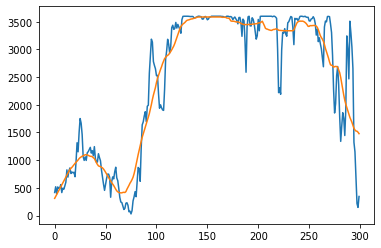

In [6]:
WS_sg = savgol_filter(serScada.iloc[:,[3]].values.ravel(), 31, 1) # window size 51, polynomial order 3
x = serScada.iloc[:,[3]].values.ravel()[0:300]
plt.plot(x, label='WS')
y = WS_sg[0:300]
plt.plot(y, label='WS_SG31')

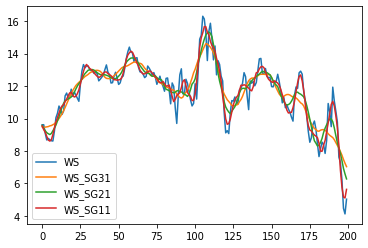

In [7]:
a = 100
b = 300
x = serScada['wind speed(m/s)'].values[a:b]
plt.plot(x, label='WS')

WS_sg = savgol_filter(serScada['wind speed(m/s)'].values, 31, 3) # window size 51, polynomial order 3
y = WS_sg[a:b]
plt.plot(y, label='WS_SG31')

WS_sg = savgol_filter(serScada['wind speed(m/s)'].values, 21, 3) # window size 51, polynomial order 3
y = WS_sg[a:b]
plt.plot(y, label='WS_SG21')

WS_sg = savgol_filter(serScada['wind speed(m/s)'].values, 11, 3) # window size 51, polynomial order 3
y = WS_sg[a:b]
plt.plot(y, label='WS_SG11')

plt.legend()
# plt.savefig('temp/filter_SG_show_compare.png', dpi=600)
plt.show()


# 循环训练预测

In [ ]:
x = (np.array(range(15))+1)*2+1 # w
y = np.array(range(x[-1]-1))+1 # k
x,y = np.meshgrid(x, y)

In [96]:
# 从头开始执行此步
# z = np.zeros(x.shape)
# t = np.zeros(x.shape)
# for i in range(x.shape[1]): # w
#     for j in range(x.shape[0]): # k
#         z[j,i] = np.nan
#         t[j,i] = np.nan
# np.savetxt('./predict-wind-turbine/compare_filter/z_rmse.csv', z, delimiter = ',')
# np.savetxt('./predict-wind-turbine/compare_filter/t.csv', t, delimiter = ',')

Model: "sequential_255"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_765 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_765 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_766 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_766 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_767 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_767 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_255 (Dense)            (None, 1)              

Epoch 48/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 0.2193 - val_loss: 6.9265e-04 - val_accuracy: 0.2104
Epoch 49/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0019 - accuracy: 0.2193 - val_loss: 6.6068e-04 - val_accuracy: 0.2104
Epoch 50/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 0.2193 - val_loss: 6.9626e-04 - val_accuracy: 0.2104
Epoch 51/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 0.2193 - val_loss: 0.0011 - val_accuracy: 0.2104
Epoch 52/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 0.2193 - val_loss: 6.7198e-04 - val_accuracy: 0.2104
Epoch 53/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 0.2193 - val_loss: 8.1650e-04 - val_accuracy: 0.2104
Epoch 54/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 0.2193 - val_l

Epoch 103/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 0.2193 - val_loss: 6.1579e-04 - val_accuracy: 0.2104
Epoch 104/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 0.2193 - val_loss: 6.5985e-04 - val_accuracy: 0.2104
Epoch 105/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 0.2193 - val_loss: 7.0755e-04 - val_accuracy: 0.2104
Epoch 106/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 0.2193 - val_loss: 6.5019e-04 - val_accuracy: 0.2104
Epoch 107/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 0.2193 - val_loss: 6.3398e-04 - val_accuracy: 0.2104
Epoch 108/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 0.2193 - val_loss: 7.2459e-04 - val_accuracy: 0.2104
Epoch 109/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0019 - accuracy: 0.2

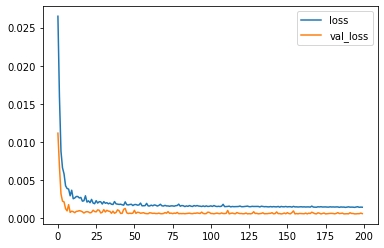

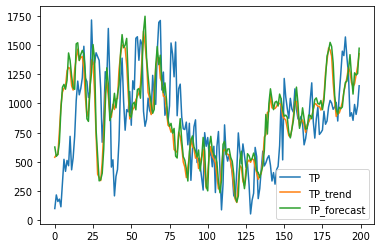

Model: "sequential_256"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_768 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_768 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_769 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_769 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_770 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_770 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_256 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0065 - accuracy: 0.2363 - val_loss: 0.0058 - val_accuracy: 0.2293
Epoch 50/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0065 - accuracy: 0.2363 - val_loss: 0.0066 - val_accuracy: 0.2294
Epoch 51/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0065 - accuracy: 0.2363 - val_loss: 0.0058 - val_accuracy: 0.2293
Epoch 52/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0065 - accuracy: 0.2363 - val_loss: 0.0056 - val_accuracy: 0.2293
Epoch 53/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0064 - accuracy: 0.2363 - val_loss: 0.0056 - val_accuracy: 0.2293
Epoch 54/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0064 - accuracy: 0.2363 - val_loss: 0.0054 - val_accuracy: 0.2293
Epoch 55/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0065 - accuracy: 0.2363 - val_loss: 0.0055 - val_ac

526/526 [==============================] - 7s 12ms/step - loss: 0.0059 - accuracy: 0.2363 - val_loss: 0.0054 - val_accuracy: 0.2293
Epoch 162/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0059 - accuracy: 0.2363 - val_loss: 0.0053 - val_accuracy: 0.2293
Epoch 163/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0058 - accuracy: 0.2363 - val_loss: 0.0054 - val_accuracy: 0.2293
Epoch 164/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.2363 - val_loss: 0.0053 - val_accuracy: 0.2293
Epoch 165/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0059 - accuracy: 0.2363 - val_loss: 0.0053 - val_accuracy: 0.2293
Epoch 166/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.2363 - val_loss: 0.0053 - val_accuracy: 0.2293
Epoch 167/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0059 - accuracy: 0.2363 - val_loss: 0.0053 - val_accuracy:

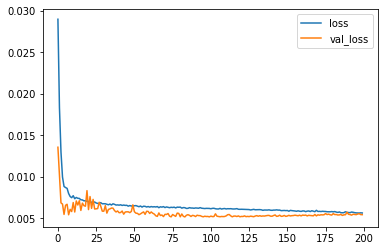

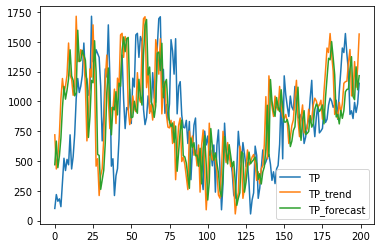

Model: "sequential_257"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_771 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_771 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_772 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_772 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_773 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_773 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_257 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 0.0012 - accuracy: 0.1895 - val_loss: 2.5793e-04 - val_accuracy: 0.1874
Epoch 103/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0013 - accuracy: 0.1895 - val_loss: 3.0923e-04 - val_accuracy: 0.1874
Epoch 104/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0012 - accuracy: 0.1895 - val_loss: 2.9256e-04 - val_accuracy: 0.1874
Epoch 105/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 3.7400e-04 - val_accuracy: 0.1874
Epoch 106/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 2.3750e-04 - val_accuracy: 0.1874
Epoch 107/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 2.5984e-04 - val_accuracy: 0.1874
Epoch 108/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0013 - accuracy: 0.1895 - val_loss

Epoch 157/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 2.6785e-04 - val_accuracy: 0.1874
Epoch 158/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 4.0612e-04 - val_accuracy: 0.1874
Epoch 159/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 4.8465e-04 - val_accuracy: 0.1874
Epoch 160/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 4.6895e-04 - val_accuracy: 0.1874
Epoch 161/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 2.3377e-04 - val_accuracy: 0.1874
Epoch 162/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1895 - val_loss: 2.4591e-04 - val_accuracy: 0.1874
Epoch 163/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1

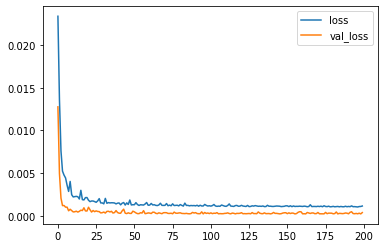

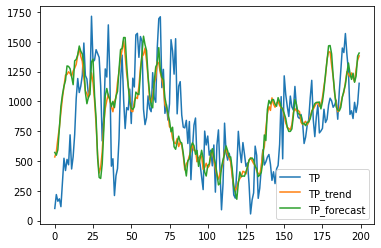

Model: "sequential_258"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_774 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_774 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_775 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_775 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_776 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_776 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_258 (Dense)            (None, 1)              

Epoch 46/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 7.8582e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 8.0776e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 8.8443e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 9.8225e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 7.8985e-04 - val_accuracy: 0.0000e+00
Epoch 52/200
526/526 [==============================] - 6s 12m

Epoch 150/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.7875e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.0913e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 6.8819e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.3087e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 6.9405e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.0111e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

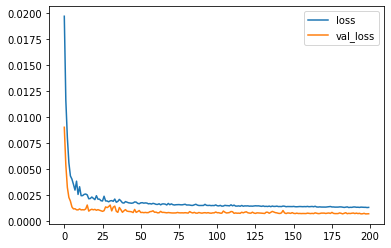

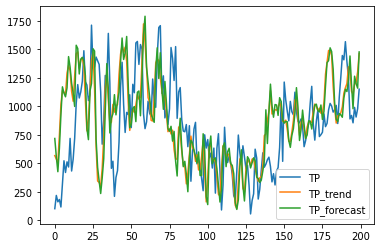

Model: "sequential_259"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_777 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_777 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_778 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_778 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_779 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_779 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_259 (Dense)            (None, 1)              

Epoch 46/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 8.5784e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 8.5703e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 9.2267e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 8.7880e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 8.5540e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 8.4631e-04 - val_accuracy: 0.0000e+00
Epoch 52/200
526/526 [==============================] - 6s

Epoch 150/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.6117e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.3171e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.1373e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.0371e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.4934e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.4827e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

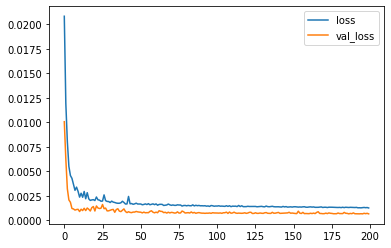

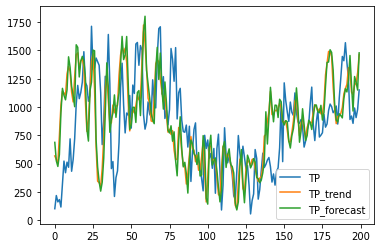

Model: "sequential_260"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_780 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_780 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_781 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_781 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_782 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_782 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_260 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 50/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0058 - val_accuracy: 0.0705
Epoch 51/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 52/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 53/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 55/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0055 - val_ac

526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0060 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1029 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy:

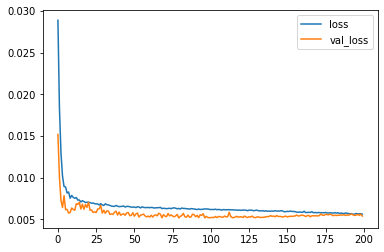

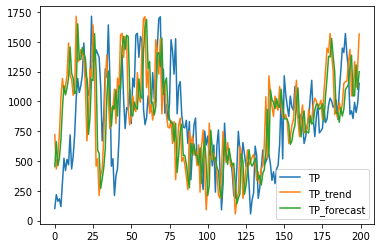

Model: "sequential_261"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_783 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_783 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_784 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_784 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_785 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_785 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_261 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 0.1689 - val_loss: 1.8541e-04 - val_accuracy: 0.1721
Epoch 103/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 0.1689 - val_loss: 6.6854e-04 - val_accuracy: 0.1721
Epoch 104/200
526/526 [==============================] - 6s 12ms/step - loss: 9.9528e-04 - accuracy: 0.1689 - val_loss: 1.4234e-04 - val_accuracy: 0.1721
Epoch 105/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 0.1689 - val_loss: 1.2786e-04 - val_accuracy: 0.1721
Epoch 106/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 0.1689 - val_loss: 2.5865e-04 - val_accuracy: 0.1721
Epoch 107/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0012 - accuracy: 0.1689 - val_loss: 2.1237e-04 - val_accuracy: 0.1721
Epoch 108/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 0.1689 - val_

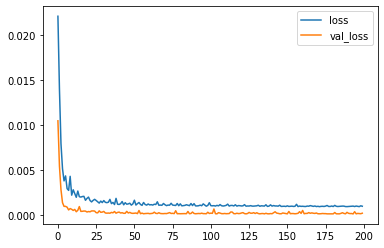

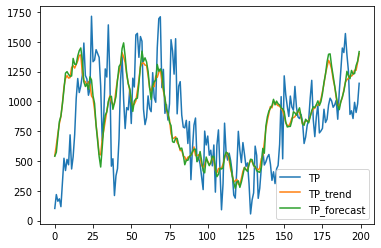

Model: "sequential_262"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_786 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_786 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_787 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_787 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_788 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_788 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_262 (Dense)            (None, 1)              

526/526 [==============================] - 7s 12ms/step - loss: 9.6933e-04 - accuracy: 5.9467e-05 - val_loss: 4.1269e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.6106e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 12ms/step - loss: 9.9362e-04 - accuracy: 5.9467e-05 - val_loss: 3.1840e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.6469e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 3.1737e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.3367e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 

Epoch 148/200
526/526 [==============================] - 7s 12ms/step - loss: 9.7673e-04 - accuracy: 5.9467e-05 - val_loss: 4.1533e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 12ms/step - loss: 9.3169e-04 - accuracy: 5.9467e-05 - val_loss: 3.0800e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 12ms/step - loss: 9.8719e-04 - accuracy: 5.9467e-05 - val_loss: 3.1336e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 12ms/step - loss: 9.2846e-04 - accuracy: 5.9467e-05 - val_loss: 3.0269e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 12ms/step - loss: 9.4096e-04 - accuracy: 5.9467e-05 - val_loss: 3.2318e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 12ms/step - loss: 9.3942e-04 - accuracy: 5.9467e-05 - val_loss: 2.9816e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

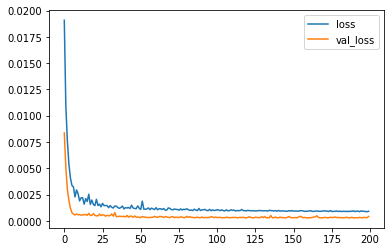

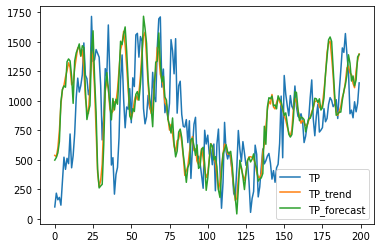

Model: "sequential_263"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_789 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_789 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_790 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_790 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_791 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_791 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_263 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.2943e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.5787e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 6s 12ms/step - loss: 9.6011e-04 - accuracy: 5.9467e-05 - val_loss: 3.2560e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.9986e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 6s 12ms/step - loss: 9.8648e-04 - accuracy: 5.9467e-05 - val_loss: 3.4690e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.5801e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 6s 

526/526 [==============================] - 6s 12ms/step - loss: 9.5907e-04 - accuracy: 5.9467e-05 - val_loss: 3.2716e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 6s 12ms/step - loss: 9.3093e-04 - accuracy: 5.9467e-05 - val_loss: 2.9912e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 6s 12ms/step - loss: 9.8123e-04 - accuracy: 5.9467e-05 - val_loss: 3.0347e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 6s 12ms/step - loss: 9.0774e-04 - accuracy: 5.9467e-05 - val_loss: 3.1426e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 6s 12ms/step - loss: 9.6165e-04 - accuracy: 5.9467e-05 - val_loss: 2.9779e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 6s 12ms/step - loss: 9.2852e-04 - accuracy: 5.9467e-05 - val_loss: 2.9723e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [===================

Epoch 199/200
526/526 [==============================] - 6s 12ms/step - loss: 9.0760e-04 - accuracy: 5.9467e-05 - val_loss: 3.0479e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 6s 12ms/step - loss: 8.8987e-04 - accuracy: 5.9467e-05 - val_loss: 3.3679e-04 - val_accuracy: 0.0000e+00


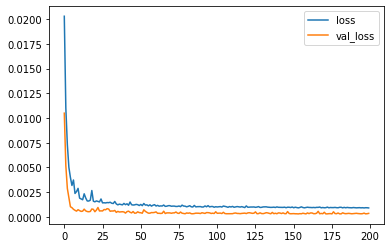

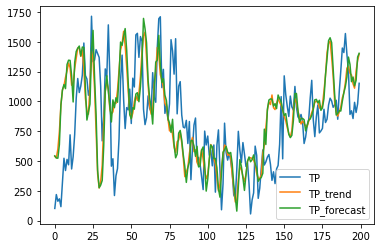

Model: "sequential_264"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_792 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_792 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_793 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_793 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_794 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_794 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_264 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.0860e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.3667e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.5542e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.7103e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.1911e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 6s 12ms/step -

Epoch 150/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.6659e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.7368e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.2962e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.8624e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.7951e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.9945e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

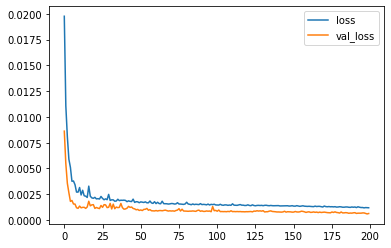

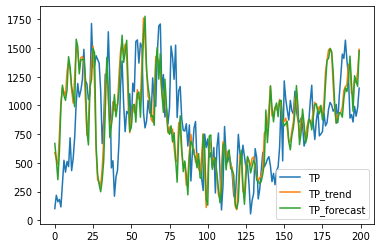

Model: "sequential_265"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_795 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_795 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_796 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_796 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_797 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_797 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_265 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.2510e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.7160e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.8460e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.1786e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.3773e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.9732e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 6s 12ms/st

Epoch 150/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.6350e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.9814e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.3792e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.0496e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.6749e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.1762e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

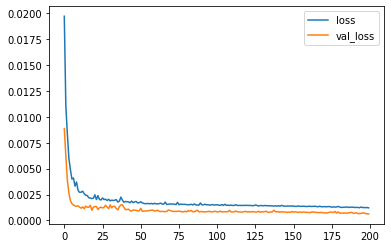

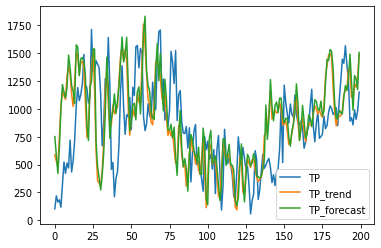

Model: "sequential_266"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_798 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_798 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_799 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_799 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_800 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_800 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_266 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0706
Epoch 50/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0060 - val_accuracy: 0.0705
Epoch 51/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0706
Epoch 52/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 53/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0706
Epoch 55/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0056 - val_ac

526/526 [==============================] - 6s 12ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0057 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy:

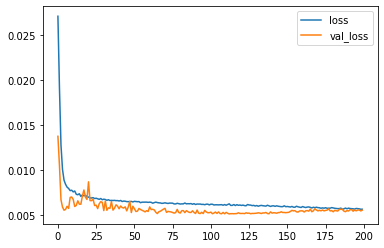

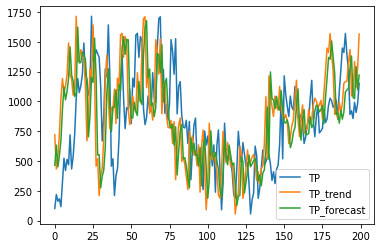

Model: "sequential_267"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_801 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_801 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_802 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_802 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_803 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_803 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_267 (Dense)            (None, 1)              

Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 0.1528 - val_loss: 1.2486e-04 - val_accuracy: 0.1602
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5086e-04 - accuracy: 0.1528 - val_loss: 1.8044e-04 - val_accuracy: 0.1602
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 0.1528 - val_loss: 9.2658e-05 - val_accuracy: 0.1602
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6972e-04 - accuracy: 0.1528 - val_loss: 1.2370e-04 - val_accuracy: 0.1602
Epoch 106/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6195e-04 - accuracy: 0.1528 - val_loss: 1.8400e-04 - val_accuracy: 0.1602
Epoch 107/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3318e-04 - accuracy: 0.1528 - val_loss: 1.7508e-04 - val_accuracy: 0.1602
Epoch 108/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011

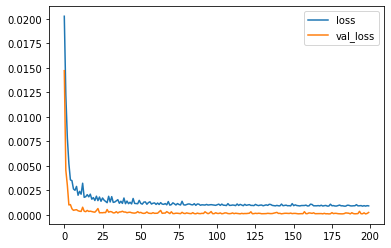

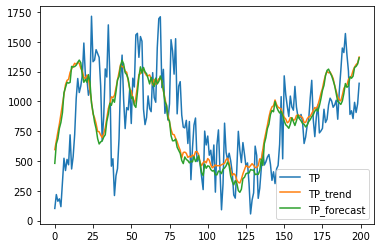

Model: "sequential_268"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_804 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_804 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_805 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_805 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_806 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_806 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_268 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 9.9762e-04 - accuracy: 5.9467e-05 - val_loss: 1.8992e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 12ms/step - loss: 8.3423e-04 - accuracy: 5.9467e-05 - val_loss: 1.8743e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 6s 12ms/step - loss: 8.3942e-04 - accuracy: 5.9467e-05 - val_loss: 1.7845e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 6s 12ms/step - loss: 8.3057e-04 - accuracy: 5.9467e-05 - val_loss: 1.7930e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 6s 12ms/step - loss: 8.4782e-04 - accuracy: 5.9467e-05 - val_loss: 1.7617e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.9757e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==========================

Epoch 147/200
526/526 [==============================] - 7s 12ms/step - loss: 8.0052e-04 - accuracy: 5.9467e-05 - val_loss: 1.7550e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 6s 12ms/step - loss: 9.6334e-04 - accuracy: 5.9467e-05 - val_loss: 3.0621e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 6s 12ms/step - loss: 8.0829e-04 - accuracy: 5.9467e-05 - val_loss: 1.7205e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 6s 12ms/step - loss: 7.6739e-04 - accuracy: 5.9467e-05 - val_loss: 1.7733e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 6s 12ms/step - loss: 7.9677e-04 - accuracy: 5.9467e-05 - val_loss: 1.6681e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 6s 12ms/step - loss: 8.1812e-04 - accuracy: 5.9467e-05 - val_loss: 1.6442e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

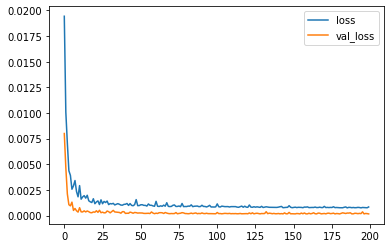

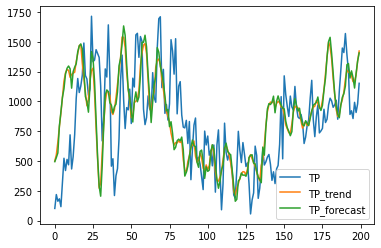

Model: "sequential_269"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_807 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_807 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_808 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_808 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_809 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_809 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_269 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.4202e-04 - accuracy: 5.9467e-05 - val_loss: 2.4897e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1979e-04 - accuracy: 5.9467e-05 - val_loss: 1.9419e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1474e-04 - accuracy: 5.9467e-05 - val_loss: 1.8255e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0059e-04 - accuracy: 5.9467e-05 - val_loss: 1.9143e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6755e-04 - accuracy: 5.9467e-05 - val_loss: 1.9340e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8304e-04 - accuracy: 5.9467e-05 - val_loss: 2.1608e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0111e-04 - accuracy: 5.9467e-05 - val_loss: 1.8634e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0538e-04 - accuracy: 5.9467e-05 - val_loss: 1.9337e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0955e-04 - accuracy: 5.9467e-05 - val_loss: 1.9685e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9550e-04 - accuracy: 5.9467e-05 - val_loss: 1.9340e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1069e-04 - accuracy: 5.9467e-05 - val_loss: 1.7403e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8445e-04 - accuracy: 5.9467e-05 - val_loss: 1.8284e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

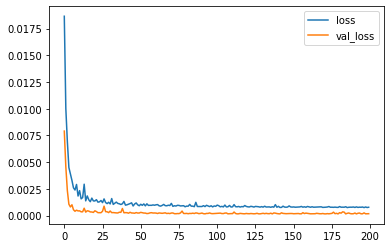

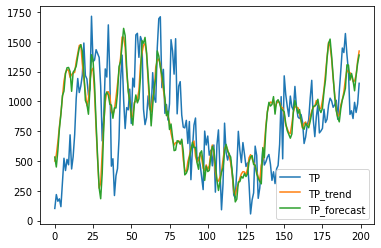

Model: "sequential_270"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_810 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_810 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_811 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_811 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_812 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_812 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_270 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 3.9209e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.7772e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.4620e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9414e-04 - accuracy: 5.9467e-05 - val_loss: 3.8655e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9181e-04 - accuracy: 5.9467e-05 - val_loss: 3.9087e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.7861e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 

526/526 [==============================] - 7s 13ms/step - loss: 9.6741e-04 - accuracy: 5.9467e-05 - val_loss: 4.1201e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3583e-04 - accuracy: 5.9467e-05 - val_loss: 4.9414e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5514e-04 - accuracy: 5.9467e-05 - val_loss: 3.9553e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8340e-04 - accuracy: 5.9467e-05 - val_loss: 3.7818e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1695e-04 - accuracy: 5.9467e-05 - val_loss: 4.6091e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4153e-04 - accuracy: 5.9467e-05 - val_loss: 4.0212e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [===================

Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0739e-04 - accuracy: 5.9467e-05 - val_loss: 3.4822e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7539e-04 - accuracy: 5.9467e-05 - val_loss: 3.6754e-04 - val_accuracy: 0.0000e+00


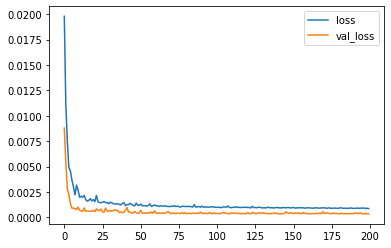

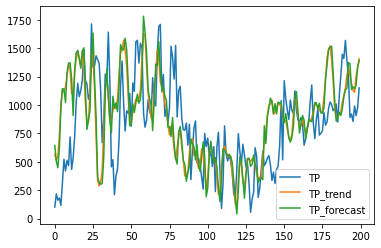

Model: "sequential_271"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_813 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_813 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_814 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_814 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_815 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_815 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_271 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.2959e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.8554e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.5184e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.9911e-04 - accuracy: 5.9467e-05 - val_loss: 4.1469e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.7787e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.6694e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms

526/526 [==============================] - 7s 14ms/step - loss: 9.5171e-04 - accuracy: 5.9467e-05 - val_loss: 3.8970e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1640e-04 - accuracy: 5.9467e-05 - val_loss: 3.9532e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2040e-04 - accuracy: 5.9467e-05 - val_loss: 4.3809e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 9.9560e-04 - accuracy: 5.9467e-05 - val_loss: 3.7885e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 9.6247e-04 - accuracy: 5.9467e-05 - val_loss: 3.8103e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2449e-04 - accuracy: 5.9467e-05 - val_loss: 4.0472e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [===================

Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 9.3452e-04 - accuracy: 5.9467e-05 - val_loss: 3.8762e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0047e-04 - accuracy: 5.9467e-05 - val_loss: 3.8513e-04 - val_accuracy: 0.0000e+00


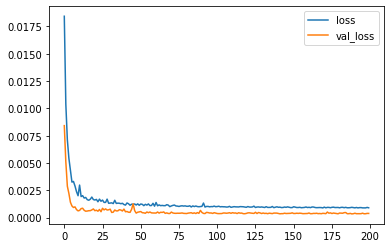

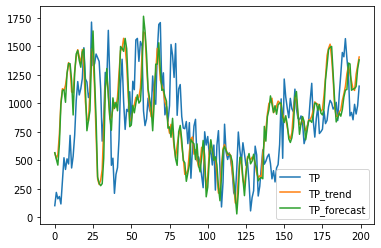

Model: "sequential_272"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_816 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_816 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_817 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_817 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_818 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_818 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_272 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.1930e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0010 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 9.4791e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.2939e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 9.6995e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0010 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - lo

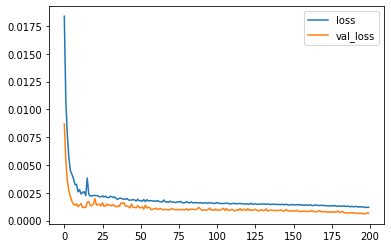

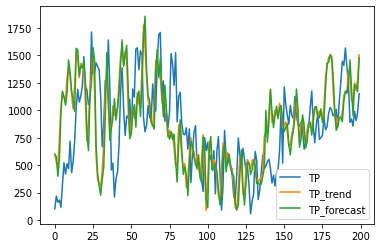

Model: "sequential_273"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_819 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_819 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_820 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_820 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_821 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_821 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_273 (Dense)            (None, 1)              

Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.0875e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.3873e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.2128e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 8.9713e-04 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 1

Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.9934e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.5195e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.9382e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.9768e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.5020e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.8867e-04 - val_accuracy: 0.0000e+00
Epoch 157/200
526/526 [=============================

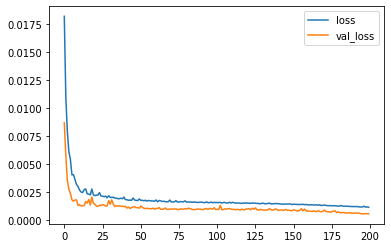

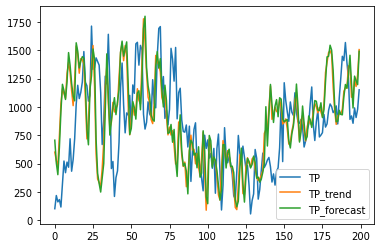

Model: "sequential_274"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_822 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_822 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_823 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_823 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_824 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_824 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_274 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0706
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0706
Epoch 51/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 52/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 53/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 55/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0059 - val_ac

526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy:

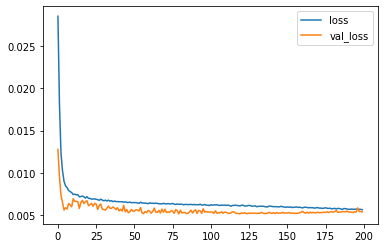

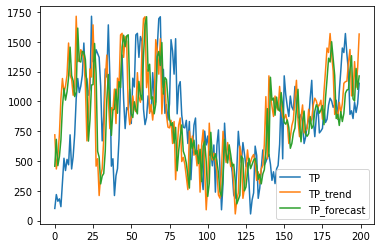

Model: "sequential_275"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_825 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_825 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_826 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_826 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_827 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_827 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_275 (Dense)            (None, 1)              

526/526 [==============================] - 8s 14ms/step - loss: 9.6829e-04 - accuracy: 0.1400 - val_loss: 9.4702e-05 - val_accuracy: 0.1501
Epoch 102/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 0.1400 - val_loss: 9.0930e-05 - val_accuracy: 0.1501
Epoch 103/200
526/526 [==============================] - 8s 14ms/step - loss: 9.0872e-04 - accuracy: 0.1400 - val_loss: 2.9387e-04 - val_accuracy: 0.1501
Epoch 104/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0010 - accuracy: 0.1400 - val_loss: 7.9508e-05 - val_accuracy: 0.1501
Epoch 105/200
526/526 [==============================] - 8s 14ms/step - loss: 9.3036e-04 - accuracy: 0.1400 - val_loss: 7.9930e-05 - val_accuracy: 0.1501
Epoch 106/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 0.1400 - val_loss: 1.5973e-04 - val_accuracy: 0.1501
Epoch 107/200
526/526 [==============================] - 8s 14ms/step - loss: 9.6540e-04 - accuracy: 0

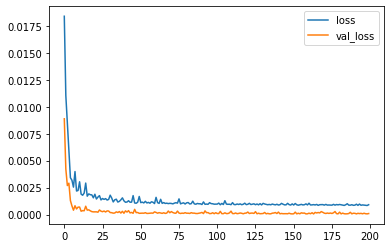

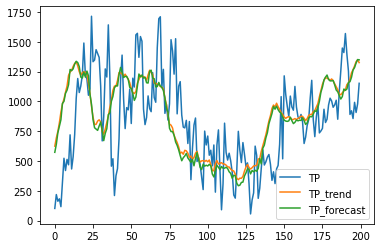

Model: "sequential_276"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_828 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_828 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_829 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_829 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_830 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_830 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_276 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 7.8369e-04 - accuracy: 5.9467e-05 - val_loss: 1.2012e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5529e-04 - accuracy: 5.9467e-05 - val_loss: 1.7270e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6379e-04 - accuracy: 5.9467e-05 - val_loss: 1.5152e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7238e-04 - accuracy: 5.9467e-05 - val_loss: 1.4928e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2858e-04 - accuracy: 5.9467e-05 - val_loss: 1.1838e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1928e-04 - accuracy: 5.9467e-05 - val_loss: 1.9603e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7375e-04 - accuracy: 5.9467e-05 - val_loss: 1.1847e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2741e-04 - accuracy: 5.9467e-05 - val_loss: 1.2380e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5373e-04 - accuracy: 5.9467e-05 - val_loss: 1.3657e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3420e-04 - accuracy: 5.9467e-05 - val_loss: 1.1528e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4308e-04 - accuracy: 5.9467e-05 - val_loss: 1.9297e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6148e-04 - accuracy: 5.9467e-05 - val_loss: 1.1238e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

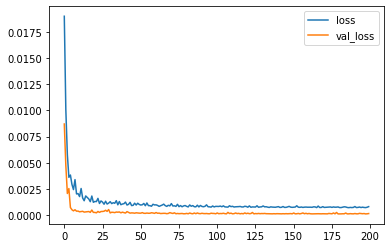

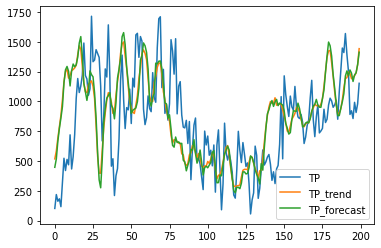

Model: "sequential_277"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_831 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_831 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_832 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_832 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_833 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_833 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_277 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.9762e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6632e-04 - accuracy: 5.9467e-05 - val_loss: 2.2784e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.8535e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6784e-04 - accuracy: 5.9467e-05 - val_loss: 3.0965e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.5878e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.9065e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 7s 13ms

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5381e-04 - accuracy: 5.9467e-05 - val_loss: 1.3816e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5294e-04 - accuracy: 5.9467e-05 - val_loss: 1.3407e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4314e-04 - accuracy: 5.9467e-05 - val_loss: 1.7516e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2336e-04 - accuracy: 5.9467e-05 - val_loss: 1.1950e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7054e-04 - accuracy: 5.9467e-05 - val_loss: 1.5807e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3819e-04 - accuracy: 5.9467e-05 - val_loss: 1.1545e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

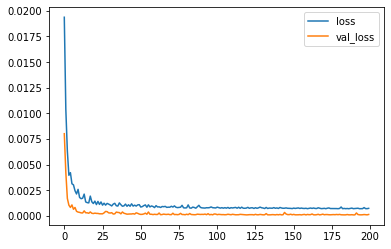

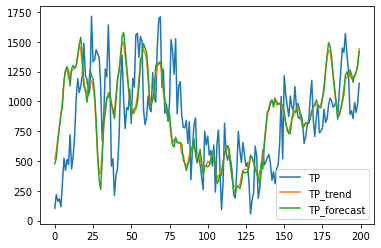

Model: "sequential_278"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_834 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_834 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_835 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_835 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_836 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_836 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_278 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.5710e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1564e-04 - accuracy: 5.9467e-05 - val_loss: 4.1008e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8556e-04 - accuracy: 5.9467e-05 - val_loss: 3.3998e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2385e-04 - accuracy: 5.9467e-05 - val_loss: 2.6563e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2795e-04 - accuracy: 5.9467e-05 - val_loss: 2.5155e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9042e-04 - accuracy: 5.9467e-05 - val_loss: 3.9930e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==========================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1656e-04 - accuracy: 5.9467e-05 - val_loss: 2.6743e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4147e-04 - accuracy: 5.9467e-05 - val_loss: 2.3532e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2303e-04 - accuracy: 5.9467e-05 - val_loss: 2.3596e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8229e-04 - accuracy: 5.9467e-05 - val_loss: 2.7659e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3836e-04 - accuracy: 5.9467e-05 - val_loss: 2.2812e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3971e-04 - accuracy: 5.9467e-05 - val_loss: 2.8491e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

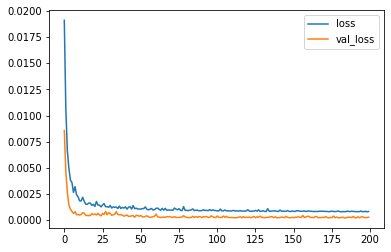

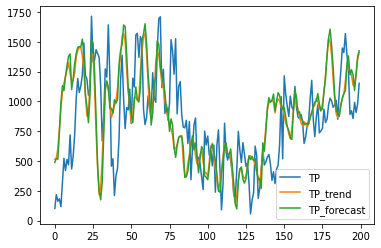

Model: "sequential_279"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_837 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_837 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_838 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_838 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_839 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_839 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_279 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 3.3916e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9603e-04 - accuracy: 5.9467e-05 - val_loss: 3.3109e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0079e-04 - accuracy: 5.9467e-05 - val_loss: 2.6928e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9462e-04 - accuracy: 5.9467e-05 - val_loss: 2.3020e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.7987e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 8.7600e-04 - accuracy: 5.9467e-05 - val_loss: 2.9536e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [================

Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5108e-04 - accuracy: 5.9467e-05 - val_loss: 2.1844e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4796e-04 - accuracy: 5.9467e-05 - val_loss: 2.3860e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6633e-04 - accuracy: 5.9467e-05 - val_loss: 2.3704e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4117e-04 - accuracy: 5.9467e-05 - val_loss: 2.1850e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5335e-04 - accuracy: 5.9467e-05 - val_loss: 2.4937e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8736e-04 - accuracy: 5.9467e-05 - val_loss: 2.7928e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

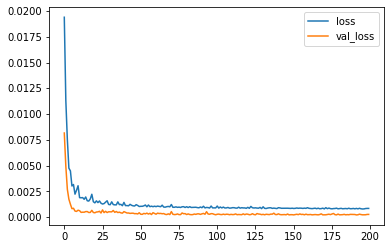

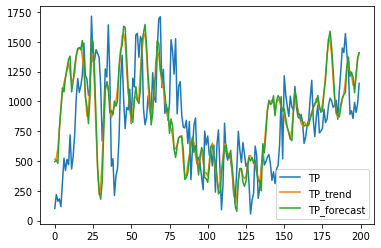

Model: "sequential_280"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_840 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_840 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_841 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_841 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_842 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_842 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_280 (Dense)            (None, 1)              

526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.6349e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 6.2233e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.3397e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.6251e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 6s 12ms/step - loss: 9.9283e-04 - accuracy: 5.9467e-05 - val_loss: 6.6451e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.7762e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 6s 12ms

Epoch 199/200
526/526 [==============================] - 6s 12ms/step - loss: 9.3584e-04 - accuracy: 5.9467e-05 - val_loss: 4.5649e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 6s 12ms/step - loss: 9.0624e-04 - accuracy: 5.9467e-05 - val_loss: 4.1144e-04 - val_accuracy: 0.0000e+00


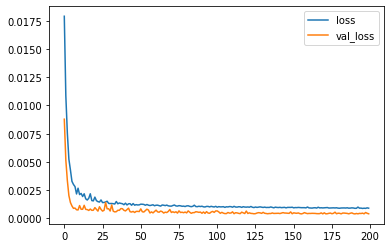

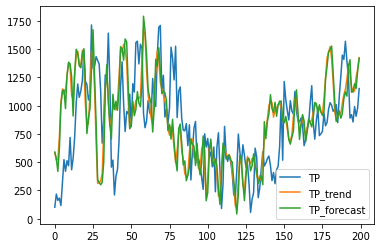

Model: "sequential_281"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_843 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_843 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_844 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_844 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_845 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_845 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_281 (Dense)            (None, 1)              

526/526 [==============================] - 7s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.4717e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.2445e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.2393e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.7521e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.3425e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.1212e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 12ms/ste

Epoch 199/200
526/526 [==============================] - 6s 12ms/step - loss: 9.1298e-04 - accuracy: 5.9467e-05 - val_loss: 4.7141e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 6s 12ms/step - loss: 9.4154e-04 - accuracy: 5.9467e-05 - val_loss: 5.5013e-04 - val_accuracy: 0.0000e+00


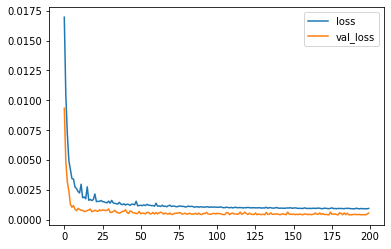

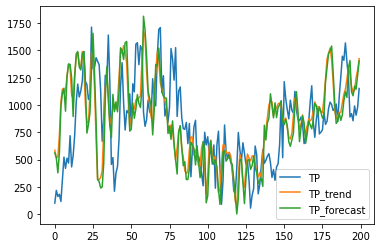

Model: "sequential_282"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_846 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_846 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_847 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_847 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_848 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_848 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_282 (Dense)            (None, 1)              

526/526 [==============================] - 7s 12ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0016 - acc

526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.6508e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.7254e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.4249e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.5020e-04 - val_accuracy: 0.0000e+00
Epoch 157/200
526/526 [==============================] - 6s 12ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.8242e-04 - val_accuracy: 0.0000e+00
Epoch 158/200
526/526 [==============================] - 6s 12ms/step 

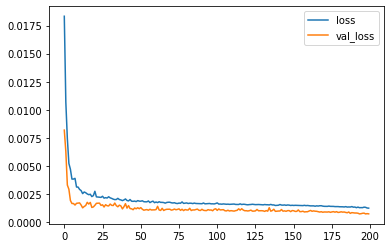

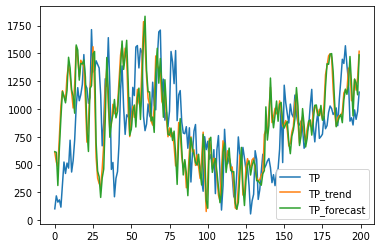

Model: "sequential_283"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_849 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_849 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_850 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_850 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_851 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_851 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_283 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 0.0010 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0016 - acc

Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0010 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.5093e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 0.0010 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.5995e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.2199e-04 - val_accuracy: 0.0000e+00
Epoch 157/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.1753e-04 - val_accuracy: 0.0000e+00
Epoch 158/200
526/526 [==============================] - 7s 

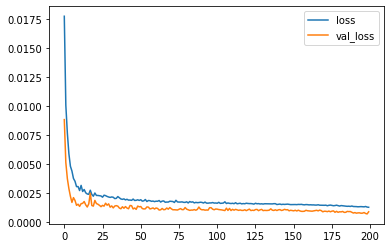

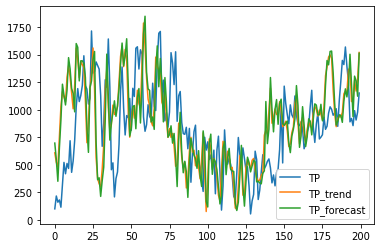

Model: "sequential_284"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_852 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_852 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_853 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_853 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_854 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_854 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_284 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 51/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0060 - val_accuracy: 0.0706
Epoch 52/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0706
Epoch 53/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0065 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 55/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1030 - val_loss: 0.0056 - val_ac

526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy:

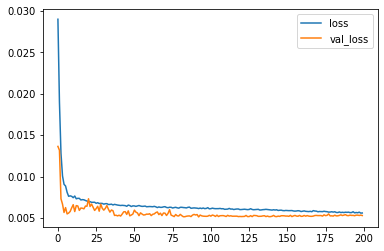

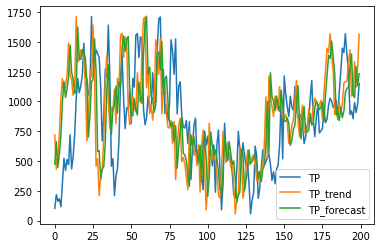

Model: "sequential_285"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_855 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_855 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_856 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_856 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_857 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_857 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_285 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.2848e-04 - accuracy: 0.1289 - val_loss: 1.4753e-04 - val_accuracy: 0.1418
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3652e-04 - accuracy: 0.1289 - val_loss: 1.6725e-04 - val_accuracy: 0.1418
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2189e-04 - accuracy: 0.1289 - val_loss: 3.3161e-04 - val_accuracy: 0.1418
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9987e-04 - accuracy: 0.1289 - val_loss: 1.5701e-04 - val_accuracy: 0.1418
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4846e-04 - accuracy: 0.1289 - val_loss: 1.9734e-04 - val_accuracy: 0.1418
Epoch 106/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6730e-04 - accuracy: 0.1289 - val_loss: 8.1790e-05 - val_accuracy: 0.1418
Epoch 107/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9229e-04 -

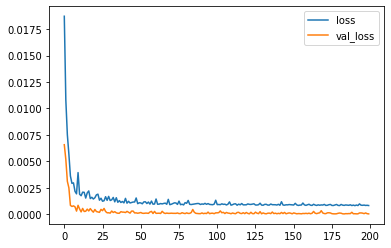

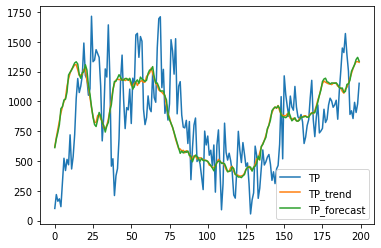

Model: "sequential_286"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_858 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_858 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_859 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_859 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_860 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_860 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_286 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6488e-04 - accuracy: 5.9467e-05 - val_loss: 1.3426e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2126e-04 - accuracy: 5.9467e-05 - val_loss: 1.3958e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.0047e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3924e-04 - accuracy: 5.9467e-05 - val_loss: 1.3753e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4760e-04 - accuracy: 5.9467e-05 - val_loss: 1.5482e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6334e-04 - accuracy: 5.9467e-05 - val_loss: 1.4193e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 7s 13ms/step - loss: 7.9039e-04 - accuracy: 5.9467e-05 - val_loss: 9.3351e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1979e-04 - accuracy: 5.9467e-05 - val_loss: 8.7503e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3402e-04 - accuracy: 5.9467e-05 - val_loss: 9.9001e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1092e-04 - accuracy: 5.9467e-05 - val_loss: 9.7970e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3813e-04 - accuracy: 5.9467e-05 - val_loss: 1.3914e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7709e-04 - accuracy: 5.9467e-05 - val_loss: 8.8247e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1291e-04 - accuracy: 5.9467e-05 - val_loss: 1.0630e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2373e-04 - accuracy: 5.9467e-05 - val_loss: 9.4136e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5511e-04 - accuracy: 5.9467e-05 - val_loss: 8.5911e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0379e-04 - accuracy: 5.9467e-05 - val_loss: 8.6413e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8736e-04 - accuracy: 5.9467e-05 - val_loss: 9.8743e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2368e-04 - accuracy: 5.9467e-05 - val_loss: 1.5143e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

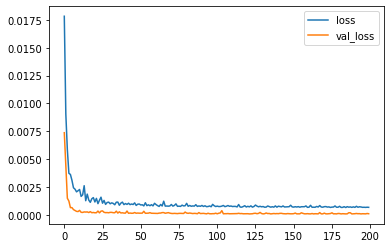

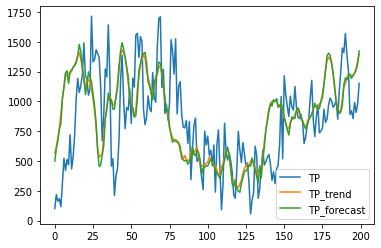

Model: "sequential_287"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_861 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_861 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_862 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_862 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_863 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_863 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_287 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.3171e-04 - accuracy: 5.9467e-05 - val_loss: 1.7239e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5562e-04 - accuracy: 5.9467e-05 - val_loss: 1.5948e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 2.6197e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9255e-04 - accuracy: 5.9467e-05 - val_loss: 1.6057e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4592e-04 - accuracy: 5.9467e-05 - val_loss: 1.3914e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.6780e-04 - accuracy: 5.9467e-05 - val_loss: 1.3259e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9398e-04 - accuracy: 5.9467e-05 - val_loss: 1.1771e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 8.0378e-04 - accuracy: 5.9467e-05 - val_loss: 1.1879e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9902e-04 - accuracy: 5.9467e-05 - val_loss: 1.0684e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.0251e-04 - accuracy: 5.9467e-05 - val_loss: 1.1308e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2766e-04 - accuracy: 5.9467e-05 - val_loss: 1.0976e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1026e-04 - accuracy: 5.9467e-05 - val_loss: 1.1841e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9807e-04 - accuracy: 5.9467e-05 - val_loss: 1.0256e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5612e-04 - accuracy: 5.9467e-05 - val_loss: 1.5024e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9747e-04 - accuracy: 5.9467e-05 - val_loss: 1.1346e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5641e-04 - accuracy: 5.9467e-05 - val_loss: 7.3644e-05 - val_accuracy: 0.0000e+00


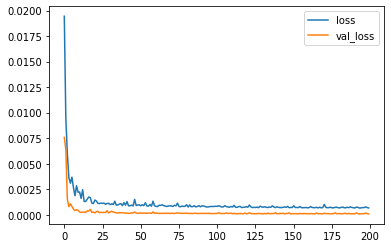

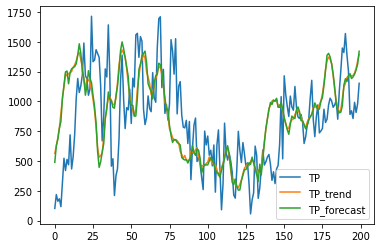

Model: "sequential_288"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_864 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_864 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_865 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_865 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_866 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_866 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_288 (Dense)            (None, 1)              

526/526 [==============================] - 7s 12ms/step - loss: 8.2779e-04 - accuracy: 5.9467e-05 - val_loss: 2.3298e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 12ms/step - loss: 8.7237e-04 - accuracy: 5.9467e-05 - val_loss: 1.6435e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 12ms/step - loss: 8.1439e-04 - accuracy: 5.9467e-05 - val_loss: 1.7525e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 12ms/step - loss: 8.5459e-04 - accuracy: 5.9467e-05 - val_loss: 1.5607e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 12ms/step - loss: 8.2854e-04 - accuracy: 5.9467e-05 - val_loss: 1.5503e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 12ms/step - loss: 7.8295e-04 - accuracy: 5.9467e-05 - val_loss: 1.7462e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6955e-04 - accuracy: 5.9467e-05 - val_loss: 1.6158e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 12ms/step - loss: 7.9108e-04 - accuracy: 5.9467e-05 - val_loss: 1.9315e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 12ms/step - loss: 8.0685e-04 - accuracy: 5.9467e-05 - val_loss: 3.6389e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 12ms/step - loss: 8.1515e-04 - accuracy: 5.9467e-05 - val_loss: 1.8389e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 12ms/step - loss: 7.4300e-04 - accuracy: 5.9467e-05 - val_loss: 1.7677e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 12ms/step - loss: 8.3157e-04 - accuracy: 5.9467e-05 - val_loss: 3.2630e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

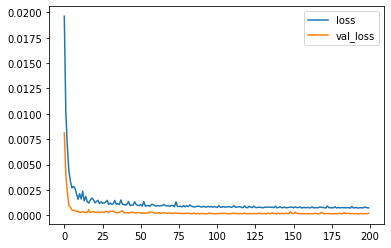

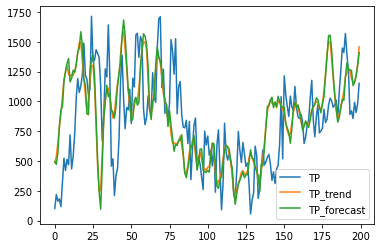

Model: "sequential_289"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_867 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_867 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_868 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_868 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_869 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_869 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_289 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.3989e-04 - accuracy: 5.9467e-05 - val_loss: 1.8787e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4969e-04 - accuracy: 5.9467e-05 - val_loss: 1.7092e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7316e-04 - accuracy: 5.9467e-05 - val_loss: 2.1757e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9578e-04 - accuracy: 5.9467e-05 - val_loss: 1.5806e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1025e-04 - accuracy: 5.9467e-05 - val_loss: 1.5421e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1232e-04 - accuracy: 5.9467e-05 - val_loss: 1.5775e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6169e-04 - accuracy: 5.9467e-05 - val_loss: 2.3253e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7817e-04 - accuracy: 5.9467e-05 - val_loss: 3.1334e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5380e-04 - accuracy: 5.9467e-05 - val_loss: 1.6272e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9588e-04 - accuracy: 5.9467e-05 - val_loss: 2.3795e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8255e-04 - accuracy: 5.9467e-05 - val_loss: 2.6758e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0459e-04 - accuracy: 5.9467e-05 - val_loss: 2.3292e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

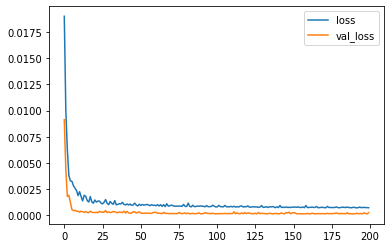

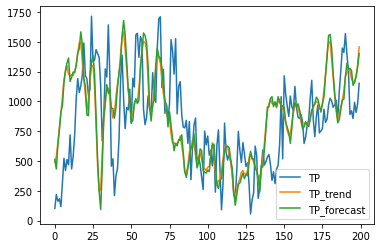

Model: "sequential_290"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_870 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_870 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_871 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_871 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_872 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_872 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_290 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3706e-04 - accuracy: 5.9467e-05 - val_loss: 3.7791e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2759e-04 - accuracy: 5.9467e-05 - val_loss: 3.2045e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4488e-04 - accuracy: 5.9467e-05 - val_loss: 2.9636e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5286e-04 - accuracy: 5.9467e-05 - val_loss: 3.5134e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2886e-04 - accuracy: 5.9467e-05 - val_loss: 4.4285e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.3702e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [============

Epoch 198/200
526/526 [==============================] - 7s 12ms/step - loss: 8.2233e-04 - accuracy: 5.9467e-05 - val_loss: 3.0701e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 12ms/step - loss: 8.5302e-04 - accuracy: 5.9467e-05 - val_loss: 3.2663e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 12ms/step - loss: 8.4742e-04 - accuracy: 5.9467e-05 - val_loss: 2.7779e-04 - val_accuracy: 0.0000e+00


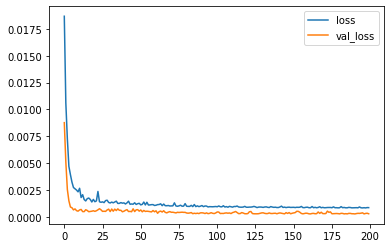

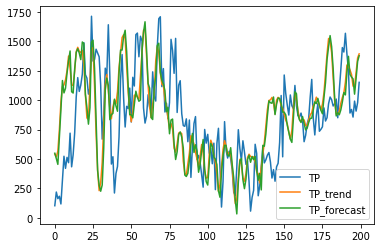

Model: "sequential_291"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_873 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_873 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_874 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_874 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_875 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_875 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_291 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1594e-04 - accuracy: 5.9467e-05 - val_loss: 2.9275e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 9.6622e-04 - accuracy: 5.9467e-05 - val_loss: 3.5090e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 9.7500e-04 - accuracy: 5.9467e-05 - val_loss: 4.0722e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4424e-04 - accuracy: 5.9467e-05 - val_loss: 3.2979e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5867e-04 - accuracy: 5.9467e-05 - val_loss: 4.3101e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4596e-04 - accuracy: 5.9467e-05 - val_loss: 3.4826e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [========

Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4477e-04 - accuracy: 5.9467e-05 - val_loss: 3.4981e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4791e-04 - accuracy: 5.9467e-05 - val_loss: 3.1674e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3397e-04 - accuracy: 5.9467e-05 - val_loss: 2.9815e-04 - val_accuracy: 0.0000e+00


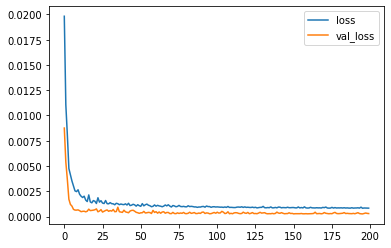

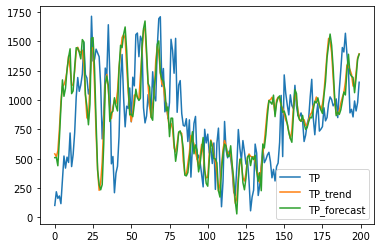

Model: "sequential_292"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_876 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_876 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_877 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_877 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_878 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_878 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_292 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 5.3052e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 8.2085e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.0865e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.1123e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.4942e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.5940e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/ste

Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.2879e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.3088e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.2635e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 6.5373e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 6.0632e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.3728e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=============================

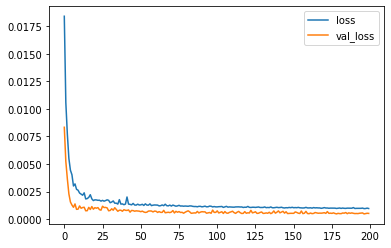

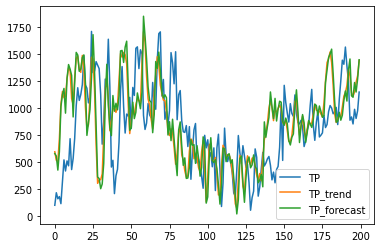

Model: "sequential_293"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_879 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_879 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_880 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_880 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_881 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_881 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_293 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.6626e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.5099e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.2425e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.3459e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.1120e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.8766e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/ste

Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 7.1105e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.4829e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.2072e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.4937e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.1266e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 6.2075e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=============================

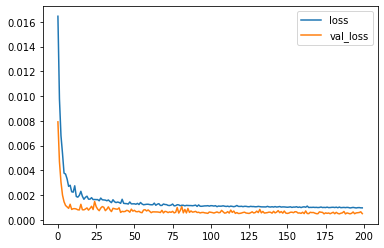

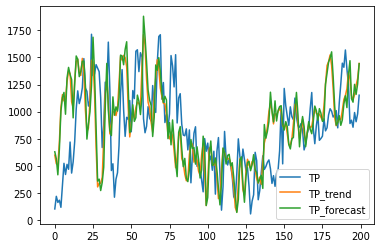

Model: "sequential_294"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_882 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_882 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_883 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_883 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_884 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_884 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_294 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - acc

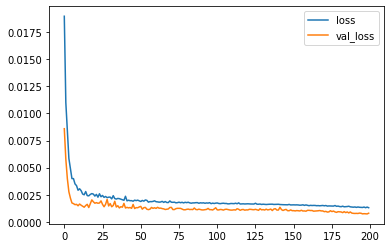

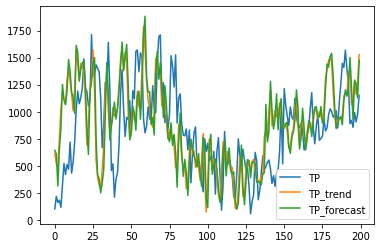

Model: "sequential_295"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_885 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_885 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_886 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_886 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_887 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_887 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_295 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0017 - acc

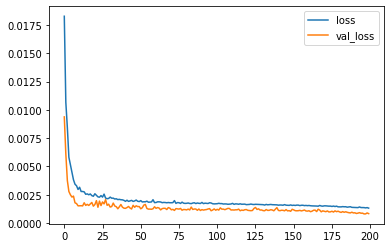

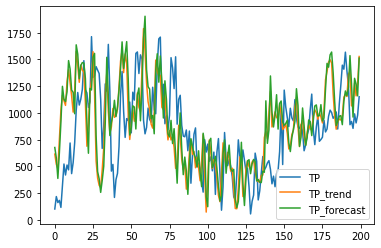

Model: "sequential_296"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_888 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_888 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_889 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_889 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_890 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_890 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_296 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0058 - val_accuracy: 0.0706
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0705
Epoch 51/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1030 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 52/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0057 - val_accuracy: 0.0705
Epoch 53/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 55/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0054 - val_ac

526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy:

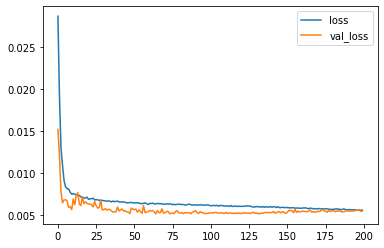

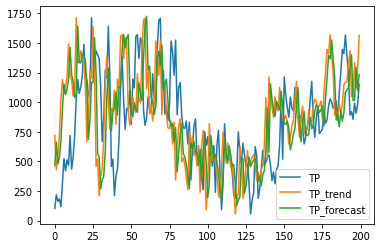

Model: "sequential_297"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_891 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_891 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_892 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_892 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_893 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_893 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_297 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 0.1191 - val_loss: 9.8632e-05 - val_accuracy: 0.1343
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3000e-04 - accuracy: 0.1191 - val_loss: 8.2595e-05 - val_accuracy: 0.1343
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2094e-04 - accuracy: 0.1191 - val_loss: 2.8533e-04 - val_accuracy: 0.1343
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1505e-04 - accuracy: 0.1191 - val_loss: 2.5922e-04 - val_accuracy: 0.1343
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 0.1191 - val_loss: 1.3944e-04 - val_accuracy: 0.1343
Epoch 106/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9435e-04 - accuracy: 0.1191 - val_loss: 8.5411e-05 - val_accuracy: 0.1343
Epoch 107/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7922e-04 - accurac

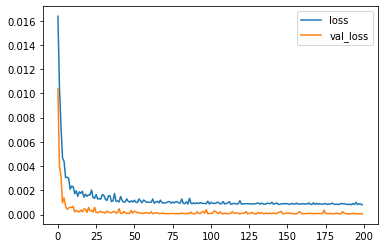

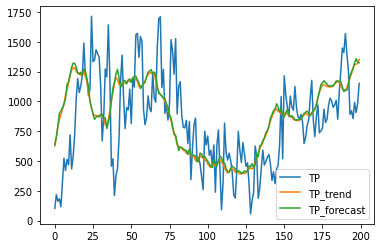

Model: "sequential_298"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_894 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_894 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_895 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_895 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_896 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_896 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_298 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5138e-04 - accuracy: 5.9467e-05 - val_loss: 1.5841e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8545e-04 - accuracy: 5.9467e-05 - val_loss: 1.1238e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9626e-04 - accuracy: 5.9467e-05 - val_loss: 1.0001e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7688e-04 - accuracy: 5.9467e-05 - val_loss: 1.5668e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.9913e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7776e-04 - accuracy: 5.9467e-05 - val_loss: 1.1210e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2187e-04 - accuracy: 5.9467e-05 - val_loss: 9.0129e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6138e-04 - accuracy: 5.9467e-05 - val_loss: 1.0175e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1146e-04 - accuracy: 5.9467e-05 - val_loss: 1.0017e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6859e-04 - accuracy: 5.9467e-05 - val_loss: 1.2327e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8207e-04 - accuracy: 5.9467e-05 - val_loss: 9.0268e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4057e-04 - accuracy: 5.9467e-05 - val_loss: 8.7286e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3485e-04 - accuracy: 5.9467e-05 - val_loss: 9.3923e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1945e-04 - accuracy: 5.9467e-05 - val_loss: 7.5650e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1169e-04 - accuracy: 5.9467e-05 - val_loss: 6.3591e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1225e-04 - accuracy: 5.9467e-05 - val_loss: 7.3613e-05 - val_accuracy: 0.0000e+00


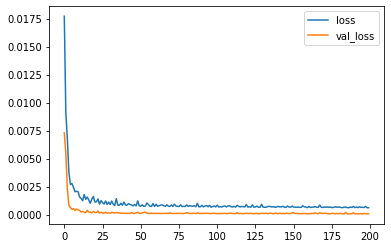

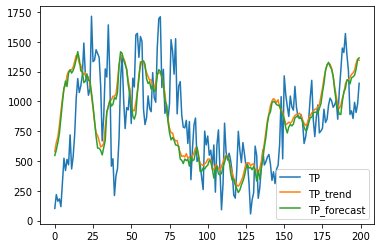

Model: "sequential_299"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_897 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_897 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_898 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_898 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_899 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_899 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_299 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2195e-04 - accuracy: 5.9467e-05 - val_loss: 1.1517e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 8.5327e-04 - accuracy: 5.9467e-05 - val_loss: 1.0719e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1741e-04 - accuracy: 5.9467e-05 - val_loss: 9.7857e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4478e-04 - accuracy: 5.9467e-05 - val_loss: 1.1555e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0726e-04 - accuracy: 5.9467e-05 - val_loss: 1.0797e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.3139e-04 - accuracy: 5.9467e-05 - val_loss: 1.3327e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1509e-04 - accuracy: 5.9467e-05 - val_loss: 9.2906e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8488e-04 - accuracy: 5.9467e-05 - val_loss: 2.2849e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9488e-04 - accuracy: 5.9467e-05 - val_loss: 1.0123e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9608e-04 - accuracy: 5.9467e-05 - val_loss: 9.2257e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8488e-04 - accuracy: 5.9467e-05 - val_loss: 8.8604e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7899e-04 - accuracy: 5.9467e-05 - val_loss: 9.2157e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.1285e-04 - accuracy: 5.9467e-05 - val_loss: 5.9137e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0882e-04 - accuracy: 5.9467e-05 - val_loss: 7.0686e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3494e-04 - accuracy: 5.9467e-05 - val_loss: 9.1224e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3299e-04 - accuracy: 5.9467e-05 - val_loss: 6.2889e-05 - val_accuracy: 0.0000e+00


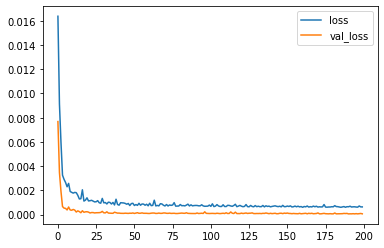

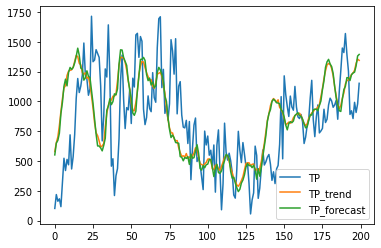

Model: "sequential_300"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_900 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_900 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_901 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_901 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_902 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_902 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_300 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.4225e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.7664e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4872e-04 - accuracy: 5.9467e-05 - val_loss: 1.8089e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8455e-04 - accuracy: 5.9467e-05 - val_loss: 1.8129e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.1898e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6342e-04 - accuracy: 5.9467e-05 - val_loss: 1.9723e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 7s 

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5182e-04 - accuracy: 5.9467e-05 - val_loss: 1.3267e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9890e-04 - accuracy: 5.9467e-05 - val_loss: 1.2502e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2623e-04 - accuracy: 5.9467e-05 - val_loss: 1.2809e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4849e-04 - accuracy: 5.9467e-05 - val_loss: 1.2134e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2598e-04 - accuracy: 5.9467e-05 - val_loss: 1.1968e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1444e-04 - accuracy: 5.9467e-05 - val_loss: 2.3279e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

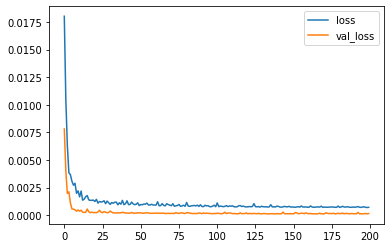

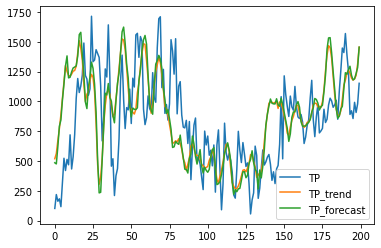

Model: "sequential_301"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_903 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_903 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_904 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_904 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_905 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_905 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_301 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.3563e-04 - accuracy: 5.9467e-05 - val_loss: 1.7741e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 1.9306e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1934e-04 - accuracy: 5.9467e-05 - val_loss: 4.4333e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.4450e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9383e-04 - accuracy: 5.9467e-05 - val_loss: 2.2021e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.5312e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 7s 

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2769e-04 - accuracy: 5.9467e-05 - val_loss: 1.6996e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8765e-04 - accuracy: 5.9467e-05 - val_loss: 1.3071e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6955e-04 - accuracy: 5.9467e-05 - val_loss: 1.2029e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1725e-04 - accuracy: 5.9467e-05 - val_loss: 1.3297e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1858e-04 - accuracy: 5.9467e-05 - val_loss: 1.2621e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7803e-04 - accuracy: 5.9467e-05 - val_loss: 2.4168e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

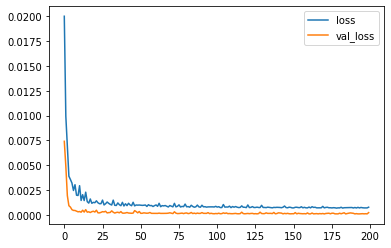

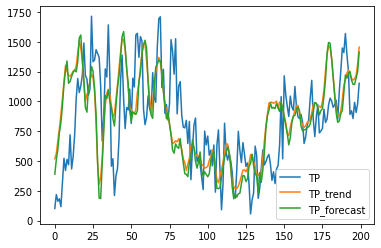

Model: "sequential_302"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_906 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_906 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_907 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_907 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_908 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_908 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_302 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.8894e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2141e-04 - accuracy: 5.9467e-05 - val_loss: 3.8607e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5780e-04 - accuracy: 5.9467e-05 - val_loss: 2.1726e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5993e-04 - accuracy: 5.9467e-05 - val_loss: 3.0395e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5590e-04 - accuracy: 5.9467e-05 - val_loss: 2.3309e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0441e-04 - accuracy: 5.9467e-05 - val_loss: 2.3516e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==========================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4277e-04 - accuracy: 5.9467e-05 - val_loss: 2.2339e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3887e-04 - accuracy: 5.9467e-05 - val_loss: 2.0688e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8971e-04 - accuracy: 5.9467e-05 - val_loss: 2.0945e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6642e-04 - accuracy: 5.9467e-05 - val_loss: 2.2391e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8975e-04 - accuracy: 5.9467e-05 - val_loss: 2.5216e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5604e-04 - accuracy: 5.9467e-05 - val_loss: 2.1695e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

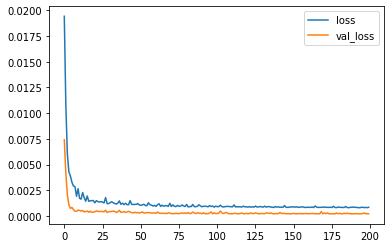

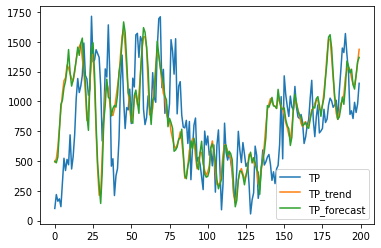

Model: "sequential_303"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_909 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_909 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_910 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_910 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_911 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_911 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_303 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 9.0140e-04 - accuracy: 5.9467e-05 - val_loss: 2.1466e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4321e-04 - accuracy: 5.9467e-05 - val_loss: 2.3953e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 9.0097e-04 - accuracy: 5.9467e-05 - val_loss: 2.7419e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.8003e-04 - accuracy: 5.9467e-05 - val_loss: 2.6600e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.0187e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7613e-04 - accuracy: 5.9467e-05 - val_loss: 3.3947e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [============

Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5715e-04 - accuracy: 5.9467e-05 - val_loss: 2.5332e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5439e-04 - accuracy: 5.9467e-05 - val_loss: 2.3547e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 9.1356e-04 - accuracy: 5.9467e-05 - val_loss: 2.1198e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4153e-04 - accuracy: 5.9467e-05 - val_loss: 2.0971e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 8.3253e-04 - accuracy: 5.9467e-05 - val_loss: 2.2045e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2839e-04 - accuracy: 5.9467e-05 - val_loss: 2.3178e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

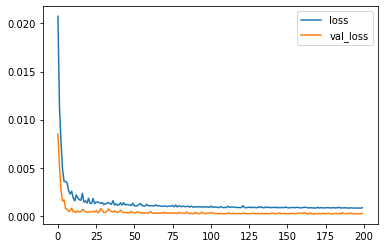

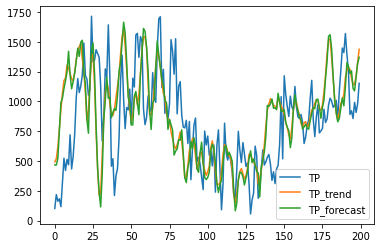

Model: "sequential_304"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_912 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_912 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_913 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_913 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_914 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_914 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_304 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.9808e-04 - accuracy: 5.9467e-05 - val_loss: 3.9292e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8257e-04 - accuracy: 5.9467e-05 - val_loss: 3.7776e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 4.8788e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.7784e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8344e-04 - accuracy: 5.9467e-05 - val_loss: 3.5217e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.6466e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] -

Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6088e-04 - accuracy: 5.9467e-05 - val_loss: 3.5070e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2227e-04 - accuracy: 5.9467e-05 - val_loss: 4.5687e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6309e-04 - accuracy: 5.9467e-05 - val_loss: 3.3660e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1991e-04 - accuracy: 5.9467e-05 - val_loss: 3.5216e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6579e-04 - accuracy: 5.9467e-05 - val_loss: 3.3804e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3384e-04 - accuracy: 5.9467e-05 - val_loss: 3.2168e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

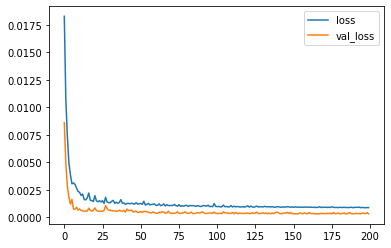

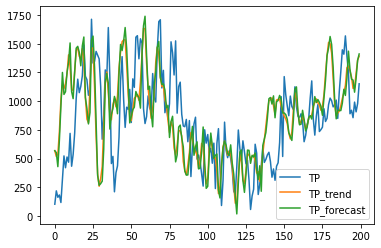

Model: "sequential_305"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_915 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_915 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_916 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_916 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_917 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_917 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_305 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.1580e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.4678e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9952e-04 - accuracy: 5.9467e-05 - val_loss: 4.2085e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.3238e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9334e-04 - accuracy: 5.9467e-05 - val_loss: 3.7660e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.0074e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 

526/526 [==============================] - 7s 13ms/step - loss: 9.6381e-04 - accuracy: 5.9467e-05 - val_loss: 3.9873e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4499e-04 - accuracy: 5.9467e-05 - val_loss: 5.7160e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4163e-04 - accuracy: 5.9467e-05 - val_loss: 6.1001e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3263e-04 - accuracy: 5.9467e-05 - val_loss: 3.4601e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.5412e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2410e-04 - accuracy: 5.9467e-05 - val_loss: 3.6606e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=======================

Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7965e-04 - accuracy: 5.9467e-05 - val_loss: 4.5575e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9140e-04 - accuracy: 5.9467e-05 - val_loss: 4.0720e-04 - val_accuracy: 0.0000e+00


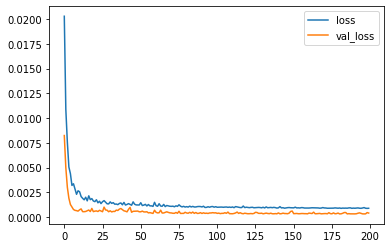

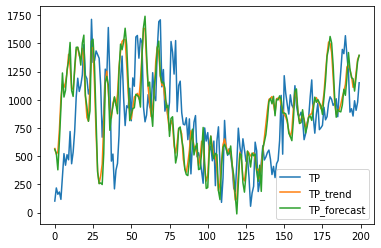

Model: "sequential_306"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_918 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_918 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_919 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_919 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_920 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_920 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_306 (Dense)            (None, 1)              

Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 7.9759e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.7976e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.2607e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0016 - accuracy: 5.9467e-05 - val_loss: 7.1046e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.4244e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.1355e-04 - val_accuracy: 0.0000e+00
Epoch 52/200
526/526 [==============================] - 7s

Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.8258e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.6239e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.7572e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.0450e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.9611e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.0551e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

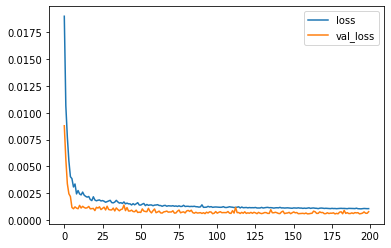

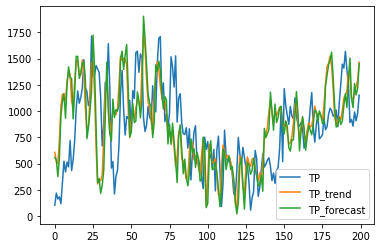

Model: "sequential_307"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_921 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_921 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_922 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_922 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_923 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_923 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_307 (Dense)            (None, 1)              

Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 9.5624e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 6.8903e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.2809e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.0556e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.0809e-04 - val_accuracy: 0.0000e+00
Epoch 52/200
526/526 [==============================] - 8s 15m

Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 8.2793e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.8356e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.3509e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.1549e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.6350e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 7.1986e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

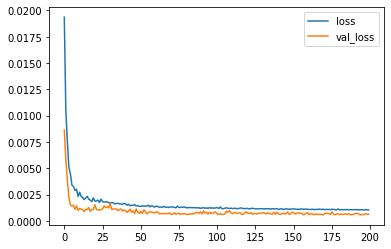

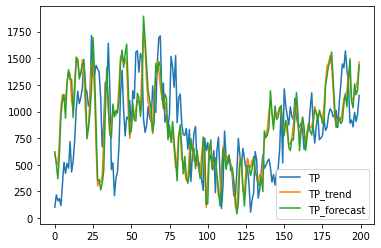

Model: "sequential_308"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_924 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_924 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_925 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_925 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_926 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_926 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_308 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0017 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0018 - acc

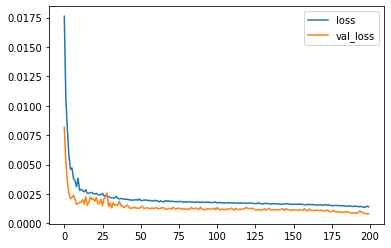

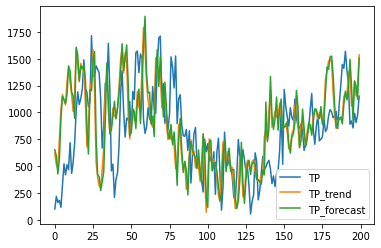

Model: "sequential_309"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_927 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_927 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_928 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_928 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_929 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_929 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_309 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - acc

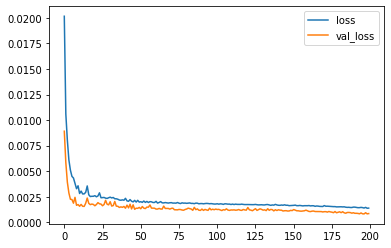

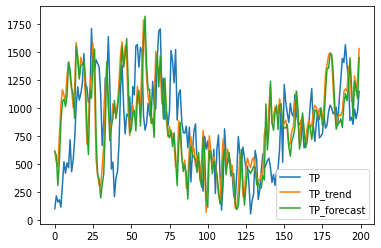

Model: "sequential_310"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_930 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_930 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_931 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_931 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_932 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_932 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_310 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 51/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 52/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 53/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0066 - accuracy: 0.1029 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 55/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0053 - val_ac

526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0054 - val_accuracy:

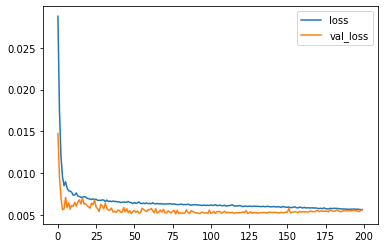

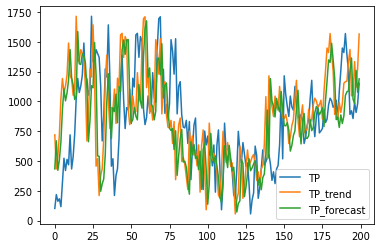

Model: "sequential_311"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_933 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_933 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_934 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_934 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_935 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_935 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_311 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 9.8865e-04 - accuracy: 0.1105 - val_loss: 8.6845e-05 - val_accuracy: 0.1276
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 8.8957e-04 - accuracy: 0.1105 - val_loss: 7.6511e-05 - val_accuracy: 0.1276
Epoch 103/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2860e-04 - accuracy: 0.1105 - val_loss: 5.5446e-05 - val_accuracy: 0.1276
Epoch 104/200
526/526 [==============================] - 8s 15ms/step - loss: 9.9847e-04 - accuracy: 0.1105 - val_loss: 9.3031e-05 - val_accuracy: 0.1276
Epoch 105/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5750e-04 - accuracy: 0.1105 - val_loss: 5.6642e-05 - val_accuracy: 0.1276
Epoch 106/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9735e-04 - accuracy: 0.1105 - val_loss: 7.3743e-05 - val_accuracy: 0.1276
Epoch 107/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - acc

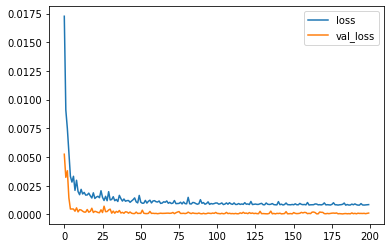

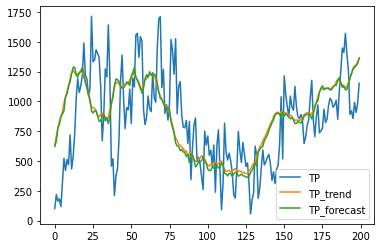

Model: "sequential_312"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_936 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_936 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_937 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_937 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_938 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_938 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_312 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 9.7121e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2012e-04 - accuracy: 5.9467e-05 - val_loss: 1.2213e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7253e-04 - accuracy: 5.9467e-05 - val_loss: 1.1226e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 9.9693e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5344e-04 - accuracy: 5.9467e-05 - val_loss: 1.6676e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.2199e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [========================

526/526 [==============================] - 7s 13ms/step - loss: 7.7986e-04 - accuracy: 5.9467e-05 - val_loss: 9.5216e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5571e-04 - accuracy: 5.9467e-05 - val_loss: 8.3155e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4033e-04 - accuracy: 5.9467e-05 - val_loss: 8.8508e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8884e-04 - accuracy: 5.9467e-05 - val_loss: 9.8525e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2753e-04 - accuracy: 5.9467e-05 - val_loss: 1.1481e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2674e-04 - accuracy: 5.9467e-05 - val_loss: 1.0852e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9589e-04 - accuracy: 5.9467e-05 - val_loss: 7.7823e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2796e-04 - accuracy: 5.9467e-05 - val_loss: 9.3841e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0206e-04 - accuracy: 5.9467e-05 - val_loss: 9.5102e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0046e-04 - accuracy: 5.9467e-05 - val_loss: 1.5450e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9813e-04 - accuracy: 5.9467e-05 - val_loss: 8.1600e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3995e-04 - accuracy: 5.9467e-05 - val_loss: 8.7062e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

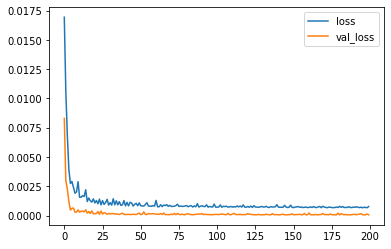

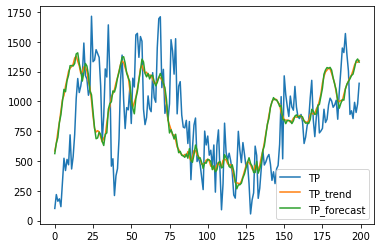

Model: "sequential_313"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_939 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_939 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_940 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_940 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_941 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_941 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_313 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1833e-04 - accuracy: 5.9467e-05 - val_loss: 1.1756e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2859e-04 - accuracy: 5.9467e-05 - val_loss: 2.5187e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 9.8142e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2486e-04 - accuracy: 5.9467e-05 - val_loss: 1.1425e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.5774e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6930e-04 - accuracy: 5.9467e-05 - val_loss: 1.3169e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3899e-04 - accuracy: 5.9467e-05 - val_loss: 7.5105e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3724e-04 - accuracy: 5.9467e-05 - val_loss: 9.0650e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4386e-04 - accuracy: 5.9467e-05 - val_loss: 7.9550e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7702e-04 - accuracy: 5.9467e-05 - val_loss: 9.5461e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0674e-04 - accuracy: 5.9467e-05 - val_loss: 8.3659e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4661e-04 - accuracy: 5.9467e-05 - val_loss: 7.8427e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

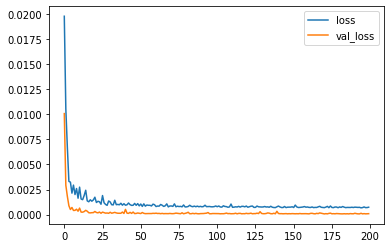

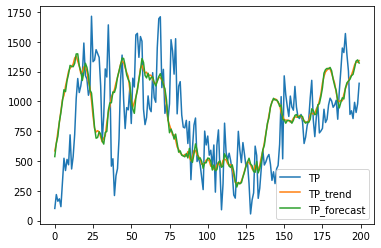

Model: "sequential_314"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_942 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_942 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_943 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_943 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_944 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_944 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_314 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7377e-04 - accuracy: 5.9467e-05 - val_loss: 2.4364e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.1950e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5567e-04 - accuracy: 5.9467e-05 - val_loss: 1.5378e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8208e-04 - accuracy: 5.9467e-05 - val_loss: 1.6543e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.5305e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3373e-04 - accuracy: 5.9467e-05 - val_loss: 1.7949e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2059e-04 - accuracy: 5.9467e-05 - val_loss: 1.5549e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2045e-04 - accuracy: 5.9467e-05 - val_loss: 2.1482e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0238e-04 - accuracy: 5.9467e-05 - val_loss: 1.0874e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9284e-04 - accuracy: 5.9467e-05 - val_loss: 1.1670e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4196e-04 - accuracy: 5.9467e-05 - val_loss: 1.1005e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9804e-04 - accuracy: 5.9467e-05 - val_loss: 1.4282e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

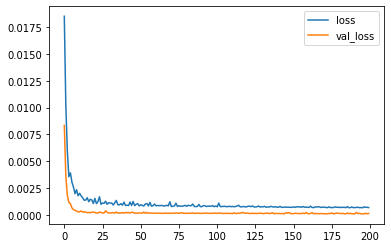

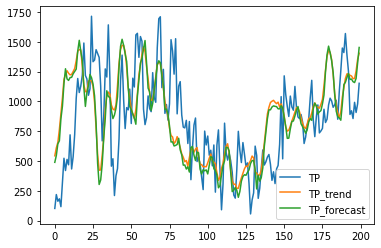

Model: "sequential_315"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_945 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_945 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_946 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_946 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_947 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_947 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_315 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.5782e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.5466e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9654e-04 - accuracy: 5.9467e-05 - val_loss: 1.6692e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9860e-04 - accuracy: 5.9467e-05 - val_loss: 2.5936e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4324e-04 - accuracy: 5.9467e-05 - val_loss: 2.4539e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 9.7426e-04 - accuracy: 5.9467e-05 - val_loss: 1.5160e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

526/526 [==============================] - 8s 15ms/step - loss: 9.5305e-04 - accuracy: 5.9467e-05 - val_loss: 1.5762e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6262e-04 - accuracy: 5.9467e-05 - val_loss: 1.6640e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5599e-04 - accuracy: 5.9467e-05 - val_loss: 1.7187e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 7.9169e-04 - accuracy: 5.9467e-05 - val_loss: 1.6347e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0984e-04 - accuracy: 5.9467e-05 - val_loss: 1.4896e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2347e-04 - accuracy: 5.9467e-05 - val_loss: 1.3623e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 7.4823e-04 - accuracy: 5.9467e-05 - val_loss: 1.8921e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1282e-04 - accuracy: 5.9467e-05 - val_loss: 1.0169e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2130e-04 - accuracy: 5.9467e-05 - val_loss: 1.4890e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6291e-04 - accuracy: 5.9467e-05 - val_loss: 1.0783e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1672e-04 - accuracy: 5.9467e-05 - val_loss: 1.2528e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 7.0097e-04 - accuracy: 5.9467e-05 - val_loss: 1.3414e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

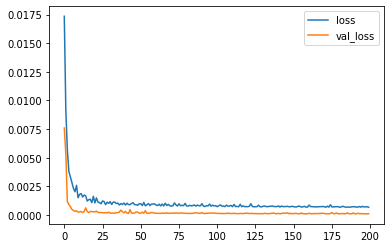

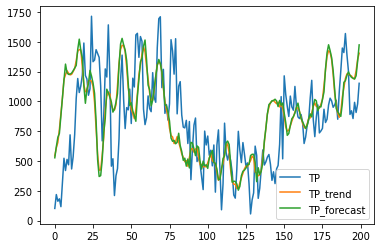

Model: "sequential_316"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_948 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_948 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_949 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_949 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_950 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_950 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_316 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.1130e-04 - accuracy: 5.9467e-05 - val_loss: 2.1190e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9949e-04 - accuracy: 5.9467e-05 - val_loss: 2.1486e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6874e-04 - accuracy: 5.9467e-05 - val_loss: 2.9638e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4100e-04 - accuracy: 5.9467e-05 - val_loss: 1.6534e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2122e-04 - accuracy: 5.9467e-05 - val_loss: 3.5080e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2124e-04 - accuracy: 5.9467e-05 - val_loss: 1.7847e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9041e-04 - accuracy: 5.9467e-05 - val_loss: 1.6252e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7412e-04 - accuracy: 5.9467e-05 - val_loss: 1.4059e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7132e-04 - accuracy: 5.9467e-05 - val_loss: 1.4404e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0120e-04 - accuracy: 5.9467e-05 - val_loss: 1.6109e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5941e-04 - accuracy: 5.9467e-05 - val_loss: 1.4509e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8337e-04 - accuracy: 5.9467e-05 - val_loss: 1.8252e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

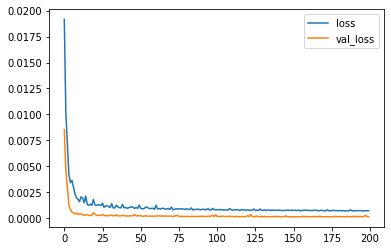

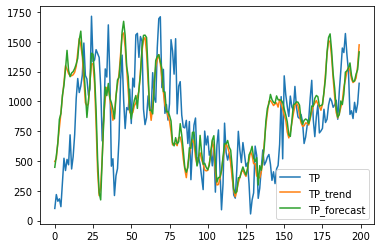

Model: "sequential_317"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_951 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_951 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_952 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_952 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_953 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_953 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_317 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 8.2524e-04 - accuracy: 5.9467e-05 - val_loss: 1.8025e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2582e-04 - accuracy: 5.9467e-05 - val_loss: 2.0988e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 8.0340e-04 - accuracy: 5.9467e-05 - val_loss: 1.6590e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2939e-04 - accuracy: 5.9467e-05 - val_loss: 2.1590e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9726e-04 - accuracy: 5.9467e-05 - val_loss: 1.6657e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4841e-04 - accuracy: 5.9467e-05 - val_loss: 2.0182e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6585e-04 - accuracy: 5.9467e-05 - val_loss: 1.5901e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7654e-04 - accuracy: 5.9467e-05 - val_loss: 1.6947e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3385e-04 - accuracy: 5.9467e-05 - val_loss: 1.5409e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3532e-04 - accuracy: 5.9467e-05 - val_loss: 1.5024e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6682e-04 - accuracy: 5.9467e-05 - val_loss: 1.4120e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7265e-04 - accuracy: 5.9467e-05 - val_loss: 2.0799e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

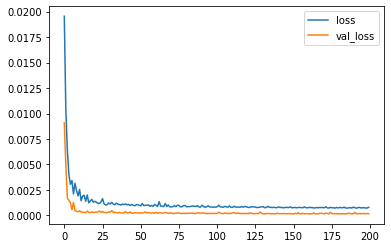

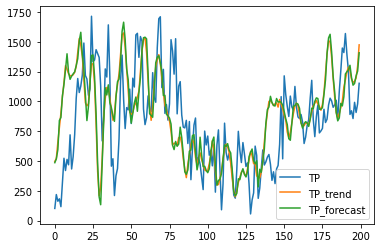

Model: "sequential_318"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_954 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_954 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_955 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_955 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_956 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_956 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_318 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2570e-04 - accuracy: 5.9467e-05 - val_loss: 2.9237e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2998e-04 - accuracy: 5.9467e-05 - val_loss: 3.6184e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0607e-04 - accuracy: 5.9467e-05 - val_loss: 3.3194e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5531e-04 - accuracy: 5.9467e-05 - val_loss: 2.5307e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 9.8297e-04 - accuracy: 5.9467e-05 - val_loss: 2.6248e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2612e-04 - accuracy: 5.9467e-05 - val_loss: 3.9596e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [========

Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2738e-04 - accuracy: 5.9467e-05 - val_loss: 2.3801e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3816e-04 - accuracy: 5.9467e-05 - val_loss: 4.0682e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3085e-04 - accuracy: 5.9467e-05 - val_loss: 3.8458e-04 - val_accuracy: 0.0000e+00


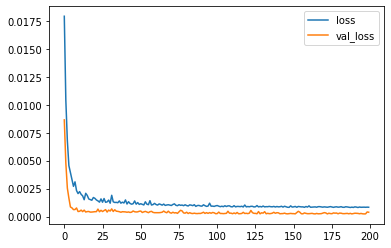

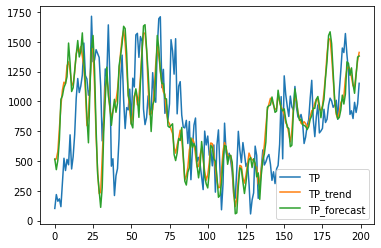

Model: "sequential_319"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_957 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_957 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_958 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_958 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_959 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_959 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_319 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.8162e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 9.7732e-04 - accuracy: 5.9467e-05 - val_loss: 2.9787e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.5291e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9700e-04 - accuracy: 5.9467e-05 - val_loss: 2.7436e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4668e-04 - accuracy: 5.9467e-05 - val_loss: 4.0700e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 9.6591e-04 - accuracy: 5.9467e-05 - val_loss: 3.7566e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [================

Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2101e-04 - accuracy: 5.9467e-05 - val_loss: 2.3727e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 8.1362e-04 - accuracy: 5.9467e-05 - val_loss: 2.3717e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6022e-04 - accuracy: 5.9467e-05 - val_loss: 2.4669e-04 - val_accuracy: 0.0000e+00


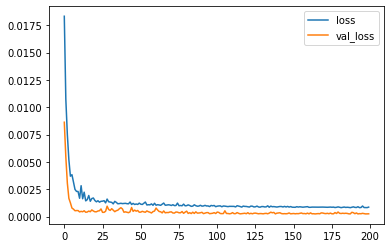

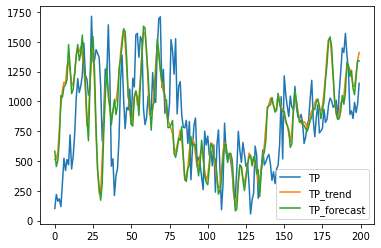

Model: "sequential_320"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_960 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_960 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_961 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_961 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_962 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_962 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_320 (Dense)            (None, 1)              

526/526 [==============================] - 7s 12ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.5115e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.8495e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.9473e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.5808e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.3514e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.6269e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 12ms/ste

Epoch 149/200
526/526 [==============================] - 7s 12ms/step - loss: 9.9650e-04 - accuracy: 5.9467e-05 - val_loss: 3.9774e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 12ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.9236e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 12ms/step - loss: 9.7749e-04 - accuracy: 5.9467e-05 - val_loss: 4.7491e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 12ms/step - loss: 9.9687e-04 - accuracy: 5.9467e-05 - val_loss: 4.5769e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.6053e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 12ms/step - loss: 9.7434e-04 - accuracy: 5.9467e-05 - val_loss: 4.3679e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=============

Epoch 200/200
526/526 [==============================] - 7s 12ms/step - loss: 9.4922e-04 - accuracy: 5.9467e-05 - val_loss: 3.9905e-04 - val_accuracy: 0.0000e+00


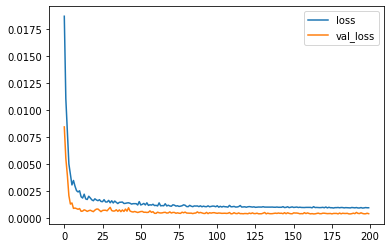

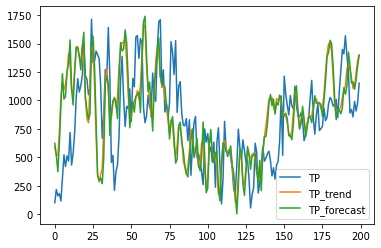

Model: "sequential_321"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_963 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_963 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_964 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_964 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_965 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_965 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_321 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 4.6292e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.7308e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.0696e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.9776e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.2102e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 4.4570e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/ste

Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3978e-04 - accuracy: 5.9467e-05 - val_loss: 3.8556e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3186e-04 - accuracy: 5.9467e-05 - val_loss: 4.7627e-04 - val_accuracy: 0.0000e+00


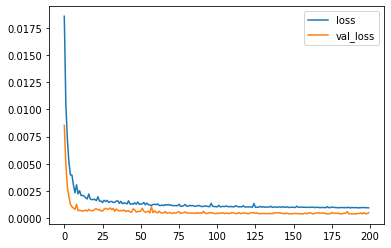

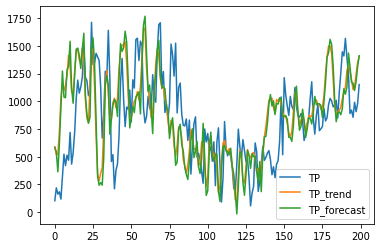

Model: "sequential_322"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_966 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_966 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_967 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_967 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_968 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_968 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_322 (Dense)            (None, 1)              

Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.5837e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.6851e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.6900e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.4791e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.6925e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.4367e-04 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================

Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.7070e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.1481e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 7.0447e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.1124e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 7.5213e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.2825e-04 - val_accuracy: 0.0000e+00
Epoch 157/200
526/526 [=============================

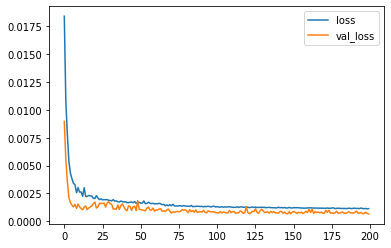

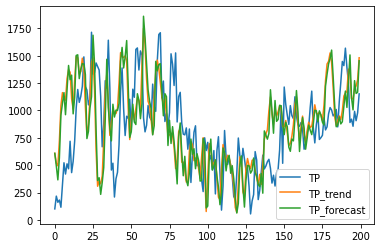

Model: "sequential_323"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_969 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_969 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_970 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_970 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_971 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_971 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_323 (Dense)            (None, 1)              

526/526 [==============================] - 8s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.9159e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.8693e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.3588e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.2624e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.7354e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 8s 14ms/step -

Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 7.1240e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.4505e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.2296e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 7.8625e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 9.1194e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 7.4393e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [=============================

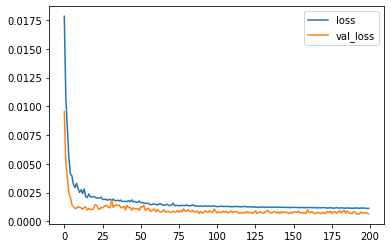

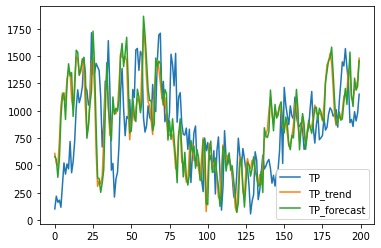

Model: "sequential_324"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_972 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_972 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_973 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_973 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_974 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_974 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_324 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0014 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0014 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0019 - acc

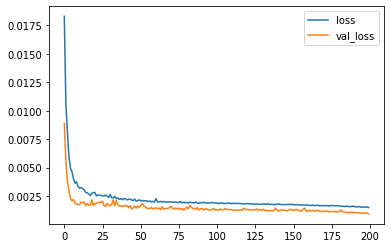

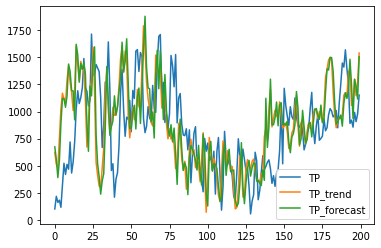

Model: "sequential_325"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_975 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_975 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_976 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_976 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_977 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_977 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_325 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0014 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0018 - acc

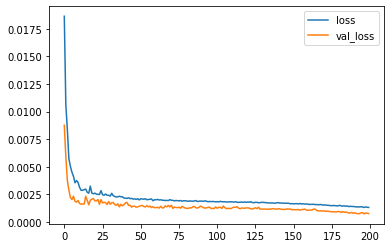

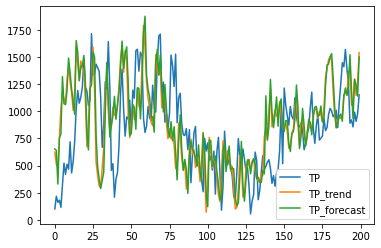

Model: "sequential_326"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_978 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_978 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_979 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_979 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_980 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_980 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_326 (Dense)            (None, 1)              

Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0706
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0705
Epoch 51/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0054 - val_accuracy: 0.0706
Epoch 52/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0065 - accuracy: 0.1029 - val_loss: 0.0062 - val_accuracy: 0.0706
Epoch 53/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 54/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0056 - val_accuracy: 0.0705
Epoch 55/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0064 - accuracy: 0.1029 - val_loss: 0.0055 - val_ac

526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 162/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 163/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1029 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 164/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0055 - val_accuracy: 0.0705
Epoch 165/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0053 - val_accuracy: 0.0705
Epoch 166/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0059 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy: 0.0705
Epoch 167/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0058 - accuracy: 0.1030 - val_loss: 0.0052 - val_accuracy:

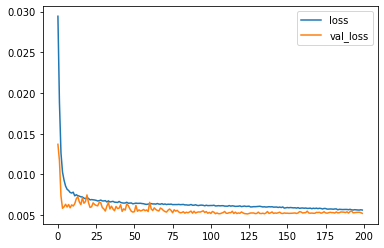

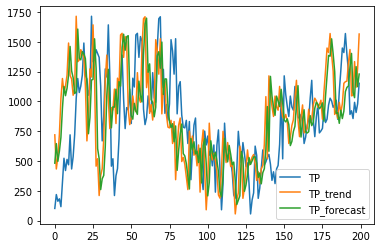

Model: "sequential_327"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_981 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_981 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_982 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_982 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_983 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_983 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_327 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 8.7442e-04 - accuracy: 0.1027 - val_loss: 6.0149e-05 - val_accuracy: 0.1219
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 8.8756e-04 - accuracy: 0.1027 - val_loss: 5.4963e-05 - val_accuracy: 0.1219
Epoch 103/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7103e-04 - accuracy: 0.1027 - val_loss: 8.8345e-05 - val_accuracy: 0.1219
Epoch 104/200
526/526 [==============================] - 8s 15ms/step - loss: 9.3143e-04 - accuracy: 0.1027 - val_loss: 5.8651e-05 - val_accuracy: 0.1219
Epoch 105/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6168e-04 - accuracy: 0.1027 - val_loss: 7.7868e-05 - val_accuracy: 0.1219
Epoch 106/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 0.1027 - val_loss: 6.9376e-05 - val_accuracy: 0.1219
Epoch 107/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7190e-04 - acc

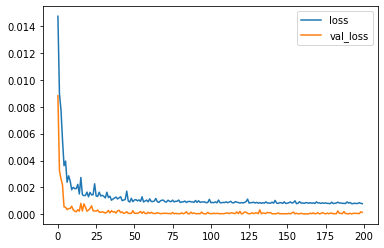

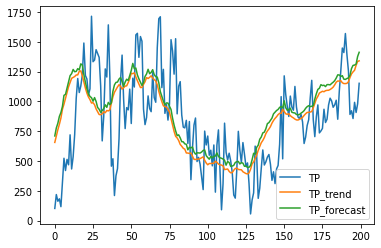

Model: "sequential_328"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_984 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_984 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_985 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_985 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_986 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_986 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_328 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.2820e-04 - accuracy: 5.9467e-05 - val_loss: 1.2728e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0687e-04 - accuracy: 5.9467e-05 - val_loss: 1.5431e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8858e-04 - accuracy: 5.9467e-05 - val_loss: 1.0810e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6430e-04 - accuracy: 5.9467e-05 - val_loss: 1.3130e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9257e-04 - accuracy: 5.9467e-05 - val_loss: 1.0294e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1657e-04 - accuracy: 5.9467e-05 - val_loss: 1.7625e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [=========================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9886e-04 - accuracy: 5.9467e-05 - val_loss: 7.6100e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1577e-04 - accuracy: 5.9467e-05 - val_loss: 5.9921e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4271e-04 - accuracy: 5.9467e-05 - val_loss: 7.6373e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1705e-04 - accuracy: 5.9467e-05 - val_loss: 1.6933e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4231e-04 - accuracy: 5.9467e-05 - val_loss: 6.6140e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9065e-04 - accuracy: 5.9467e-05 - val_loss: 7.2539e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

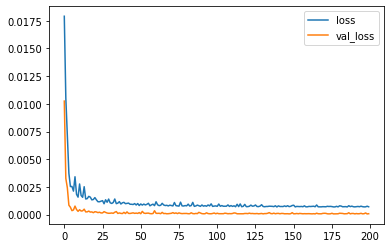

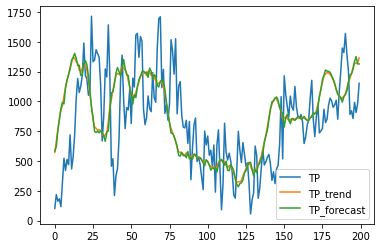

Model: "sequential_329"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_987 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_987 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_988 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_988 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_989 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_989 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_329 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 8.4477e-04 - accuracy: 5.9467e-05 - val_loss: 1.2420e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1487e-04 - accuracy: 5.9467e-05 - val_loss: 1.2576e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.3652e-04 - accuracy: 5.9467e-05 - val_loss: 8.7869e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.7926e-04 - accuracy: 5.9467e-05 - val_loss: 1.1323e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.2706e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6516e-04 - accuracy: 5.9467e-05 - val_loss: 1.5681e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [=============================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3818e-04 - accuracy: 5.9467e-05 - val_loss: 8.2598e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0823e-04 - accuracy: 5.9467e-05 - val_loss: 1.2454e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5352e-04 - accuracy: 5.9467e-05 - val_loss: 7.0847e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4733e-04 - accuracy: 5.9467e-05 - val_loss: 9.2509e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4336e-04 - accuracy: 5.9467e-05 - val_loss: 6.1743e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9729e-04 - accuracy: 5.9467e-05 - val_loss: 5.9594e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

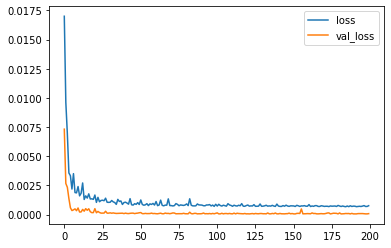

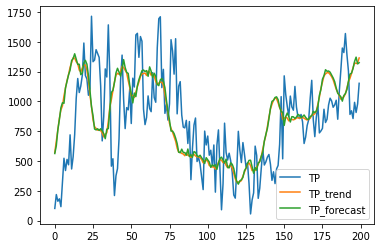

Model: "sequential_330"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_990 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_990 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_991 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_991 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_992 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_992 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_330 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6804e-04 - accuracy: 5.9467e-05 - val_loss: 1.4544e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8885e-04 - accuracy: 5.9467e-05 - val_loss: 1.5599e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0176e-04 - accuracy: 5.9467e-05 - val_loss: 1.0520e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1847e-04 - accuracy: 5.9467e-05 - val_loss: 1.0153e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4241e-04 - accuracy: 5.9467e-05 - val_loss: 1.1930e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 1.8114e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3180e-04 - accuracy: 5.9467e-05 - val_loss: 9.1625e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8628e-04 - accuracy: 5.9467e-05 - val_loss: 1.1320e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4118e-04 - accuracy: 5.9467e-05 - val_loss: 1.2337e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8390e-04 - accuracy: 5.9467e-05 - val_loss: 9.5601e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1428e-04 - accuracy: 5.9467e-05 - val_loss: 1.0166e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8933e-04 - accuracy: 5.9467e-05 - val_loss: 1.0705e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5135e-04 - accuracy: 5.9467e-05 - val_loss: 1.1009e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1845e-04 - accuracy: 5.9467e-05 - val_loss: 8.4592e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1413e-04 - accuracy: 5.9467e-05 - val_loss: 8.6607e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3416e-04 - accuracy: 5.9467e-05 - val_loss: 1.0154e-04 - val_accuracy: 0.0000e+00


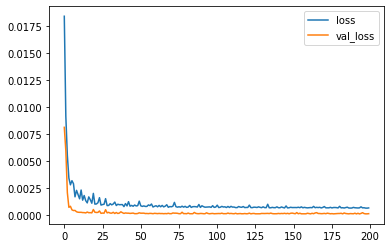

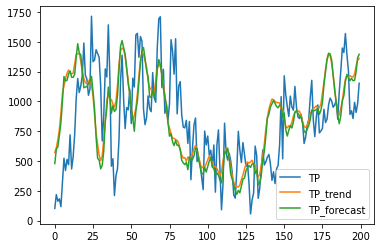

Model: "sequential_331"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_993 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_993 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_994 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_994 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_995 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_995 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_331 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7315e-04 - accuracy: 5.9467e-05 - val_loss: 1.4907e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1394e-04 - accuracy: 5.9467e-05 - val_loss: 1.2707e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8841e-04 - accuracy: 5.9467e-05 - val_loss: 1.2009e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8509e-04 - accuracy: 5.9467e-05 - val_loss: 1.2472e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 4.3921e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8697e-04 - accuracy: 5.9467e-05 - val_loss: 1.1996e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1537e-04 - accuracy: 5.9467e-05 - val_loss: 1.3796e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4198e-04 - accuracy: 5.9467e-05 - val_loss: 1.0953e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6975e-04 - accuracy: 5.9467e-05 - val_loss: 1.1584e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7429e-04 - accuracy: 5.9467e-05 - val_loss: 9.1780e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2325e-04 - accuracy: 5.9467e-05 - val_loss: 1.1606e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7478e-04 - accuracy: 5.9467e-05 - val_loss: 9.5799e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2387e-04 - accuracy: 5.9467e-05 - val_loss: 1.0510e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2716e-04 - accuracy: 5.9467e-05 - val_loss: 7.8436e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1066e-04 - accuracy: 5.9467e-05 - val_loss: 8.4990e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3066e-04 - accuracy: 5.9467e-05 - val_loss: 9.6510e-05 - val_accuracy: 0.0000e+00


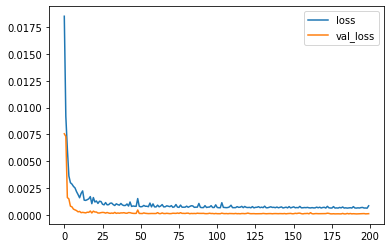

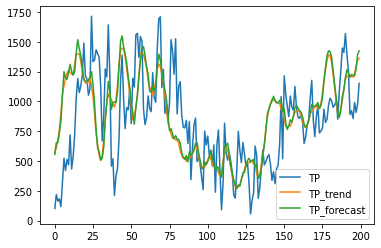

Model: "sequential_332"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_996 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_996 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_997 (LSTM)              (None, 10, 50)            20200     
_________________________________________________________________
dropout_997 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_998 (LSTM)              (None, 50)                20200     
_________________________________________________________________
dropout_998 (Dropout)        (None, 50)                0         
_________________________________________________________________
dense_332 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.5776e-04 - accuracy: 5.9467e-05 - val_loss: 1.6378e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9250e-04 - accuracy: 5.9467e-05 - val_loss: 1.6186e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4313e-04 - accuracy: 5.9467e-05 - val_loss: 1.5909e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5907e-04 - accuracy: 5.9467e-05 - val_loss: 1.9847e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2662e-04 - accuracy: 5.9467e-05 - val_loss: 2.9742e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9331e-04 - accuracy: 5.9467e-05 - val_loss: 1.7829e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7798e-04 - accuracy: 5.9467e-05 - val_loss: 1.3306e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5817e-04 - accuracy: 5.9467e-05 - val_loss: 1.4862e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9818e-04 - accuracy: 5.9467e-05 - val_loss: 1.3582e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7081e-04 - accuracy: 5.9467e-05 - val_loss: 1.4802e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3842e-04 - accuracy: 5.9467e-05 - val_loss: 1.4745e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7062e-04 - accuracy: 5.9467e-05 - val_loss: 1.5896e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

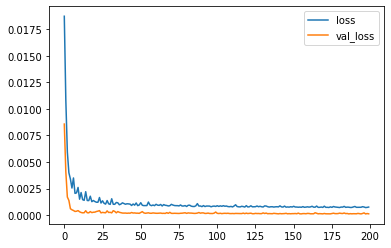

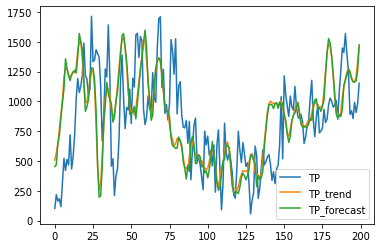

Model: "sequential_333"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_999 (LSTM)              (None, 10, 50)            10800     
_________________________________________________________________
dropout_999 (Dropout)        (None, 10, 50)            0         
_________________________________________________________________
lstm_1000 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1000 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1001 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1001 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_333 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 7.9786e-04 - accuracy: 5.9467e-05 - val_loss: 1.8865e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6180e-04 - accuracy: 5.9467e-05 - val_loss: 1.5384e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8948e-04 - accuracy: 5.9467e-05 - val_loss: 1.9089e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4030e-04 - accuracy: 5.9467e-05 - val_loss: 1.6384e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3519e-04 - accuracy: 5.9467e-05 - val_loss: 1.4739e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8761e-04 - accuracy: 5.9467e-05 - val_loss: 1.6744e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4813e-04 - accuracy: 5.9467e-05 - val_loss: 1.4976e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5280e-04 - accuracy: 5.9467e-05 - val_loss: 1.4354e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0923e-04 - accuracy: 5.9467e-05 - val_loss: 1.4643e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6428e-04 - accuracy: 5.9467e-05 - val_loss: 1.5142e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7021e-04 - accuracy: 5.9467e-05 - val_loss: 1.9814e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2476e-04 - accuracy: 5.9467e-05 - val_loss: 1.4499e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

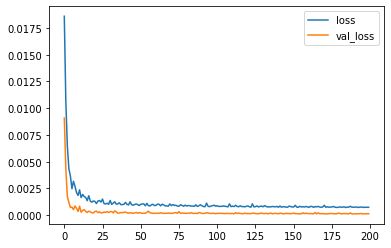

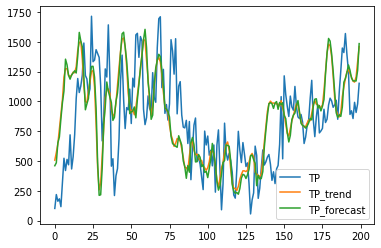

Model: "sequential_334"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1002 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1002 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1003 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1003 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1004 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1004 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_334 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.6643e-04 - accuracy: 5.9467e-05 - val_loss: 2.7629e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7468e-04 - accuracy: 5.9467e-05 - val_loss: 2.2507e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9819e-04 - accuracy: 5.9467e-05 - val_loss: 2.9087e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8829e-04 - accuracy: 5.9467e-05 - val_loss: 2.2451e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1679e-04 - accuracy: 5.9467e-05 - val_loss: 2.3059e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1522e-04 - accuracy: 5.9467e-05 - val_loss: 2.4177e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0564e-04 - accuracy: 5.9467e-05 - val_loss: 1.9705e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6845e-04 - accuracy: 5.9467e-05 - val_loss: 1.9698e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2836e-04 - accuracy: 5.9467e-05 - val_loss: 2.1367e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2676e-04 - accuracy: 5.9467e-05 - val_loss: 2.1393e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3173e-04 - accuracy: 5.9467e-05 - val_loss: 1.8851e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0536e-04 - accuracy: 5.9467e-05 - val_loss: 2.0344e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

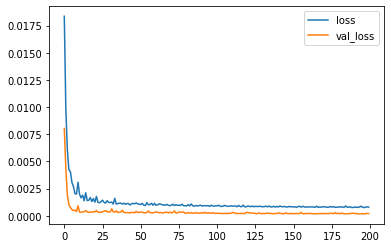

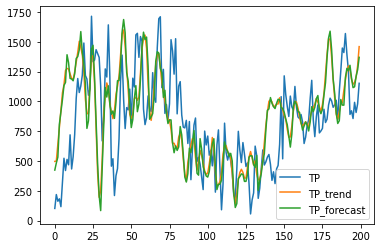

Model: "sequential_335"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1005 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1005 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1006 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1006 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1007 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1007 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_335 (Dense)            (None, 1)              

526/526 [==============================] - 8s 14ms/step - loss: 8.8880e-04 - accuracy: 5.9467e-05 - val_loss: 3.6374e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 14ms/step - loss: 9.0696e-04 - accuracy: 5.9467e-05 - val_loss: 2.1334e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 9.0015e-04 - accuracy: 5.9467e-05 - val_loss: 2.1956e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 8.9202e-04 - accuracy: 5.9467e-05 - val_loss: 2.3622e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 9.3415e-04 - accuracy: 5.9467e-05 - val_loss: 2.4831e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 14ms/step - loss: 9.3029e-04 - accuracy: 5.9467e-05 - val_loss: 2.1382e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 14ms/step - loss: 8.2817e-04 - accuracy: 5.9467e-05 - val_loss: 3.1263e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 14ms/step - loss: 8.5227e-04 - accuracy: 5.9467e-05 - val_loss: 2.2181e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 14ms/step - loss: 8.3258e-04 - accuracy: 5.9467e-05 - val_loss: 1.8906e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 9.5727e-04 - accuracy: 5.9467e-05 - val_loss: 2.0892e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 14ms/step - loss: 7.8754e-04 - accuracy: 5.9467e-05 - val_loss: 2.1186e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 14ms/step - loss: 8.0937e-04 - accuracy: 5.9467e-05 - val_loss: 1.8357e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

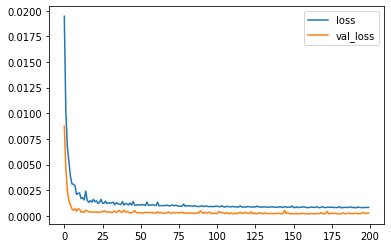

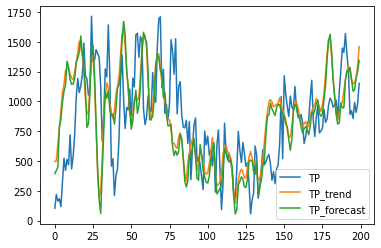

Model: "sequential_336"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1008 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1008 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1009 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1009 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1010 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1010 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_336 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4675e-04 - accuracy: 5.9467e-05 - val_loss: 2.7966e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5731e-04 - accuracy: 5.9467e-05 - val_loss: 3.0736e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3107e-04 - accuracy: 5.9467e-05 - val_loss: 2.9314e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4359e-04 - accuracy: 5.9467e-05 - val_loss: 2.9784e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6328e-04 - accuracy: 5.9467e-05 - val_loss: 2.9740e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5466e-04 - accuracy: 5.9467e-05 - val_loss: 3.3893e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [========

Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8412e-04 - accuracy: 5.9467e-05 - val_loss: 3.3135e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3243e-04 - accuracy: 5.9467e-05 - val_loss: 2.7158e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3145e-04 - accuracy: 5.9467e-05 - val_loss: 3.0604e-04 - val_accuracy: 0.0000e+00


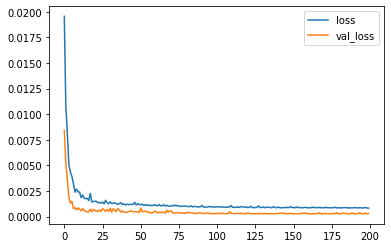

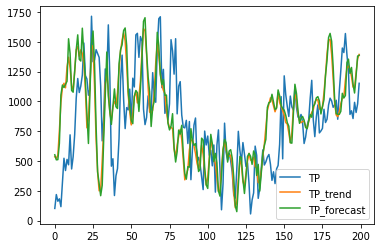

Model: "sequential_337"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1011 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1011 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1012 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1012 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1013 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1013 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_337 (Dense)            (None, 1)              

Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1897e-04 - accuracy: 5.9467e-05 - val_loss: 3.3334e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5497e-04 - accuracy: 5.9467e-05 - val_loss: 4.0090e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2085e-04 - accuracy: 5.9467e-05 - val_loss: 3.1620e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5110e-04 - accuracy: 5.9467e-05 - val_loss: 3.0785e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3064e-04 - accuracy: 5.9467e-05 - val_loss: 3.0028e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3471e-04 - accuracy: 5.9467e-05 - val_loss: 3.7407e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [========

Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4710e-04 - accuracy: 5.9467e-05 - val_loss: 3.4565e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4221e-04 - accuracy: 5.9467e-05 - val_loss: 2.7123e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7047e-04 - accuracy: 5.9467e-05 - val_loss: 3.4109e-04 - val_accuracy: 0.0000e+00


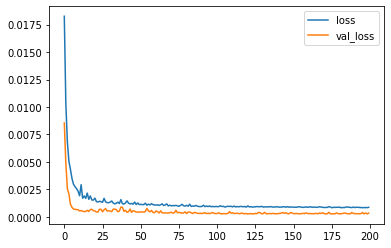

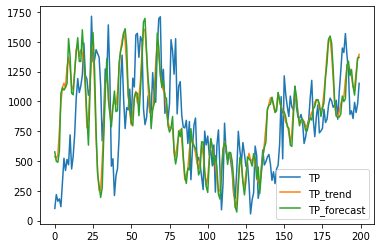

Model: "sequential_338"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1014 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1014 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1015 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1015 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1016 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1016 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_338 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.2940e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.3843e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.4823e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.8621e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.2323e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 4.4794e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/ste

Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.2312e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.5659e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.1343e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.5647e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8927e-04 - accuracy: 5.9467e-05 - val_loss: 4.6639e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.3079e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=========================

Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9452e-04 - accuracy: 5.9467e-05 - val_loss: 5.3552e-04 - val_accuracy: 0.0000e+00


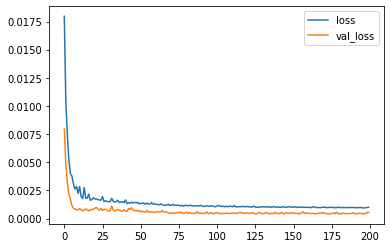

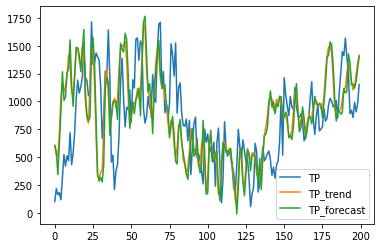

Model: "sequential_339"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1017 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1017 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1018 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1018 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1019 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1019 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_339 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.7269e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.4860e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 4.3947e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.6020e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.9398e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.9387e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 8s 15ms/ste

Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.5988e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 9.9546e-04 - accuracy: 5.9467e-05 - val_loss: 5.1410e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.3981e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 9.8370e-04 - accuracy: 5.9467e-05 - val_loss: 4.3301e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.4588e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.3774e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=====================

Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 9.9382e-04 - accuracy: 5.9467e-05 - val_loss: 4.2867e-04 - val_accuracy: 0.0000e+00


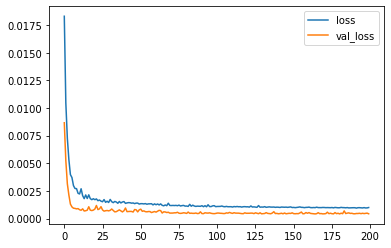

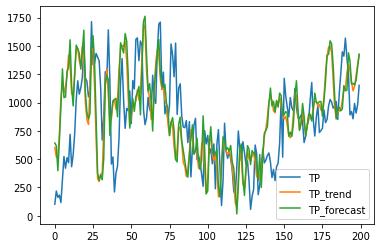

Model: "sequential_340"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1020 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1020 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1021 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1021 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1022 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1022 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_340 (Dense)            (None, 1)              

Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.8863e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.7607e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.2339e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 0.0012 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.7402e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 9.5060e-04 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 

Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.7215e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.3245e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.4473e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.0941e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.6100e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.8162e-04 - val_accuracy: 0.0000e+00
Epoch 157/200
526/526 [=============================

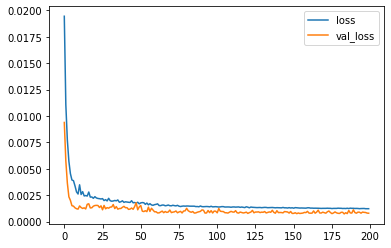

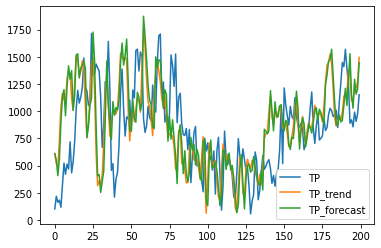

Model: "sequential_341"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1023 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1023 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1024 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1024 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1025 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1025 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_341 (Dense)            (None, 1)              

Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.7962e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 7.8972e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.8987e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.5211e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 7.9314e-04 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 8.5657e-04 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================

Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 8.0783e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 9.2422e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 9.0296e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 9.3999e-04 - val_accuracy: 0.0000e+00
Epoch 156/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 7.5980e-04 - val_accuracy: 0.0000e+00
Epoch 157/200
526/526 [==============================] -

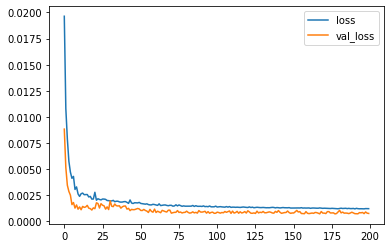

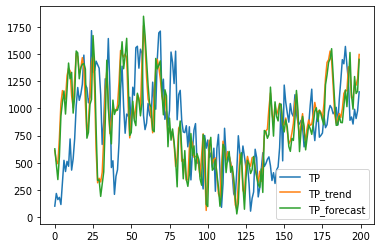

Model: "sequential_342"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1026 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1026 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1027 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1027 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1028 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1028 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_342 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0014 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0020 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0013 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0014 - val_accuracy: 0.0000e+00
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - accuracy: 5.9467e-05 - val_loss: 0.0015 - val_accuracy: 0.0000e+00
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0019 - acc

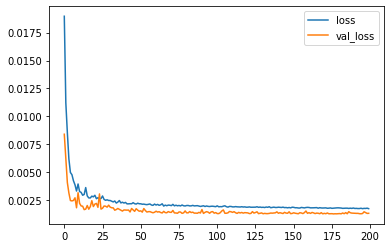

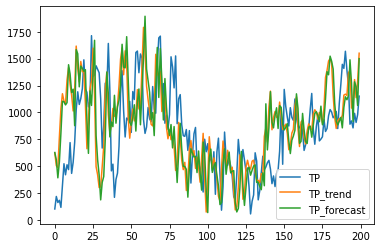

Model: "sequential_343"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1029 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1029 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1030 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1030 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1031 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1031 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_343 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7453e-06 - accuracy: 2.9734e-05 - val_loss: 2.4213e-06 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7201e-06 - accuracy: 2.9734e-05 - val_loss: 2.4311e-06 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7011e-06 - accuracy: 2.9734e-05 - val_loss: 2.5600e-06 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7291e-06 - accuracy: 2.9734e-05 - val_loss: 2.7129e-06 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7094e-06 - accuracy: 2.9734e-05 - val_loss: 2.5767e-06 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7080e-06 - accuracy: 2.9734e-05 - val_loss: 2.7226e-06 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4804e-06 - accuracy: 2.9734e-05 - val_loss: 1.8003e-06 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4760e-06 - accuracy: 2.9734e-05 - val_loss: 1.9208e-06 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4529e-06 - accuracy: 2.9734e-05 - val_loss: 1.7314e-06 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4493e-06 - accuracy: 2.9734e-05 - val_loss: 1.6913e-06 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4618e-06 - accuracy: 2.9734e-05 - val_loss: 1.6538e-06 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4425e-06 - accuracy: 2.9734e-05 - val_loss: 1.6661e-06 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 5.4760e-07 - accuracy: 2.9734e-05 - val_loss: 6.4515e-07 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 5.3558e-07 - accuracy: 2.9734e-05 - val_loss: 6.8733e-07 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 5.0780e-07 - accuracy: 2.9734e-05 - val_loss: 6.6639e-07 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 5.1142e-07 - accuracy: 2.9734e-05 - val_loss: 7.1676e-07 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 5.3220e-07 - accuracy: 2.9734e-05 - val_loss: 6.8854e-07 - val_accuracy: 0.0000e+00


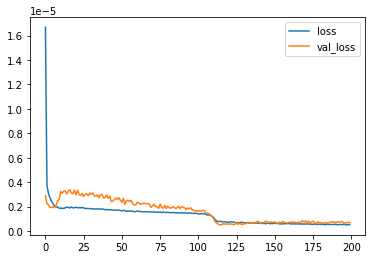

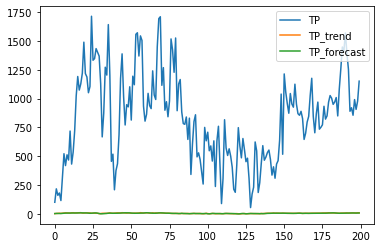

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_344"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1032 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1032 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1033 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1033 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1034 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1034 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_344 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5707e-09 - accuracy: 2.9734e-05 - val_loss: 2.7672e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5892e-09 - accuracy: 2.9734e-05 - val_loss: 2.8307e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5796e-09 - accuracy: 2.9734e-05 - val_loss: 2.8476e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5849e-09 - accuracy: 2.9734e-05 - val_loss: 2.8657e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5817e-09 - accuracy: 2.9734e-05 - val_loss: 2.8378e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5789e-09 - accuracy: 2.9734e-05 - val_loss: 2.8103e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5979e-09 - accuracy: 2.9734e-05 - val_loss: 2.8689e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6050e-09 - accuracy: 2.9734e-05 - val_loss: 2.7818e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6027e-09 - accuracy: 2.9734e-05 - val_loss: 2.9008e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6185e-09 - accuracy: 2.9734e-05 - val_loss: 2.8345e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6100e-09 - accuracy: 2.9734e-05 - val_loss: 2.8868e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6138e-09 - accuracy: 2.9734e-05 - val_loss: 2.8430e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6181e-09 - accuracy: 2.9734e-05 - val_loss: 2.8560e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6115e-09 - accuracy: 2.9734e-05 - val_loss: 2.8669e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6207e-09 - accuracy: 2.9734e-05 - val_loss: 2.8687e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6118e-09 - accuracy: 2.9734e-05 - val_loss: 2.8287e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6268e-09 - accuracy: 2.9734e-05 - val_loss: 2.9107e-09 - val_accuracy: 0.0000e+00


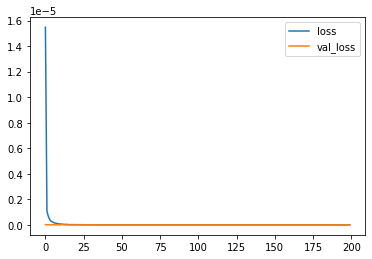

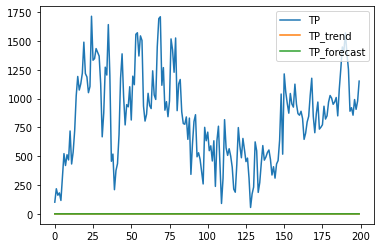

Model: "sequential_345"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1035 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1035 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1036 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1036 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1037 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1037 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_345 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 8.5323e-04 - accuracy: 0.0957 - val_loss: 5.9967e-05 - val_accuracy: 0.1169
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 0.0957 - val_loss: 1.1619e-04 - val_accuracy: 0.1169
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5542e-04 - accuracy: 0.0957 - val_loss: 4.5975e-05 - val_accuracy: 0.1169
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4679e-04 - accuracy: 0.0957 - val_loss: 8.8414e-05 - val_accuracy: 0.1169
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8171e-04 - accuracy: 0.0957 - val_loss: 7.1886e-05 - val_accuracy: 0.1169
Epoch 106/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2631e-04 - accuracy: 0.0957 - val_loss: 9.5628e-05 - val_accuracy: 0.1169
Epoch 107/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4950e-04 - acc

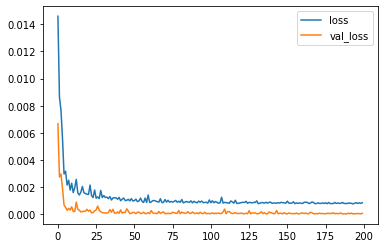

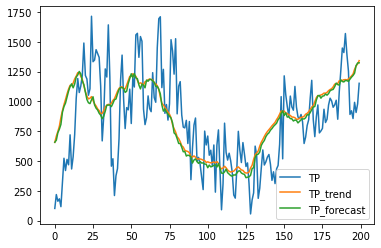

Model: "sequential_346"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1038 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1038 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1039 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1039 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1040 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1040 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_346 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5228e-04 - accuracy: 5.9467e-05 - val_loss: 1.1613e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 9.9670e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2011e-04 - accuracy: 5.9467e-05 - val_loss: 8.4700e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2183e-04 - accuracy: 5.9467e-05 - val_loss: 1.1128e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1639e-04 - accuracy: 5.9467e-05 - val_loss: 1.3456e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5832e-04 - accuracy: 5.9467e-05 - val_loss: 9.0583e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 7s 13ms/step - loss: 9.3979e-04 - accuracy: 5.9467e-05 - val_loss: 7.1757e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4921e-04 - accuracy: 5.9467e-05 - val_loss: 9.1375e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3056e-04 - accuracy: 5.9467e-05 - val_loss: 1.3092e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6675e-04 - accuracy: 5.9467e-05 - val_loss: 7.7853e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2351e-04 - accuracy: 5.9467e-05 - val_loss: 9.1832e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2995e-04 - accuracy: 5.9467e-05 - val_loss: 2.1413e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9857e-04 - accuracy: 5.9467e-05 - val_loss: 8.4849e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9724e-04 - accuracy: 5.9467e-05 - val_loss: 8.5000e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2038e-04 - accuracy: 5.9467e-05 - val_loss: 6.1938e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1635e-04 - accuracy: 5.9467e-05 - val_loss: 5.8189e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8184e-04 - accuracy: 5.9467e-05 - val_loss: 7.4125e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0120e-04 - accuracy: 5.9467e-05 - val_loss: 5.4016e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

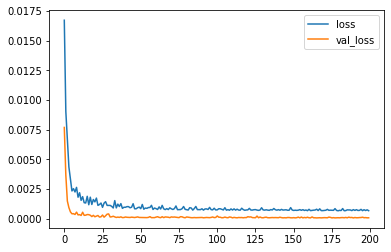

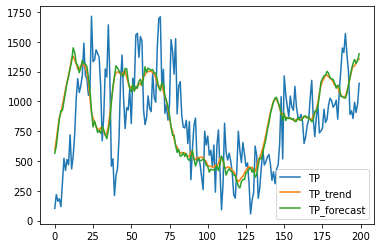

Model: "sequential_347"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1041 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1041 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1042 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1042 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1043 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1043 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_347 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 9.3025e-04 - accuracy: 5.9467e-05 - val_loss: 8.5973e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2804e-04 - accuracy: 5.9467e-05 - val_loss: 9.3593e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5838e-04 - accuracy: 5.9467e-05 - val_loss: 9.6814e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 9.0643e-04 - accuracy: 5.9467e-05 - val_loss: 7.7607e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2666e-04 - accuracy: 5.9467e-05 - val_loss: 1.0096e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6119e-04 - accuracy: 5.9467e-05 - val_loss: 9.3910e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

526/526 [==============================] - 8s 15ms/step - loss: 7.7854e-04 - accuracy: 5.9467e-05 - val_loss: 8.6308e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0226e-04 - accuracy: 5.9467e-05 - val_loss: 8.8738e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5235e-04 - accuracy: 5.9467e-05 - val_loss: 1.3556e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2394e-04 - accuracy: 5.9467e-05 - val_loss: 8.4799e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1939e-04 - accuracy: 5.9467e-05 - val_loss: 2.0090e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 7.7566e-04 - accuracy: 5.9467e-05 - val_loss: 6.7562e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9281e-04 - accuracy: 5.9467e-05 - val_loss: 9.7258e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9470e-04 - accuracy: 5.9467e-05 - val_loss: 6.6522e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9682e-04 - accuracy: 5.9467e-05 - val_loss: 7.2339e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 7.7954e-04 - accuracy: 5.9467e-05 - val_loss: 6.3065e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 7.4034e-04 - accuracy: 5.9467e-05 - val_loss: 6.6682e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 6.7704e-04 - accuracy: 5.9467e-05 - val_loss: 5.9847e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

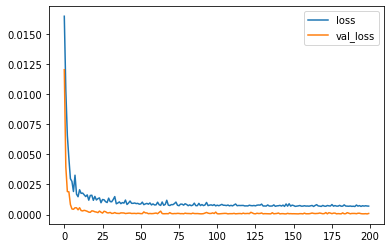

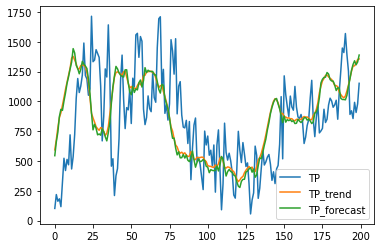

Model: "sequential_348"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1044 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1044 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1045 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1045 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1046 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1046 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_348 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5216e-04 - accuracy: 5.9467e-05 - val_loss: 1.0488e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3883e-04 - accuracy: 5.9467e-05 - val_loss: 1.7185e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6166e-04 - accuracy: 5.9467e-05 - val_loss: 9.8407e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6085e-04 - accuracy: 5.9467e-05 - val_loss: 9.1285e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4180e-04 - accuracy: 5.9467e-05 - val_loss: 1.2761e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.1135e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6526e-04 - accuracy: 5.9467e-05 - val_loss: 8.3828e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3650e-04 - accuracy: 5.9467e-05 - val_loss: 8.9862e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6646e-04 - accuracy: 5.9467e-05 - val_loss: 8.4954e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7101e-04 - accuracy: 5.9467e-05 - val_loss: 1.1012e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8852e-04 - accuracy: 5.9467e-05 - val_loss: 1.2584e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9897e-04 - accuracy: 5.9467e-05 - val_loss: 1.0593e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2176e-04 - accuracy: 5.9467e-05 - val_loss: 1.0747e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4294e-04 - accuracy: 5.9467e-05 - val_loss: 9.1364e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4968e-04 - accuracy: 5.9467e-05 - val_loss: 9.7731e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5470e-04 - accuracy: 5.9467e-05 - val_loss: 8.7860e-05 - val_accuracy: 0.0000e+00


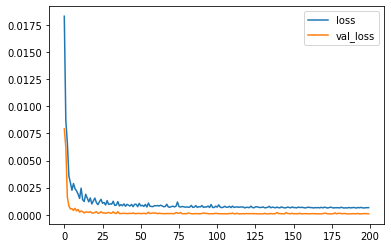

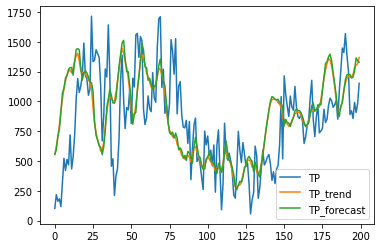

Model: "sequential_349"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1047 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1047 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1048 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1048 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1049 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1049 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_349 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 3.8988e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2114e-04 - accuracy: 5.9467e-05 - val_loss: 1.3310e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8168e-04 - accuracy: 5.9467e-05 - val_loss: 1.1806e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9003e-04 - accuracy: 5.9467e-05 - val_loss: 9.5512e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6380e-04 - accuracy: 5.9467e-05 - val_loss: 9.9367e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4913e-04 - accuracy: 5.9467e-05 - val_loss: 1.2139e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9454e-04 - accuracy: 5.9467e-05 - val_loss: 1.0006e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1009e-04 - accuracy: 5.9467e-05 - val_loss: 1.1305e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9986e-04 - accuracy: 5.9467e-05 - val_loss: 9.2042e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6884e-04 - accuracy: 5.9467e-05 - val_loss: 1.0027e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7467e-04 - accuracy: 5.9467e-05 - val_loss: 8.8926e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3734e-04 - accuracy: 5.9467e-05 - val_loss: 1.2113e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2464e-04 - accuracy: 5.9467e-05 - val_loss: 9.4287e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2019e-04 - accuracy: 5.9467e-05 - val_loss: 1.0086e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2996e-04 - accuracy: 5.9467e-05 - val_loss: 1.1016e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3006e-04 - accuracy: 5.9467e-05 - val_loss: 9.5766e-05 - val_accuracy: 0.0000e+00


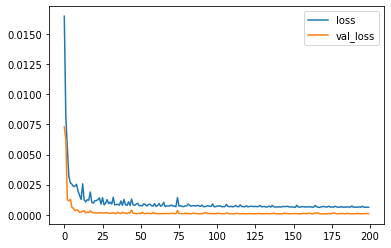

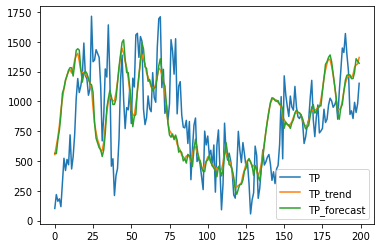

Model: "sequential_350"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1050 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1050 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1051 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1051 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1052 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1052 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_350 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.2763e-04 - accuracy: 5.9467e-05 - val_loss: 1.6543e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1015e-04 - accuracy: 5.9467e-05 - val_loss: 1.5101e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9398e-04 - accuracy: 5.9467e-05 - val_loss: 2.4040e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4293e-04 - accuracy: 5.9467e-05 - val_loss: 1.5714e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3412e-04 - accuracy: 5.9467e-05 - val_loss: 1.8189e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.0996e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [=============================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6149e-04 - accuracy: 5.9467e-05 - val_loss: 1.2749e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5394e-04 - accuracy: 5.9467e-05 - val_loss: 1.2514e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1828e-04 - accuracy: 5.9467e-05 - val_loss: 2.0610e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3845e-04 - accuracy: 5.9467e-05 - val_loss: 1.3131e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2996e-04 - accuracy: 5.9467e-05 - val_loss: 1.4895e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2221e-04 - accuracy: 5.9467e-05 - val_loss: 1.2486e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

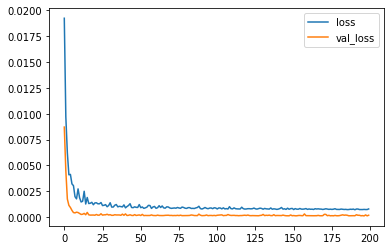

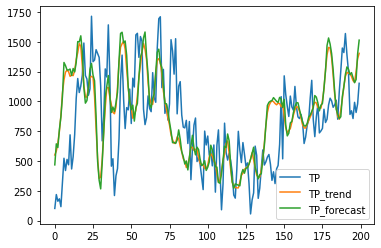

Model: "sequential_351"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1053 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1053 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1054 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1054 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1055 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1055 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_351 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 3.9209e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.9052e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5288e-04 - accuracy: 5.9467e-05 - val_loss: 1.8476e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.7802e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5903e-04 - accuracy: 5.9467e-05 - val_loss: 1.4944e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5350e-04 - accuracy: 5.9467e-05 - val_loss: 1.5372e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [========================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 7.8255e-04 - accuracy: 5.9467e-05 - val_loss: 1.4519e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0348e-04 - accuracy: 5.9467e-05 - val_loss: 1.7671e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3761e-04 - accuracy: 5.9467e-05 - val_loss: 1.2821e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9922e-04 - accuracy: 5.9467e-05 - val_loss: 1.8211e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3806e-04 - accuracy: 5.9467e-05 - val_loss: 1.3700e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 7.4644e-04 - accuracy: 5.9467e-05 - val_loss: 1.7120e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

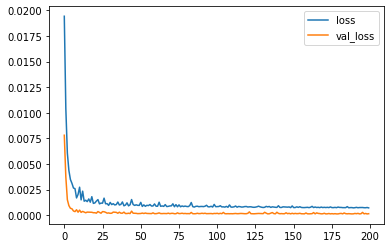

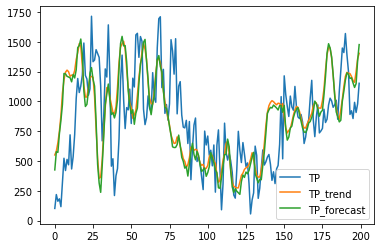

Model: "sequential_352"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1056 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1056 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1057 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1057 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1058 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1058 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_352 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.5999e-04 - accuracy: 5.9467e-05 - val_loss: 2.2221e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.3011e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8700e-04 - accuracy: 5.9467e-05 - val_loss: 2.0237e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9400e-04 - accuracy: 5.9467e-05 - val_loss: 2.1765e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9836e-04 - accuracy: 5.9467e-05 - val_loss: 2.4757e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7209e-04 - accuracy: 5.9467e-05 - val_loss: 2.1407e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [=============================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7449e-04 - accuracy: 5.9467e-05 - val_loss: 1.4530e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6496e-04 - accuracy: 5.9467e-05 - val_loss: 1.6423e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3966e-04 - accuracy: 5.9467e-05 - val_loss: 1.4832e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2463e-04 - accuracy: 5.9467e-05 - val_loss: 1.6069e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5492e-04 - accuracy: 5.9467e-05 - val_loss: 1.5738e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3992e-04 - accuracy: 5.9467e-05 - val_loss: 2.0783e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

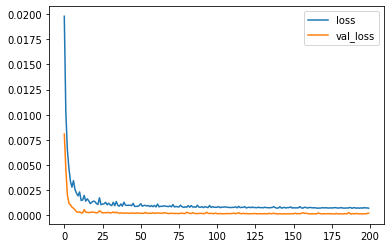

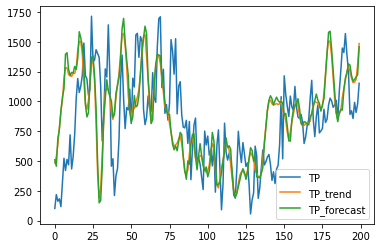

Model: "sequential_353"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1059 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1059 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1060 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1060 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1061 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1061 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_353 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.2324e-04 - accuracy: 5.9467e-05 - val_loss: 1.8008e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5483e-04 - accuracy: 5.9467e-05 - val_loss: 1.8899e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1656e-04 - accuracy: 5.9467e-05 - val_loss: 2.2263e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8874e-04 - accuracy: 5.9467e-05 - val_loss: 1.9626e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9715e-04 - accuracy: 5.9467e-05 - val_loss: 1.6670e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9927e-04 - accuracy: 5.9467e-05 - val_loss: 1.9247e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2821e-04 - accuracy: 5.9467e-05 - val_loss: 1.5664e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3206e-04 - accuracy: 5.9467e-05 - val_loss: 1.7907e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6323e-04 - accuracy: 5.9467e-05 - val_loss: 1.4750e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2847e-04 - accuracy: 5.9467e-05 - val_loss: 1.5540e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5370e-04 - accuracy: 5.9467e-05 - val_loss: 1.6263e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3223e-04 - accuracy: 5.9467e-05 - val_loss: 1.6526e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

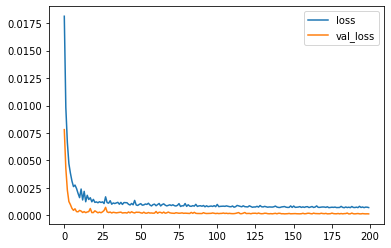

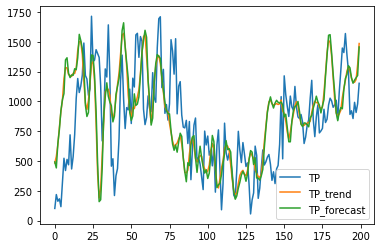

Model: "sequential_354"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1062 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1062 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1063 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1063 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1064 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1064 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_354 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.8372e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.5072e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2409e-04 - accuracy: 5.9467e-05 - val_loss: 2.6046e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.9518e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6771e-04 - accuracy: 5.9467e-05 - val_loss: 2.4889e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9098e-04 - accuracy: 5.9467e-05 - val_loss: 2.5641e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] -

Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1163e-04 - accuracy: 5.9467e-05 - val_loss: 2.6806e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1359e-04 - accuracy: 5.9467e-05 - val_loss: 3.0797e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4850e-04 - accuracy: 5.9467e-05 - val_loss: 2.5323e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5589e-04 - accuracy: 5.9467e-05 - val_loss: 3.5642e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1011e-04 - accuracy: 5.9467e-05 - val_loss: 3.0482e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9207e-04 - accuracy: 5.9467e-05 - val_loss: 2.4860e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

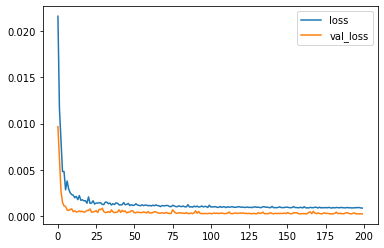

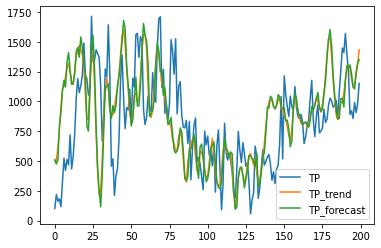

Model: "sequential_355"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1065 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1065 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1066 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1066 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1067 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1067 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_355 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 9.7955e-04 - accuracy: 5.9467e-05 - val_loss: 3.8272e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.7188e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 9.7443e-04 - accuracy: 5.9467e-05 - val_loss: 3.5627e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5803e-04 - accuracy: 5.9467e-05 - val_loss: 3.8263e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 14ms/step - loss: 9.6619e-04 - accuracy: 5.9467e-05 - val_loss: 3.7566e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5785e-04 - accuracy: 5.9467e-05 - val_loss: 2.7140e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [=========================

Epoch 148/200
526/526 [==============================] - 8s 14ms/step - loss: 9.5276e-04 - accuracy: 5.9467e-05 - val_loss: 2.3507e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2274e-04 - accuracy: 5.9467e-05 - val_loss: 2.4639e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 9.0469e-04 - accuracy: 5.9467e-05 - val_loss: 2.4719e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 14ms/step - loss: 9.6095e-04 - accuracy: 5.9467e-05 - val_loss: 2.3238e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 9.0527e-04 - accuracy: 5.9467e-05 - val_loss: 2.3411e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 15ms/step - loss: 9.6420e-04 - accuracy: 5.9467e-05 - val_loss: 2.5384e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

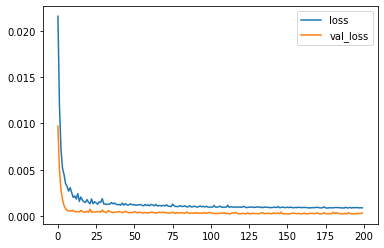

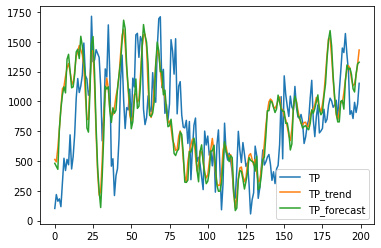

Model: "sequential_356"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1068 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1068 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1069 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1069 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1070 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1070 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_356 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.4857e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7541e-04 - accuracy: 5.9467e-05 - val_loss: 4.7928e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.8675e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.6396e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.8786e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7463e-04 - accuracy: 5.9467e-05 - val_loss: 3.4240e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 

Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1127e-04 - accuracy: 5.9467e-05 - val_loss: 3.0987e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3056e-04 - accuracy: 5.9467e-05 - val_loss: 4.2713e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0823e-04 - accuracy: 5.9467e-05 - val_loss: 3.4854e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5468e-04 - accuracy: 5.9467e-05 - val_loss: 3.0276e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1008e-04 - accuracy: 5.9467e-05 - val_loss: 3.3515e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2747e-04 - accuracy: 5.9467e-05 - val_loss: 4.2439e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

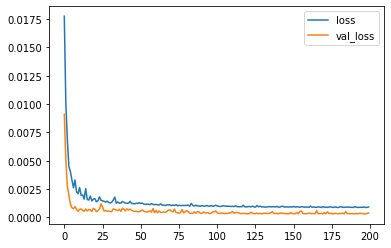

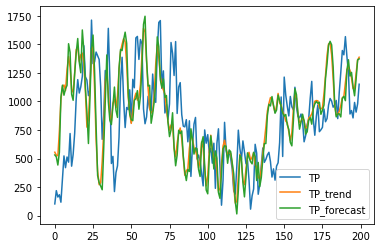

Model: "sequential_357"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1071 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1071 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1072 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1072 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1073 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1073 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_357 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.6074e-04 - accuracy: 5.9467e-05 - val_loss: 3.3302e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7922e-04 - accuracy: 5.9467e-05 - val_loss: 3.3061e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5184e-04 - accuracy: 5.9467e-05 - val_loss: 3.2644e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.5215e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.2731e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.3943e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] -

Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2858e-04 - accuracy: 5.9467e-05 - val_loss: 3.1958e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1334e-04 - accuracy: 5.9467e-05 - val_loss: 3.2128e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9348e-04 - accuracy: 5.9467e-05 - val_loss: 3.5617e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0541e-04 - accuracy: 5.9467e-05 - val_loss: 3.7451e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8347e-04 - accuracy: 5.9467e-05 - val_loss: 3.1307e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8496e-04 - accuracy: 5.9467e-05 - val_loss: 3.3788e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

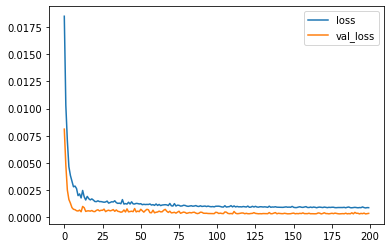

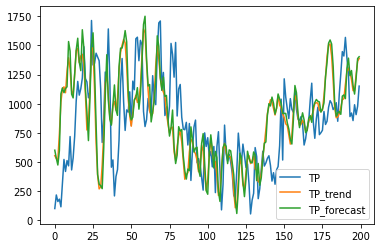

Model: "sequential_358"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1074 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1074 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1075 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1075 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1076 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1076 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_358 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 5.1037e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.0200e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.0163e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 5.3648e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.0465e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.5582e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 13ms/ste

Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.8636e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.4692e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.4295e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.8835e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 5.1227e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.1464e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=============================

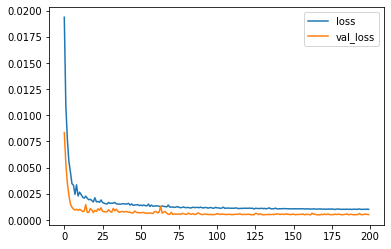

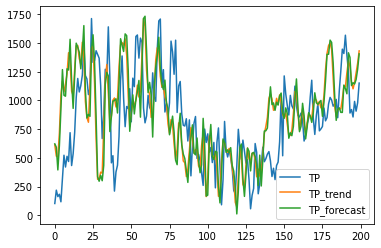

Model: "sequential_359"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1077 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1077 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1078 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1078 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1079 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1079 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_359 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.0680e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 5.7169e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.9798e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 5.3539e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 6.2051e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 5.4063e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 8s 15ms/ste

Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.1817e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.9101e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.8383e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.9671e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.7680e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.1006e-04 - val_accuracy: 0.0000e+00
Epoch 155/200
526/526 [=============================

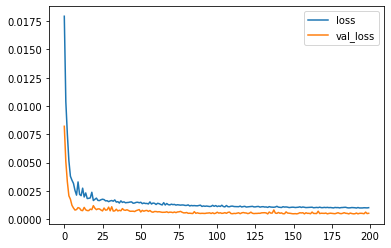

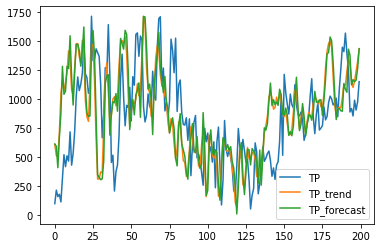

Model: "sequential_360"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1080 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1080 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1081 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1081 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1082 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1082 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_360 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3798e-07 - accuracy: 2.9734e-05 - val_loss: 2.5070e-07 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4697e-07 - accuracy: 2.9734e-05 - val_loss: 2.5984e-07 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3703e-07 - accuracy: 2.9734e-05 - val_loss: 2.6063e-07 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3823e-07 - accuracy: 2.9734e-05 - val_loss: 2.5878e-07 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 2.4346e-07 - accuracy: 2.9734e-05 - val_loss: 2.3504e-07 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3658e-07 - accuracy: 2.9734e-05 - val_loss: 2.5754e-07 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3792e-07 - accuracy: 2.9734e-05 - val_loss: 2.3466e-07 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2596e-07 - accuracy: 2.9734e-05 - val_loss: 2.3200e-07 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2426e-07 - accuracy: 2.9734e-05 - val_loss: 2.2551e-07 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2922e-07 - accuracy: 2.9734e-05 - val_loss: 2.2856e-07 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2610e-07 - accuracy: 2.9734e-05 - val_loss: 2.5773e-07 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2683e-07 - accuracy: 2.9734e-05 - val_loss: 2.5057e-07 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1679e-07 - accuracy: 2.9734e-05 - val_loss: 2.1134e-07 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1625e-07 - accuracy: 2.9734e-05 - val_loss: 2.1860e-07 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 2.1475e-07 - accuracy: 2.9734e-05 - val_loss: 2.0087e-07 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 2.1238e-07 - accuracy: 2.9734e-05 - val_loss: 2.2458e-07 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 2.1352e-07 - accuracy: 2.9734e-05 - val_loss: 2.2846e-07 - val_accuracy: 0.0000e+00


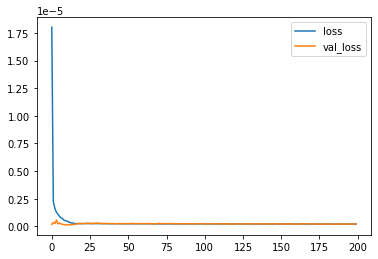

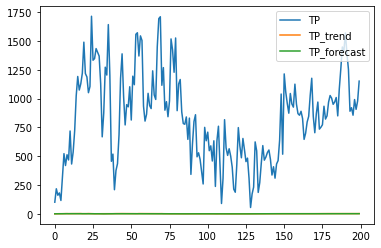

Model: "sequential_361"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1083 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1083 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1084 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1084 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1085 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1085 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_361 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7870e-10 - accuracy: 2.9734e-05 - val_loss: 2.6456e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1745e-10 - accuracy: 2.9734e-05 - val_loss: 2.2027e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8879e-10 - accuracy: 2.9734e-05 - val_loss: 6.4850e-11 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2255e-10 - accuracy: 2.9734e-05 - val_loss: 5.2617e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6035e-10 - accuracy: 2.9734e-05 - val_loss: 3.9833e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6534e-10 - accuracy: 2.9734e-05 - val_loss: 1.7973e-11 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1065e-10 - accuracy: 2.9734e-05 - val_loss: 2.6542e-11 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8931e-10 - accuracy: 2.9734e-05 - val_loss: 1.6901e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6429e-10 - accuracy: 2.9734e-05 - val_loss: 6.6269e-11 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5613e-10 - accuracy: 2.9734e-05 - val_loss: 6.8436e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8017e-10 - accuracy: 2.9734e-05 - val_loss: 4.0802e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7252e-10 - accuracy: 2.9734e-05 - val_loss: 2.5998e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3990e-10 - accuracy: 2.9734e-05 - val_loss: 1.2567e-11 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7901e-10 - accuracy: 2.9734e-05 - val_loss: 1.1429e-12 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9809e-10 - accuracy: 2.9734e-05 - val_loss: 1.1109e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7612e-10 - accuracy: 2.9734e-05 - val_loss: 1.7828e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7175e-10 - accuracy: 2.9734e-05 - val_loss: 7.8987e-13 - val_accuracy: 0.0000e+00


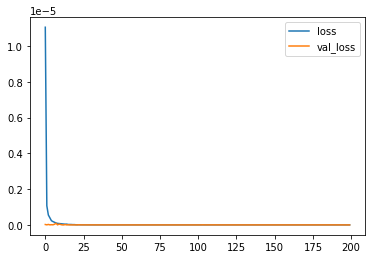

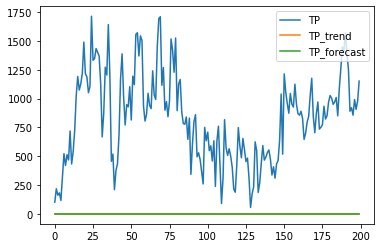

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_362"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1086 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1086 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1087 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1087 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1088 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1088 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_362 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0290e-10 - accuracy: 2.9734e-05 - val_loss: 1.4718e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8507e-10 - accuracy: 2.9734e-05 - val_loss: 6.6354e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7366e-10 - accuracy: 2.9734e-05 - val_loss: 6.6223e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7692e-10 - accuracy: 2.9734e-05 - val_loss: 1.4668e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7863e-10 - accuracy: 2.9734e-05 - val_loss: 1.6617e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8186e-10 - accuracy: 2.9734e-05 - val_loss: 1.1473e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5905e-10 - accuracy: 2.9734e-05 - val_loss: 7.3980e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6774e-10 - accuracy: 2.9734e-05 - val_loss: 7.3087e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8196e-10 - accuracy: 2.9734e-05 - val_loss: 8.7812e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7022e-10 - accuracy: 2.9734e-05 - val_loss: 1.0627e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6128e-10 - accuracy: 2.9734e-05 - val_loss: 8.7973e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7509e-10 - accuracy: 2.9734e-05 - val_loss: 5.7086e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6139e-10 - accuracy: 2.9734e-05 - val_loss: 7.5048e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6219e-10 - accuracy: 2.9734e-05 - val_loss: 6.3084e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6088e-10 - accuracy: 2.9734e-05 - val_loss: 3.8062e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7113e-10 - accuracy: 2.9734e-05 - val_loss: 8.9456e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7109e-10 - accuracy: 2.9734e-05 - val_loss: 1.6739e-09 - val_accuracy: 0.0000e+00


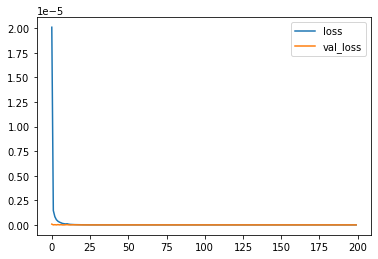

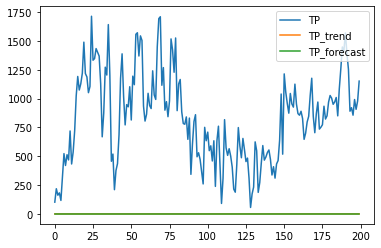

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_363"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1089 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1089 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1090 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1090 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1091 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1091 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_363 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4503e-10 - accuracy: 2.9734e-05 - val_loss: 1.1156e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 6.8948e-10 - accuracy: 2.9734e-05 - val_loss: 2.4103e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 7.4591e-10 - accuracy: 2.9734e-05 - val_loss: 6.0671e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 7.4587e-10 - accuracy: 2.9734e-05 - val_loss: 1.9985e-11 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4780e-10 - accuracy: 2.9734e-05 - val_loss: 1.0038e-11 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2376e-10 - accuracy: 2.9734e-05 - val_loss: 1.2448e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 7.8060e-10 - accuracy: 2.9734e-05 - val_loss: 3.0508e-11 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 6.2958e-10 - accuracy: 2.9734e-05 - val_loss: 4.9757e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9533e-10 - accuracy: 2.9734e-05 - val_loss: 1.6361e-12 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 8.3655e-10 - accuracy: 2.9734e-05 - val_loss: 3.2239e-13 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 6.2329e-10 - accuracy: 2.9734e-05 - val_loss: 2.1690e-11 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0345e-10 - accuracy: 2.9734e-05 - val_loss: 3.3016e-11 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 7.0998e-10 - accuracy: 2.9734e-05 - val_loss: 1.7379e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 6.8084e-10 - accuracy: 2.9734e-05 - val_loss: 8.4981e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 6.7419e-10 - accuracy: 2.9734e-05 - val_loss: 3.4204e-11 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6300e-10 - accuracy: 2.9734e-05 - val_loss: 1.5914e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2561e-10 - accuracy: 2.9734e-05 - val_loss: 1.2724e-11 - val_accuracy: 0.0000e+00


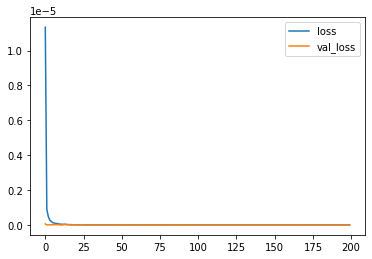

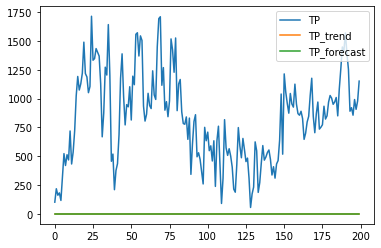

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_364"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1092 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1092 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1093 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1093 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1094 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1094 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_364 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2952e-10 - accuracy: 2.9734e-05 - val_loss: 3.1735e-11 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7636e-10 - accuracy: 2.9734e-05 - val_loss: 7.7277e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7107e-10 - accuracy: 2.9734e-05 - val_loss: 9.4282e-12 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7233e-10 - accuracy: 2.9734e-05 - val_loss: 1.0411e-08 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9751e-10 - accuracy: 2.9734e-05 - val_loss: 1.7608e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9813e-10 - accuracy: 2.9734e-05 - val_loss: 1.9550e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5273e-10 - accuracy: 2.9734e-05 - val_loss: 2.1605e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3462e-10 - accuracy: 2.9734e-05 - val_loss: 1.7637e-11 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9938e-10 - accuracy: 2.9734e-05 - val_loss: 5.6375e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5316e-10 - accuracy: 2.9734e-05 - val_loss: 1.4920e-11 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6685e-10 - accuracy: 2.9734e-05 - val_loss: 4.2761e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2862e-10 - accuracy: 2.9734e-05 - val_loss: 7.5725e-12 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0020e-10 - accuracy: 2.9734e-05 - val_loss: 1.1273e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3123e-10 - accuracy: 2.9734e-05 - val_loss: 1.3123e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4343e-10 - accuracy: 2.9734e-05 - val_loss: 3.6815e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6862e-10 - accuracy: 2.9734e-05 - val_loss: 5.3331e-12 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8004e-10 - accuracy: 2.9734e-05 - val_loss: 4.0375e-10 - val_accuracy: 0.0000e+00


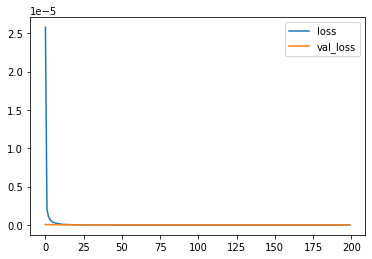

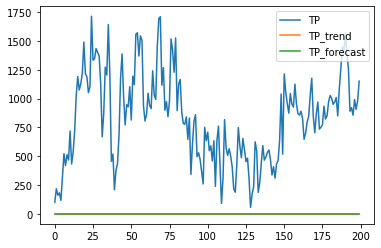

Model: "sequential_365"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1095 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1095 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1096 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1096 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1097 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1097 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_365 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 0.0892 - val_loss: 3.5093e-05 - val_accuracy: 0.1123
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5180e-04 - accuracy: 0.0892 - val_loss: 3.8948e-05 - val_accuracy: 0.1123
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4183e-04 - accuracy: 0.0892 - val_loss: 6.6066e-05 - val_accuracy: 0.1123
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2540e-04 - accuracy: 0.0892 - val_loss: 3.9237e-05 - val_accuracy: 0.1123
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 0.0892 - val_loss: 3.5758e-05 - val_accuracy: 0.1123
Epoch 106/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6499e-04 - accuracy: 0.0892 - val_loss: 4.3664e-05 - val_accuracy: 0.1123
Epoch 107/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5861e-04 - accurac

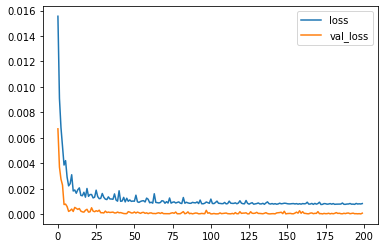

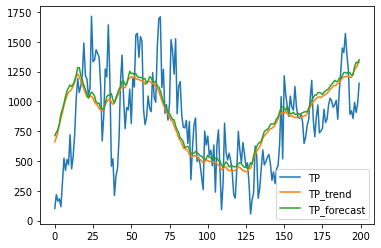

Model: "sequential_366"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1098 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1098 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1099 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1099 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1100 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1100 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_366 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 8.9477e-04 - accuracy: 2.9734e-05 - val_loss: 7.4604e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7547e-04 - accuracy: 2.9734e-05 - val_loss: 6.7256e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 2.9734e-05 - val_loss: 7.6169e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 8.1407e-04 - accuracy: 2.9734e-05 - val_loss: 1.1111e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 16ms/step - loss: 9.9024e-04 - accuracy: 2.9734e-05 - val_loss: 1.0330e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 9s 17ms/step - loss: 8.5076e-04 - accuracy: 2.9734e-05 - val_loss: 8.1778e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [=============================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6523e-04 - accuracy: 2.9734e-05 - val_loss: 4.3469e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4294e-04 - accuracy: 2.9734e-05 - val_loss: 5.1214e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9423e-04 - accuracy: 2.9734e-05 - val_loss: 4.8044e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 7.5139e-04 - accuracy: 2.9734e-05 - val_loss: 7.0627e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9586e-04 - accuracy: 2.9734e-05 - val_loss: 6.3400e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7847e-04 - accuracy: 2.9734e-05 - val_loss: 6.6037e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

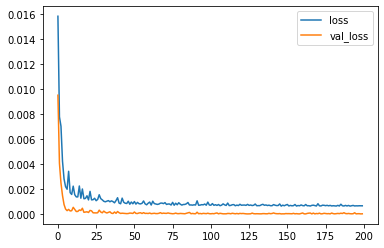

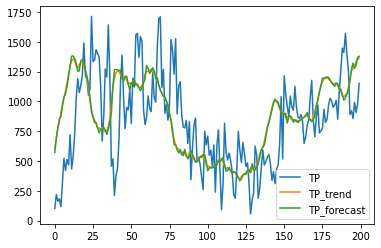

Model: "sequential_367"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1101 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1101 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1102 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1102 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1103 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1103 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_367 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 16ms/step - loss: 0.0011 - accuracy: 2.9734e-05 - val_loss: 6.8847e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 16ms/step - loss: 0.0010 - accuracy: 2.9734e-05 - val_loss: 1.0610e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 16ms/step - loss: 0.0011 - accuracy: 2.9734e-05 - val_loss: 1.6057e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 16ms/step - loss: 8.3669e-04 - accuracy: 2.9734e-05 - val_loss: 9.3013e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 16ms/step - loss: 8.8649e-04 - accuracy: 2.9734e-05 - val_loss: 1.2331e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 16ms/step - loss: 9.9271e-04 - accuracy: 2.9734e-05 - val_loss: 7.0307e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [========================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 6.7812e-04 - accuracy: 2.9734e-05 - val_loss: 4.8336e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 6.8210e-04 - accuracy: 2.9734e-05 - val_loss: 1.1154e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2253e-04 - accuracy: 2.9734e-05 - val_loss: 5.0867e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2123e-04 - accuracy: 2.9734e-05 - val_loss: 5.3823e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2792e-04 - accuracy: 2.9734e-05 - val_loss: 9.6814e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9114e-04 - accuracy: 2.9734e-05 - val_loss: 7.6206e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

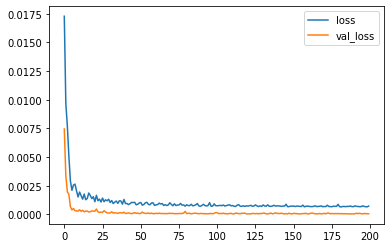

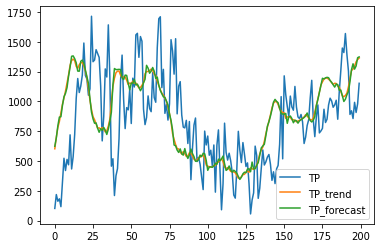

Model: "sequential_368"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1104 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1104 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1105 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1105 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1106 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1106 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_368 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 9.5517e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5589e-04 - accuracy: 5.9467e-05 - val_loss: 8.6708e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8710e-04 - accuracy: 5.9467e-05 - val_loss: 2.4157e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9658e-04 - accuracy: 5.9467e-05 - val_loss: 8.5581e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6596e-04 - accuracy: 5.9467e-05 - val_loss: 1.5394e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.7610e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3122e-04 - accuracy: 5.9467e-05 - val_loss: 7.8433e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7109e-04 - accuracy: 5.9467e-05 - val_loss: 7.7170e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7672e-04 - accuracy: 5.9467e-05 - val_loss: 6.8154e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6230e-04 - accuracy: 5.9467e-05 - val_loss: 1.3548e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1733e-04 - accuracy: 5.9467e-05 - val_loss: 8.2076e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4026e-04 - accuracy: 5.9467e-05 - val_loss: 6.8395e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3846e-04 - accuracy: 5.9467e-05 - val_loss: 1.0428e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2865e-04 - accuracy: 5.9467e-05 - val_loss: 7.7285e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1148e-04 - accuracy: 5.9467e-05 - val_loss: 8.7154e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2797e-04 - accuracy: 5.9467e-05 - val_loss: 7.9755e-05 - val_accuracy: 0.0000e+00


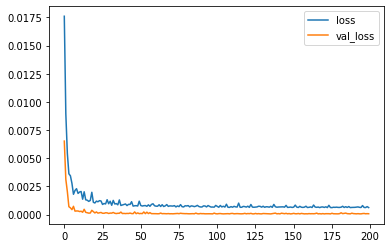

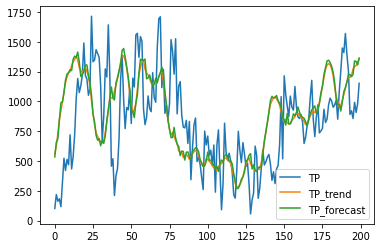

Model: "sequential_369"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1107 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1107 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1108 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1108 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1109 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1109 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_369 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.0717e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1223e-04 - accuracy: 5.9467e-05 - val_loss: 9.2595e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.3439e-04 - accuracy: 5.9467e-05 - val_loss: 9.6284e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2320e-04 - accuracy: 5.9467e-05 - val_loss: 9.7095e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 9.6876e-04 - accuracy: 5.9467e-05 - val_loss: 1.2437e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8088e-04 - accuracy: 5.9467e-05 - val_loss: 1.2233e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2254e-04 - accuracy: 5.9467e-05 - val_loss: 7.1160e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3700e-04 - accuracy: 5.9467e-05 - val_loss: 1.3086e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0314e-04 - accuracy: 5.9467e-05 - val_loss: 1.4126e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6467e-04 - accuracy: 5.9467e-05 - val_loss: 9.1867e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4342e-04 - accuracy: 5.9467e-05 - val_loss: 8.1275e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9784e-04 - accuracy: 5.9467e-05 - val_loss: 1.0663e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0610e-04 - accuracy: 5.9467e-05 - val_loss: 9.1064e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2757e-04 - accuracy: 5.9467e-05 - val_loss: 1.0921e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9982e-04 - accuracy: 5.9467e-05 - val_loss: 7.5629e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3343e-04 - accuracy: 5.9467e-05 - val_loss: 9.3179e-05 - val_accuracy: 0.0000e+00


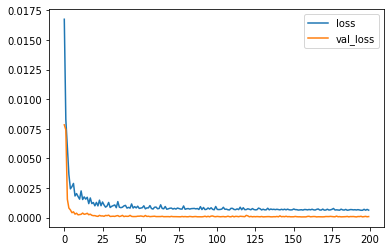

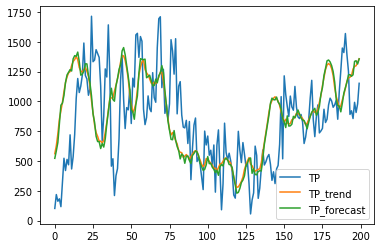

Model: "sequential_370"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1110 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1110 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1111 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1111 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1112 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1112 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_370 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1892e-04 - accuracy: 5.9467e-05 - val_loss: 2.0551e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3079e-04 - accuracy: 5.9467e-05 - val_loss: 1.4887e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1777e-04 - accuracy: 5.9467e-05 - val_loss: 1.2844e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2590e-04 - accuracy: 5.9467e-05 - val_loss: 1.2503e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5613e-04 - accuracy: 5.9467e-05 - val_loss: 1.1425e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0304e-04 - accuracy: 5.9467e-05 - val_loss: 1.3180e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2682e-04 - accuracy: 5.9467e-05 - val_loss: 1.3205e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1397e-04 - accuracy: 5.9467e-05 - val_loss: 1.3809e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2255e-04 - accuracy: 5.9467e-05 - val_loss: 1.0772e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5533e-04 - accuracy: 5.9467e-05 - val_loss: 1.6875e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1337e-04 - accuracy: 5.9467e-05 - val_loss: 1.1033e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0854e-04 - accuracy: 5.9467e-05 - val_loss: 1.1577e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4819e-04 - accuracy: 5.9467e-05 - val_loss: 1.2145e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3843e-04 - accuracy: 5.9467e-05 - val_loss: 1.0156e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8237e-04 - accuracy: 5.9467e-05 - val_loss: 2.1682e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9689e-04 - accuracy: 5.9467e-05 - val_loss: 1.7113e-04 - val_accuracy: 0.0000e+00


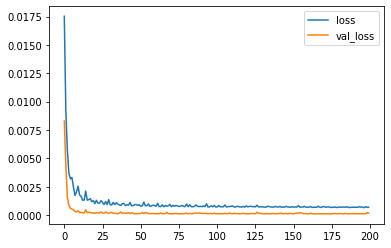

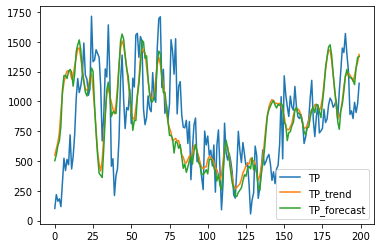

Model: "sequential_371"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1113 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1113 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1114 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1114 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1115 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1115 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_371 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 9s 16ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.5432e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 16ms/step - loss: 9.7775e-04 - accuracy: 5.9467e-05 - val_loss: 1.4751e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 16ms/step - loss: 8.2321e-04 - accuracy: 5.9467e-05 - val_loss: 1.2392e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 16ms/step - loss: 8.5126e-04 - accuracy: 5.9467e-05 - val_loss: 1.6627e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 16ms/step - loss: 9.7630e-04 - accuracy: 5.9467e-05 - val_loss: 1.1932e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 16ms/step - loss: 8.7560e-04 - accuracy: 5.9467e-05 - val_loss: 1.3079e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 8s 16ms/step - loss: 7.7332e-04 - accuracy: 5.9467e-05 - val_loss: 1.1354e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 16ms/step - loss: 7.7883e-04 - accuracy: 5.9467e-05 - val_loss: 1.1523e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 16ms/step - loss: 8.2356e-04 - accuracy: 5.9467e-05 - val_loss: 1.1809e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 16ms/step - loss: 7.2727e-04 - accuracy: 5.9467e-05 - val_loss: 1.3584e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 16ms/step - loss: 8.1008e-04 - accuracy: 5.9467e-05 - val_loss: 1.1443e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 16ms/step - loss: 7.4407e-04 - accuracy: 5.9467e-05 - val_loss: 1.0723e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 16ms/step - loss: 7.0025e-04 - accuracy: 5.9467e-05 - val_loss: 1.1073e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 9s 16ms/step - loss: 7.1361e-04 - accuracy: 5.9467e-05 - val_loss: 1.1924e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 9s 17ms/step - loss: 6.9362e-04 - accuracy: 5.9467e-05 - val_loss: 1.4783e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 9s 16ms/step - loss: 7.9709e-04 - accuracy: 5.9467e-05 - val_loss: 1.1822e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 16ms/step - loss: 6.9249e-04 - accuracy: 5.9467e-05 - val_loss: 1.4626e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 9s 16ms/step - loss: 6.8051e-04 - accuracy: 5.9467e-05 - val_loss: 1.1821e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

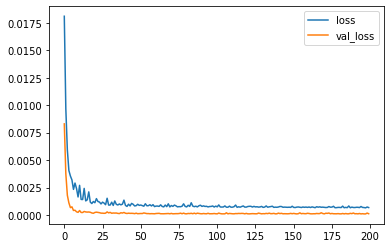

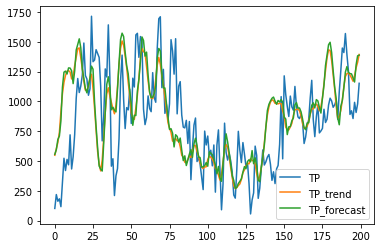

Model: "sequential_372"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1116 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1116 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1117 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1117 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1118 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1118 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_372 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.7777e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5647e-04 - accuracy: 5.9467e-05 - val_loss: 2.1198e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4391e-04 - accuracy: 5.9467e-05 - val_loss: 1.9117e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.2819e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4071e-04 - accuracy: 5.9467e-05 - val_loss: 1.6953e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 8.7537e-04 - accuracy: 5.9467e-05 - val_loss: 3.1217e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

526/526 [==============================] - 7s 14ms/step - loss: 7.4556e-04 - accuracy: 5.9467e-05 - val_loss: 2.0099e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7255e-04 - accuracy: 5.9467e-05 - val_loss: 1.8546e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3642e-04 - accuracy: 5.9467e-05 - val_loss: 1.7413e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9839e-04 - accuracy: 5.9467e-05 - val_loss: 1.6165e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8572e-04 - accuracy: 5.9467e-05 - val_loss: 2.8353e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4965e-04 - accuracy: 5.9467e-05 - val_loss: 1.6607e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 14ms/step - loss: 8.5792e-04 - accuracy: 5.9467e-05 - val_loss: 1.6914e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1863e-04 - accuracy: 5.9467e-05 - val_loss: 1.6583e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8376e-04 - accuracy: 5.9467e-05 - val_loss: 1.7525e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4504e-04 - accuracy: 5.9467e-05 - val_loss: 1.6192e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 14ms/step - loss: 7.4326e-04 - accuracy: 5.9467e-05 - val_loss: 1.5736e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1998e-04 - accuracy: 5.9467e-05 - val_loss: 1.7905e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

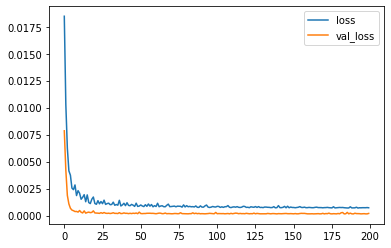

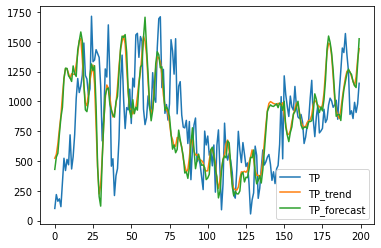

Model: "sequential_373"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1119 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1119 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1120 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1120 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1121 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1121 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_373 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.2384e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.7437e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.9101e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6429e-04 - accuracy: 5.9467e-05 - val_loss: 2.5912e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.2947e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 14ms/step - loss: 9.4291e-04 - accuracy: 5.9467e-05 - val_loss: 2.5113e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============================

Epoch 147/200
526/526 [==============================] - 8s 14ms/step - loss: 7.4510e-04 - accuracy: 5.9467e-05 - val_loss: 1.8137e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 14ms/step - loss: 7.7146e-04 - accuracy: 5.9467e-05 - val_loss: 1.9200e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 14ms/step - loss: 7.7312e-04 - accuracy: 5.9467e-05 - val_loss: 1.6572e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 7.2664e-04 - accuracy: 5.9467e-05 - val_loss: 1.7900e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 14ms/step - loss: 7.5981e-04 - accuracy: 5.9467e-05 - val_loss: 1.5407e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 14ms/step - loss: 7.9730e-04 - accuracy: 5.9467e-05 - val_loss: 1.6715e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

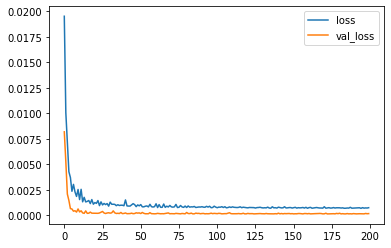

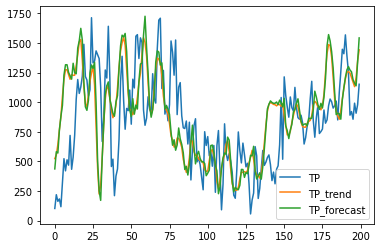

Model: "sequential_374"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1122 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1122 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1123 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1123 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1124 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1124 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_374 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 9.4382e-04 - accuracy: 5.9467e-05 - val_loss: 2.2354e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9286e-04 - accuracy: 5.9467e-05 - val_loss: 2.2203e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 9.2036e-04 - accuracy: 5.9467e-05 - val_loss: 2.5495e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4234e-04 - accuracy: 5.9467e-05 - val_loss: 2.7204e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2276e-04 - accuracy: 5.9467e-05 - val_loss: 2.3441e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.2588e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==========================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4812e-04 - accuracy: 5.9467e-05 - val_loss: 2.1596e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4705e-04 - accuracy: 5.9467e-05 - val_loss: 2.0754e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2965e-04 - accuracy: 5.9467e-05 - val_loss: 2.1022e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1786e-04 - accuracy: 5.9467e-05 - val_loss: 1.9148e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0693e-04 - accuracy: 5.9467e-05 - val_loss: 2.8255e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2669e-04 - accuracy: 5.9467e-05 - val_loss: 2.5202e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

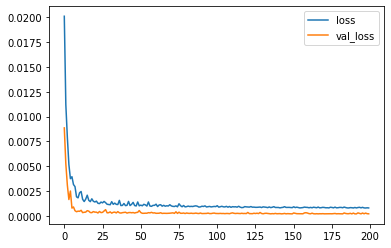

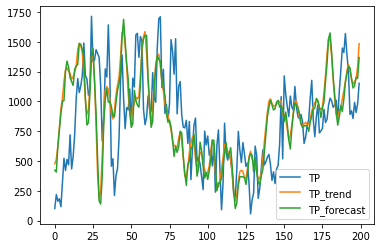

Model: "sequential_375"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1125 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1125 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1126 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1126 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1127 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1127 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_375 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 9.7285e-04 - accuracy: 5.9467e-05 - val_loss: 2.2686e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6530e-04 - accuracy: 5.9467e-05 - val_loss: 2.4030e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4208e-04 - accuracy: 5.9467e-05 - val_loss: 2.0737e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 9.7019e-04 - accuracy: 5.9467e-05 - val_loss: 2.2856e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4386e-04 - accuracy: 5.9467e-05 - val_loss: 2.4116e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2638e-04 - accuracy: 5.9467e-05 - val_loss: 2.2830e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 16ms/step - loss: 8.8067e-04 - accuracy: 5.9467e-05 - val_loss: 3.0657e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 16ms/step - loss: 8.0346e-04 - accuracy: 5.9467e-05 - val_loss: 2.0106e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 16ms/step - loss: 8.0567e-04 - accuracy: 5.9467e-05 - val_loss: 1.9722e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 16ms/step - loss: 8.2123e-04 - accuracy: 5.9467e-05 - val_loss: 2.0464e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 16ms/step - loss: 8.8735e-04 - accuracy: 5.9467e-05 - val_loss: 2.8305e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 16ms/step - loss: 8.4464e-04 - accuracy: 5.9467e-05 - val_loss: 2.4110e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

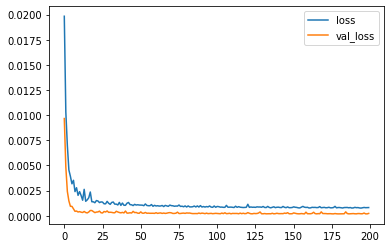

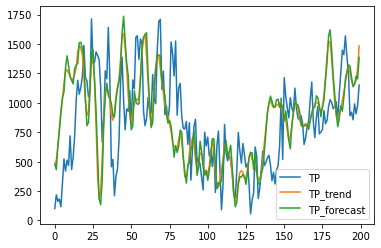

Model: "sequential_376"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1128 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1128 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1129 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1129 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1130 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1130 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_376 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 9.8639e-04 - accuracy: 5.9467e-05 - val_loss: 4.5003e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 9.8173e-04 - accuracy: 5.9467e-05 - val_loss: 2.8748e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.8357e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 9.7171e-04 - accuracy: 5.9467e-05 - val_loss: 3.6018e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 9.6783e-04 - accuracy: 5.9467e-05 - val_loss: 3.1141e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 9.3484e-04 - accuracy: 5.9467e-05 - val_loss: 2.7704e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [=========================

Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1055e-04 - accuracy: 5.9467e-05 - val_loss: 3.6788e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4872e-04 - accuracy: 5.9467e-05 - val_loss: 2.6776e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9393e-04 - accuracy: 5.9467e-05 - val_loss: 2.9073e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8760e-04 - accuracy: 5.9467e-05 - val_loss: 3.4608e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0402e-04 - accuracy: 5.9467e-05 - val_loss: 3.8770e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5775e-04 - accuracy: 5.9467e-05 - val_loss: 2.7911e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

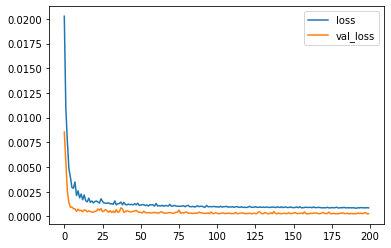

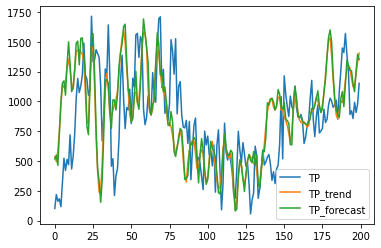

Model: "sequential_377"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1131 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1131 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1132 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1132 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1133 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1133 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_377 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 9.4575e-04 - accuracy: 5.9467e-05 - val_loss: 3.1190e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.8161e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4329e-04 - accuracy: 5.9467e-05 - val_loss: 4.1047e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 9.7943e-04 - accuracy: 5.9467e-05 - val_loss: 3.5481e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5887e-04 - accuracy: 5.9467e-05 - val_loss: 4.7844e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.5563e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [=============================

Epoch 148/200
526/526 [==============================] - 8s 14ms/step - loss: 9.2921e-04 - accuracy: 5.9467e-05 - val_loss: 3.1793e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 14ms/step - loss: 9.2957e-04 - accuracy: 5.9467e-05 - val_loss: 2.8512e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 8.8761e-04 - accuracy: 5.9467e-05 - val_loss: 3.4363e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 14ms/step - loss: 9.4477e-04 - accuracy: 5.9467e-05 - val_loss: 4.7327e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 14ms/step - loss: 8.8833e-04 - accuracy: 5.9467e-05 - val_loss: 3.7143e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 14ms/step - loss: 9.3069e-04 - accuracy: 5.9467e-05 - val_loss: 2.8434e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

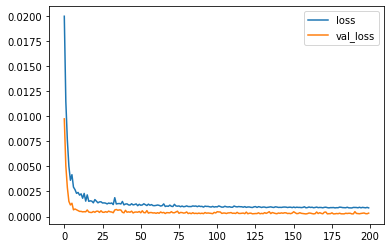

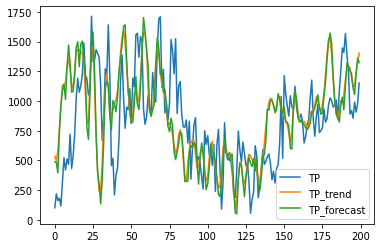

Model: "sequential_378"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1134 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1134 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1135 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1135 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1136 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1136 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_378 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.2190e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 4.8349e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.0268e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.0279e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.5849e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.0522e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 7s 14ms/ste

Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 9.6750e-04 - accuracy: 5.9467e-05 - val_loss: 4.5289e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4274e-04 - accuracy: 5.9467e-05 - val_loss: 4.4151e-04 - val_accuracy: 0.0000e+00


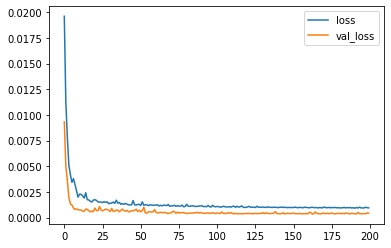

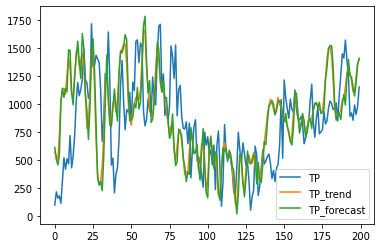

Model: "sequential_379"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1137 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1137 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1138 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1138 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1139 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1139 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_379 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.1644e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 4.8044e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 5.5385e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 3.8942e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.9288e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.9510e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] - 8s 15ms/ste

Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 9.0504e-04 - accuracy: 5.9467e-05 - val_loss: 3.5078e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2166e-04 - accuracy: 5.9467e-05 - val_loss: 4.2592e-04 - val_accuracy: 0.0000e+00


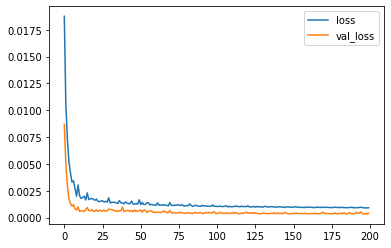

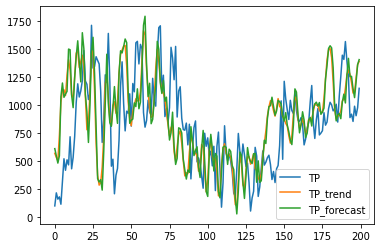

Model: "sequential_380"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1140 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1140 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1141 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1141 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1142 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1142 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_380 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6325e-07 - accuracy: 2.9734e-05 - val_loss: 3.4311e-08 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6274e-07 - accuracy: 2.9734e-05 - val_loss: 3.4973e-08 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6403e-07 - accuracy: 2.9734e-05 - val_loss: 3.5918e-08 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5947e-07 - accuracy: 2.9734e-05 - val_loss: 2.7892e-08 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6641e-07 - accuracy: 2.9734e-05 - val_loss: 5.8503e-08 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5825e-07 - accuracy: 2.9734e-05 - val_loss: 2.9042e-08 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5314e-07 - accuracy: 2.9734e-05 - val_loss: 4.8386e-08 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5176e-07 - accuracy: 2.9734e-05 - val_loss: 4.5586e-08 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5252e-07 - accuracy: 2.9734e-05 - val_loss: 4.3429e-08 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4764e-07 - accuracy: 2.9734e-05 - val_loss: 4.3937e-08 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4924e-07 - accuracy: 2.9734e-05 - val_loss: 3.7022e-08 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4785e-07 - accuracy: 2.9734e-05 - val_loss: 4.9314e-08 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3690e-07 - accuracy: 2.9734e-05 - val_loss: 2.9066e-08 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7752e-07 - accuracy: 2.9734e-05 - val_loss: 5.3931e-08 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9723e-07 - accuracy: 2.9734e-05 - val_loss: 5.6241e-08 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2134e-07 - accuracy: 2.9734e-05 - val_loss: 5.6074e-08 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6732e-07 - accuracy: 2.9734e-05 - val_loss: 2.1282e-08 - val_accuracy: 0.0000e+00


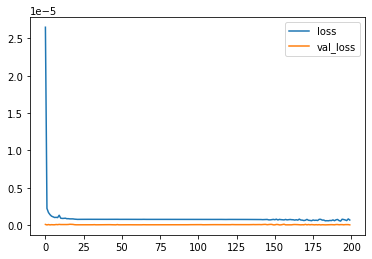

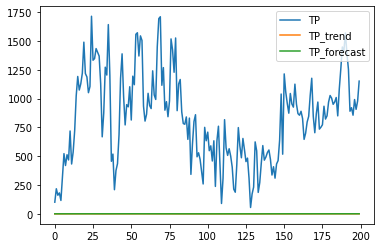

Model: "sequential_381"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1143 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1143 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1144 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1144 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1145 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1145 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_381 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5002e-07 - accuracy: 2.9734e-05 - val_loss: 3.7096e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4601e-07 - accuracy: 2.9734e-05 - val_loss: 5.8110e-11 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5077e-07 - accuracy: 2.9734e-05 - val_loss: 3.7786e-11 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4504e-07 - accuracy: 2.9734e-05 - val_loss: 3.4488e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4970e-07 - accuracy: 2.9734e-05 - val_loss: 2.0474e-11 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5379e-07 - accuracy: 2.9734e-05 - val_loss: 6.7733e-11 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7247e-07 - accuracy: 2.9734e-05 - val_loss: 4.0675e-11 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 6.1238e-07 - accuracy: 2.9734e-05 - val_loss: 1.7209e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 5.5523e-07 - accuracy: 2.9734e-05 - val_loss: 7.1693e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 5.0495e-07 - accuracy: 2.9734e-05 - val_loss: 2.8459e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9336e-07 - accuracy: 2.9734e-05 - val_loss: 6.4953e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9770e-07 - accuracy: 2.9734e-05 - val_loss: 1.8144e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4113e-07 - accuracy: 2.9734e-05 - val_loss: 1.4992e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 5.8826e-07 - accuracy: 2.9734e-05 - val_loss: 6.2139e-11 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 5.3333e-07 - accuracy: 2.9734e-05 - val_loss: 1.7198e-11 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 4.5385e-07 - accuracy: 2.9734e-05 - val_loss: 8.9896e-11 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 5.1250e-07 - accuracy: 2.9734e-05 - val_loss: 3.1626e-10 - val_accuracy: 0.0000e+00


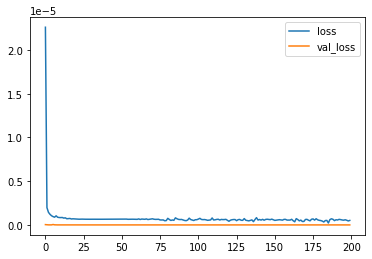

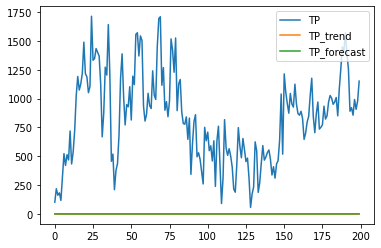

Model: "sequential_382"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1146 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1146 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1147 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1147 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1148 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1148 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_382 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4253e-07 - accuracy: 0.0000e+00 - val_loss: 1.5400e-11 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3830e-07 - accuracy: 0.0000e+00 - val_loss: 6.5396e-11 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3755e-07 - accuracy: 0.0000e+00 - val_loss: 9.1431e-11 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3525e-07 - accuracy: 0.0000e+00 - val_loss: 5.7614e-11 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5022e-07 - accuracy: 0.0000e+00 - val_loss: 4.9064e-11 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5333e-07 - accuracy: 0.0000e+00 - val_loss: 1.8728e-11 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 5.6564e-07 - accuracy: 0.0000e+00 - val_loss: 2.7457e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 5.1349e-07 - accuracy: 0.0000e+00 - val_loss: 7.0541e-11 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 5.8499e-07 - accuracy: 0.0000e+00 - val_loss: 2.9543e-11 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5945e-07 - accuracy: 0.0000e+00 - val_loss: 4.3875e-11 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 5.8172e-07 - accuracy: 0.0000e+00 - val_loss: 3.8274e-11 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 5.2797e-07 - accuracy: 0.0000e+00 - val_loss: 1.7898e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 4.8578e-07 - accuracy: 0.0000e+00 - val_loss: 1.3241e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 4.6648e-07 - accuracy: 0.0000e+00 - val_loss: 8.0139e-11 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 4.5481e-07 - accuracy: 0.0000e+00 - val_loss: 8.8532e-11 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0366e-07 - accuracy: 0.0000e+00 - val_loss: 1.1954e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 5.0654e-07 - accuracy: 0.0000e+00 - val_loss: 3.1248e-10 - val_accuracy: 1.1893e-04


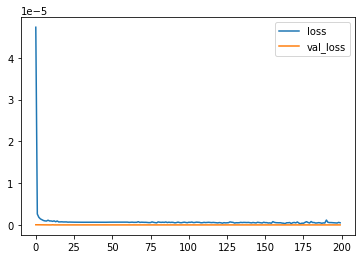

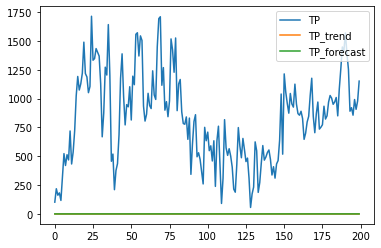

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_383"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1149 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1149 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1150 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1150 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1151 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1151 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_383 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3487e-07 - accuracy: 0.0000e+00 - val_loss: 2.7990e-13 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3130e-07 - accuracy: 0.0000e+00 - val_loss: 1.0792e-11 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3499e-07 - accuracy: 0.0000e+00 - val_loss: 8.1852e-12 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3727e-07 - accuracy: 0.0000e+00 - val_loss: 7.1039e-12 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3469e-07 - accuracy: 0.0000e+00 - val_loss: 3.9284e-12 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3411e-07 - accuracy: 0.0000e+00 - val_loss: 7.6906e-12 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3412e-07 - accuracy: 0.0000e+00 - val_loss: 6.1052e-12 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2638e-07 - accuracy: 0.0000e+00 - val_loss: 3.6220e-11 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3297e-07 - accuracy: 0.0000e+00 - val_loss: 8.7159e-11 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2712e-07 - accuracy: 0.0000e+00 - val_loss: 5.7061e-11 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2959e-07 - accuracy: 0.0000e+00 - val_loss: 1.8065e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3435e-07 - accuracy: 0.0000e+00 - val_loss: 7.3091e-12 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3126e-07 - accuracy: 0.0000e+00 - val_loss: 3.9304e-11 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 5.8036e-07 - accuracy: 0.0000e+00 - val_loss: 1.2427e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 5.0365e-07 - accuracy: 0.0000e+00 - val_loss: 2.0549e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3472e-07 - accuracy: 0.0000e+00 - val_loss: 2.0182e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 4.9247e-07 - accuracy: 0.0000e+00 - val_loss: 3.1410e-10 - val_accuracy: 1.1893e-04


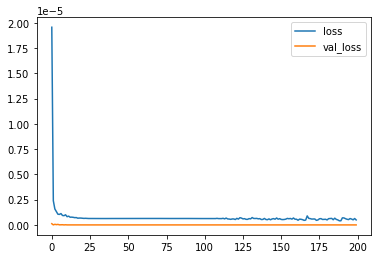

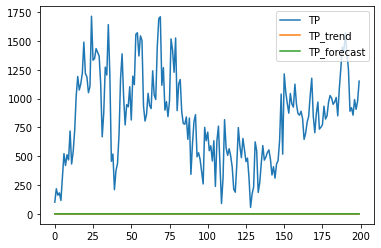

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_384"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1152 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1152 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1153 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1153 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1154 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1154 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_384 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2702e-07 - accuracy: 0.0000e+00 - val_loss: 6.6066e-12 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3084e-07 - accuracy: 0.0000e+00 - val_loss: 4.2173e-12 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2915e-07 - accuracy: 0.0000e+00 - val_loss: 7.1764e-12 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2970e-07 - accuracy: 0.0000e+00 - val_loss: 7.6540e-12 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2776e-07 - accuracy: 0.0000e+00 - val_loss: 1.4414e-12 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2680e-07 - accuracy: 0.0000e+00 - val_loss: 6.2202e-12 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2691e-07 - accuracy: 0.0000e+00 - val_loss: 7.9324e-12 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2527e-07 - accuracy: 0.0000e+00 - val_loss: 6.1479e-12 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2817e-07 - accuracy: 0.0000e+00 - val_loss: 3.0888e-12 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2786e-07 - accuracy: 0.0000e+00 - val_loss: 1.4265e-12 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2967e-07 - accuracy: 0.0000e+00 - val_loss: 3.5914e-12 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2810e-07 - accuracy: 0.0000e+00 - val_loss: 4.6784e-12 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2657e-07 - accuracy: 0.0000e+00 - val_loss: 3.8966e-13 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2736e-07 - accuracy: 0.0000e+00 - val_loss: 1.1119e-13 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2773e-07 - accuracy: 0.0000e+00 - val_loss: 1.5325e-12 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2762e-07 - accuracy: 0.0000e+00 - val_loss: 5.0064e-13 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2755e-07 - accuracy: 0.0000e+00 - val_loss: 1.1658e-13 - val_accuracy: 1.1893e-04


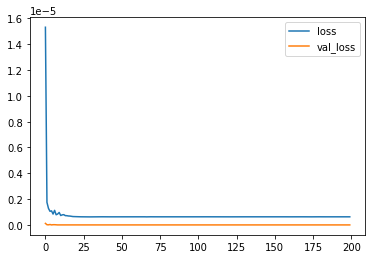

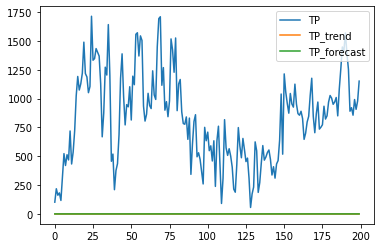

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_385"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1155 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1155 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1156 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1156 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1157 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1157 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_385 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9595e-07 - accuracy: 0.0000e+00 - val_loss: 7.2025e-11 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9561e-07 - accuracy: 0.0000e+00 - val_loss: 1.2231e-11 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9582e-07 - accuracy: 0.0000e+00 - val_loss: 2.0002e-11 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9994e-07 - accuracy: 0.0000e+00 - val_loss: 4.1825e-13 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9718e-07 - accuracy: 0.0000e+00 - val_loss: 2.5293e-11 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9530e-07 - accuracy: 0.0000e+00 - val_loss: 1.2134e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 5.7054e-07 - accuracy: 0.0000e+00 - val_loss: 7.3799e-11 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9828e-07 - accuracy: 0.0000e+00 - val_loss: 1.4841e-11 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4133e-07 - accuracy: 0.0000e+00 - val_loss: 1.1645e-11 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4880e-07 - accuracy: 0.0000e+00 - val_loss: 6.8811e-11 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5932e-07 - accuracy: 0.0000e+00 - val_loss: 6.2681e-12 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 5.4344e-07 - accuracy: 0.0000e+00 - val_loss: 8.9163e-11 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 4.9719e-07 - accuracy: 0.0000e+00 - val_loss: 5.6182e-11 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 5.0915e-07 - accuracy: 0.0000e+00 - val_loss: 3.8560e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 5.6312e-07 - accuracy: 0.0000e+00 - val_loss: 2.5698e-11 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 4.6365e-07 - accuracy: 0.0000e+00 - val_loss: 3.9809e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 4.6138e-07 - accuracy: 0.0000e+00 - val_loss: 2.1471e-10 - val_accuracy: 1.1893e-04


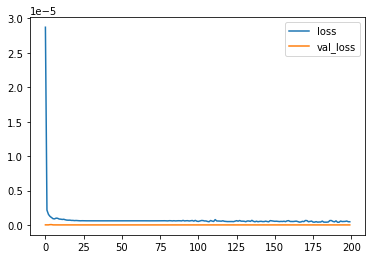

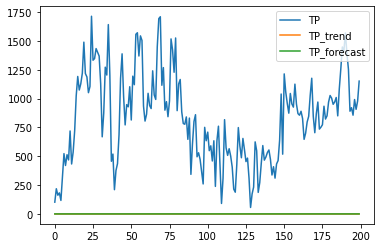

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_386"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1158 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1158 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1159 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1159 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1160 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1160 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_386 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0899e-07 - accuracy: 0.0000e+00 - val_loss: 9.2773e-12 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0822e-07 - accuracy: 0.0000e+00 - val_loss: 6.9591e-12 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0447e-07 - accuracy: 0.0000e+00 - val_loss: 2.3865e-11 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0553e-07 - accuracy: 0.0000e+00 - val_loss: 3.1077e-11 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9801e-07 - accuracy: 0.0000e+00 - val_loss: 5.8953e-11 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0614e-07 - accuracy: 0.0000e+00 - val_loss: 6.2036e-11 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0469e-07 - accuracy: 0.0000e+00 - val_loss: 7.8184e-11 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1113e-07 - accuracy: 0.0000e+00 - val_loss: 5.3819e-11 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5534e-07 - accuracy: 0.0000e+00 - val_loss: 3.9982e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6433e-07 - accuracy: 0.0000e+00 - val_loss: 3.1969e-11 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 5.3504e-07 - accuracy: 0.0000e+00 - val_loss: 9.8494e-11 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 5.4303e-07 - accuracy: 0.0000e+00 - val_loss: 2.5834e-11 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 5.4970e-07 - accuracy: 0.0000e+00 - val_loss: 8.7507e-11 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5350e-07 - accuracy: 0.0000e+00 - val_loss: 2.7395e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 4.9475e-07 - accuracy: 0.0000e+00 - val_loss: 1.2035e-11 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.0762e-07 - accuracy: 0.0000e+00 - val_loss: 2.1570e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 5.6123e-07 - accuracy: 0.0000e+00 - val_loss: 8.8527e-10 - val_accuracy: 1.1893e-04


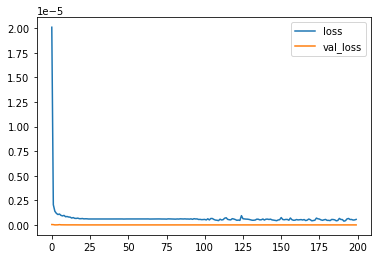

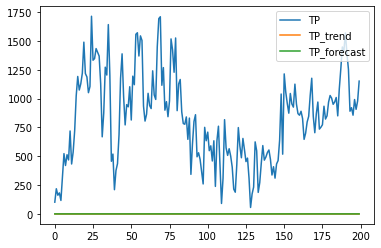

Model: "sequential_387"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1161 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1161 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1162 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1162 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1163 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1163 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_387 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 8.6335e-04 - accuracy: 0.0834 - val_loss: 1.5809e-04 - val_accuracy: 0.1079
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 9.3183e-04 - accuracy: 0.0834 - val_loss: 5.9170e-05 - val_accuracy: 0.1079
Epoch 103/200
526/526 [==============================] - 8s 15ms/step - loss: 8.3277e-04 - accuracy: 0.0834 - val_loss: 1.1017e-04 - val_accuracy: 0.1079
Epoch 104/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 0.0834 - val_loss: 3.3523e-05 - val_accuracy: 0.1079
Epoch 105/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4791e-04 - accuracy: 0.0834 - val_loss: 8.1503e-05 - val_accuracy: 0.1079
Epoch 106/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7756e-04 - accuracy: 0.0834 - val_loss: 8.4157e-05 - val_accuracy: 0.1079
Epoch 107/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7203e-04 - acc

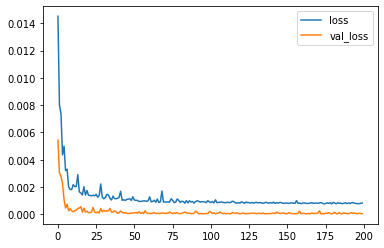

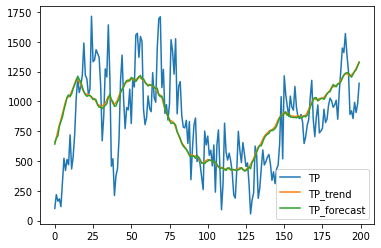

Model: "sequential_388"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1164 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1164 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1165 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1165 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1166 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1166 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_388 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9999e-04 - accuracy: 2.9734e-05 - val_loss: 1.1086e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3173e-04 - accuracy: 2.9734e-05 - val_loss: 6.2057e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 2.9734e-05 - val_loss: 9.7803e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8858e-04 - accuracy: 2.9734e-05 - val_loss: 9.5261e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 2.9734e-05 - val_loss: 7.4426e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9738e-04 - accuracy: 2.9734e-05 - val_loss: 5.7073e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

526/526 [==============================] - 7s 14ms/step - loss: 6.9459e-04 - accuracy: 2.9734e-05 - val_loss: 1.0624e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7796e-04 - accuracy: 2.9734e-05 - val_loss: 2.6693e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4787e-04 - accuracy: 2.9734e-05 - val_loss: 5.6773e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4266e-04 - accuracy: 2.9734e-05 - val_loss: 1.1542e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2915e-04 - accuracy: 2.9734e-05 - val_loss: 5.8107e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0636e-04 - accuracy: 2.9734e-05 - val_loss: 1.9440e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6397e-04 - accuracy: 2.9734e-05 - val_loss: 5.3835e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9779e-04 - accuracy: 2.9734e-05 - val_loss: 5.8743e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8162e-04 - accuracy: 2.9734e-05 - val_loss: 1.6392e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6082e-04 - accuracy: 2.9734e-05 - val_loss: 7.1486e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5772e-04 - accuracy: 2.9734e-05 - val_loss: 6.2215e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0407e-04 - accuracy: 2.9734e-05 - val_loss: 6.1207e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

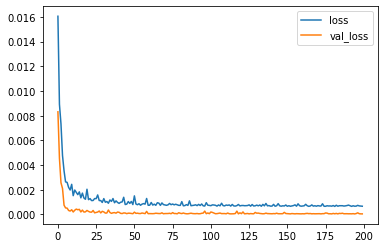

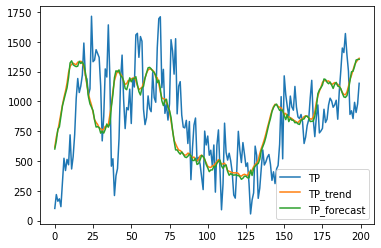

Model: "sequential_389"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1167 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1167 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1168 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1168 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1169 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1169 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_389 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 8.6693e-04 - accuracy: 2.9734e-05 - val_loss: 1.3485e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0942e-04 - accuracy: 2.9734e-05 - val_loss: 9.3150e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6988e-04 - accuracy: 2.9734e-05 - val_loss: 8.0032e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0205e-04 - accuracy: 2.9734e-05 - val_loss: 7.3194e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9756e-04 - accuracy: 2.9734e-05 - val_loss: 1.7833e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 2.9734e-05 - val_loss: 6.4249e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [=============================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7987e-04 - accuracy: 2.9734e-05 - val_loss: 7.5804e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6589e-04 - accuracy: 2.9734e-05 - val_loss: 4.1456e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9445e-04 - accuracy: 2.9734e-05 - val_loss: 4.0031e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8518e-04 - accuracy: 2.9734e-05 - val_loss: 6.1992e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9090e-04 - accuracy: 2.9734e-05 - val_loss: 1.9683e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8175e-04 - accuracy: 2.9734e-05 - val_loss: 6.9139e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

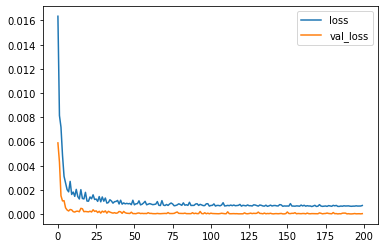

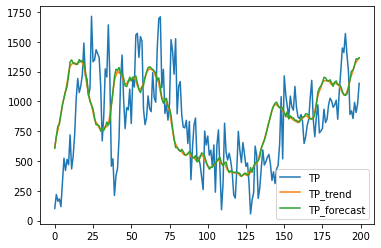

Model: "sequential_390"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1170 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1170 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1171 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1171 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1172 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1172 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_390 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3238e-04 - accuracy: 5.9467e-05 - val_loss: 1.1025e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6415e-04 - accuracy: 5.9467e-05 - val_loss: 1.1873e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5988e-04 - accuracy: 5.9467e-05 - val_loss: 9.8497e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2942e-04 - accuracy: 5.9467e-05 - val_loss: 9.9433e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0476e-04 - accuracy: 5.9467e-05 - val_loss: 9.1363e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.0936e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5060e-04 - accuracy: 5.9467e-05 - val_loss: 7.8379e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7075e-04 - accuracy: 5.9467e-05 - val_loss: 1.0223e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8847e-04 - accuracy: 5.9467e-05 - val_loss: 1.0387e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0046e-04 - accuracy: 5.9467e-05 - val_loss: 1.0512e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6579e-04 - accuracy: 5.9467e-05 - val_loss: 8.9782e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6478e-04 - accuracy: 5.9467e-05 - val_loss: 6.7810e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 14ms/step - loss: 6.7923e-04 - accuracy: 5.9467e-05 - val_loss: 6.8983e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 14ms/step - loss: 6.4290e-04 - accuracy: 5.9467e-05 - val_loss: 6.0781e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 14ms/step - loss: 6.6720e-04 - accuracy: 5.9467e-05 - val_loss: 7.1179e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9365e-04 - accuracy: 5.9467e-05 - val_loss: 1.4081e-04 - val_accuracy: 0.0000e+00


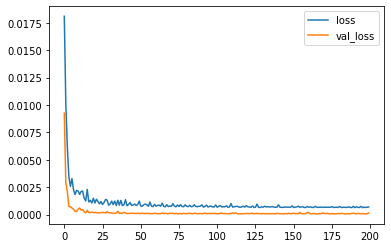

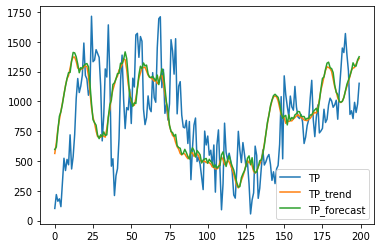

Model: "sequential_391"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1173 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1173 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1174 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1174 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1175 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1175 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_391 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 16ms/step - loss: 9.9298e-04 - accuracy: 5.9467e-05 - val_loss: 8.6764e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 16ms/step - loss: 8.1743e-04 - accuracy: 5.9467e-05 - val_loss: 1.1808e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 16ms/step - loss: 9.7209e-04 - accuracy: 5.9467e-05 - val_loss: 7.4801e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 16ms/step - loss: 8.0675e-04 - accuracy: 5.9467e-05 - val_loss: 1.0119e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 16ms/step - loss: 7.9864e-04 - accuracy: 5.9467e-05 - val_loss: 1.0050e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 16ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.1956e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 8s 16ms/step - loss: 6.7451e-04 - accuracy: 5.9467e-05 - val_loss: 1.3603e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 16ms/step - loss: 8.0454e-04 - accuracy: 5.9467e-05 - val_loss: 1.1533e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 16ms/step - loss: 7.7383e-04 - accuracy: 5.9467e-05 - val_loss: 9.1252e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 16ms/step - loss: 6.9915e-04 - accuracy: 5.9467e-05 - val_loss: 1.0114e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 16ms/step - loss: 7.7253e-04 - accuracy: 5.9467e-05 - val_loss: 8.9909e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 16ms/step - loss: 6.8006e-04 - accuracy: 5.9467e-05 - val_loss: 6.3817e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 16ms/step - loss: 6.4536e-04 - accuracy: 5.9467e-05 - val_loss: 6.2194e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 16ms/step - loss: 6.7093e-04 - accuracy: 5.9467e-05 - val_loss: 5.6595e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 16ms/step - loss: 6.5802e-04 - accuracy: 5.9467e-05 - val_loss: 5.9759e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4650e-04 - accuracy: 5.9467e-05 - val_loss: 1.0557e-04 - val_accuracy: 0.0000e+00


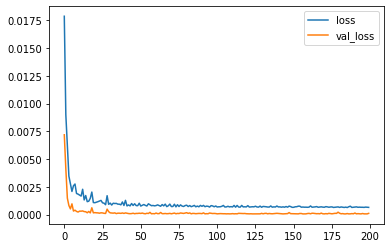

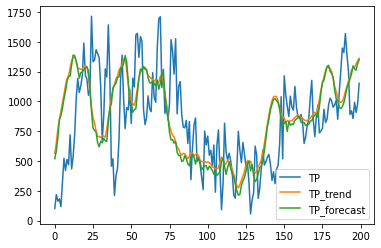

Model: "sequential_392"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1176 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1176 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1177 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1177 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1178 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1178 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_392 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4884e-04 - accuracy: 5.9467e-05 - val_loss: 1.4965e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4568e-04 - accuracy: 5.9467e-05 - val_loss: 9.6585e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4975e-04 - accuracy: 5.9467e-05 - val_loss: 9.9924e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2557e-04 - accuracy: 5.9467e-05 - val_loss: 1.3451e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.7943e-04 - accuracy: 5.9467e-05 - val_loss: 1.2538e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2949e-04 - accuracy: 5.9467e-05 - val_loss: 9.8637e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9533e-04 - accuracy: 5.9467e-05 - val_loss: 9.9146e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6795e-04 - accuracy: 5.9467e-05 - val_loss: 1.1004e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7479e-04 - accuracy: 5.9467e-05 - val_loss: 1.1686e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5730e-04 - accuracy: 5.9467e-05 - val_loss: 1.2227e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7340e-04 - accuracy: 5.9467e-05 - val_loss: 8.6723e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1063e-04 - accuracy: 5.9467e-05 - val_loss: 1.0350e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9612e-04 - accuracy: 5.9467e-05 - val_loss: 1.1394e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2124e-04 - accuracy: 5.9467e-05 - val_loss: 8.7012e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0805e-04 - accuracy: 5.9467e-05 - val_loss: 1.0491e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0337e-04 - accuracy: 5.9467e-05 - val_loss: 7.6475e-05 - val_accuracy: 0.0000e+00


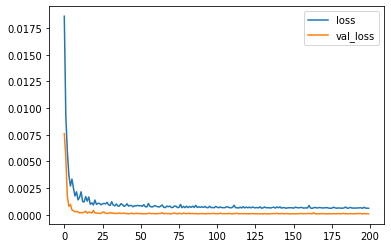

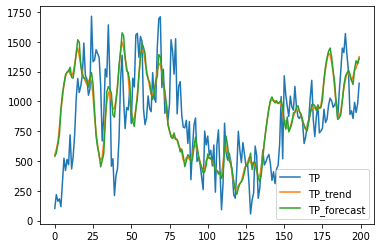

Model: "sequential_393"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1179 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1179 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1180 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1180 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1181 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1181 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_393 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 14ms/step - loss: 8.8113e-04 - accuracy: 5.9467e-05 - val_loss: 1.6096e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 7.3387e-04 - accuracy: 5.9467e-05 - val_loss: 1.5501e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 9.2464e-04 - accuracy: 5.9467e-05 - val_loss: 1.1266e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 14ms/step - loss: 8.4962e-04 - accuracy: 5.9467e-05 - val_loss: 1.4442e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 8.2686e-04 - accuracy: 5.9467e-05 - val_loss: 1.1638e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 14ms/step - loss: 7.5973e-04 - accuracy: 5.9467e-05 - val_loss: 1.1830e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 8s 14ms/step - loss: 7.7971e-04 - accuracy: 5.9467e-05 - val_loss: 8.7981e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 14ms/step - loss: 6.6432e-04 - accuracy: 5.9467e-05 - val_loss: 1.0516e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 6.5418e-04 - accuracy: 5.9467e-05 - val_loss: 9.8948e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 9.8317e-04 - accuracy: 5.9467e-05 - val_loss: 1.0132e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 6.5606e-04 - accuracy: 5.9467e-05 - val_loss: 1.2545e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 14ms/step - loss: 6.7043e-04 - accuracy: 5.9467e-05 - val_loss: 1.2044e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 14ms/step - loss: 6.0785e-04 - accuracy: 5.9467e-05 - val_loss: 1.2698e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 14ms/step - loss: 6.2036e-04 - accuracy: 5.9467e-05 - val_loss: 1.6262e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 14ms/step - loss: 6.1102e-04 - accuracy: 5.9467e-05 - val_loss: 1.7332e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 14ms/step - loss: 6.2340e-04 - accuracy: 5.9467e-05 - val_loss: 9.2014e-05 - val_accuracy: 0.0000e+00


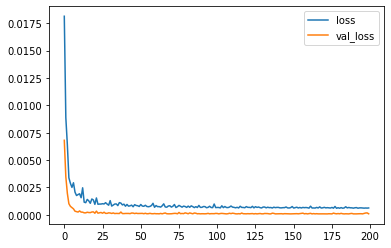

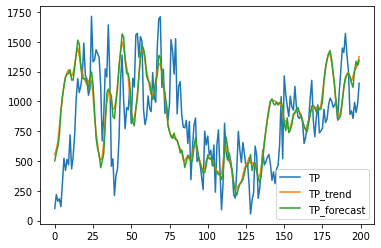

Model: "sequential_394"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1182 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1182 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1183 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1183 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1184 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1184 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_394 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0173e-04 - accuracy: 5.9467e-05 - val_loss: 1.7006e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8693e-04 - accuracy: 5.9467e-05 - val_loss: 1.5076e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5747e-04 - accuracy: 5.9467e-05 - val_loss: 1.6106e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.1019e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3298e-04 - accuracy: 5.9467e-05 - val_loss: 2.0072e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0598e-04 - accuracy: 5.9467e-05 - val_loss: 1.4025e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.3174e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7723e-04 - accuracy: 5.9467e-05 - val_loss: 1.5595e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1875e-04 - accuracy: 5.9467e-05 - val_loss: 1.5461e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7370e-04 - accuracy: 5.9467e-05 - val_loss: 1.5373e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9119e-04 - accuracy: 5.9467e-05 - val_loss: 1.5607e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5377e-04 - accuracy: 5.9467e-05 - val_loss: 1.5234e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==========================

Epoch 147/200
526/526 [==============================] - 8s 14ms/step - loss: 7.7907e-04 - accuracy: 5.9467e-05 - val_loss: 1.5227e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4505e-04 - accuracy: 5.9467e-05 - val_loss: 1.8129e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8409e-04 - accuracy: 5.9467e-05 - val_loss: 1.9742e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6545e-04 - accuracy: 5.9467e-05 - val_loss: 1.8962e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7125e-04 - accuracy: 5.9467e-05 - val_loss: 1.9028e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8267e-04 - accuracy: 5.9467e-05 - val_loss: 1.5246e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

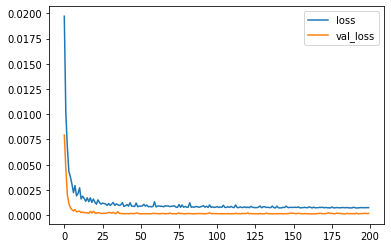

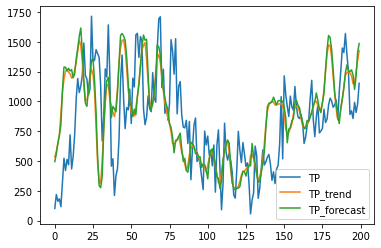

Model: "sequential_395"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1185 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1185 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1186 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1186 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1187 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1187 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_395 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.5210e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5376e-04 - accuracy: 5.9467e-05 - val_loss: 1.5050e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 3.9134e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7441e-04 - accuracy: 5.9467e-05 - val_loss: 1.8115e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5157e-04 - accuracy: 5.9467e-05 - val_loss: 2.0133e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9235e-04 - accuracy: 5.9467e-05 - val_loss: 1.5424e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

526/526 [==============================] - 8s 15ms/step - loss: 7.9798e-04 - accuracy: 5.9467e-05 - val_loss: 1.3281e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 7.9193e-04 - accuracy: 5.9467e-05 - val_loss: 1.4080e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7340e-04 - accuracy: 5.9467e-05 - val_loss: 1.7046e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 7.9297e-04 - accuracy: 5.9467e-05 - val_loss: 1.6102e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 7.7896e-04 - accuracy: 5.9467e-05 - val_loss: 1.6107e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0651e-04 - accuracy: 5.9467e-05 - val_loss: 1.6300e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6212e-04 - accuracy: 5.9467e-05 - val_loss: 1.4522e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5239e-04 - accuracy: 5.9467e-05 - val_loss: 1.3858e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2222e-04 - accuracy: 5.9467e-05 - val_loss: 1.3584e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 7.7935e-04 - accuracy: 5.9467e-05 - val_loss: 2.0442e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2937e-04 - accuracy: 5.9467e-05 - val_loss: 1.7181e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3107e-04 - accuracy: 5.9467e-05 - val_loss: 1.4596e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

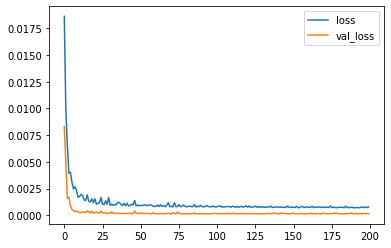

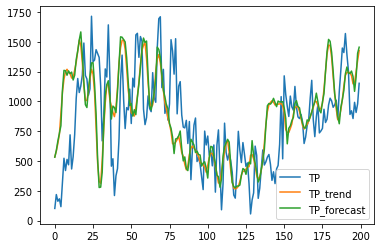

Model: "sequential_396"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1188 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1188 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1189 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1189 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1190 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1190 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_396 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 9.7978e-04 - accuracy: 5.9467e-05 - val_loss: 2.1165e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7829e-04 - accuracy: 5.9467e-05 - val_loss: 3.0966e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.1974e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7967e-04 - accuracy: 5.9467e-05 - val_loss: 2.2705e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.4526e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2627e-04 - accuracy: 5.9467e-05 - val_loss: 2.4969e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] -

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0678e-04 - accuracy: 5.9467e-05 - val_loss: 2.2094e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6160e-04 - accuracy: 5.9467e-05 - val_loss: 2.0243e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7893e-04 - accuracy: 5.9467e-05 - val_loss: 1.7700e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1176e-04 - accuracy: 5.9467e-05 - val_loss: 2.2074e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4090e-04 - accuracy: 5.9467e-05 - val_loss: 1.7195e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7428e-04 - accuracy: 5.9467e-05 - val_loss: 2.0058e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

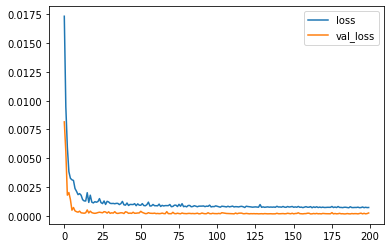

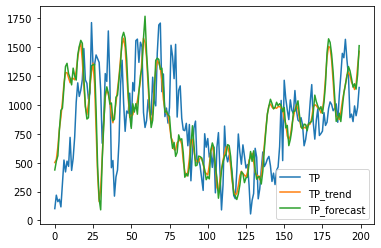

Model: "sequential_397"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1191 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1191 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1192 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1192 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1193 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1193 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_397 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.4639e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5272e-04 - accuracy: 5.9467e-05 - val_loss: 2.2610e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.0008e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9614e-04 - accuracy: 5.9467e-05 - val_loss: 2.0476e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8735e-04 - accuracy: 5.9467e-05 - val_loss: 2.1471e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7846e-04 - accuracy: 5.9467e-05 - val_loss: 2.1492e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9185e-04 - accuracy: 5.9467e-05 - val_loss: 1.7244e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6965e-04 - accuracy: 5.9467e-05 - val_loss: 1.8362e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7881e-04 - accuracy: 5.9467e-05 - val_loss: 1.7822e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6575e-04 - accuracy: 5.9467e-05 - val_loss: 1.8770e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2942e-04 - accuracy: 5.9467e-05 - val_loss: 3.1800e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7933e-04 - accuracy: 5.9467e-05 - val_loss: 1.8557e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0808e-04 - accuracy: 5.9467e-05 - val_loss: 2.5239e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4565e-04 - accuracy: 5.9467e-05 - val_loss: 1.7812e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9440e-04 - accuracy: 5.9467e-05 - val_loss: 1.7919e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5712e-04 - accuracy: 5.9467e-05 - val_loss: 1.8422e-04 - val_accuracy: 0.0000e+00


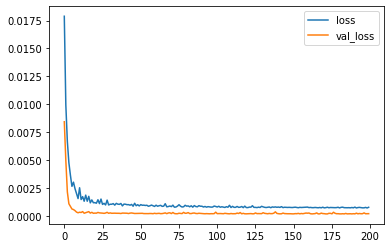

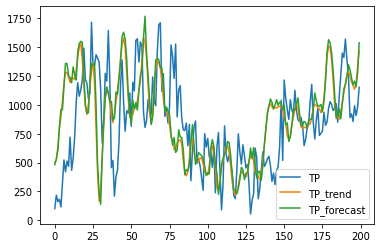

Model: "sequential_398"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1194 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1194 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1195 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1195 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1196 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1196 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_398 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 3.8920e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.8861e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8287e-04 - accuracy: 5.9467e-05 - val_loss: 2.8400e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7026e-04 - accuracy: 5.9467e-05 - val_loss: 3.0828e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8842e-04 - accuracy: 5.9467e-05 - val_loss: 3.9211e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.9552e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] -

Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9284e-04 - accuracy: 5.9467e-05 - val_loss: 2.5163e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1029e-04 - accuracy: 5.9467e-05 - val_loss: 4.1455e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8634e-04 - accuracy: 5.9467e-05 - val_loss: 3.7965e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2746e-04 - accuracy: 5.9467e-05 - val_loss: 2.9166e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9800e-04 - accuracy: 5.9467e-05 - val_loss: 2.9492e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1497e-04 - accuracy: 5.9467e-05 - val_loss: 3.2359e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

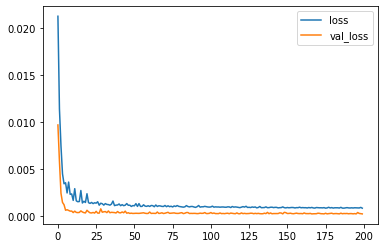

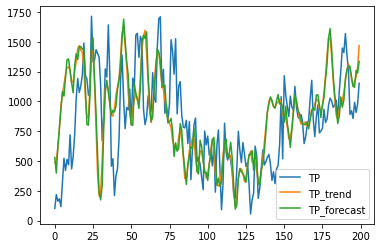

Model: "sequential_399"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1197 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1197 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1198 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1198 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1199 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1199 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_399 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.8756e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5336e-04 - accuracy: 5.9467e-05 - val_loss: 2.7106e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5083e-04 - accuracy: 5.9467e-05 - val_loss: 2.9710e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 3.4381e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 9.6434e-04 - accuracy: 5.9467e-05 - val_loss: 2.8225e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 9.6377e-04 - accuracy: 5.9467e-05 - val_loss: 2.7414e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [=============================

Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2021e-04 - accuracy: 5.9467e-05 - val_loss: 2.9306e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4846e-04 - accuracy: 5.9467e-05 - val_loss: 3.0808e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2279e-04 - accuracy: 5.9467e-05 - val_loss: 3.0472e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 9.3799e-04 - accuracy: 5.9467e-05 - val_loss: 2.6979e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2612e-04 - accuracy: 5.9467e-05 - val_loss: 2.7068e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 8s 15ms/step - loss: 9.9390e-04 - accuracy: 5.9467e-05 - val_loss: 2.7910e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

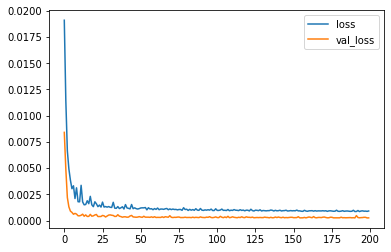

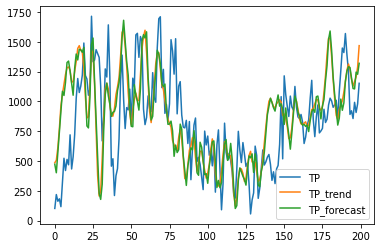

Model: "sequential_400"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1200 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1200 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1201 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1201 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1202 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1202 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_400 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 9.8988e-04 - accuracy: 5.9467e-05 - val_loss: 3.2291e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 4.7592e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 9.7795e-04 - accuracy: 5.9467e-05 - val_loss: 4.4605e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 3.1273e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5322e-04 - accuracy: 5.9467e-05 - val_loss: 3.1682e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 4.1930e-04 - val_accuracy: 0.0000e+00
Epoch 103/200
526/526 [==============================] -

Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 9.3741e-04 - accuracy: 5.9467e-05 - val_loss: 3.3981e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1856e-04 - accuracy: 5.9467e-05 - val_loss: 3.6355e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4056e-04 - accuracy: 5.9467e-05 - val_loss: 3.1376e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0695e-04 - accuracy: 5.9467e-05 - val_loss: 4.4866e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 9.8104e-04 - accuracy: 5.9467e-05 - val_loss: 3.2240e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1609e-04 - accuracy: 5.9467e-05 - val_loss: 3.0274e-04 - val_accuracy: 0.0000e+00
Epoch 154/200
526/526 [=====

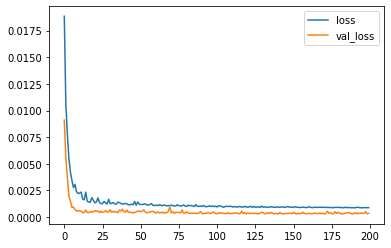

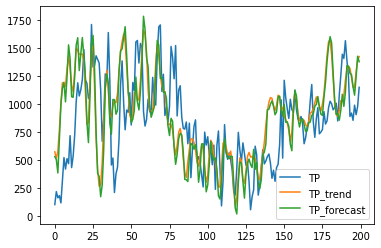

Model: "sequential_401"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1203 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1203 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1204 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1204 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1205 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1205 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_401 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3753e-05 - accuracy: 2.9734e-05 - val_loss: 4.7129e-06 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4250e-05 - accuracy: 2.9734e-05 - val_loss: 5.3455e-06 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6967e-05 - accuracy: 2.9734e-05 - val_loss: 6.3381e-06 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8453e-05 - accuracy: 2.9734e-05 - val_loss: 5.9363e-06 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6470e-05 - accuracy: 2.9734e-05 - val_loss: 5.9546e-06 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 1.9896e-05 - accuracy: 2.9734e-05 - val_loss: 5.2814e-06 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2973e-05 - accuracy: 2.9734e-05 - val_loss: 4.8515e-06 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4278e-05 - accuracy: 2.9734e-05 - val_loss: 5.8067e-06 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5261e-05 - accuracy: 2.9734e-05 - val_loss: 5.2680e-06 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5480e-05 - accuracy: 2.9734e-05 - val_loss: 5.9291e-06 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4838e-05 - accuracy: 2.9734e-05 - val_loss: 5.2200e-06 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3131e-05 - accuracy: 2.9734e-05 - val_loss: 5.8489e-06 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1637e-05 - accuracy: 2.9734e-05 - val_loss: 5.1500e-06 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2302e-05 - accuracy: 2.9734e-05 - val_loss: 6.1231e-06 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1856e-05 - accuracy: 2.9734e-05 - val_loss: 5.0031e-06 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2207e-05 - accuracy: 2.9734e-05 - val_loss: 6.2252e-06 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1081e-05 - accuracy: 2.9734e-05 - val_loss: 5.5851e-06 - val_accuracy: 0.0000e+00


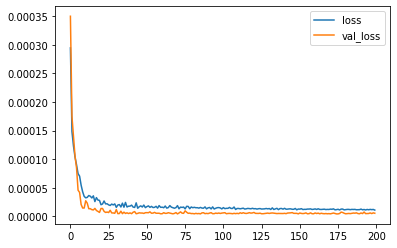

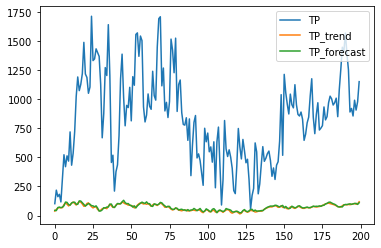

Model: "sequential_402"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1206 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1206 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1207 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1207 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1208 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1208 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_402 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1544e-06 - accuracy: 2.9734e-05 - val_loss: 2.1462e-08 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1256e-06 - accuracy: 2.9734e-05 - val_loss: 1.3366e-08 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6940e-06 - accuracy: 2.9734e-05 - val_loss: 1.0315e-08 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3989e-06 - accuracy: 2.9734e-05 - val_loss: 1.1805e-08 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4236e-06 - accuracy: 2.9734e-05 - val_loss: 7.7165e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4362e-06 - accuracy: 2.9734e-05 - val_loss: 1.3887e-08 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1222e-06 - accuracy: 2.9734e-05 - val_loss: 1.7301e-08 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4249e-06 - accuracy: 2.9734e-05 - val_loss: 1.3849e-08 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5497e-06 - accuracy: 2.9734e-05 - val_loss: 8.9086e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3476e-06 - accuracy: 2.9734e-05 - val_loss: 1.1523e-08 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3458e-06 - accuracy: 2.9734e-05 - val_loss: 7.1667e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4715e-06 - accuracy: 2.9734e-05 - val_loss: 5.7044e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6714e-07 - accuracy: 2.9734e-05 - val_loss: 7.6640e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5644e-06 - accuracy: 2.9734e-05 - val_loss: 1.0453e-08 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2195e-06 - accuracy: 2.9734e-05 - val_loss: 7.4477e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 9.7366e-07 - accuracy: 2.9734e-05 - val_loss: 4.3315e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3612e-07 - accuracy: 2.9734e-05 - val_loss: 1.5173e-08 - val_accuracy: 0.0000e+00


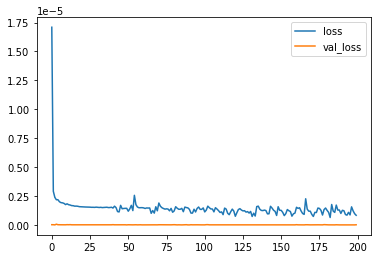

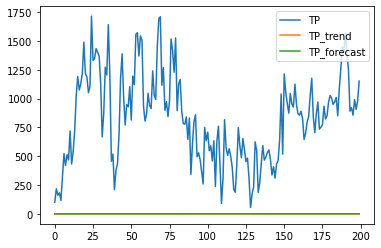

Model: "sequential_403"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1209 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1209 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1210 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1210 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1211 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1211 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_403 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7997e-06 - accuracy: 0.0000e+00 - val_loss: 4.5369e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 1.5787e-06 - accuracy: 0.0000e+00 - val_loss: 3.2309e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4552e-06 - accuracy: 0.0000e+00 - val_loss: 1.4620e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2217e-06 - accuracy: 0.0000e+00 - val_loss: 1.7281e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2737e-06 - accuracy: 0.0000e+00 - val_loss: 3.2929e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 1.1667e-06 - accuracy: 0.0000e+00 - val_loss: 1.1591e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7140e-06 - accuracy: 0.0000e+00 - val_loss: 1.9988e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4931e-06 - accuracy: 0.0000e+00 - val_loss: 7.7284e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4172e-06 - accuracy: 0.0000e+00 - val_loss: 9.8670e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4017e-06 - accuracy: 0.0000e+00 - val_loss: 6.9865e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2759e-06 - accuracy: 0.0000e+00 - val_loss: 1.0810e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 1.0034e-06 - accuracy: 0.0000e+00 - val_loss: 1.0617e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2794e-06 - accuracy: 0.0000e+00 - val_loss: 5.7074e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 9.3390e-07 - accuracy: 0.0000e+00 - val_loss: 5.2944e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3063e-06 - accuracy: 0.0000e+00 - val_loss: 1.2027e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7355e-06 - accuracy: 0.0000e+00 - val_loss: 9.4990e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 1.3236e-06 - accuracy: 0.0000e+00 - val_loss: 5.9583e-10 - val_accuracy: 1.1893e-04


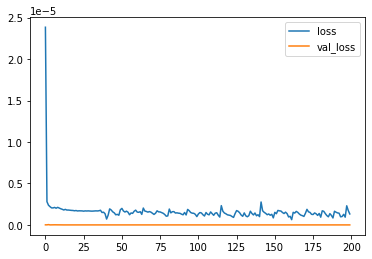

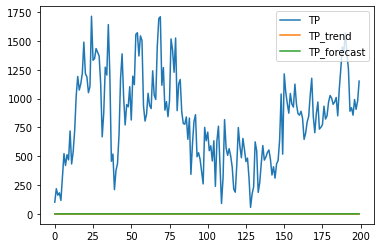

Model: "sequential_404"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1212 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1212 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1213 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1213 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1214 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1214 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_404 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8050e-06 - accuracy: 0.0000e+00 - val_loss: 8.9387e-11 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6132e-06 - accuracy: 0.0000e+00 - val_loss: 3.3865e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5011e-06 - accuracy: 0.0000e+00 - val_loss: 6.6083e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2550e-06 - accuracy: 0.0000e+00 - val_loss: 2.7553e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4365e-06 - accuracy: 0.0000e+00 - val_loss: 5.4556e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5950e-06 - accuracy: 0.0000e+00 - val_loss: 4.6285e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5483e-06 - accuracy: 0.0000e+00 - val_loss: 1.5911e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0393e-06 - accuracy: 0.0000e+00 - val_loss: 1.6240e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2675e-06 - accuracy: 0.0000e+00 - val_loss: 1.3752e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3048e-07 - accuracy: 0.0000e+00 - val_loss: 2.5842e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7535e-06 - accuracy: 0.0000e+00 - val_loss: 2.7338e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7378e-06 - accuracy: 0.0000e+00 - val_loss: 1.0646e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0073e-06 - accuracy: 0.0000e+00 - val_loss: 4.3059e-11 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8719e-07 - accuracy: 0.0000e+00 - val_loss: 2.1886e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3639e-06 - accuracy: 0.0000e+00 - val_loss: 1.7755e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5230e-06 - accuracy: 0.0000e+00 - val_loss: 6.3959e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1430e-06 - accuracy: 0.0000e+00 - val_loss: 8.9960e-10 - val_accuracy: 1.1893e-04


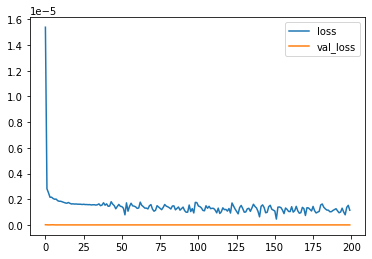

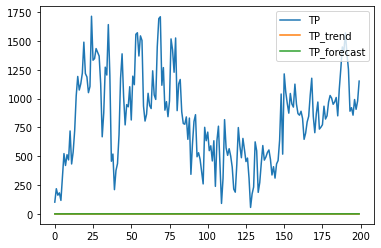

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_405"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1215 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1215 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1216 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1216 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1217 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1217 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_405 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5067e-06 - accuracy: 0.0000e+00 - val_loss: 5.4672e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2924e-06 - accuracy: 0.0000e+00 - val_loss: 1.0355e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4005e-06 - accuracy: 0.0000e+00 - val_loss: 1.0849e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6677e-06 - accuracy: 0.0000e+00 - val_loss: 1.7032e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4990e-06 - accuracy: 0.0000e+00 - val_loss: 6.7157e-11 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4393e-06 - accuracy: 0.0000e+00 - val_loss: 2.2545e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6076e-06 - accuracy: 0.0000e+00 - val_loss: 1.3660e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6177e-06 - accuracy: 0.0000e+00 - val_loss: 7.2343e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3597e-06 - accuracy: 0.0000e+00 - val_loss: 4.7563e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3385e-06 - accuracy: 0.0000e+00 - val_loss: 5.4271e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1357e-06 - accuracy: 0.0000e+00 - val_loss: 3.9918e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9054e-06 - accuracy: 0.0000e+00 - val_loss: 3.7738e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8629e-06 - accuracy: 0.0000e+00 - val_loss: 2.0228e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3003e-06 - accuracy: 0.0000e+00 - val_loss: 2.2608e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1303e-06 - accuracy: 0.0000e+00 - val_loss: 2.6058e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1873e-06 - accuracy: 0.0000e+00 - val_loss: 3.1629e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2043e-06 - accuracy: 0.0000e+00 - val_loss: 5.1894e-10 - val_accuracy: 1.1893e-04


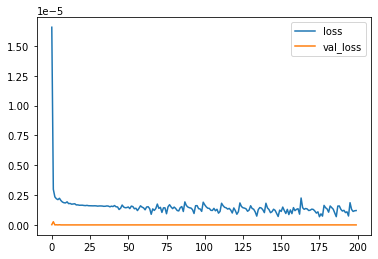

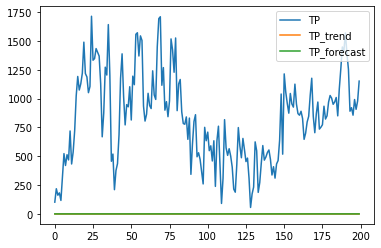

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_406"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1218 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1218 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1219 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1219 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1220 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1220 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_406 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5069e-06 - accuracy: 0.0000e+00 - val_loss: 5.6590e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6081e-06 - accuracy: 0.0000e+00 - val_loss: 1.4462e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3555e-06 - accuracy: 0.0000e+00 - val_loss: 3.5013e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5342e-06 - accuracy: 0.0000e+00 - val_loss: 5.5516e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5638e-06 - accuracy: 0.0000e+00 - val_loss: 1.3267e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4576e-06 - accuracy: 0.0000e+00 - val_loss: 2.9840e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3282e-06 - accuracy: 0.0000e+00 - val_loss: 2.1506e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3003e-06 - accuracy: 0.0000e+00 - val_loss: 2.1688e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0784e-06 - accuracy: 0.0000e+00 - val_loss: 2.1681e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7788e-07 - accuracy: 0.0000e+00 - val_loss: 3.6912e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2740e-06 - accuracy: 0.0000e+00 - val_loss: 1.5432e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0202e-06 - accuracy: 0.0000e+00 - val_loss: 4.3298e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3345e-06 - accuracy: 0.0000e+00 - val_loss: 5.1767e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9854e-07 - accuracy: 0.0000e+00 - val_loss: 2.3231e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6764e-06 - accuracy: 0.0000e+00 - val_loss: 1.2970e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2507e-06 - accuracy: 0.0000e+00 - val_loss: 1.1716e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2792e-06 - accuracy: 0.0000e+00 - val_loss: 6.7771e-10 - val_accuracy: 1.1893e-04


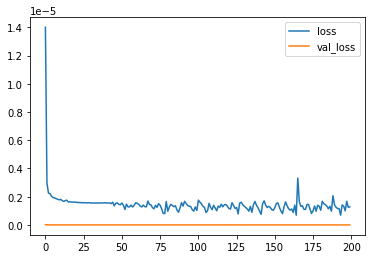

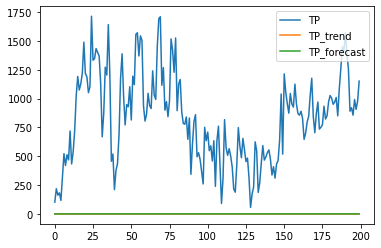

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_407"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1221 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1221 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1222 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1222 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1223 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1223 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_407 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5103e-07 - accuracy: 0.0000e+00 - val_loss: 1.3339e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 2.0183e-06 - accuracy: 0.0000e+00 - val_loss: 3.3663e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 1.5247e-06 - accuracy: 0.0000e+00 - val_loss: 1.3429e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 1.1767e-06 - accuracy: 0.0000e+00 - val_loss: 4.7695e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 1.6393e-06 - accuracy: 0.0000e+00 - val_loss: 6.2589e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 1.3911e-06 - accuracy: 0.0000e+00 - val_loss: 1.9148e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 1.3184e-06 - accuracy: 0.0000e+00 - val_loss: 1.5388e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2421e-06 - accuracy: 0.0000e+00 - val_loss: 1.5421e-09 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2244e-06 - accuracy: 0.0000e+00 - val_loss: 1.3970e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 1.3512e-06 - accuracy: 0.0000e+00 - val_loss: 1.1036e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4568e-06 - accuracy: 0.0000e+00 - val_loss: 1.0776e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2413e-06 - accuracy: 0.0000e+00 - val_loss: 4.2209e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 16ms/step - loss: 1.0847e-06 - accuracy: 0.0000e+00 - val_loss: 1.3908e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 1.5327e-06 - accuracy: 0.0000e+00 - val_loss: 9.4419e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2647e-06 - accuracy: 0.0000e+00 - val_loss: 6.5617e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 8s 16ms/step - loss: 1.1829e-06 - accuracy: 0.0000e+00 - val_loss: 3.9714e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 1.0467e-06 - accuracy: 0.0000e+00 - val_loss: 1.5348e-09 - val_accuracy: 1.1893e-04


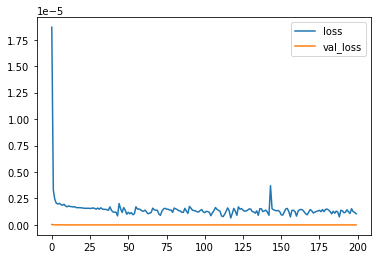

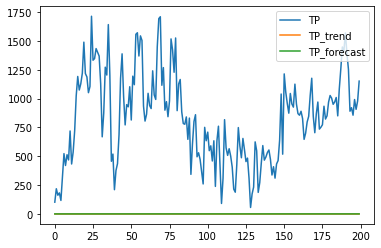

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_408"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1224 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1224 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1225 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1225 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1226 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1226 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_408 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 14ms/step - loss: 1.2009e-06 - accuracy: 0.0000e+00 - val_loss: 2.0694e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6375e-06 - accuracy: 0.0000e+00 - val_loss: 3.0808e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4718e-06 - accuracy: 0.0000e+00 - val_loss: 1.6818e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5198e-06 - accuracy: 0.0000e+00 - val_loss: 3.5474e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5502e-06 - accuracy: 0.0000e+00 - val_loss: 1.5418e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4362e-06 - accuracy: 0.0000e+00 - val_loss: 4.4659e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1365e-06 - accuracy: 0.0000e+00 - val_loss: 1.3502e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1307e-06 - accuracy: 0.0000e+00 - val_loss: 8.1515e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4354e-06 - accuracy: 0.0000e+00 - val_loss: 1.1884e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2378e-06 - accuracy: 0.0000e+00 - val_loss: 9.6889e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5036e-06 - accuracy: 0.0000e+00 - val_loss: 1.7613e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3953e-06 - accuracy: 0.0000e+00 - val_loss: 3.6775e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2699e-06 - accuracy: 0.0000e+00 - val_loss: 1.9839e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3363e-06 - accuracy: 0.0000e+00 - val_loss: 3.2650e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3077e-07 - accuracy: 0.0000e+00 - val_loss: 6.6033e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 1.0047e-06 - accuracy: 0.0000e+00 - val_loss: 3.1705e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2732e-06 - accuracy: 0.0000e+00 - val_loss: 3.1636e-10 - val_accuracy: 1.1893e-04


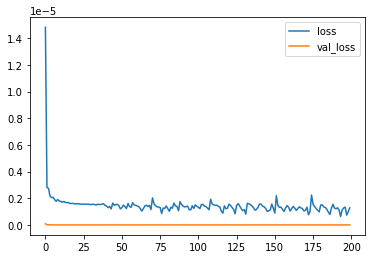

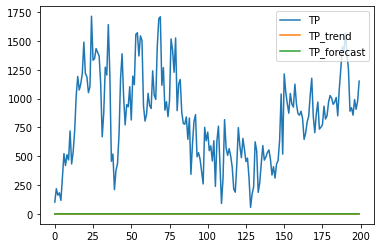

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_409"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1227 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1227 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1228 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1228 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1229 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1229 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_409 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4767e-06 - accuracy: 2.9734e-05 - val_loss: 1.6700e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3425e-06 - accuracy: 2.9734e-05 - val_loss: 4.4152e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4092e-06 - accuracy: 2.9734e-05 - val_loss: 2.3723e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6459e-06 - accuracy: 2.9734e-05 - val_loss: 1.3243e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3265e-06 - accuracy: 2.9734e-05 - val_loss: 3.9504e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1343e-06 - accuracy: 2.9734e-05 - val_loss: 1.5029e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1055e-07 - accuracy: 2.9734e-05 - val_loss: 3.5934e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 14ms/step - loss: 1.4144e-06 - accuracy: 2.9734e-05 - val_loss: 8.4250e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3542e-06 - accuracy: 2.9734e-05 - val_loss: 3.3380e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2869e-06 - accuracy: 2.9734e-05 - val_loss: 2.1685e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.0770e-06 - accuracy: 2.9734e-05 - val_loss: 1.3560e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2602e-06 - accuracy: 2.9734e-05 - val_loss: 1.8511e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1125e-06 - accuracy: 2.9734e-05 - val_loss: 6.9226e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9813e-07 - accuracy: 2.9734e-05 - val_loss: 2.7437e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8616e-07 - accuracy: 2.9734e-05 - val_loss: 1.1729e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2602e-06 - accuracy: 2.9734e-05 - val_loss: 1.0734e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.0226e-06 - accuracy: 2.9734e-05 - val_loss: 7.5967e-10 - val_accuracy: 0.0000e+00


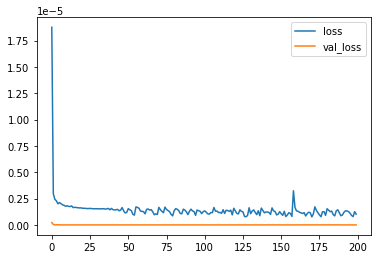

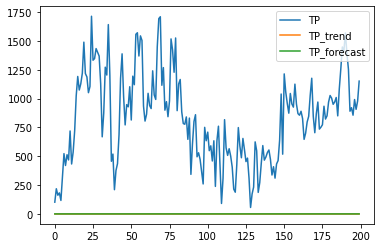

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_410"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1230 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1230 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1231 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1231 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1232 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1232 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_410 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4157e-06 - accuracy: 2.9734e-05 - val_loss: 8.1791e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8046e-06 - accuracy: 2.9734e-05 - val_loss: 4.9772e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3987e-06 - accuracy: 2.9734e-05 - val_loss: 1.0764e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 1.2411e-06 - accuracy: 2.9734e-05 - val_loss: 1.0582e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5067e-06 - accuracy: 2.9734e-05 - val_loss: 4.9255e-11 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3569e-06 - accuracy: 2.9734e-05 - val_loss: 2.6046e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3851e-06 - accuracy: 2.9734e-05 - val_loss: 1.2774e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3264e-06 - accuracy: 2.9734e-05 - val_loss: 2.6616e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3824e-06 - accuracy: 2.9734e-05 - val_loss: 4.1997e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3944e-06 - accuracy: 2.9734e-05 - val_loss: 1.3019e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4509e-06 - accuracy: 2.9734e-05 - val_loss: 1.1845e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3496e-06 - accuracy: 2.9734e-05 - val_loss: 7.2359e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3086e-06 - accuracy: 2.9734e-05 - val_loss: 1.1989e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0400e-06 - accuracy: 2.9734e-05 - val_loss: 9.8567e-11 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2255e-06 - accuracy: 2.9734e-05 - val_loss: 2.1134e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1420e-06 - accuracy: 2.9734e-05 - val_loss: 1.0202e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7121e-07 - accuracy: 2.9734e-05 - val_loss: 6.5310e-10 - val_accuracy: 0.0000e+00


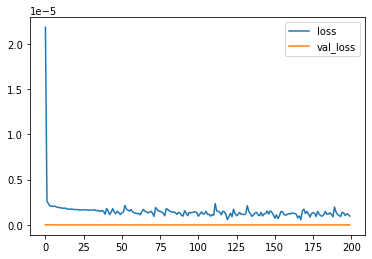

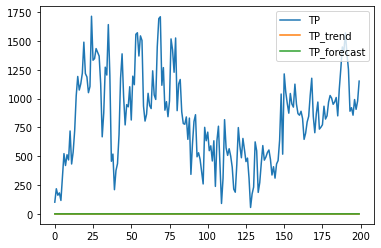

Model: "sequential_411"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1233 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1233 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1234 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1234 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1235 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1235 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_411 (Dense)            (None, 1)              

526/526 [==============================] - 8s 14ms/step - loss: 8.3543e-04 - accuracy: 0.0781 - val_loss: 4.1914e-05 - val_accuracy: 0.1037
Epoch 102/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2904e-04 - accuracy: 0.0781 - val_loss: 5.1102e-05 - val_accuracy: 0.1037
Epoch 103/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 0.0781 - val_loss: 7.0749e-05 - val_accuracy: 0.1037
Epoch 104/200
526/526 [==============================] - 8s 14ms/step - loss: 8.3214e-04 - accuracy: 0.0781 - val_loss: 4.0523e-05 - val_accuracy: 0.1037
Epoch 105/200
526/526 [==============================] - 8s 14ms/step - loss: 8.1416e-04 - accuracy: 0.0781 - val_loss: 1.9781e-04 - val_accuracy: 0.1037
Epoch 106/200
526/526 [==============================] - 8s 14ms/step - loss: 9.0610e-04 - accuracy: 0.0781 - val_loss: 3.6723e-05 - val_accuracy: 0.1037
Epoch 107/200
526/526 [==============================] - 8s 14ms/step - loss: 8.1568e-04 - acc

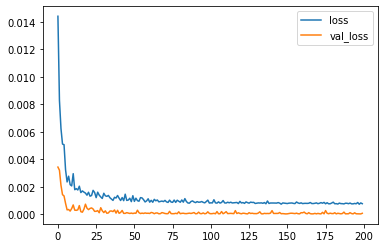

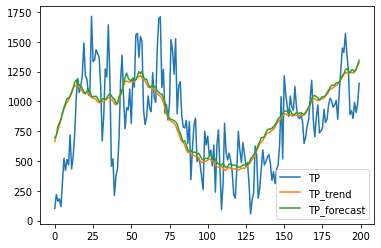

Model: "sequential_412"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1236 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1236 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1237 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1237 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1238 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1238 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_412 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2187e-04 - accuracy: 2.9734e-05 - val_loss: 1.6103e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8668e-04 - accuracy: 2.9734e-05 - val_loss: 1.6825e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9561e-04 - accuracy: 2.9734e-05 - val_loss: 9.0417e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 2.9734e-05 - val_loss: 1.0432e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8943e-04 - accuracy: 2.9734e-05 - val_loss: 1.3754e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9553e-04 - accuracy: 2.9734e-05 - val_loss: 1.7252e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8801e-04 - accuracy: 2.9734e-05 - val_loss: 7.5215e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1873e-04 - accuracy: 2.9734e-05 - val_loss: 4.6517e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9442e-04 - accuracy: 2.9734e-05 - val_loss: 4.8993e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0705e-04 - accuracy: 2.9734e-05 - val_loss: 2.3922e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9135e-04 - accuracy: 2.9734e-05 - val_loss: 6.8278e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1391e-04 - accuracy: 2.9734e-05 - val_loss: 6.3411e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5566e-04 - accuracy: 2.9734e-05 - val_loss: 8.6195e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5423e-04 - accuracy: 2.9734e-05 - val_loss: 1.8586e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5170e-04 - accuracy: 2.9734e-05 - val_loss: 1.6117e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7797e-04 - accuracy: 2.9734e-05 - val_loss: 6.1621e-05 - val_accuracy: 0.0000e+00


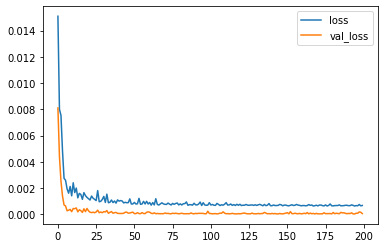

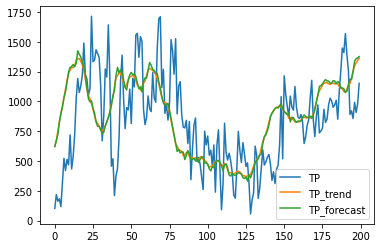

Model: "sequential_413"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1239 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1239 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1240 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1240 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1241 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1241 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_413 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3489e-04 - accuracy: 2.9734e-05 - val_loss: 8.0200e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2271e-04 - accuracy: 2.9734e-05 - val_loss: 6.7148e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4559e-04 - accuracy: 2.9734e-05 - val_loss: 2.0049e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4774e-04 - accuracy: 2.9734e-05 - val_loss: 6.3001e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7895e-04 - accuracy: 2.9734e-05 - val_loss: 7.9951e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6761e-04 - accuracy: 2.9734e-05 - val_loss: 1.3623e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5216e-04 - accuracy: 2.9734e-05 - val_loss: 4.8598e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5978e-04 - accuracy: 2.9734e-05 - val_loss: 9.4706e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4267e-04 - accuracy: 2.9734e-05 - val_loss: 5.2951e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3733e-04 - accuracy: 2.9734e-05 - val_loss: 6.1888e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5348e-04 - accuracy: 2.9734e-05 - val_loss: 9.0186e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1584e-04 - accuracy: 2.9734e-05 - val_loss: 9.2796e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4911e-04 - accuracy: 2.9734e-05 - val_loss: 5.4110e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0990e-04 - accuracy: 2.9734e-05 - val_loss: 4.1351e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5196e-04 - accuracy: 2.9734e-05 - val_loss: 8.0870e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4565e-04 - accuracy: 2.9734e-05 - val_loss: 1.4158e-04 - val_accuracy: 0.0000e+00


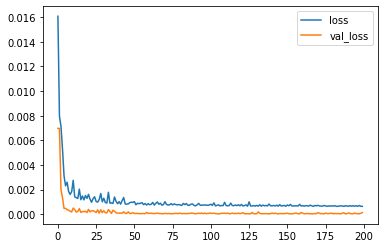

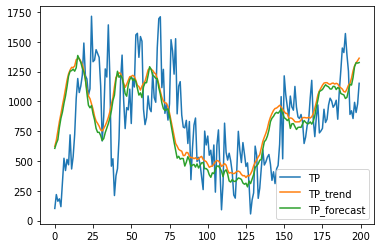

Model: "sequential_414"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1242 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1242 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1243 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1243 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1244 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1244 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_414 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8997e-04 - accuracy: 5.9467e-05 - val_loss: 1.2123e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1584e-04 - accuracy: 5.9467e-05 - val_loss: 1.1869e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4665e-04 - accuracy: 5.9467e-05 - val_loss: 8.9603e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8230e-04 - accuracy: 5.9467e-05 - val_loss: 2.1359e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 9.1086e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6234e-04 - accuracy: 5.9467e-05 - val_loss: 1.1820e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 7s 13ms/step - loss: 6.8447e-04 - accuracy: 5.9467e-05 - val_loss: 1.0977e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8115e-04 - accuracy: 5.9467e-05 - val_loss: 8.5646e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1326e-04 - accuracy: 5.9467e-05 - val_loss: 8.7550e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7849e-04 - accuracy: 5.9467e-05 - val_loss: 1.0667e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5021e-04 - accuracy: 5.9467e-05 - val_loss: 7.2301e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3762e-04 - accuracy: 5.9467e-05 - val_loss: 6.5161e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1881e-04 - accuracy: 5.9467e-05 - val_loss: 8.6137e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0650e-04 - accuracy: 5.9467e-05 - val_loss: 7.5649e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1725e-04 - accuracy: 5.9467e-05 - val_loss: 9.6596e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0195e-04 - accuracy: 5.9467e-05 - val_loss: 5.6924e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4660e-04 - accuracy: 5.9467e-05 - val_loss: 6.3093e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5360e-04 - accuracy: 5.9467e-05 - val_loss: 6.2245e-05 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

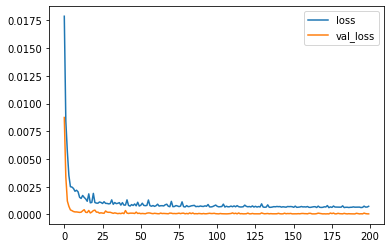

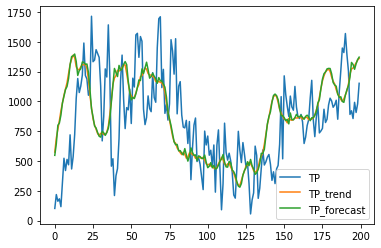

Model: "sequential_415"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1245 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1245 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1246 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1246 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1247 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1247 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_415 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 9.1745e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7224e-04 - accuracy: 5.9467e-05 - val_loss: 2.3926e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.1708e-04 - accuracy: 5.9467e-05 - val_loss: 9.5094e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5764e-04 - accuracy: 5.9467e-05 - val_loss: 1.0531e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5417e-04 - accuracy: 5.9467e-05 - val_loss: 9.8696e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5738e-04 - accuracy: 5.9467e-05 - val_loss: 9.3538e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 8s 15ms/step - loss: 8.5187e-04 - accuracy: 5.9467e-05 - val_loss: 8.8360e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1565e-04 - accuracy: 5.9467e-05 - val_loss: 9.0360e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2360e-04 - accuracy: 5.9467e-05 - val_loss: 5.5996e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2677e-04 - accuracy: 5.9467e-05 - val_loss: 6.0591e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7213e-04 - accuracy: 5.9467e-05 - val_loss: 7.3493e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 6.7692e-04 - accuracy: 5.9467e-05 - val_loss: 5.9796e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 6.6177e-04 - accuracy: 5.9467e-05 - val_loss: 6.9787e-05 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 6.6044e-04 - accuracy: 5.9467e-05 - val_loss: 4.9637e-05 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1096e-04 - accuracy: 5.9467e-05 - val_loss: 6.3427e-05 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4730e-04 - accuracy: 5.9467e-05 - val_loss: 8.3000e-05 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9330e-04 - accuracy: 5.9467e-05 - val_loss: 5.6250e-05 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4056e-04 - accuracy: 5.9467e-05 - val_loss: 1.1151e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

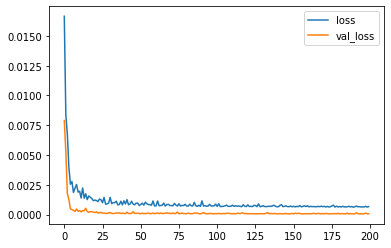

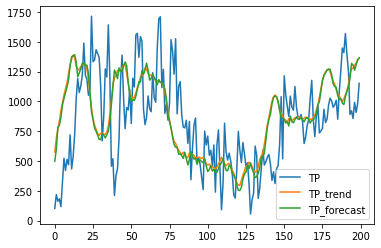

Model: "sequential_416"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1248 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1248 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1249 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1249 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1250 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1250 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_416 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6730e-04 - accuracy: 5.9467e-05 - val_loss: 1.3922e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0223e-04 - accuracy: 5.9467e-05 - val_loss: 9.9373e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4162e-04 - accuracy: 5.9467e-05 - val_loss: 8.1319e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 2.1762e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7534e-04 - accuracy: 5.9467e-05 - val_loss: 1.3400e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3163e-04 - accuracy: 5.9467e-05 - val_loss: 1.2156e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5584e-04 - accuracy: 5.9467e-05 - val_loss: 7.2686e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1552e-04 - accuracy: 5.9467e-05 - val_loss: 6.9100e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2588e-04 - accuracy: 5.9467e-05 - val_loss: 1.1427e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7000e-04 - accuracy: 5.9467e-05 - val_loss: 1.4468e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1772e-04 - accuracy: 5.9467e-05 - val_loss: 7.1912e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4673e-04 - accuracy: 5.9467e-05 - val_loss: 7.9800e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 5.7480e-04 - accuracy: 5.9467e-05 - val_loss: 7.2421e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3260e-04 - accuracy: 5.9467e-05 - val_loss: 8.8700e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9197e-04 - accuracy: 5.9467e-05 - val_loss: 1.2474e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5673e-04 - accuracy: 5.9467e-05 - val_loss: 1.0004e-04 - val_accuracy: 0.0000e+00


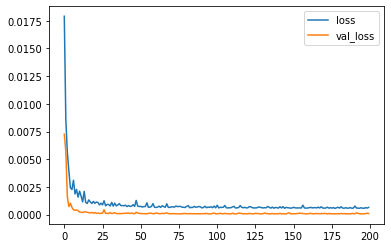

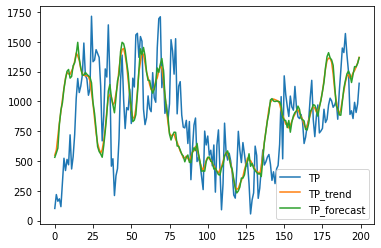

Model: "sequential_417"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1251 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1251 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1252 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1252 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1253 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1253 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_417 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0518e-04 - accuracy: 5.9467e-05 - val_loss: 9.0095e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0171e-04 - accuracy: 5.9467e-05 - val_loss: 8.8404e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.2852e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9566e-04 - accuracy: 5.9467e-05 - val_loss: 9.8920e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6707e-04 - accuracy: 5.9467e-05 - val_loss: 9.7841e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1448e-04 - accuracy: 5.9467e-05 - val_loss: 1.0024e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 8.7573e-04 - accuracy: 5.9467e-05 - val_loss: 7.3021e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9710e-04 - accuracy: 5.9467e-05 - val_loss: 7.2663e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.1925e-04 - accuracy: 5.9467e-05 - val_loss: 1.1992e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.1539e-04 - accuracy: 5.9467e-05 - val_loss: 2.1162e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4406e-04 - accuracy: 5.9467e-05 - val_loss: 8.0721e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0671e-04 - accuracy: 5.9467e-05 - val_loss: 7.0961e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0917e-04 - accuracy: 5.9467e-05 - val_loss: 9.7994e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.1091e-04 - accuracy: 5.9467e-05 - val_loss: 9.4619e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0530e-04 - accuracy: 5.9467e-05 - val_loss: 6.5871e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9765e-04 - accuracy: 5.9467e-05 - val_loss: 6.4809e-05 - val_accuracy: 0.0000e+00


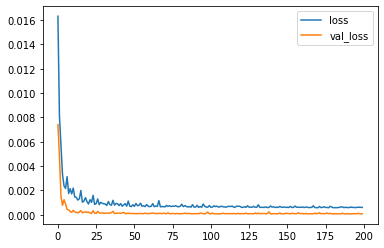

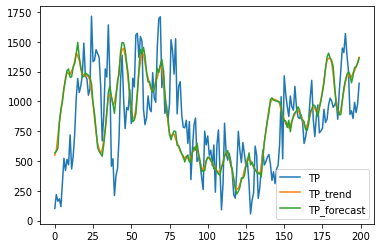

Model: "sequential_418"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1254 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1254 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1255 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1255 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1256 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1256 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_418 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4652e-04 - accuracy: 5.9467e-05 - val_loss: 1.3373e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9340e-04 - accuracy: 5.9467e-05 - val_loss: 1.3562e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4552e-04 - accuracy: 5.9467e-05 - val_loss: 2.3891e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 1.3400e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9407e-04 - accuracy: 5.9467e-05 - val_loss: 1.1963e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6255e-04 - accuracy: 5.9467e-05 - val_loss: 1.1941e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5171e-04 - accuracy: 5.9467e-05 - val_loss: 1.1257e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6067e-04 - accuracy: 5.9467e-05 - val_loss: 1.1740e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3600e-04 - accuracy: 5.9467e-05 - val_loss: 1.1104e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4849e-04 - accuracy: 5.9467e-05 - val_loss: 1.2022e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3127e-04 - accuracy: 5.9467e-05 - val_loss: 1.3625e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 7.7268e-04 - accuracy: 5.9467e-05 - val_loss: 1.3140e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2063e-04 - accuracy: 5.9467e-05 - val_loss: 1.1384e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 7.0849e-04 - accuracy: 5.9467e-05 - val_loss: 1.3994e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 9s 16ms/step - loss: 7.2817e-04 - accuracy: 5.9467e-05 - val_loss: 1.1604e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 16ms/step - loss: 6.9191e-04 - accuracy: 5.9467e-05 - val_loss: 1.0648e-04 - val_accuracy: 0.0000e+00


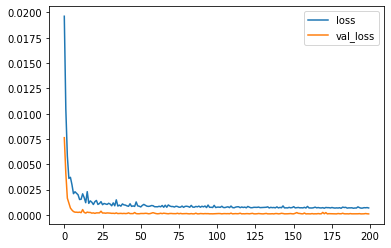

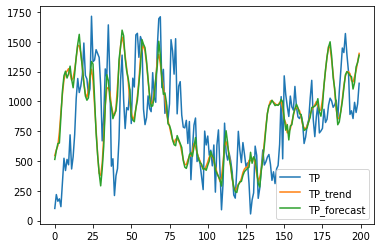

Model: "sequential_419"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1257 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1257 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1258 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1258 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1259 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1259 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_419 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 9s 17ms/step - loss: 9.0677e-04 - accuracy: 5.9467e-05 - val_loss: 1.5810e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 9s 17ms/step - loss: 9.4863e-04 - accuracy: 5.9467e-05 - val_loss: 1.3772e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 9s 17ms/step - loss: 9.0238e-04 - accuracy: 5.9467e-05 - val_loss: 1.4992e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 9s 17ms/step - loss: 8.9187e-04 - accuracy: 5.9467e-05 - val_loss: 2.1690e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 9s 17ms/step - loss: 8.1235e-04 - accuracy: 5.9467e-05 - val_loss: 1.9978e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 9s 17ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.3897e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

526/526 [==============================] - 9s 16ms/step - loss: 7.3217e-04 - accuracy: 5.9467e-05 - val_loss: 1.2357e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 9s 17ms/step - loss: 8.0396e-04 - accuracy: 5.9467e-05 - val_loss: 1.1382e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 9s 17ms/step - loss: 7.9210e-04 - accuracy: 5.9467e-05 - val_loss: 1.3643e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 9s 16ms/step - loss: 7.8024e-04 - accuracy: 5.9467e-05 - val_loss: 1.3040e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 9s 16ms/step - loss: 7.9987e-04 - accuracy: 5.9467e-05 - val_loss: 1.2569e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 16ms/step - loss: 8.1150e-04 - accuracy: 5.9467e-05 - val_loss: 1.2993e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 9s 17ms/step - loss: 7.6337e-04 - accuracy: 5.9467e-05 - val_loss: 1.2131e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 9s 17ms/step - loss: 6.9815e-04 - accuracy: 5.9467e-05 - val_loss: 1.1860e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 9s 17ms/step - loss: 7.0696e-04 - accuracy: 5.9467e-05 - val_loss: 1.1842e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 9s 16ms/step - loss: 7.6473e-04 - accuracy: 5.9467e-05 - val_loss: 1.5225e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 9s 16ms/step - loss: 7.3310e-04 - accuracy: 5.9467e-05 - val_loss: 1.4508e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 9s 16ms/step - loss: 7.3900e-04 - accuracy: 5.9467e-05 - val_loss: 1.3086e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

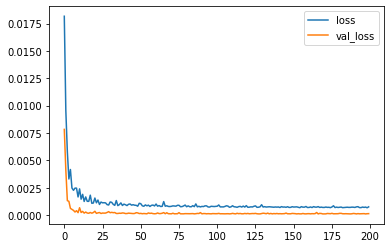

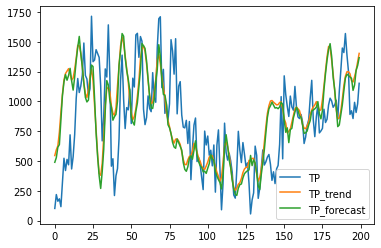

Model: "sequential_420"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1260 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1260 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1261 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1261 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1262 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1262 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_420 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7758e-04 - accuracy: 5.9467e-05 - val_loss: 2.0052e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.9641e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 9.4302e-04 - accuracy: 5.9467e-05 - val_loss: 1.7811e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 9.2846e-04 - accuracy: 5.9467e-05 - val_loss: 1.8583e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3655e-04 - accuracy: 5.9467e-05 - val_loss: 1.9317e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.6810e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

526/526 [==============================] - 8s 14ms/step - loss: 8.0469e-04 - accuracy: 5.9467e-05 - val_loss: 1.4870e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8937e-04 - accuracy: 5.9467e-05 - val_loss: 1.6699e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 7.5441e-04 - accuracy: 5.9467e-05 - val_loss: 1.6646e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 8.6139e-04 - accuracy: 5.9467e-05 - val_loss: 1.6387e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2988e-04 - accuracy: 5.9467e-05 - val_loss: 1.6657e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 14ms/step - loss: 9.2174e-04 - accuracy: 5.9467e-05 - val_loss: 1.6136e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6417e-04 - accuracy: 5.9467e-05 - val_loss: 1.5811e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2095e-04 - accuracy: 5.9467e-05 - val_loss: 1.9118e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2760e-04 - accuracy: 5.9467e-05 - val_loss: 1.6585e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1071e-04 - accuracy: 5.9467e-05 - val_loss: 1.5209e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1282e-04 - accuracy: 5.9467e-05 - val_loss: 1.5311e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1488e-04 - accuracy: 5.9467e-05 - val_loss: 1.5393e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

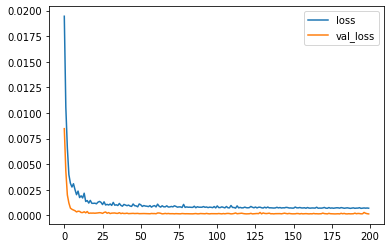

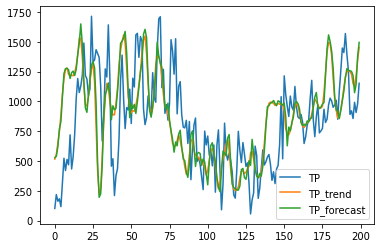

Model: "sequential_421"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1263 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1263 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1264 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1264 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1265 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1265 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_421 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4419e-04 - accuracy: 5.9467e-05 - val_loss: 1.7684e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9009e-04 - accuracy: 5.9467e-05 - val_loss: 2.2379e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 2.4554e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3495e-04 - accuracy: 5.9467e-05 - val_loss: 1.6702e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 9.1908e-04 - accuracy: 5.9467e-05 - val_loss: 1.7867e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 14ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.7796e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3908e-04 - accuracy: 5.9467e-05 - val_loss: 1.7971e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8043e-04 - accuracy: 5.9467e-05 - val_loss: 1.5138e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8381e-04 - accuracy: 5.9467e-05 - val_loss: 1.7482e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5420e-04 - accuracy: 5.9467e-05 - val_loss: 2.4347e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9054e-04 - accuracy: 5.9467e-05 - val_loss: 1.9213e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6412e-04 - accuracy: 5.9467e-05 - val_loss: 1.7038e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1131e-04 - accuracy: 5.9467e-05 - val_loss: 1.4544e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0449e-04 - accuracy: 5.9467e-05 - val_loss: 1.6046e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8338e-04 - accuracy: 5.9467e-05 - val_loss: 1.4716e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1686e-04 - accuracy: 5.9467e-05 - val_loss: 1.6029e-04 - val_accuracy: 0.0000e+00


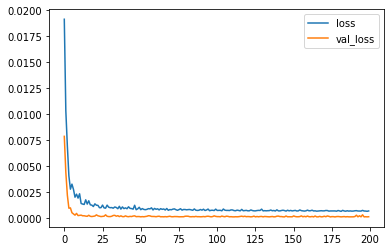

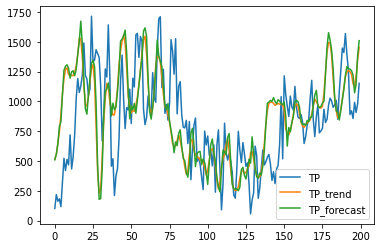

Model: "sequential_422"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1266 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1266 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1267 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1267 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1268 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1268 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_422 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 8.0035e-04 - accuracy: 5.9467e-05 - val_loss: 2.1122e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7546e-04 - accuracy: 5.9467e-05 - val_loss: 2.5250e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6355e-04 - accuracy: 5.9467e-05 - val_loss: 1.9648e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9527e-04 - accuracy: 5.9467e-05 - val_loss: 1.9572e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7050e-04 - accuracy: 5.9467e-05 - val_loss: 2.1932e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4872e-04 - accuracy: 5.9467e-05 - val_loss: 2.2637e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6641e-04 - accuracy: 5.9467e-05 - val_loss: 1.8469e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6815e-04 - accuracy: 5.9467e-05 - val_loss: 2.4629e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7757e-04 - accuracy: 5.9467e-05 - val_loss: 2.2148e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9082e-04 - accuracy: 5.9467e-05 - val_loss: 2.0887e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1097e-04 - accuracy: 5.9467e-05 - val_loss: 2.3677e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3597e-04 - accuracy: 5.9467e-05 - val_loss: 2.1871e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

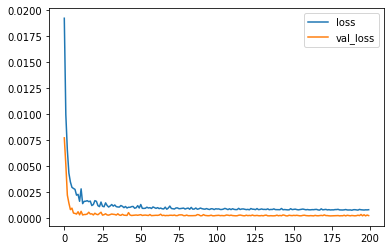

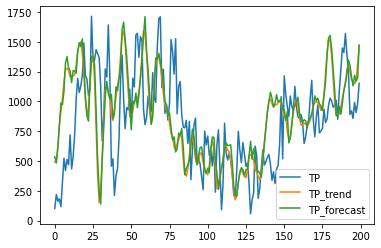

Model: "sequential_423"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1269 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1269 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1270 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1270 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1271 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1271 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_423 (Dense)            (None, 1)              

526/526 [==============================] - 8s 15ms/step - loss: 9.7379e-04 - accuracy: 5.9467e-05 - val_loss: 2.0435e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 8.8352e-04 - accuracy: 5.9467e-05 - val_loss: 2.6839e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2923e-04 - accuracy: 5.9467e-05 - val_loss: 2.0176e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6595e-04 - accuracy: 5.9467e-05 - val_loss: 2.5157e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4497e-04 - accuracy: 5.9467e-05 - val_loss: 2.0352e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 8.3097e-04 - accuracy: 5.9467e-05 - val_loss: 2.1049e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 8s 14ms/step - loss: 7.7012e-04 - accuracy: 5.9467e-05 - val_loss: 2.4412e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 14ms/step - loss: 7.8722e-04 - accuracy: 5.9467e-05 - val_loss: 1.9293e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 14ms/step - loss: 8.2100e-04 - accuracy: 5.9467e-05 - val_loss: 1.9212e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 14ms/step - loss: 7.8007e-04 - accuracy: 5.9467e-05 - val_loss: 1.9015e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 7.7855e-04 - accuracy: 5.9467e-05 - val_loss: 1.9415e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5367e-04 - accuracy: 5.9467e-05 - val_loss: 1.9947e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

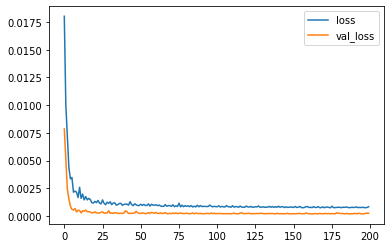

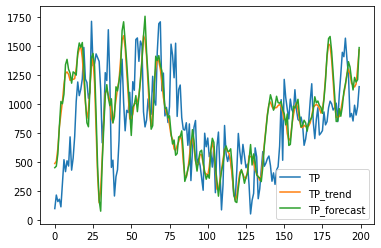

Model: "sequential_424"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1272 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1272 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1273 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1273 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1274 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1274 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_424 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 2.9734e-05 - val_loss: 2.9151e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8129e-04 - accuracy: 2.9734e-05 - val_loss: 2.9738e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5057e-04 - accuracy: 2.9734e-05 - val_loss: 3.2243e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0631e-04 - accuracy: 2.9734e-05 - val_loss: 2.8949e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 2.9734e-05 - val_loss: 5.6661e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2695e-04 - accuracy: 2.9734e-05 - val_loss: 3.7749e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] -

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5468e-04 - accuracy: 2.9734e-05 - val_loss: 2.6190e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7361e-04 - accuracy: 2.9734e-05 - val_loss: 3.0928e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8803e-04 - accuracy: 2.9734e-05 - val_loss: 2.6817e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7032e-04 - accuracy: 2.9734e-05 - val_loss: 2.9829e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4790e-04 - accuracy: 2.9734e-05 - val_loss: 2.9589e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3137e-04 - accuracy: 2.9734e-05 - val_loss: 2.4304e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

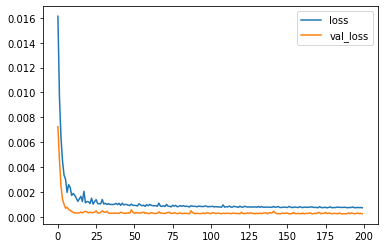

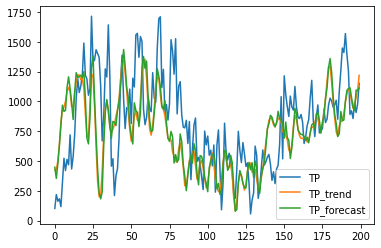

Model: "sequential_425"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1275 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1275 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1276 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1276 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1277 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1277 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_425 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5374e-06 - accuracy: 0.0000e+00 - val_loss: 6.2188e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4584e-06 - accuracy: 0.0000e+00 - val_loss: 9.5003e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0739e-06 - accuracy: 0.0000e+00 - val_loss: 3.7677e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9137e-06 - accuracy: 0.0000e+00 - val_loss: 7.9207e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4545e-06 - accuracy: 0.0000e+00 - val_loss: 2.9865e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2303e-06 - accuracy: 0.0000e+00 - val_loss: 1.2539e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7408e-06 - accuracy: 0.0000e+00 - val_loss: 2.2185e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 3.1872e-06 - accuracy: 0.0000e+00 - val_loss: 8.8459e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7462e-06 - accuracy: 0.0000e+00 - val_loss: 2.6419e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.4683e-06 - accuracy: 0.0000e+00 - val_loss: 2.0086e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2174e-06 - accuracy: 0.0000e+00 - val_loss: 1.0087e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2274e-06 - accuracy: 0.0000e+00 - val_loss: 3.5357e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9213e-06 - accuracy: 0.0000e+00 - val_loss: 1.1686e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2166e-07 - accuracy: 0.0000e+00 - val_loss: 1.6342e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7503e-06 - accuracy: 0.0000e+00 - val_loss: 9.6602e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3489e-06 - accuracy: 0.0000e+00 - val_loss: 5.5407e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8787e-06 - accuracy: 0.0000e+00 - val_loss: 7.4320e-10 - val_accuracy: 1.1893e-04


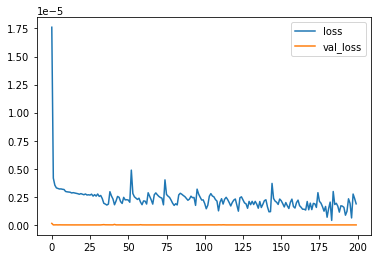

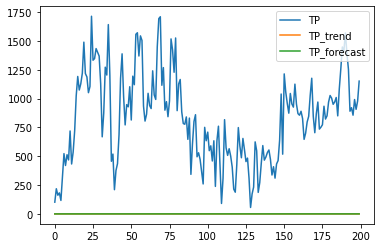

Model: "sequential_426"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1278 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1278 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1279 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1279 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1280 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1280 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_426 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1971e-06 - accuracy: 2.9734e-05 - val_loss: 3.0390e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1766e-06 - accuracy: 2.9734e-05 - val_loss: 1.0398e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0337e-06 - accuracy: 2.9734e-05 - val_loss: 1.7392e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3633e-06 - accuracy: 2.9734e-05 - val_loss: 3.8597e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9055e-06 - accuracy: 2.9734e-05 - val_loss: 2.4522e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8492e-06 - accuracy: 2.9734e-05 - val_loss: 4.3730e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8918e-06 - accuracy: 2.9734e-05 - val_loss: 3.1102e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8339e-06 - accuracy: 2.9734e-05 - val_loss: 9.6616e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5444e-06 - accuracy: 2.9734e-05 - val_loss: 2.7789e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5538e-06 - accuracy: 2.9734e-05 - val_loss: 2.8741e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2301e-06 - accuracy: 2.9734e-05 - val_loss: 6.1020e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0219e-06 - accuracy: 2.9734e-05 - val_loss: 3.2045e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3986e-06 - accuracy: 2.9734e-05 - val_loss: 1.1846e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6760e-06 - accuracy: 2.9734e-05 - val_loss: 1.3395e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0792e-06 - accuracy: 2.9734e-05 - val_loss: 1.3152e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9234e-06 - accuracy: 2.9734e-05 - val_loss: 9.9327e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8839e-06 - accuracy: 2.9734e-05 - val_loss: 1.3346e-10 - val_accuracy: 0.0000e+00


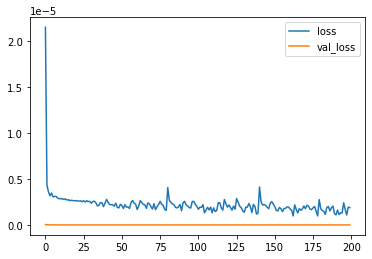

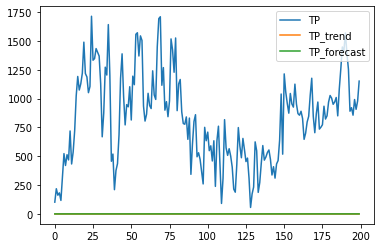

Model: "sequential_427"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1281 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1281 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1282 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1282 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1283 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1283 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_427 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 14ms/step - loss: 2.4738e-06 - accuracy: 2.9734e-05 - val_loss: 2.7937e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 14ms/step - loss: 2.4409e-06 - accuracy: 2.9734e-05 - val_loss: 2.4978e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 2.2510e-06 - accuracy: 2.9734e-05 - val_loss: 2.5148e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 2.5704e-06 - accuracy: 2.9734e-05 - val_loss: 2.7017e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 2.2950e-06 - accuracy: 2.9734e-05 - val_loss: 3.2350e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 1.8044e-06 - accuracy: 2.9734e-05 - val_loss: 1.1259e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 14ms/step - loss: 2.6254e-06 - accuracy: 2.9734e-05 - val_loss: 4.9335e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3735e-06 - accuracy: 2.9734e-05 - val_loss: 1.4665e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 14ms/step - loss: 2.2615e-06 - accuracy: 2.9734e-05 - val_loss: 1.9705e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 2.0568e-06 - accuracy: 2.9734e-05 - val_loss: 7.5989e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 1.0462e-06 - accuracy: 2.9734e-05 - val_loss: 9.9228e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 1.9095e-06 - accuracy: 2.9734e-05 - val_loss: 1.3517e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 14ms/step - loss: 2.1424e-06 - accuracy: 2.9734e-05 - val_loss: 4.6538e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 14ms/step - loss: 1.7670e-06 - accuracy: 2.9734e-05 - val_loss: 1.2582e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 14ms/step - loss: 1.3100e-06 - accuracy: 2.9734e-05 - val_loss: 1.4894e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 14ms/step - loss: 8.0792e-07 - accuracy: 2.9734e-05 - val_loss: 5.1997e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 14ms/step - loss: 1.1623e-06 - accuracy: 2.9734e-05 - val_loss: 9.1686e-10 - val_accuracy: 0.0000e+00


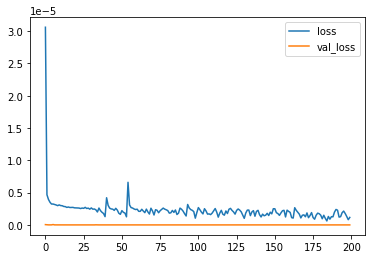

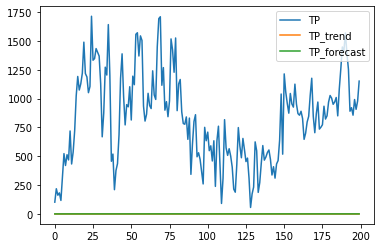

Model: "sequential_428"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1284 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1284 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1285 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1285 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1286 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1286 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_428 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2003e-06 - accuracy: 0.0000e+00 - val_loss: 8.6188e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8837e-06 - accuracy: 0.0000e+00 - val_loss: 4.5133e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8741e-06 - accuracy: 0.0000e+00 - val_loss: 2.3478e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7639e-06 - accuracy: 0.0000e+00 - val_loss: 8.7547e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2996e-06 - accuracy: 0.0000e+00 - val_loss: 8.7531e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5317e-06 - accuracy: 0.0000e+00 - val_loss: 1.5751e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2837e-06 - accuracy: 0.0000e+00 - val_loss: 5.9513e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9026e-06 - accuracy: 0.0000e+00 - val_loss: 2.2320e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4141e-06 - accuracy: 0.0000e+00 - val_loss: 1.2465e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0020e-06 - accuracy: 0.0000e+00 - val_loss: 1.4788e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7901e-06 - accuracy: 0.0000e+00 - val_loss: 7.5116e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4880e-06 - accuracy: 0.0000e+00 - val_loss: 4.6946e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3162e-06 - accuracy: 0.0000e+00 - val_loss: 2.2585e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5521e-06 - accuracy: 0.0000e+00 - val_loss: 4.1926e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0224e-06 - accuracy: 0.0000e+00 - val_loss: 9.2169e-11 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0074e-06 - accuracy: 0.0000e+00 - val_loss: 5.8644e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7814e-06 - accuracy: 0.0000e+00 - val_loss: 8.1488e-10 - val_accuracy: 1.1893e-04


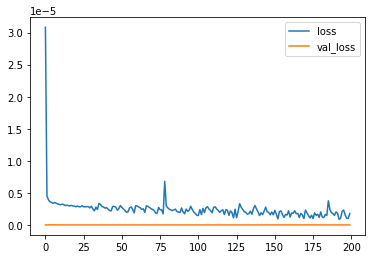

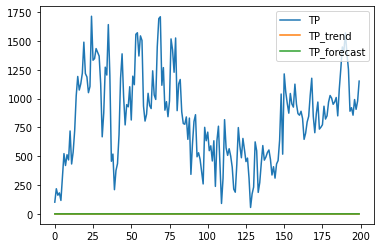

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_429"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1287 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1287 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1288 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1288 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1289 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1289 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_429 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 2.4827e-06 - accuracy: 0.0000e+00 - val_loss: 3.4082e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5963e-06 - accuracy: 0.0000e+00 - val_loss: 2.2583e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3966e-06 - accuracy: 0.0000e+00 - val_loss: 1.2303e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 1.9473e-06 - accuracy: 0.0000e+00 - val_loss: 2.1764e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6896e-06 - accuracy: 0.0000e+00 - val_loss: 3.6934e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 2.8295e-06 - accuracy: 0.0000e+00 - val_loss: 1.3404e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8508e-06 - accuracy: 0.0000e+00 - val_loss: 1.4200e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5921e-06 - accuracy: 0.0000e+00 - val_loss: 5.5562e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 2.7229e-06 - accuracy: 0.0000e+00 - val_loss: 4.9953e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3655e-06 - accuracy: 0.0000e+00 - val_loss: 4.9232e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.9581e-06 - accuracy: 0.0000e+00 - val_loss: 1.8808e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3794e-06 - accuracy: 0.0000e+00 - val_loss: 2.5590e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.9481e-06 - accuracy: 0.0000e+00 - val_loss: 3.4220e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5744e-06 - accuracy: 0.0000e+00 - val_loss: 1.6467e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3112e-06 - accuracy: 0.0000e+00 - val_loss: 3.6429e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6228e-06 - accuracy: 0.0000e+00 - val_loss: 3.7582e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.9234e-06 - accuracy: 0.0000e+00 - val_loss: 2.2632e-09 - val_accuracy: 1.1893e-04


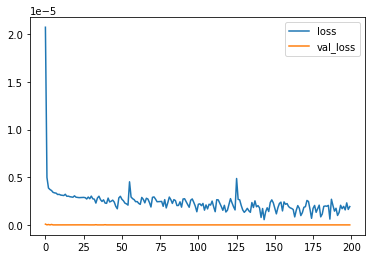

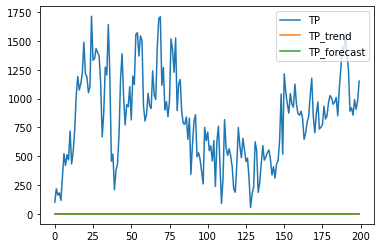

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_430"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1290 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1290 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1291 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1291 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1292 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1292 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_430 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8519e-06 - accuracy: 0.0000e+00 - val_loss: 1.9886e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 2.8044e-06 - accuracy: 0.0000e+00 - val_loss: 6.8076e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6287e-06 - accuracy: 0.0000e+00 - val_loss: 1.0074e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5413e-06 - accuracy: 0.0000e+00 - val_loss: 1.3536e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9283e-06 - accuracy: 0.0000e+00 - val_loss: 4.2809e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 2.7216e-06 - accuracy: 0.0000e+00 - val_loss: 6.0008e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0394e-06 - accuracy: 0.0000e+00 - val_loss: 2.5656e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 3.0539e-06 - accuracy: 0.0000e+00 - val_loss: 3.8878e-09 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 2.4322e-06 - accuracy: 0.0000e+00 - val_loss: 1.5052e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8414e-06 - accuracy: 0.0000e+00 - val_loss: 1.1036e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4790e-06 - accuracy: 0.0000e+00 - val_loss: 1.5833e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5216e-06 - accuracy: 0.0000e+00 - val_loss: 6.3694e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 2.1303e-06 - accuracy: 0.0000e+00 - val_loss: 1.8525e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 2.2233e-06 - accuracy: 0.0000e+00 - val_loss: 1.5547e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 1.0717e-06 - accuracy: 0.0000e+00 - val_loss: 4.9333e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9525e-06 - accuracy: 0.0000e+00 - val_loss: 1.8042e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.9683e-06 - accuracy: 0.0000e+00 - val_loss: 1.3267e-09 - val_accuracy: 1.1893e-04


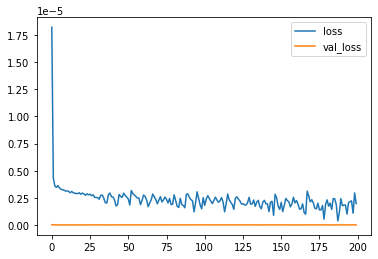

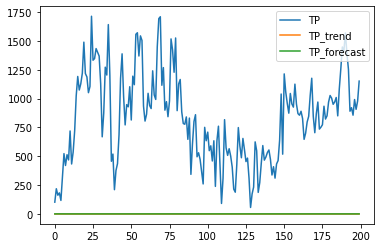

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_431"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1293 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1293 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1294 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1294 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1295 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1295 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_431 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 14ms/step - loss: 2.5972e-06 - accuracy: 2.9734e-05 - val_loss: 8.2769e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3702e-06 - accuracy: 2.9734e-05 - val_loss: 5.1148e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 2.4392e-06 - accuracy: 2.9734e-05 - val_loss: 1.3343e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 2.3161e-06 - accuracy: 2.9734e-05 - val_loss: 5.3554e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 14ms/step - loss: 2.8835e-06 - accuracy: 2.9734e-05 - val_loss: 4.1458e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 2.4044e-06 - accuracy: 2.9734e-05 - val_loss: 5.0582e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 2.0638e-06 - accuracy: 2.9734e-05 - val_loss: 3.3717e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 2.7623e-06 - accuracy: 2.9734e-05 - val_loss: 1.0090e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 2.7333e-06 - accuracy: 2.9734e-05 - val_loss: 7.7602e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 2.5868e-06 - accuracy: 2.9734e-05 - val_loss: 1.5313e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 2.2401e-06 - accuracy: 2.9734e-05 - val_loss: 7.5580e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8001e-06 - accuracy: 2.9734e-05 - val_loss: 4.8753e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8688e-06 - accuracy: 2.9734e-05 - val_loss: 1.9696e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 2.0644e-06 - accuracy: 2.9734e-05 - val_loss: 1.0199e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2540e-06 - accuracy: 2.9734e-05 - val_loss: 2.9571e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 1.1923e-06 - accuracy: 2.9734e-05 - val_loss: 1.1334e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 1.6154e-06 - accuracy: 2.9734e-05 - val_loss: 2.8864e-10 - val_accuracy: 0.0000e+00


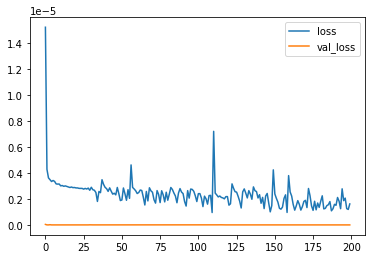

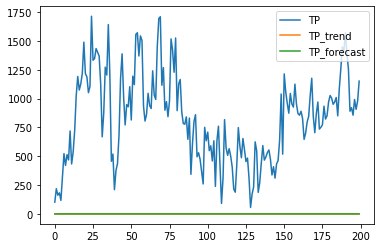

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_432"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1296 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1296 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1297 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1297 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1298 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1298 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_432 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7161e-06 - accuracy: 0.0000e+00 - val_loss: 5.1809e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5229e-06 - accuracy: 0.0000e+00 - val_loss: 3.0899e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5940e-06 - accuracy: 0.0000e+00 - val_loss: 7.1794e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8495e-06 - accuracy: 0.0000e+00 - val_loss: 7.6680e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0117e-06 - accuracy: 0.0000e+00 - val_loss: 6.3594e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5896e-06 - accuracy: 0.0000e+00 - val_loss: 3.4578e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5468e-06 - accuracy: 0.0000e+00 - val_loss: 6.2753e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9914e-06 - accuracy: 0.0000e+00 - val_loss: 2.9829e-09 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5675e-06 - accuracy: 0.0000e+00 - val_loss: 8.1540e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6911e-06 - accuracy: 0.0000e+00 - val_loss: 9.8661e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5835e-06 - accuracy: 0.0000e+00 - val_loss: 7.0699e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5683e-06 - accuracy: 0.0000e+00 - val_loss: 1.0863e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5823e-06 - accuracy: 0.0000e+00 - val_loss: 1.7253e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5219e-06 - accuracy: 0.0000e+00 - val_loss: 5.0504e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0626e-06 - accuracy: 0.0000e+00 - val_loss: 5.1794e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8684e-06 - accuracy: 0.0000e+00 - val_loss: 2.0794e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3527e-06 - accuracy: 0.0000e+00 - val_loss: 2.9419e-10 - val_accuracy: 1.1893e-04


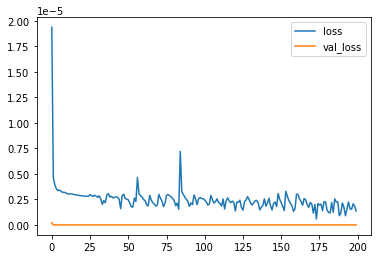

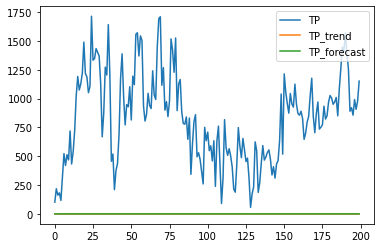

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_433"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1299 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1299 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1300 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1300 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1301 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1301 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_433 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7778e-06 - accuracy: 0.0000e+00 - val_loss: 8.9129e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5416e-06 - accuracy: 0.0000e+00 - val_loss: 2.0265e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4493e-06 - accuracy: 0.0000e+00 - val_loss: 8.4663e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3318e-06 - accuracy: 0.0000e+00 - val_loss: 8.9158e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9806e-06 - accuracy: 0.0000e+00 - val_loss: 1.8875e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5586e-06 - accuracy: 0.0000e+00 - val_loss: 1.5184e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1380e-06 - accuracy: 0.0000e+00 - val_loss: 8.4021e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2537e-06 - accuracy: 0.0000e+00 - val_loss: 1.2192e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8058e-06 - accuracy: 0.0000e+00 - val_loss: 1.8548e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9145e-06 - accuracy: 0.0000e+00 - val_loss: 5.2336e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2991e-06 - accuracy: 0.0000e+00 - val_loss: 2.0233e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7094e-06 - accuracy: 0.0000e+00 - val_loss: 3.7584e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8512e-06 - accuracy: 0.0000e+00 - val_loss: 7.3545e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3259e-06 - accuracy: 0.0000e+00 - val_loss: 3.6000e-11 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4132e-06 - accuracy: 0.0000e+00 - val_loss: 2.1808e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6741e-06 - accuracy: 0.0000e+00 - val_loss: 8.9496e-11 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0146e-06 - accuracy: 0.0000e+00 - val_loss: 1.9375e-09 - val_accuracy: 1.1893e-04


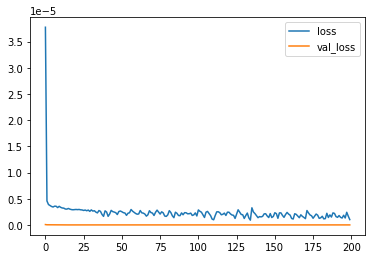

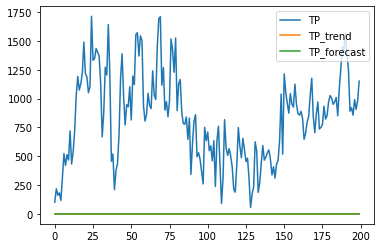

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_434"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1302 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1302 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1303 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1303 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1304 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1304 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_434 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1826e-06 - accuracy: 2.9734e-05 - val_loss: 1.3594e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7724e-06 - accuracy: 2.9734e-05 - val_loss: 2.7376e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5628e-06 - accuracy: 2.9734e-05 - val_loss: 9.0175e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5376e-06 - accuracy: 2.9734e-05 - val_loss: 1.2157e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0156e-06 - accuracy: 2.9734e-05 - val_loss: 4.0144e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3995e-06 - accuracy: 2.9734e-05 - val_loss: 7.6336e-11 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0825e-06 - accuracy: 2.9734e-05 - val_loss: 3.3056e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7782e-06 - accuracy: 2.9734e-05 - val_loss: 1.2189e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6790e-06 - accuracy: 2.9734e-05 - val_loss: 1.1999e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2428e-06 - accuracy: 2.9734e-05 - val_loss: 5.6882e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2840e-06 - accuracy: 2.9734e-05 - val_loss: 7.3672e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0373e-06 - accuracy: 2.9734e-05 - val_loss: 3.1360e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6282e-06 - accuracy: 2.9734e-05 - val_loss: 8.4031e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3983e-06 - accuracy: 2.9734e-05 - val_loss: 2.2006e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0580e-06 - accuracy: 2.9734e-05 - val_loss: 7.0737e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9227e-07 - accuracy: 2.9734e-05 - val_loss: 6.2426e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8277e-06 - accuracy: 2.9734e-05 - val_loss: 2.1435e-09 - val_accuracy: 0.0000e+00


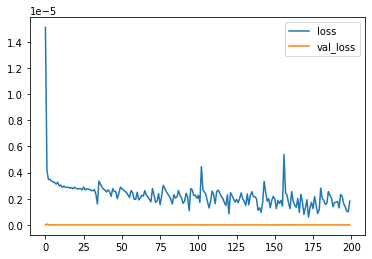

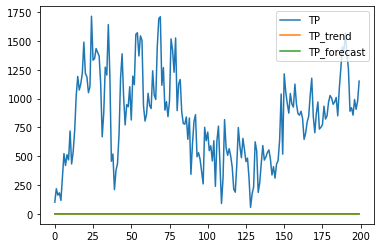

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_435"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1305 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1305 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1306 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1306 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1307 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1307 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_435 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 16ms/step - loss: 2.6059e-06 - accuracy: 2.9734e-05 - val_loss: 6.0600e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 16ms/step - loss: 2.4841e-06 - accuracy: 2.9734e-05 - val_loss: 7.3906e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 16ms/step - loss: 2.5034e-06 - accuracy: 2.9734e-05 - val_loss: 8.3656e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 9s 17ms/step - loss: 2.0151e-06 - accuracy: 2.9734e-05 - val_loss: 4.8272e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 16ms/step - loss: 2.1831e-06 - accuracy: 2.9734e-05 - val_loss: 1.3014e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 3.0101e-06 - accuracy: 2.9734e-05 - val_loss: 1.8659e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3571e-06 - accuracy: 2.9734e-05 - val_loss: 8.2603e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 2.1536e-06 - accuracy: 2.9734e-05 - val_loss: 1.1352e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3094e-06 - accuracy: 2.9734e-05 - val_loss: 4.2577e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4031e-06 - accuracy: 2.9734e-05 - val_loss: 6.5024e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.6910e-06 - accuracy: 2.9734e-05 - val_loss: 1.3548e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 2.4742e-06 - accuracy: 2.9734e-05 - val_loss: 6.5766e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 2.1805e-06 - accuracy: 2.9734e-05 - val_loss: 3.5509e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 1.3923e-06 - accuracy: 2.9734e-05 - val_loss: 1.0576e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6685e-07 - accuracy: 2.9734e-05 - val_loss: 3.8216e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 3.5930e-06 - accuracy: 2.9734e-05 - val_loss: 3.8892e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 2.2182e-06 - accuracy: 2.9734e-05 - val_loss: 3.3028e-09 - val_accuracy: 0.0000e+00


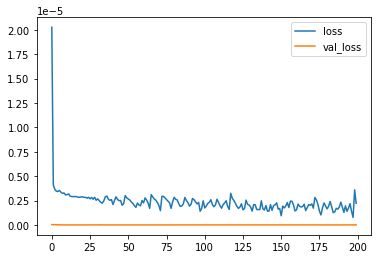

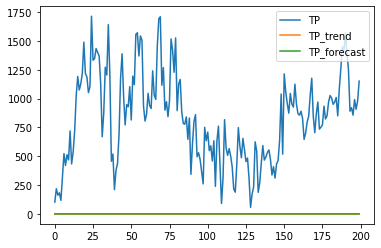

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_436"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1308 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1308 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1309 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1309 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1310 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1310 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_436 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6733e-06 - accuracy: 2.9734e-05 - val_loss: 8.0176e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5340e-06 - accuracy: 2.9734e-05 - val_loss: 9.2423e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 2.7432e-06 - accuracy: 2.9734e-05 - val_loss: 1.2863e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6321e-06 - accuracy: 2.9734e-05 - val_loss: 7.0929e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5679e-06 - accuracy: 2.9734e-05 - val_loss: 1.5057e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3319e-06 - accuracy: 2.9734e-05 - val_loss: 2.9850e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3823e-06 - accuracy: 2.9734e-05 - val_loss: 1.7059e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0315e-06 - accuracy: 2.9734e-05 - val_loss: 4.9005e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0374e-06 - accuracy: 2.9734e-05 - val_loss: 1.0767e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6089e-06 - accuracy: 2.9734e-05 - val_loss: 2.3272e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 2.2284e-06 - accuracy: 2.9734e-05 - val_loss: 6.1822e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5733e-06 - accuracy: 2.9734e-05 - val_loss: 5.1039e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6430e-06 - accuracy: 2.9734e-05 - val_loss: 3.6899e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6252e-06 - accuracy: 2.9734e-05 - val_loss: 4.1050e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6916e-06 - accuracy: 2.9734e-05 - val_loss: 2.4140e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0232e-06 - accuracy: 2.9734e-05 - val_loss: 9.1192e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.7217e-06 - accuracy: 2.9734e-05 - val_loss: 1.6349e-10 - val_accuracy: 0.0000e+00


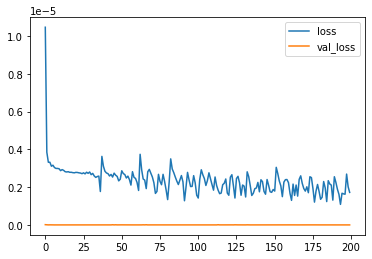

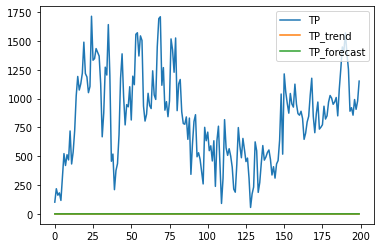

Model: "sequential_437"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1311 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1311 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1312 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1312 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1313 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1313 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_437 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 9.0249e-04 - accuracy: 0.0732 - val_loss: 2.6886e-05 - val_accuracy: 0.1000
Epoch 102/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1843e-04 - accuracy: 0.0732 - val_loss: 1.0965e-04 - val_accuracy: 0.1000
Epoch 103/200
526/526 [==============================] - 7s 14ms/step - loss: 8.0370e-04 - accuracy: 0.0732 - val_loss: 4.1300e-05 - val_accuracy: 0.1000
Epoch 104/200
526/526 [==============================] - 7s 14ms/step - loss: 9.4759e-04 - accuracy: 0.0732 - val_loss: 7.3805e-05 - val_accuracy: 0.1000
Epoch 105/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1013e-04 - accuracy: 0.0732 - val_loss: 8.3169e-05 - val_accuracy: 0.1000
Epoch 106/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0483e-04 - accuracy: 0.0732 - val_loss: 5.4401e-05 - val_accuracy: 0.1000
Epoch 107/200
526/526 [==============================] - 7s 14ms/step - loss: 9.8185e-04 -

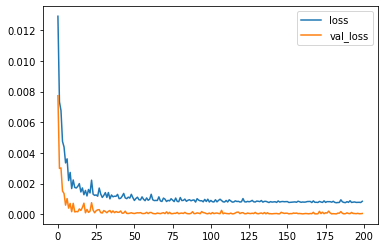

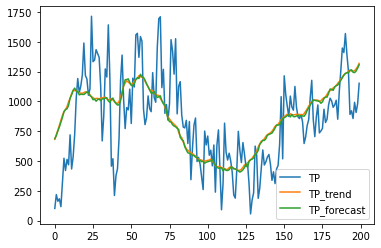

Model: "sequential_438"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1314 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1314 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1315 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1315 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1316 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1316 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_438 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.4787e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.8462e-04 - accuracy: 5.9467e-05 - val_loss: 7.2440e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4164e-04 - accuracy: 5.9467e-05 - val_loss: 5.5393e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 14ms/step - loss: 8.1058e-04 - accuracy: 5.9467e-05 - val_loss: 8.0936e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8189e-04 - accuracy: 5.9467e-05 - val_loss: 1.5112e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1924e-04 - accuracy: 5.9467e-05 - val_loss: 1.6925e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5454e-04 - accuracy: 5.9467e-05 - val_loss: 4.1186e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6288e-04 - accuracy: 5.9467e-05 - val_loss: 5.6094e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1156e-04 - accuracy: 5.9467e-05 - val_loss: 5.3923e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.0401e-04 - accuracy: 5.9467e-05 - val_loss: 4.2189e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2445e-04 - accuracy: 5.9467e-05 - val_loss: 5.3509e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6153e-04 - accuracy: 5.9467e-05 - val_loss: 6.3372e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3547e-04 - accuracy: 5.9467e-05 - val_loss: 7.0811e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5189e-04 - accuracy: 5.9467e-05 - val_loss: 7.3190e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2495e-04 - accuracy: 5.9467e-05 - val_loss: 5.3687e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6316e-04 - accuracy: 5.9467e-05 - val_loss: 6.6029e-05 - val_accuracy: 0.0000e+00


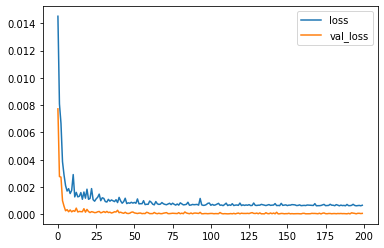

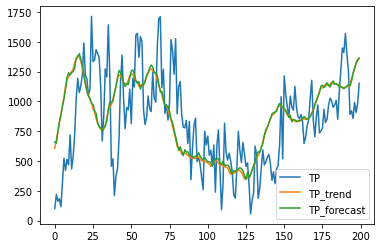

Model: "sequential_439"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1317 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1317 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1318 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1318 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1319 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1319 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_439 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0014 - accuracy: 5.9467e-05 - val_loss: 1.5698e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0610e-04 - accuracy: 5.9467e-05 - val_loss: 6.3742e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.8006e-04 - accuracy: 5.9467e-05 - val_loss: 6.6334e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 9.4116e-04 - accuracy: 5.9467e-05 - val_loss: 7.6918e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9274e-04 - accuracy: 5.9467e-05 - val_loss: 6.4555e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5407e-04 - accuracy: 5.9467e-05 - val_loss: 5.1393e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6955e-04 - accuracy: 5.9467e-05 - val_loss: 4.0969e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9310e-04 - accuracy: 5.9467e-05 - val_loss: 4.7862e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9010e-04 - accuracy: 5.9467e-05 - val_loss: 4.5323e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 6.6832e-04 - accuracy: 5.9467e-05 - val_loss: 4.5489e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 7.8998e-04 - accuracy: 5.9467e-05 - val_loss: 6.1514e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4799e-04 - accuracy: 5.9467e-05 - val_loss: 3.5771e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 6.2709e-04 - accuracy: 5.9467e-05 - val_loss: 4.1310e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 6.1845e-04 - accuracy: 5.9467e-05 - val_loss: 3.5979e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4341e-04 - accuracy: 5.9467e-05 - val_loss: 1.1350e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 6.7679e-04 - accuracy: 5.9467e-05 - val_loss: 4.2476e-05 - val_accuracy: 0.0000e+00


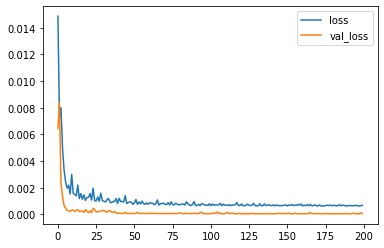

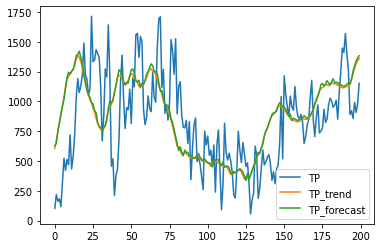

Model: "sequential_440"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1320 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1320 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1321 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1321 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1322 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1322 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_440 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1508e-04 - accuracy: 5.9467e-05 - val_loss: 8.1113e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7033e-04 - accuracy: 5.9467e-05 - val_loss: 6.7695e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 8.4245e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9032e-04 - accuracy: 5.9467e-05 - val_loss: 9.5116e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5847e-04 - accuracy: 5.9467e-05 - val_loss: 7.4296e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6168e-04 - accuracy: 5.9467e-05 - val_loss: 7.5114e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7008e-04 - accuracy: 5.9467e-05 - val_loss: 7.3297e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6951e-04 - accuracy: 5.9467e-05 - val_loss: 5.5565e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.6666e-04 - accuracy: 5.9467e-05 - val_loss: 5.5010e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1594e-04 - accuracy: 5.9467e-05 - val_loss: 5.1983e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6623e-04 - accuracy: 5.9467e-05 - val_loss: 4.8603e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5949e-04 - accuracy: 5.9467e-05 - val_loss: 8.0857e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4577e-04 - accuracy: 5.9467e-05 - val_loss: 6.3227e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1684e-04 - accuracy: 5.9467e-05 - val_loss: 4.3296e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7587e-04 - accuracy: 5.9467e-05 - val_loss: 5.8921e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2881e-04 - accuracy: 5.9467e-05 - val_loss: 4.3042e-05 - val_accuracy: 0.0000e+00


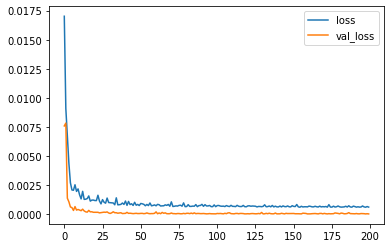

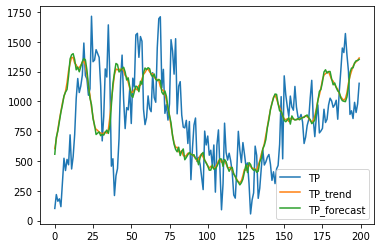

Model: "sequential_441"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1323 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1323 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1324 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1324 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1325 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1325 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_441 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.2071e-04 - accuracy: 5.9467e-05 - val_loss: 8.9756e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4740e-04 - accuracy: 5.9467e-05 - val_loss: 8.6300e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 8.8134e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1466e-04 - accuracy: 5.9467e-05 - val_loss: 1.0279e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.7074e-04 - accuracy: 5.9467e-05 - val_loss: 9.3096e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4814e-04 - accuracy: 5.9467e-05 - val_loss: 8.6430e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9435e-04 - accuracy: 5.9467e-05 - val_loss: 7.4718e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8431e-04 - accuracy: 5.9467e-05 - val_loss: 1.6073e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1462e-04 - accuracy: 5.9467e-05 - val_loss: 1.0367e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7879e-04 - accuracy: 5.9467e-05 - val_loss: 5.5623e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2329e-04 - accuracy: 5.9467e-05 - val_loss: 6.3702e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1886e-04 - accuracy: 5.9467e-05 - val_loss: 9.3231e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1374e-04 - accuracy: 5.9467e-05 - val_loss: 9.4039e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3070e-04 - accuracy: 5.9467e-05 - val_loss: 5.3539e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2569e-04 - accuracy: 5.9467e-05 - val_loss: 4.8858e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6803e-04 - accuracy: 5.9467e-05 - val_loss: 1.2153e-04 - val_accuracy: 0.0000e+00


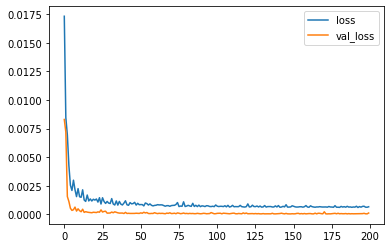

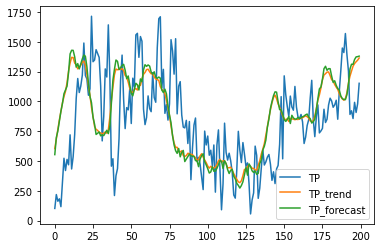

Model: "sequential_442"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1326 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1326 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1327 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1327 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1328 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1328 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_442 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0015 - accuracy: 5.9467e-05 - val_loss: 4.0658e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7340e-04 - accuracy: 5.9467e-05 - val_loss: 1.6401e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7254e-04 - accuracy: 5.9467e-05 - val_loss: 1.0444e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7541e-04 - accuracy: 5.9467e-05 - val_loss: 8.7654e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9822e-04 - accuracy: 5.9467e-05 - val_loss: 1.0089e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9402e-04 - accuracy: 5.9467e-05 - val_loss: 8.9891e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2388e-04 - accuracy: 5.9467e-05 - val_loss: 9.8167e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4455e-04 - accuracy: 5.9467e-05 - val_loss: 7.1136e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7805e-04 - accuracy: 5.9467e-05 - val_loss: 8.8305e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4765e-04 - accuracy: 5.9467e-05 - val_loss: 6.7234e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0464e-04 - accuracy: 5.9467e-05 - val_loss: 8.1923e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1908e-04 - accuracy: 5.9467e-05 - val_loss: 6.5894e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0177e-04 - accuracy: 5.9467e-05 - val_loss: 6.3634e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3388e-04 - accuracy: 5.9467e-05 - val_loss: 9.1079e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9404e-04 - accuracy: 5.9467e-05 - val_loss: 9.1557e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3640e-04 - accuracy: 5.9467e-05 - val_loss: 6.0841e-05 - val_accuracy: 0.0000e+00


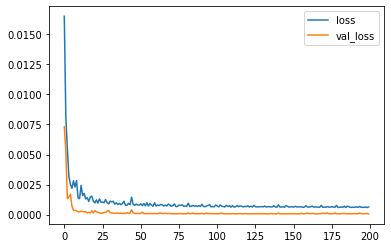

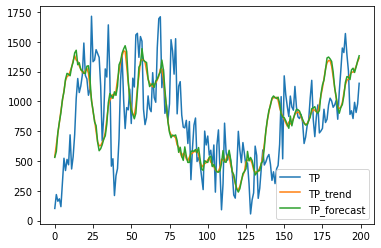

Model: "sequential_443"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1329 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1329 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1330 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1330 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1331 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1331 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_443 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5196e-04 - accuracy: 5.9467e-05 - val_loss: 1.4783e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 8.4384e-04 - accuracy: 5.9467e-05 - val_loss: 1.3585e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0818e-04 - accuracy: 5.9467e-05 - val_loss: 1.1769e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 7.9959e-04 - accuracy: 5.9467e-05 - val_loss: 8.3569e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 7.9754e-04 - accuracy: 5.9467e-05 - val_loss: 1.0145e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 7.8483e-04 - accuracy: 5.9467e-05 - val_loss: 7.9361e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3595e-04 - accuracy: 5.9467e-05 - val_loss: 8.7916e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5052e-04 - accuracy: 5.9467e-05 - val_loss: 8.1702e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1809e-04 - accuracy: 5.9467e-05 - val_loss: 9.2625e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 6.5363e-04 - accuracy: 5.9467e-05 - val_loss: 1.0273e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 7.0649e-04 - accuracy: 5.9467e-05 - val_loss: 7.7846e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9234e-04 - accuracy: 5.9467e-05 - val_loss: 8.4332e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 6.2615e-04 - accuracy: 5.9467e-05 - val_loss: 6.7236e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 6.2449e-04 - accuracy: 5.9467e-05 - val_loss: 6.4943e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 6.1704e-04 - accuracy: 5.9467e-05 - val_loss: 6.4867e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4294e-04 - accuracy: 5.9467e-05 - val_loss: 9.0929e-05 - val_accuracy: 0.0000e+00


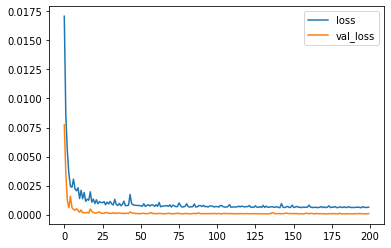

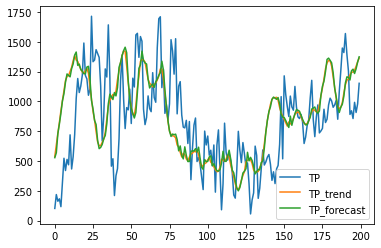

Model: "sequential_444"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1332 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1332 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1333 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1333 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1334 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1334 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_444 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6013e-04 - accuracy: 5.9467e-05 - val_loss: 1.0293e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.3341e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7249e-04 - accuracy: 5.9467e-05 - val_loss: 9.7363e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4347e-04 - accuracy: 5.9467e-05 - val_loss: 1.7597e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4476e-04 - accuracy: 5.9467e-05 - val_loss: 1.1028e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.5888e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1856e-04 - accuracy: 5.9467e-05 - val_loss: 9.3790e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8134e-04 - accuracy: 5.9467e-05 - val_loss: 9.7259e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0134e-04 - accuracy: 5.9467e-05 - val_loss: 9.4123e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9988e-04 - accuracy: 5.9467e-05 - val_loss: 1.1272e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5559e-04 - accuracy: 5.9467e-05 - val_loss: 1.0919e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0689e-04 - accuracy: 5.9467e-05 - val_loss: 1.2168e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6688e-04 - accuracy: 5.9467e-05 - val_loss: 1.1983e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2750e-04 - accuracy: 5.9467e-05 - val_loss: 1.1582e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6264e-04 - accuracy: 5.9467e-05 - val_loss: 9.3554e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3738e-04 - accuracy: 5.9467e-05 - val_loss: 9.9793e-05 - val_accuracy: 0.0000e+00


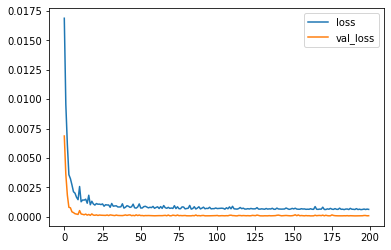

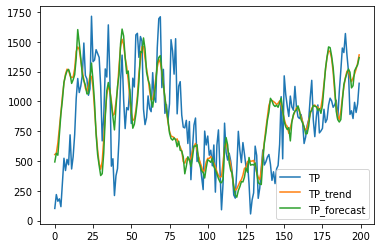

Model: "sequential_445"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1335 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1335 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1336 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1336 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1337 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1337 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_445 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9853e-04 - accuracy: 5.9467e-05 - val_loss: 1.0945e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0745e-04 - accuracy: 5.9467e-05 - val_loss: 1.3566e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6614e-04 - accuracy: 5.9467e-05 - val_loss: 1.0542e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.6417e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6232e-04 - accuracy: 5.9467e-05 - val_loss: 9.7277e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3978e-04 - accuracy: 5.9467e-05 - val_loss: 1.4646e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9291e-04 - accuracy: 5.9467e-05 - val_loss: 9.6561e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1281e-04 - accuracy: 5.9467e-05 - val_loss: 9.0241e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4210e-04 - accuracy: 5.9467e-05 - val_loss: 9.7418e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9489e-04 - accuracy: 5.9467e-05 - val_loss: 8.9108e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2231e-04 - accuracy: 5.9467e-05 - val_loss: 1.0339e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.9117e-04 - accuracy: 5.9467e-05 - val_loss: 1.1532e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2290e-04 - accuracy: 5.9467e-05 - val_loss: 9.0419e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4035e-04 - accuracy: 5.9467e-05 - val_loss: 9.7627e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4683e-04 - accuracy: 5.9467e-05 - val_loss: 8.9055e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3221e-04 - accuracy: 5.9467e-05 - val_loss: 1.3963e-04 - val_accuracy: 0.0000e+00


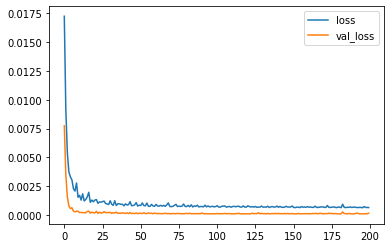

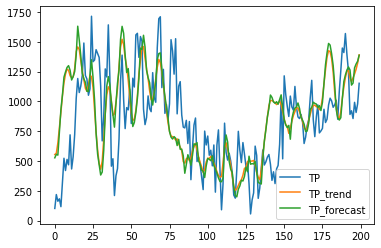

Model: "sequential_446"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1338 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1338 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1339 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1339 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1340 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1340 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_446 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.0277e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8125e-04 - accuracy: 5.9467e-05 - val_loss: 1.5529e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.5926e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8865e-04 - accuracy: 5.9467e-05 - val_loss: 1.5822e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6972e-04 - accuracy: 5.9467e-05 - val_loss: 1.7698e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9640e-04 - accuracy: 5.9467e-05 - val_loss: 1.7738e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] -

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4046e-04 - accuracy: 5.9467e-05 - val_loss: 1.3980e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2737e-04 - accuracy: 5.9467e-05 - val_loss: 1.2219e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7882e-04 - accuracy: 5.9467e-05 - val_loss: 1.8388e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3552e-04 - accuracy: 5.9467e-05 - val_loss: 1.5306e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8983e-04 - accuracy: 5.9467e-05 - val_loss: 1.5990e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0628e-04 - accuracy: 5.9467e-05 - val_loss: 1.3675e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

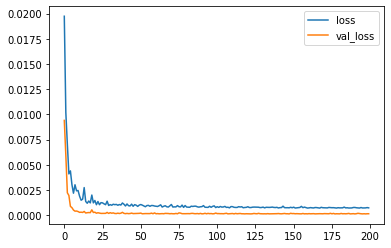

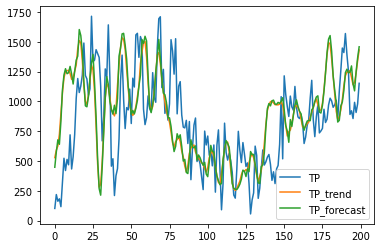

Model: "sequential_447"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1341 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1341 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1342 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1342 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1343 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1343 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_447 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 14ms/step - loss: 9.0915e-04 - accuracy: 5.9467e-05 - val_loss: 1.4593e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 8.2676e-04 - accuracy: 5.9467e-05 - val_loss: 1.5979e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 9.2139e-04 - accuracy: 5.9467e-05 - val_loss: 1.5383e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 14ms/step - loss: 9.8954e-04 - accuracy: 5.9467e-05 - val_loss: 1.4272e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 9.3099e-04 - accuracy: 5.9467e-05 - val_loss: 2.2992e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 14ms/step - loss: 9.8217e-04 - accuracy: 5.9467e-05 - val_loss: 1.6679e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 8s 14ms/step - loss: 8.8690e-04 - accuracy: 5.9467e-05 - val_loss: 1.4325e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 14ms/step - loss: 7.8139e-04 - accuracy: 5.9467e-05 - val_loss: 1.4830e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 8.1523e-04 - accuracy: 5.9467e-05 - val_loss: 1.5234e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 8.0983e-04 - accuracy: 5.9467e-05 - val_loss: 1.4945e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 7.9696e-04 - accuracy: 5.9467e-05 - val_loss: 1.3259e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 14ms/step - loss: 7.8522e-04 - accuracy: 5.9467e-05 - val_loss: 1.5952e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 14ms/step - loss: 7.0154e-04 - accuracy: 5.9467e-05 - val_loss: 1.6267e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 14ms/step - loss: 6.9138e-04 - accuracy: 5.9467e-05 - val_loss: 1.4430e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 14ms/step - loss: 7.0410e-04 - accuracy: 5.9467e-05 - val_loss: 1.3291e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 14ms/step - loss: 7.2799e-04 - accuracy: 5.9467e-05 - val_loss: 1.6195e-04 - val_accuracy: 0.0000e+00


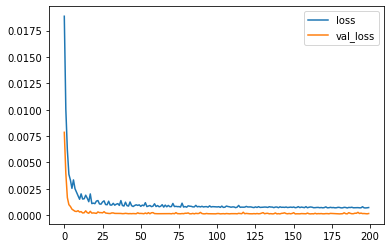

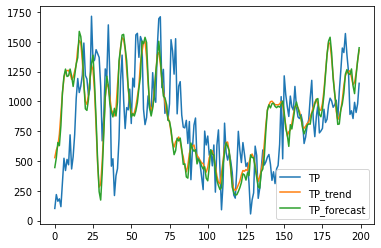

Model: "sequential_448"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1344 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1344 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1345 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1345 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1346 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1346 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_448 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.8380e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5060e-04 - accuracy: 5.9467e-05 - val_loss: 1.8027e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 2.5115e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9459e-04 - accuracy: 5.9467e-05 - val_loss: 2.1412e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6759e-04 - accuracy: 5.9467e-05 - val_loss: 2.3533e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7201e-04 - accuracy: 5.9467e-05 - val_loss: 1.9945e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

526/526 [==============================] - 7s 13ms/step - loss: 8.8678e-04 - accuracy: 5.9467e-05 - val_loss: 1.7557e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6271e-04 - accuracy: 5.9467e-05 - val_loss: 2.0594e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5759e-04 - accuracy: 5.9467e-05 - val_loss: 1.9106e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4907e-04 - accuracy: 5.9467e-05 - val_loss: 1.7458e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5877e-04 - accuracy: 5.9467e-05 - val_loss: 2.1888e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6981e-04 - accuracy: 5.9467e-05 - val_loss: 1.7572e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [======================

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2595e-04 - accuracy: 5.9467e-05 - val_loss: 1.7140e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3029e-04 - accuracy: 5.9467e-05 - val_loss: 1.6290e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6422e-04 - accuracy: 5.9467e-05 - val_loss: 1.9552e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5081e-04 - accuracy: 5.9467e-05 - val_loss: 1.6430e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4218e-04 - accuracy: 5.9467e-05 - val_loss: 1.9093e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0998e-04 - accuracy: 5.9467e-05 - val_loss: 1.6017e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

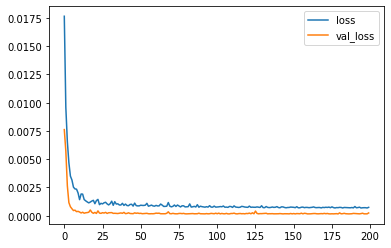

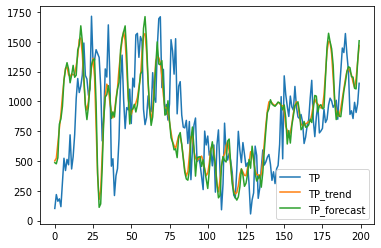

Model: "sequential_449"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1347 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1347 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1348 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1348 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1349 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1349 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_449 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0013 - accuracy: 5.9467e-05 - val_loss: 2.7187e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7179e-04 - accuracy: 5.9467e-05 - val_loss: 2.8793e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6878e-04 - accuracy: 5.9467e-05 - val_loss: 2.0680e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3146e-04 - accuracy: 5.9467e-05 - val_loss: 1.8099e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4216e-04 - accuracy: 5.9467e-05 - val_loss: 2.6813e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1553e-04 - accuracy: 5.9467e-05 - val_loss: 1.8396e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7701e-04 - accuracy: 5.9467e-05 - val_loss: 1.8589e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4071e-04 - accuracy: 5.9467e-05 - val_loss: 1.7046e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6513e-04 - accuracy: 5.9467e-05 - val_loss: 1.6764e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1467e-04 - accuracy: 5.9467e-05 - val_loss: 2.2262e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2715e-04 - accuracy: 5.9467e-05 - val_loss: 1.7169e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2508e-04 - accuracy: 5.9467e-05 - val_loss: 1.7957e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2671e-04 - accuracy: 5.9467e-05 - val_loss: 1.6644e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1666e-04 - accuracy: 5.9467e-05 - val_loss: 1.6957e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9118e-04 - accuracy: 5.9467e-05 - val_loss: 1.7631e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4944e-04 - accuracy: 5.9467e-05 - val_loss: 2.1061e-04 - val_accuracy: 0.0000e+00


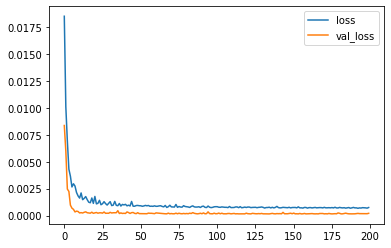

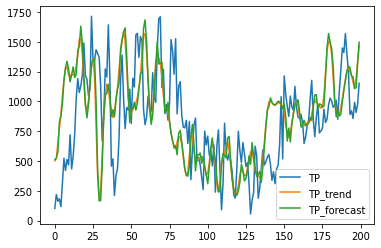

Model: "sequential_450"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1350 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1350 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1351 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1351 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1352 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1352 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_450 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 4.0134e-06 - accuracy: 2.9734e-05 - val_loss: 3.0829e-06 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 5.0796e-06 - accuracy: 2.9734e-05 - val_loss: 1.6382e-06 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2336e-06 - accuracy: 2.9734e-05 - val_loss: 1.6231e-06 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.8431e-06 - accuracy: 2.9734e-05 - val_loss: 2.3429e-06 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3530e-06 - accuracy: 2.9734e-05 - val_loss: 2.5573e-06 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 4.5439e-06 - accuracy: 2.9734e-05 - val_loss: 2.9145e-06 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9271e-06 - accuracy: 2.9734e-05 - val_loss: 1.0256e-06 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6729e-06 - accuracy: 2.9734e-05 - val_loss: 1.5687e-06 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 3.9015e-06 - accuracy: 2.9734e-05 - val_loss: 1.9684e-06 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9719e-06 - accuracy: 2.9734e-05 - val_loss: 2.4245e-06 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1965e-06 - accuracy: 2.9734e-05 - val_loss: 1.4817e-06 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 3.1897e-06 - accuracy: 2.9734e-05 - val_loss: 2.1520e-06 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8004e-06 - accuracy: 2.9734e-05 - val_loss: 1.3846e-06 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2219e-06 - accuracy: 2.9734e-05 - val_loss: 2.0668e-06 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 3.6292e-06 - accuracy: 2.9734e-05 - val_loss: 1.5476e-06 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 4.3783e-06 - accuracy: 2.9734e-05 - val_loss: 6.7122e-07 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 2.5107e-06 - accuracy: 2.9734e-05 - val_loss: 1.6571e-06 - val_accuracy: 0.0000e+00


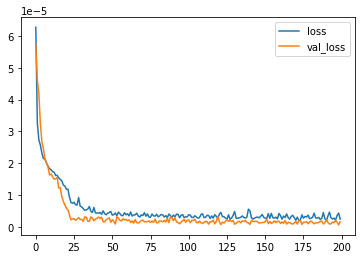

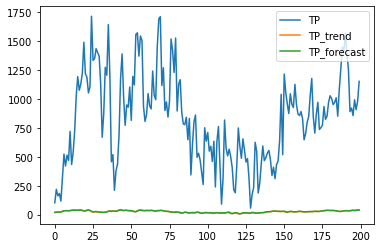

Model: "sequential_451"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1353 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1353 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1354 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1354 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1355 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1355 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_451 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 3.7379e-06 - accuracy: 2.9734e-05 - val_loss: 1.5766e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 3.1184e-06 - accuracy: 2.9734e-05 - val_loss: 1.2450e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 2.5931e-06 - accuracy: 2.9734e-05 - val_loss: 5.7244e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 2.5542e-06 - accuracy: 2.9734e-05 - val_loss: 3.1909e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 3.5438e-06 - accuracy: 2.9734e-05 - val_loss: 2.1753e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 3.2086e-06 - accuracy: 2.9734e-05 - val_loss: 4.2081e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8821e-06 - accuracy: 2.9734e-05 - val_loss: 1.6984e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3837e-06 - accuracy: 2.9734e-05 - val_loss: 9.0925e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 2.4155e-06 - accuracy: 2.9734e-05 - val_loss: 1.2811e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 3.0915e-06 - accuracy: 2.9734e-05 - val_loss: 1.0744e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.9549e-06 - accuracy: 2.9734e-05 - val_loss: 1.6218e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4505e-06 - accuracy: 2.9734e-05 - val_loss: 3.6257e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 2.0586e-06 - accuracy: 2.9734e-05 - val_loss: 3.6686e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 1.5582e-06 - accuracy: 2.9734e-05 - val_loss: 6.5099e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 2.0274e-06 - accuracy: 2.9734e-05 - val_loss: 3.3290e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4097e-06 - accuracy: 2.9734e-05 - val_loss: 7.9475e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7762e-07 - accuracy: 2.9734e-05 - val_loss: 1.4247e-09 - val_accuracy: 0.0000e+00


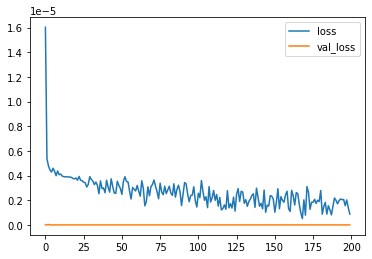

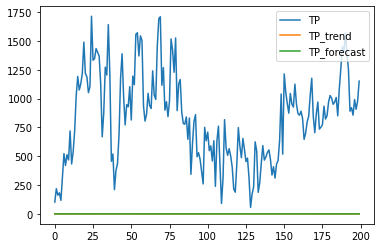

Model: "sequential_452"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1356 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1356 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1357 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1357 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1358 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1358 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_452 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6333e-06 - accuracy: 2.9734e-05 - val_loss: 1.0330e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1685e-06 - accuracy: 2.9734e-05 - val_loss: 1.2904e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2736e-06 - accuracy: 2.9734e-05 - val_loss: 1.6955e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3104e-06 - accuracy: 2.9734e-05 - val_loss: 3.0426e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0910e-06 - accuracy: 2.9734e-05 - val_loss: 3.7320e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6496e-06 - accuracy: 2.9734e-05 - val_loss: 7.2933e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8690e-06 - accuracy: 2.9734e-05 - val_loss: 2.1935e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.8254e-06 - accuracy: 2.9734e-05 - val_loss: 1.0316e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0206e-06 - accuracy: 2.9734e-05 - val_loss: 1.1384e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0984e-06 - accuracy: 2.9734e-05 - val_loss: 2.0605e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6345e-06 - accuracy: 2.9734e-05 - val_loss: 7.5516e-11 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2347e-06 - accuracy: 2.9734e-05 - val_loss: 2.6997e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5800e-07 - accuracy: 2.9734e-05 - val_loss: 5.8709e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5361e-06 - accuracy: 2.9734e-05 - val_loss: 4.1825e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0482e-06 - accuracy: 2.9734e-05 - val_loss: 3.5562e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.0779e-07 - accuracy: 2.9734e-05 - val_loss: 3.0433e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3062e-06 - accuracy: 2.9734e-05 - val_loss: 7.2975e-10 - val_accuracy: 0.0000e+00


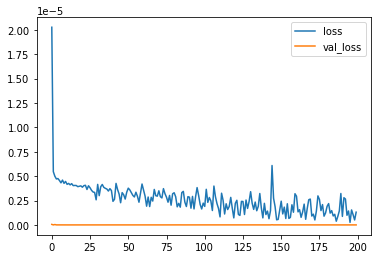

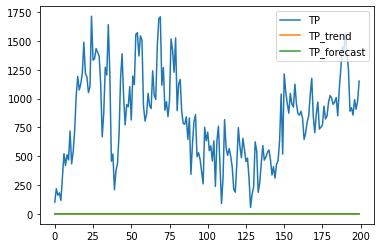

Model: "sequential_453"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1359 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1359 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1360 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1360 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1361 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1361 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_453 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0413e-06 - accuracy: 2.9734e-05 - val_loss: 5.8505e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7341e-06 - accuracy: 2.9734e-05 - val_loss: 6.6649e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0494e-06 - accuracy: 2.9734e-05 - val_loss: 4.5236e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1163e-06 - accuracy: 2.9734e-05 - val_loss: 4.1327e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4593e-06 - accuracy: 2.9734e-05 - val_loss: 2.3342e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9983e-06 - accuracy: 2.9734e-05 - val_loss: 3.8657e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6893e-06 - accuracy: 2.9734e-05 - val_loss: 4.9867e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4174e-06 - accuracy: 2.9734e-05 - val_loss: 9.7911e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9128e-06 - accuracy: 2.9734e-05 - val_loss: 1.1644e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7294e-06 - accuracy: 2.9734e-05 - val_loss: 1.9960e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3885e-06 - accuracy: 2.9734e-05 - val_loss: 4.1010e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8677e-06 - accuracy: 2.9734e-05 - val_loss: 1.4377e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0854e-06 - accuracy: 2.9734e-05 - val_loss: 5.4817e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2485e-06 - accuracy: 2.9734e-05 - val_loss: 4.2538e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8391e-07 - accuracy: 2.9734e-05 - val_loss: 1.4458e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6509e-06 - accuracy: 2.9734e-05 - val_loss: 2.1273e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1944e-07 - accuracy: 2.9734e-05 - val_loss: 1.0109e-08 - val_accuracy: 0.0000e+00


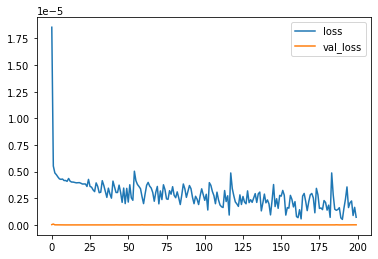

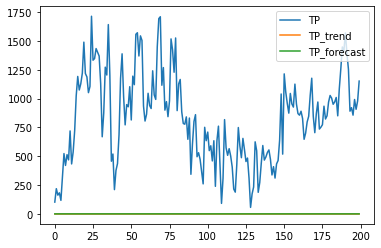

Model: "sequential_454"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1362 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1362 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1363 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1363 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1364 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1364 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_454 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8846e-06 - accuracy: 0.0000e+00 - val_loss: 1.3615e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7671e-06 - accuracy: 0.0000e+00 - val_loss: 2.0658e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6618e-06 - accuracy: 0.0000e+00 - val_loss: 3.3259e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9162e-06 - accuracy: 0.0000e+00 - val_loss: 7.8266e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5438e-06 - accuracy: 0.0000e+00 - val_loss: 2.5242e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2793e-06 - accuracy: 0.0000e+00 - val_loss: 3.3104e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4653e-06 - accuracy: 0.0000e+00 - val_loss: 2.8431e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.2312e-06 - accuracy: 0.0000e+00 - val_loss: 8.6561e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 3.5930e-06 - accuracy: 0.0000e+00 - val_loss: 7.2499e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3605e-06 - accuracy: 0.0000e+00 - val_loss: 1.0751e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7130e-06 - accuracy: 0.0000e+00 - val_loss: 1.9528e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6146e-06 - accuracy: 0.0000e+00 - val_loss: 9.6674e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5506e-06 - accuracy: 0.0000e+00 - val_loss: 1.1955e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1168e-06 - accuracy: 0.0000e+00 - val_loss: 1.6204e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5711e-06 - accuracy: 0.0000e+00 - val_loss: 1.4220e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1670e-06 - accuracy: 0.0000e+00 - val_loss: 2.6675e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7960e-07 - accuracy: 0.0000e+00 - val_loss: 1.8908e-09 - val_accuracy: 1.1893e-04


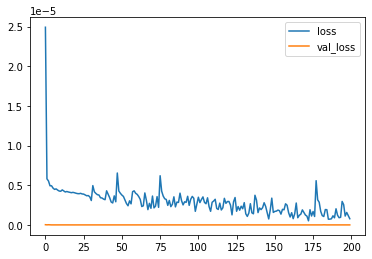

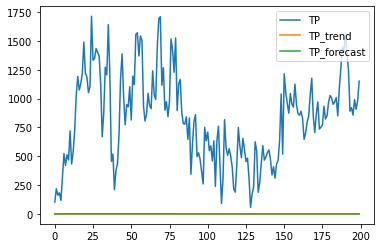

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_455"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1365 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1365 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1366 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1366 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1367 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1367 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_455 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 3.9810e-06 - accuracy: 0.0000e+00 - val_loss: 5.7759e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 3.8871e-06 - accuracy: 0.0000e+00 - val_loss: 4.2651e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 3.7342e-06 - accuracy: 0.0000e+00 - val_loss: 1.4644e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 3.5043e-06 - accuracy: 0.0000e+00 - val_loss: 3.5753e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 3.2365e-06 - accuracy: 0.0000e+00 - val_loss: 1.2030e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 3.8432e-06 - accuracy: 0.0000e+00 - val_loss: 4.2569e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 2.4008e-06 - accuracy: 0.0000e+00 - val_loss: 7.7751e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9872e-06 - accuracy: 0.0000e+00 - val_loss: 2.0054e-09 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8987e-06 - accuracy: 0.0000e+00 - val_loss: 2.2918e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 3.5029e-06 - accuracy: 0.0000e+00 - val_loss: 1.0718e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 4.2892e-06 - accuracy: 0.0000e+00 - val_loss: 9.1017e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 3.6927e-06 - accuracy: 0.0000e+00 - val_loss: 8.7874e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.3511e-06 - accuracy: 0.0000e+00 - val_loss: 9.3348e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4431e-06 - accuracy: 0.0000e+00 - val_loss: 4.3972e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4899e-07 - accuracy: 0.0000e+00 - val_loss: 3.6405e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8193e-06 - accuracy: 0.0000e+00 - val_loss: 5.3050e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6026e-06 - accuracy: 0.0000e+00 - val_loss: 6.2580e-10 - val_accuracy: 1.1893e-04


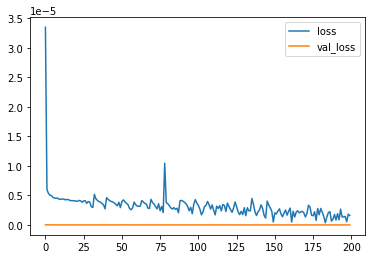

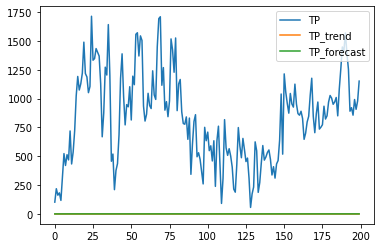

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_456"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1368 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1368 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1369 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1369 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1370 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1370 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_456 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 12ms/step - loss: 3.4697e-06 - accuracy: 0.0000e+00 - val_loss: 6.6579e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 12ms/step - loss: 3.4858e-06 - accuracy: 0.0000e+00 - val_loss: 1.2603e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 12ms/step - loss: 4.4450e-06 - accuracy: 0.0000e+00 - val_loss: 1.3089e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 12ms/step - loss: 4.2031e-06 - accuracy: 0.0000e+00 - val_loss: 3.7495e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 12ms/step - loss: 4.0794e-06 - accuracy: 0.0000e+00 - val_loss: 5.2956e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 12ms/step - loss: 3.8418e-06 - accuracy: 0.0000e+00 - val_loss: 1.0562e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7152e-06 - accuracy: 0.0000e+00 - val_loss: 1.3270e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8102e-06 - accuracy: 0.0000e+00 - val_loss: 2.1635e-09 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 12ms/step - loss: 2.3325e-06 - accuracy: 0.0000e+00 - val_loss: 7.1799e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4300e-06 - accuracy: 0.0000e+00 - val_loss: 1.2998e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 12ms/step - loss: 2.3482e-06 - accuracy: 0.0000e+00 - val_loss: 1.3499e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 12ms/step - loss: 2.2731e-06 - accuracy: 0.0000e+00 - val_loss: 2.1993e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 12ms/step - loss: 1.2800e-06 - accuracy: 0.0000e+00 - val_loss: 9.0460e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 12ms/step - loss: 1.5949e-06 - accuracy: 0.0000e+00 - val_loss: 2.0166e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 8.9998e-07 - accuracy: 0.0000e+00 - val_loss: 2.5361e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1401e-06 - accuracy: 0.0000e+00 - val_loss: 2.5826e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 12ms/step - loss: 2.9008e-06 - accuracy: 0.0000e+00 - val_loss: 9.4013e-10 - val_accuracy: 1.1893e-04


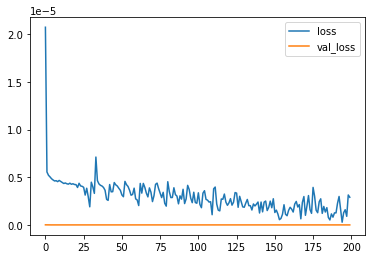

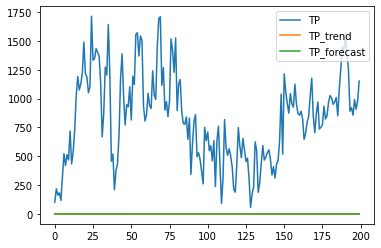

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_457"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1371 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1371 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1372 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1372 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1373 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1373 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_457 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2916e-06 - accuracy: 0.0000e+00 - val_loss: 9.7266e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 12ms/step - loss: 4.2894e-06 - accuracy: 0.0000e+00 - val_loss: 8.0604e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2775e-06 - accuracy: 0.0000e+00 - val_loss: 7.9555e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 12ms/step - loss: 4.2781e-06 - accuracy: 0.0000e+00 - val_loss: 4.7833e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2677e-06 - accuracy: 0.0000e+00 - val_loss: 2.1352e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 12ms/step - loss: 4.2450e-06 - accuracy: 0.0000e+00 - val_loss: 1.7012e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2501e-06 - accuracy: 0.0000e+00 - val_loss: 1.5852e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9574e-06 - accuracy: 0.0000e+00 - val_loss: 7.4126e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 12ms/step - loss: 3.5166e-06 - accuracy: 0.0000e+00 - val_loss: 1.0792e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9776e-06 - accuracy: 0.0000e+00 - val_loss: 2.4213e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7944e-06 - accuracy: 0.0000e+00 - val_loss: 2.2537e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3922e-06 - accuracy: 0.0000e+00 - val_loss: 3.0529e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8747e-06 - accuracy: 0.0000e+00 - val_loss: 9.4601e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3456e-06 - accuracy: 0.0000e+00 - val_loss: 4.0107e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7079e-06 - accuracy: 0.0000e+00 - val_loss: 1.1506e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5128e-06 - accuracy: 0.0000e+00 - val_loss: 1.9611e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8559e-06 - accuracy: 0.0000e+00 - val_loss: 5.3353e-10 - val_accuracy: 1.1893e-04


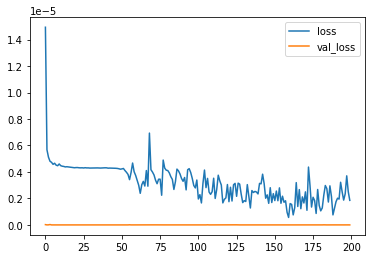

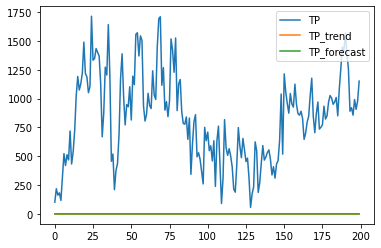

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_458"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1374 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1374 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1375 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1375 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1376 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1376 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_458 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 12ms/step - loss: 2.6030e-06 - accuracy: 2.9734e-05 - val_loss: 5.1971e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 12ms/step - loss: 3.1075e-06 - accuracy: 2.9734e-05 - val_loss: 1.0573e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 12ms/step - loss: 2.5815e-06 - accuracy: 2.9734e-05 - val_loss: 1.2753e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 12ms/step - loss: 6.3428e-06 - accuracy: 2.9734e-05 - val_loss: 3.3338e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 12ms/step - loss: 4.4540e-06 - accuracy: 2.9734e-05 - val_loss: 3.8569e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 12ms/step - loss: 3.9681e-06 - accuracy: 2.9734e-05 - val_loss: 6.6161e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 12ms/step - loss: 3.9820e-06 - accuracy: 2.9734e-05 - val_loss: 1.5331e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 12ms/step - loss: 2.2220e-06 - accuracy: 2.9734e-05 - val_loss: 8.0725e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 12ms/step - loss: 1.8201e-06 - accuracy: 2.9734e-05 - val_loss: 2.8594e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 12ms/step - loss: 2.9802e-06 - accuracy: 2.9734e-05 - val_loss: 1.3272e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4624e-06 - accuracy: 2.9734e-05 - val_loss: 8.1993e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 12ms/step - loss: 1.5869e-06 - accuracy: 2.9734e-05 - val_loss: 1.1974e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 12ms/step - loss: 5.0081e-07 - accuracy: 2.9734e-05 - val_loss: 2.2732e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 12ms/step - loss: 1.2745e-06 - accuracy: 2.9734e-05 - val_loss: 8.9499e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 12ms/step - loss: 4.0999e-07 - accuracy: 2.9734e-05 - val_loss: 3.2545e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 12ms/step - loss: 1.4915e-06 - accuracy: 2.9734e-05 - val_loss: 8.6892e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8194e-07 - accuracy: 2.9734e-05 - val_loss: 3.7902e-10 - val_accuracy: 0.0000e+00


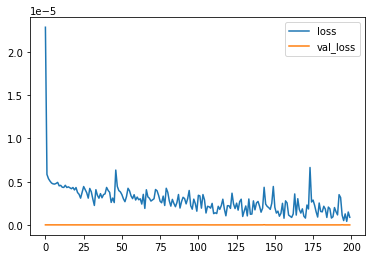

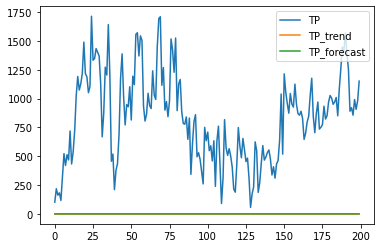

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_459"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1377 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1377 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1378 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1378 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1379 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1379 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_459 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 4.0916e-06 - accuracy: 2.9734e-05 - val_loss: 1.6597e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 3.3229e-06 - accuracy: 2.9734e-05 - val_loss: 6.7047e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 2.7250e-06 - accuracy: 2.9734e-05 - val_loss: 1.4033e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 4.2398e-06 - accuracy: 2.9734e-05 - val_loss: 4.5500e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 3.8507e-06 - accuracy: 2.9734e-05 - val_loss: 3.1732e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 3.3485e-06 - accuracy: 2.9734e-05 - val_loss: 2.2736e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 2.2565e-06 - accuracy: 2.9734e-05 - val_loss: 9.3789e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 2.5613e-06 - accuracy: 2.9734e-05 - val_loss: 9.2204e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 3.2711e-06 - accuracy: 2.9734e-05 - val_loss: 8.9286e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3031e-06 - accuracy: 2.9734e-05 - val_loss: 3.3290e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8452e-06 - accuracy: 2.9734e-05 - val_loss: 5.5538e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 2.0581e-06 - accuracy: 2.9734e-05 - val_loss: 1.1132e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 1.6151e-06 - accuracy: 2.9734e-05 - val_loss: 4.1885e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3870e-06 - accuracy: 2.9734e-05 - val_loss: 6.0571e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 1.9141e-06 - accuracy: 2.9734e-05 - val_loss: 1.7330e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7905e-06 - accuracy: 2.9734e-05 - val_loss: 2.8727e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4435e-06 - accuracy: 2.9734e-05 - val_loss: 3.0152e-10 - val_accuracy: 0.0000e+00


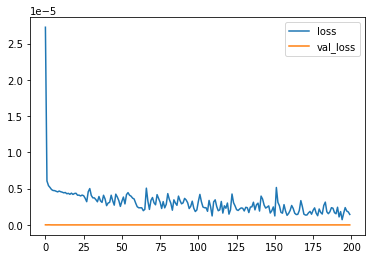

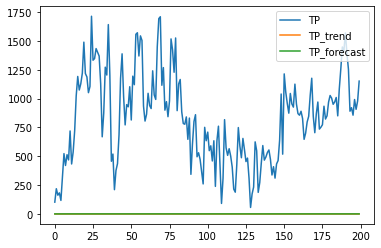

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_460"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1380 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1380 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1381 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1381 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1382 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1382 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_460 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4052e-06 - accuracy: 2.9734e-05 - val_loss: 5.8345e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 3.2317e-06 - accuracy: 2.9734e-05 - val_loss: 9.5312e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3811e-06 - accuracy: 2.9734e-05 - val_loss: 1.0423e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 4.1061e-06 - accuracy: 2.9734e-05 - val_loss: 3.4260e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3765e-06 - accuracy: 2.9734e-05 - val_loss: 1.1806e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1033e-06 - accuracy: 2.9734e-05 - val_loss: 7.8399e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2179e-06 - accuracy: 2.9734e-05 - val_loss: 9.4992e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6333e-06 - accuracy: 2.9734e-05 - val_loss: 2.5420e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7562e-06 - accuracy: 2.9734e-05 - val_loss: 4.6485e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7905e-06 - accuracy: 2.9734e-05 - val_loss: 3.9742e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7467e-06 - accuracy: 2.9734e-05 - val_loss: 1.2673e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6081e-06 - accuracy: 2.9734e-05 - val_loss: 1.8975e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9435e-06 - accuracy: 2.9734e-05 - val_loss: 4.5801e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8025e-06 - accuracy: 2.9734e-05 - val_loss: 8.0444e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2601e-06 - accuracy: 2.9734e-05 - val_loss: 5.2058e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 9.0360e-07 - accuracy: 2.9734e-05 - val_loss: 1.3210e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5299e-06 - accuracy: 2.9734e-05 - val_loss: 7.0961e-10 - val_accuracy: 0.0000e+00


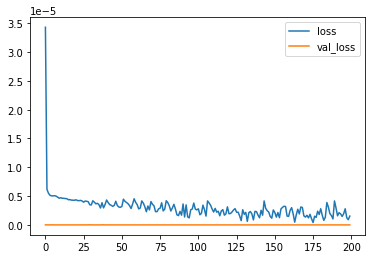

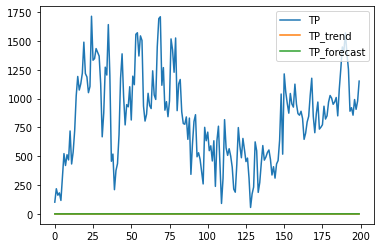

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_461"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1383 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1383 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1384 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1384 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1385 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1385 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_461 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6801e-06 - accuracy: 2.9734e-05 - val_loss: 4.4231e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5753e-06 - accuracy: 2.9734e-05 - val_loss: 8.4542e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.0242e-06 - accuracy: 2.9734e-05 - val_loss: 4.7478e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4486e-06 - accuracy: 2.9734e-05 - val_loss: 2.7076e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4193e-06 - accuracy: 2.9734e-05 - val_loss: 5.9706e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7599e-06 - accuracy: 2.9734e-05 - val_loss: 2.4224e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3189e-06 - accuracy: 2.9734e-05 - val_loss: 3.6670e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9631e-06 - accuracy: 2.9734e-05 - val_loss: 7.1010e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7794e-06 - accuracy: 2.9734e-05 - val_loss: 1.4643e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.5301e-06 - accuracy: 2.9734e-05 - val_loss: 1.5059e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6664e-06 - accuracy: 2.9734e-05 - val_loss: 1.6430e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9227e-06 - accuracy: 2.9734e-05 - val_loss: 1.1332e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6336e-06 - accuracy: 2.9734e-05 - val_loss: 9.3234e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0900e-06 - accuracy: 2.9734e-05 - val_loss: 1.2834e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3600e-06 - accuracy: 2.9734e-05 - val_loss: 1.1772e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4408e-06 - accuracy: 2.9734e-05 - val_loss: 5.3742e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 5.2911e-07 - accuracy: 2.9734e-05 - val_loss: 8.2219e-10 - val_accuracy: 0.0000e+00


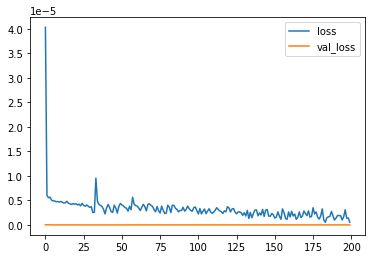

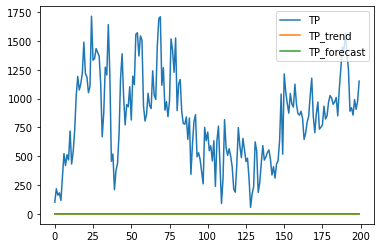

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_462"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1386 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1386 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1387 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1387 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1388 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1388 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_462 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.5327e-06 - accuracy: 2.9734e-05 - val_loss: 2.5533e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6347e-06 - accuracy: 2.9734e-05 - val_loss: 3.5406e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7918e-06 - accuracy: 2.9734e-05 - val_loss: 2.2448e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.5745e-06 - accuracy: 2.9734e-05 - val_loss: 2.9824e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1618e-06 - accuracy: 2.9734e-05 - val_loss: 1.2891e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1003e-06 - accuracy: 2.9734e-05 - val_loss: 2.0169e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.6216e-06 - accuracy: 2.9734e-05 - val_loss: 2.6231e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3974e-06 - accuracy: 2.9734e-05 - val_loss: 7.1242e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 4.1558e-06 - accuracy: 2.9734e-05 - val_loss: 1.5887e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9739e-06 - accuracy: 2.9734e-05 - val_loss: 1.3887e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7011e-06 - accuracy: 2.9734e-05 - val_loss: 2.7560e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4105e-06 - accuracy: 2.9734e-05 - val_loss: 3.6388e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 9.8340e-07 - accuracy: 2.9734e-05 - val_loss: 1.0587e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3382e-06 - accuracy: 2.9734e-05 - val_loss: 7.8597e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1076e-06 - accuracy: 2.9734e-05 - val_loss: 2.8829e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6410e-06 - accuracy: 2.9734e-05 - val_loss: 1.8795e-08 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 3.2843e-06 - accuracy: 2.9734e-05 - val_loss: 9.8289e-10 - val_accuracy: 0.0000e+00


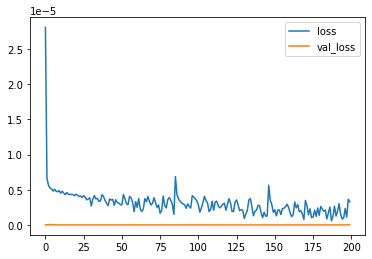

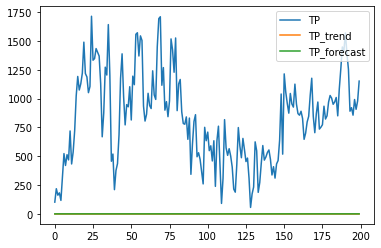

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_463"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1389 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1389 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1390 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1390 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1391 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1391 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_463 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 2.7456e-06 - accuracy: 2.9734e-05 - val_loss: 2.2240e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 3.3429e-06 - accuracy: 2.9734e-05 - val_loss: 8.1955e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 4.3420e-06 - accuracy: 2.9734e-05 - val_loss: 4.9553e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 3.8619e-06 - accuracy: 2.9734e-05 - val_loss: 6.9651e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 3.6210e-06 - accuracy: 2.9734e-05 - val_loss: 1.6321e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 3.3298e-06 - accuracy: 2.9734e-05 - val_loss: 2.2122e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 3.9092e-06 - accuracy: 2.9734e-05 - val_loss: 2.6136e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 4.0028e-06 - accuracy: 2.9734e-05 - val_loss: 1.8744e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 3.4382e-06 - accuracy: 2.9734e-05 - val_loss: 1.5085e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.7459e-06 - accuracy: 2.9734e-05 - val_loss: 2.3366e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6376e-06 - accuracy: 2.9734e-05 - val_loss: 1.4338e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 2.2879e-06 - accuracy: 2.9734e-05 - val_loss: 1.6247e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 2.1094e-06 - accuracy: 2.9734e-05 - val_loss: 2.0534e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.0768e-06 - accuracy: 2.9734e-05 - val_loss: 4.9877e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5341e-06 - accuracy: 2.9734e-05 - val_loss: 2.6518e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1969e-06 - accuracy: 2.9734e-05 - val_loss: 4.2545e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4325e-06 - accuracy: 2.9734e-05 - val_loss: 1.3916e-09 - val_accuracy: 0.0000e+00


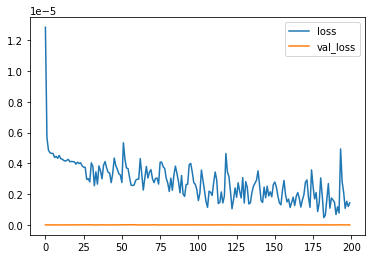

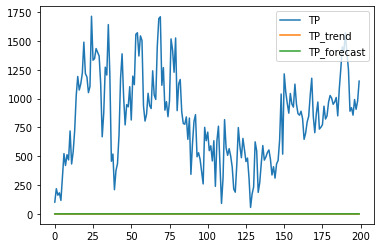

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_464"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1392 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1392 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1393 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1393 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1394 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1394 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_464 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7172e-06 - accuracy: 2.9734e-05 - val_loss: 1.3640e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 4.0358e-06 - accuracy: 2.9734e-05 - val_loss: 8.8156e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6350e-06 - accuracy: 2.9734e-05 - val_loss: 2.3463e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4285e-06 - accuracy: 2.9734e-05 - val_loss: 6.6942e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.2390e-06 - accuracy: 2.9734e-05 - val_loss: 3.6654e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2414e-06 - accuracy: 2.9734e-05 - val_loss: 4.2150e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 145/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8402e-07 - accuracy: 2.9734e-05 - val_loss: 3.2728e-09 - val_accuracy: 0.0000e+00
Epoch 146/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1534e-06 - accuracy: 2.9734e-05 - val_loss: 3.6544e-09 - val_accuracy: 0.0000e+00
Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7263e-06 - accuracy: 2.9734e-05 - val_loss: 9.5725e-10 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2124e-06 - accuracy: 2.9734e-05 - val_loss: 1.7279e-09 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6529e-06 - accuracy: 2.9734e-05 - val_loss: 8.9310e-10 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6973e-06 - accuracy: 2.9734e-05 - val_loss: 6.0721e-10 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [=====

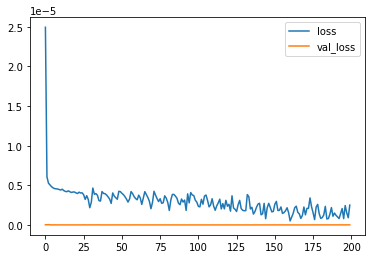

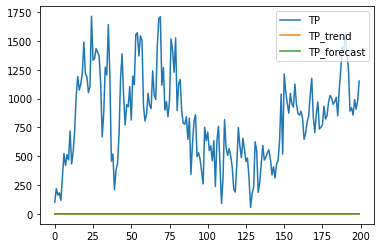

Model: "sequential_465"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1395 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1395 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1396 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1396 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1397 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1397 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_465 (Dense)            (None, 1)              

Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.6825e-04 - accuracy: 0.0688 - val_loss: 3.0445e-05 - val_accuracy: 0.0966
Epoch 102/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8964e-04 - accuracy: 0.0688 - val_loss: 7.2109e-05 - val_accuracy: 0.0966
Epoch 103/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8804e-04 - accuracy: 0.0688 - val_loss: 9.7870e-05 - val_accuracy: 0.0966
Epoch 104/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5044e-04 - accuracy: 0.0688 - val_loss: 4.0001e-05 - val_accuracy: 0.0966
Epoch 105/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8229e-04 - accuracy: 0.0688 - val_loss: 6.1943e-05 - val_accuracy: 0.0966
Epoch 106/200
526/526 [==============================] - 7s 14ms/step - loss: 8.8133e-04 - accuracy: 0.0688 - val_loss: 4.0943e-05 - val_accuracy: 0.0966
Epoch 107/200
526/526 [==============================] - 7s 14ms/step - loss

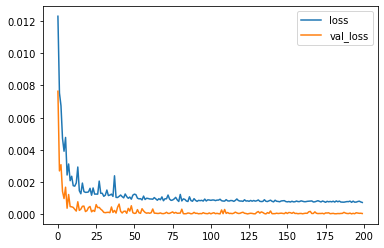

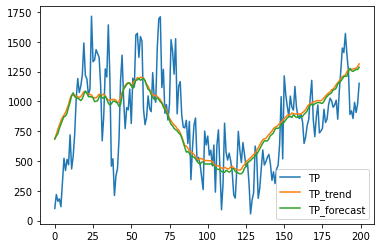

Model: "sequential_466"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1398 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1398 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1399 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1399 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1400 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1400 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_466 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.6965e-04 - accuracy: 5.9467e-05 - val_loss: 7.3531e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6139e-04 - accuracy: 5.9467e-05 - val_loss: 1.8315e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5347e-04 - accuracy: 5.9467e-05 - val_loss: 5.1093e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9960e-04 - accuracy: 5.9467e-05 - val_loss: 6.2026e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7282e-04 - accuracy: 5.9467e-05 - val_loss: 1.1861e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0764e-04 - accuracy: 5.9467e-05 - val_loss: 9.5719e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7622e-04 - accuracy: 5.9467e-05 - val_loss: 5.9671e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2731e-04 - accuracy: 5.9467e-05 - val_loss: 4.6290e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 7.8132e-04 - accuracy: 5.9467e-05 - val_loss: 5.1184e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1559e-04 - accuracy: 5.9467e-05 - val_loss: 4.8565e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4220e-04 - accuracy: 5.9467e-05 - val_loss: 9.4520e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 7.0386e-04 - accuracy: 5.9467e-05 - val_loss: 6.2367e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2241e-04 - accuracy: 5.9467e-05 - val_loss: 9.2233e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2613e-04 - accuracy: 5.9467e-05 - val_loss: 7.5440e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1840e-04 - accuracy: 5.9467e-05 - val_loss: 7.0608e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2807e-04 - accuracy: 5.9467e-05 - val_loss: 3.7841e-05 - val_accuracy: 0.0000e+00


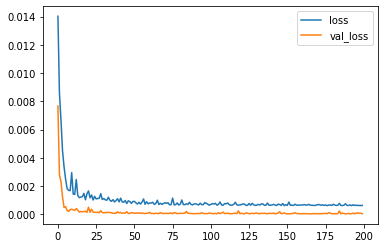

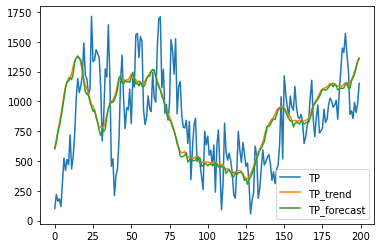

Model: "sequential_467"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1401 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1401 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1402 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1402 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1403 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1403 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_467 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 8.6898e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 7.8669e-04 - accuracy: 5.9467e-05 - val_loss: 5.0745e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2247e-04 - accuracy: 5.9467e-05 - val_loss: 2.9762e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.0831e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 9.8767e-04 - accuracy: 5.9467e-05 - val_loss: 7.5509e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0471e-04 - accuracy: 5.9467e-05 - val_loss: 8.0737e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 6.6817e-04 - accuracy: 5.9467e-05 - val_loss: 3.2444e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 8.1913e-04 - accuracy: 5.9467e-05 - val_loss: 4.6488e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 7.0607e-04 - accuracy: 5.9467e-05 - val_loss: 6.6598e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 7.5135e-04 - accuracy: 5.9467e-05 - val_loss: 3.8846e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9524e-04 - accuracy: 5.9467e-05 - val_loss: 4.6793e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2381e-04 - accuracy: 5.9467e-05 - val_loss: 5.6711e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 6.6086e-04 - accuracy: 5.9467e-05 - val_loss: 6.8673e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 6.3062e-04 - accuracy: 5.9467e-05 - val_loss: 4.4209e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 6.3552e-04 - accuracy: 5.9467e-05 - val_loss: 4.2263e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 6.7508e-04 - accuracy: 5.9467e-05 - val_loss: 3.6103e-05 - val_accuracy: 0.0000e+00


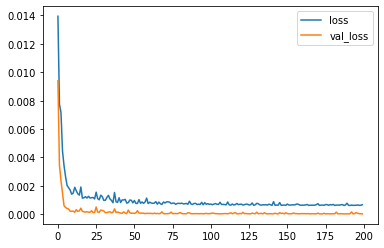

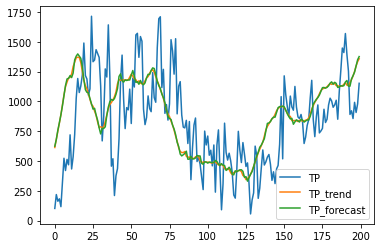

Model: "sequential_468"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1404 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1404 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1405 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1405 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1406 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1406 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_468 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 7.7507e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4156e-04 - accuracy: 5.9467e-05 - val_loss: 1.0082e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.0488e-04 - accuracy: 5.9467e-05 - val_loss: 8.4120e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1991e-04 - accuracy: 5.9467e-05 - val_loss: 8.0354e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4920e-04 - accuracy: 5.9467e-05 - val_loss: 1.0604e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 8.3296e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4219e-04 - accuracy: 5.9467e-05 - val_loss: 5.5428e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3094e-04 - accuracy: 5.9467e-05 - val_loss: 6.5175e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3738e-04 - accuracy: 5.9467e-05 - val_loss: 7.2127e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4862e-04 - accuracy: 5.9467e-05 - val_loss: 8.8951e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3320e-04 - accuracy: 5.9467e-05 - val_loss: 5.0014e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1628e-04 - accuracy: 5.9467e-05 - val_loss: 7.2597e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7765e-04 - accuracy: 5.9467e-05 - val_loss: 4.1981e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4089e-04 - accuracy: 5.9467e-05 - val_loss: 5.0065e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5221e-04 - accuracy: 5.9467e-05 - val_loss: 3.7237e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4842e-04 - accuracy: 5.9467e-05 - val_loss: 4.3044e-05 - val_accuracy: 0.0000e+00


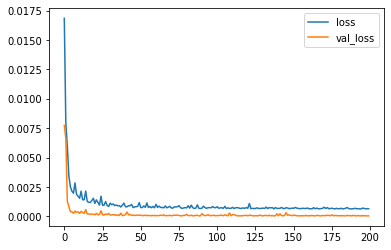

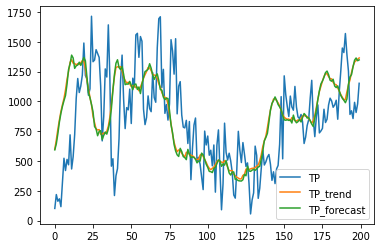

Model: "sequential_469"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1407 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1407 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1408 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1408 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1409 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1409 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_469 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2372e-04 - accuracy: 5.9467e-05 - val_loss: 1.2429e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4340e-04 - accuracy: 5.9467e-05 - val_loss: 7.5634e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 2.2836e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3972e-04 - accuracy: 5.9467e-05 - val_loss: 1.0485e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3568e-04 - accuracy: 5.9467e-05 - val_loss: 1.0754e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9573e-04 - accuracy: 5.9467e-05 - val_loss: 5.6962e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6946e-04 - accuracy: 5.9467e-05 - val_loss: 4.4869e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6839e-04 - accuracy: 5.9467e-05 - val_loss: 5.2522e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6099e-04 - accuracy: 5.9467e-05 - val_loss: 5.5708e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6219e-04 - accuracy: 5.9467e-05 - val_loss: 5.2463e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4714e-04 - accuracy: 5.9467e-05 - val_loss: 1.0500e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7057e-04 - accuracy: 5.9467e-05 - val_loss: 6.3217e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5284e-04 - accuracy: 5.9467e-05 - val_loss: 5.6495e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7115e-04 - accuracy: 5.9467e-05 - val_loss: 6.9033e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.3212e-04 - accuracy: 5.9467e-05 - val_loss: 5.8604e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2512e-04 - accuracy: 5.9467e-05 - val_loss: 1.2332e-04 - val_accuracy: 0.0000e+00


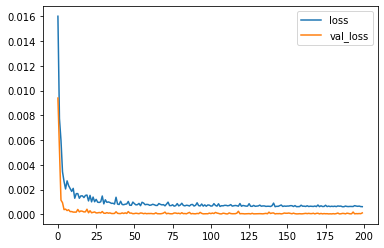

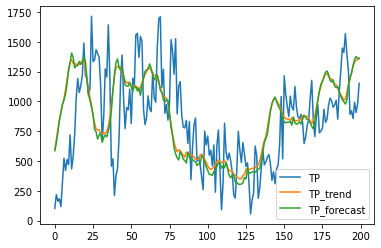

Model: "sequential_470"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1410 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1410 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1411 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1411 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1412 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1412 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_470 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.1167e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3956e-04 - accuracy: 5.9467e-05 - val_loss: 7.1978e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4900e-04 - accuracy: 5.9467e-05 - val_loss: 1.1016e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5966e-04 - accuracy: 5.9467e-05 - val_loss: 8.4557e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.3309e-04 - accuracy: 5.9467e-05 - val_loss: 7.8974e-05 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5471e-04 - accuracy: 5.9467e-05 - val_loss: 1.6796e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2931e-04 - accuracy: 5.9467e-05 - val_loss: 6.4492e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 7.4952e-04 - accuracy: 5.9467e-05 - val_loss: 1.0391e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.5466e-04 - accuracy: 5.9467e-05 - val_loss: 5.9465e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9536e-04 - accuracy: 5.9467e-05 - val_loss: 8.9483e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5554e-04 - accuracy: 5.9467e-05 - val_loss: 5.9855e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4330e-04 - accuracy: 5.9467e-05 - val_loss: 7.7557e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 5.9702e-04 - accuracy: 5.9467e-05 - val_loss: 5.7820e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 6.2300e-04 - accuracy: 5.9467e-05 - val_loss: 6.8162e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 6.1789e-04 - accuracy: 5.9467e-05 - val_loss: 1.0948e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7186e-04 - accuracy: 5.9467e-05 - val_loss: 5.1499e-05 - val_accuracy: 0.0000e+00


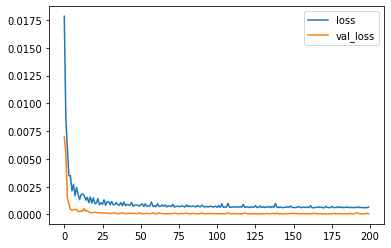

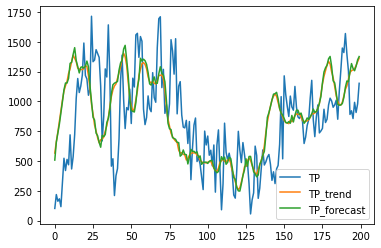

Model: "sequential_471"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1413 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1413 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1414 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1414 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1415 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1415 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_471 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5614e-04 - accuracy: 5.9467e-05 - val_loss: 2.3013e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0599e-04 - accuracy: 5.9467e-05 - val_loss: 7.9327e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.3471e-04 - accuracy: 5.9467e-05 - val_loss: 9.3719e-05 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 8.6026e-04 - accuracy: 5.9467e-05 - val_loss: 8.6235e-05 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 7.6429e-04 - accuracy: 5.9467e-05 - val_loss: 1.4432e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 7.9847e-04 - accuracy: 5.9467e-05 - val_loss: 9.9161e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1156e-04 - accuracy: 5.9467e-05 - val_loss: 5.5960e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 8.9601e-04 - accuracy: 5.9467e-05 - val_loss: 1.1181e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 6.6720e-04 - accuracy: 5.9467e-05 - val_loss: 8.0377e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 7.0433e-04 - accuracy: 5.9467e-05 - val_loss: 6.7188e-05 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 6.5725e-04 - accuracy: 5.9467e-05 - val_loss: 1.0612e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1554e-04 - accuracy: 5.9467e-05 - val_loss: 1.1730e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 6.2420e-04 - accuracy: 5.9467e-05 - val_loss: 5.3242e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 6.3970e-04 - accuracy: 5.9467e-05 - val_loss: 8.0123e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 14ms/step - loss: 6.3126e-04 - accuracy: 5.9467e-05 - val_loss: 1.3133e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 6.4499e-04 - accuracy: 5.9467e-05 - val_loss: 5.9195e-05 - val_accuracy: 0.0000e+00


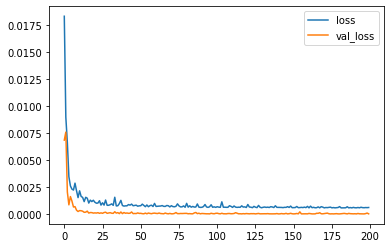

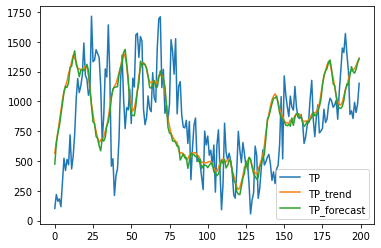

Model: "sequential_472"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1416 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1416 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1417 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1417 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1418 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1418 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_472 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 8.7029e-04 - accuracy: 5.9467e-05 - val_loss: 8.8137e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 8.1086e-04 - accuracy: 5.9467e-05 - val_loss: 9.0593e-05 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5455e-04 - accuracy: 5.9467e-05 - val_loss: 1.3273e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 9.4444e-04 - accuracy: 5.9467e-05 - val_loss: 1.0122e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 7.1719e-04 - accuracy: 5.9467e-05 - val_loss: 1.3802e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6161e-04 - accuracy: 5.9467e-05 - val_loss: 2.0362e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [============

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.5045e-04 - accuracy: 5.9467e-05 - val_loss: 8.2028e-05 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.5180e-04 - accuracy: 5.9467e-05 - val_loss: 8.0770e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.6557e-04 - accuracy: 5.9467e-05 - val_loss: 1.0470e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4166e-04 - accuracy: 5.9467e-05 - val_loss: 1.3799e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2465e-04 - accuracy: 5.9467e-05 - val_loss: 7.5990e-05 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4213e-04 - accuracy: 5.9467e-05 - val_loss: 1.3389e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1592e-04 - accuracy: 5.9467e-05 - val_loss: 1.4943e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4717e-04 - accuracy: 5.9467e-05 - val_loss: 8.5816e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9484e-04 - accuracy: 5.9467e-05 - val_loss: 9.7334e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2435e-04 - accuracy: 5.9467e-05 - val_loss: 7.6306e-05 - val_accuracy: 0.0000e+00


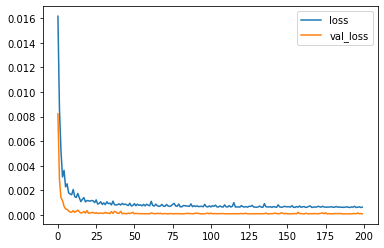

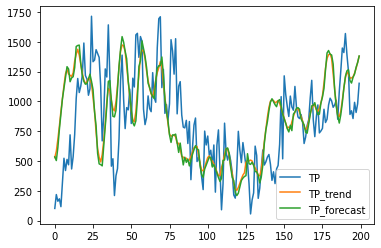

Model: "sequential_473"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1419 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1419 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1420 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1420 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1421 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1421 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_473 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 9.3743e-04 - accuracy: 5.9467e-05 - val_loss: 9.1629e-05 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 7.7816e-04 - accuracy: 5.9467e-05 - val_loss: 1.2005e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.4394e-04 - accuracy: 5.9467e-05 - val_loss: 1.2274e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3856e-04 - accuracy: 5.9467e-05 - val_loss: 1.1561e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.8043e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 7.3147e-04 - accuracy: 5.9467e-05 - val_loss: 9.3158e-05 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4589e-04 - accuracy: 5.9467e-05 - val_loss: 1.2675e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 8.2278e-04 - accuracy: 5.9467e-05 - val_loss: 9.9848e-05 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 6.9429e-04 - accuracy: 5.9467e-05 - val_loss: 8.7533e-05 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8750e-04 - accuracy: 5.9467e-05 - val_loss: 1.0752e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5103e-04 - accuracy: 5.9467e-05 - val_loss: 1.4874e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 13ms/step - loss: 6.4695e-04 - accuracy: 5.9467e-05 - val_loss: 7.8093e-05 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1450e-04 - accuracy: 5.9467e-05 - val_loss: 7.3425e-05 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 5.9726e-04 - accuracy: 5.9467e-05 - val_loss: 9.2821e-05 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2338e-04 - accuracy: 5.9467e-05 - val_loss: 9.7264e-05 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1047e-04 - accuracy: 5.9467e-05 - val_loss: 1.0456e-04 - val_accuracy: 0.0000e+00


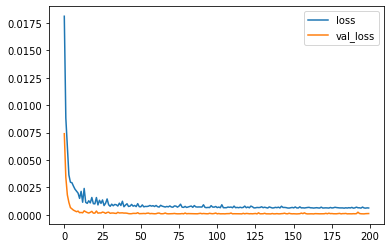

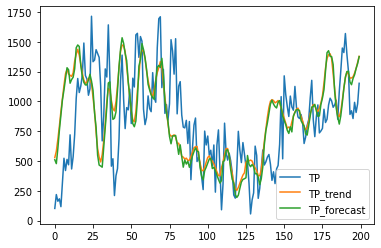

Model: "sequential_474"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1422 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1422 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1423 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1423 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1424 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1424 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_474 (Dense)            (None, 1)              

526/526 [==============================] - 7s 13ms/step - loss: 8.8614e-04 - accuracy: 5.9467e-05 - val_loss: 1.6174e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0011 - accuracy: 5.9467e-05 - val_loss: 1.3603e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 9.1271e-04 - accuracy: 5.9467e-05 - val_loss: 1.2219e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.5131e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8411e-04 - accuracy: 5.9467e-05 - val_loss: 1.5875e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 13ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.5303e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [==============================] - 7s 

Epoch 147/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5195e-04 - accuracy: 5.9467e-05 - val_loss: 1.3958e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 13ms/step - loss: 7.5031e-04 - accuracy: 5.9467e-05 - val_loss: 1.0773e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6104e-04 - accuracy: 5.9467e-05 - val_loss: 1.8582e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2386e-04 - accuracy: 5.9467e-05 - val_loss: 1.2520e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 13ms/step - loss: 7.2639e-04 - accuracy: 5.9467e-05 - val_loss: 1.1281e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 7s 13ms/step - loss: 7.6568e-04 - accuracy: 5.9467e-05 - val_loss: 1.1109e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

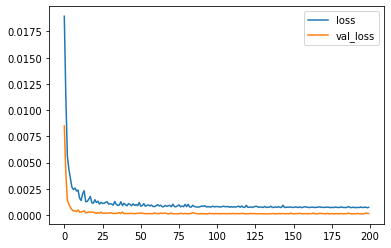

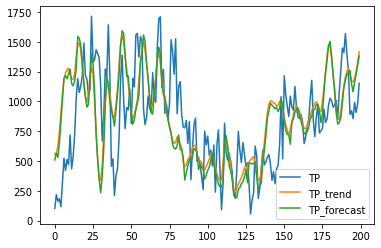

Model: "sequential_475"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1425 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1425 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1426 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1426 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1427 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1427 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_475 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 8.7179e-04 - accuracy: 5.9467e-05 - val_loss: 1.5586e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 8.8710e-04 - accuracy: 5.9467e-05 - val_loss: 2.3871e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5580e-04 - accuracy: 5.9467e-05 - val_loss: 2.0096e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 9.8586e-04 - accuracy: 5.9467e-05 - val_loss: 1.4561e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 8.5619e-04 - accuracy: 5.9467e-05 - val_loss: 1.9076e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 8s 15ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 1.5575e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [================

Epoch 147/200
526/526 [==============================] - 8s 15ms/step - loss: 7.4216e-04 - accuracy: 5.9467e-05 - val_loss: 1.1836e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 8s 15ms/step - loss: 7.2801e-04 - accuracy: 5.9467e-05 - val_loss: 1.0989e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 8s 15ms/step - loss: 8.0597e-04 - accuracy: 5.9467e-05 - val_loss: 1.2382e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 8s 15ms/step - loss: 7.1137e-04 - accuracy: 5.9467e-05 - val_loss: 1.2050e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 8s 15ms/step - loss: 6.9775e-04 - accuracy: 5.9467e-05 - val_loss: 1.4038e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [==============================] - 8s 15ms/step - loss: 7.3257e-04 - accuracy: 5.9467e-05 - val_loss: 1.0805e-04 - val_accuracy: 0.0000e+00
Epoch 153/200
526/526 [=====

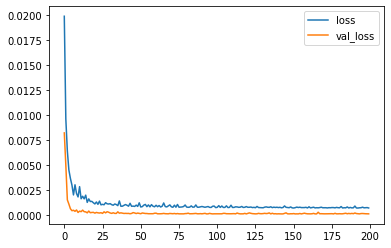

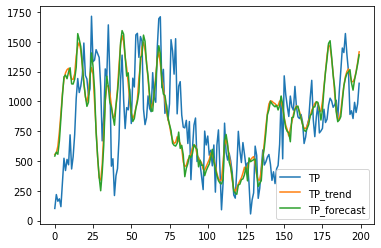

Model: "sequential_476"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1428 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1428 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1429 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1429 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1430 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1430 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_476 (Dense)            (None, 1)              

526/526 [==============================] - 7s 14ms/step - loss: 7.5527e-04 - accuracy: 5.9467e-05 - val_loss: 1.5044e-04 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 7.4996e-04 - accuracy: 5.9467e-05 - val_loss: 1.6109e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6580e-04 - accuracy: 5.9467e-05 - val_loss: 1.6993e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 8.6785e-04 - accuracy: 5.9467e-05 - val_loss: 1.9962e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.1076e-04 - accuracy: 5.9467e-05 - val_loss: 1.6769e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9499e-04 - accuracy: 5.9467e-05 - val_loss: 1.6900e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [=======================

Epoch 146/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6380e-04 - accuracy: 5.9467e-05 - val_loss: 1.5693e-04 - val_accuracy: 0.0000e+00
Epoch 147/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2472e-04 - accuracy: 5.9467e-05 - val_loss: 1.5596e-04 - val_accuracy: 0.0000e+00
Epoch 148/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5788e-04 - accuracy: 5.9467e-05 - val_loss: 1.4221e-04 - val_accuracy: 0.0000e+00
Epoch 149/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9824e-04 - accuracy: 5.9467e-05 - val_loss: 1.4601e-04 - val_accuracy: 0.0000e+00
Epoch 150/200
526/526 [==============================] - 7s 14ms/step - loss: 7.9449e-04 - accuracy: 5.9467e-05 - val_loss: 1.3911e-04 - val_accuracy: 0.0000e+00
Epoch 151/200
526/526 [==============================] - 7s 14ms/step - loss: 7.6053e-04 - accuracy: 5.9467e-05 - val_loss: 1.4675e-04 - val_accuracy: 0.0000e+00
Epoch 152/200
526/526 [=====

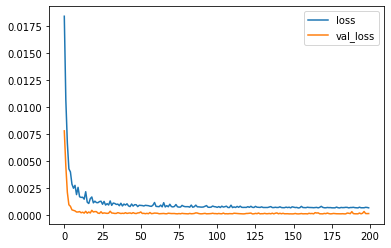

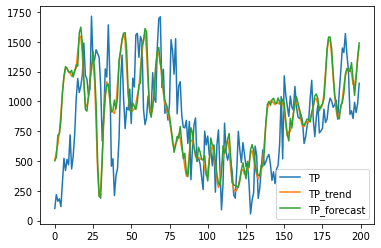

Model: "sequential_477"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1431 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1431 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1432 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1432 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1433 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1433 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_477 (Dense)            (None, 1)              

Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5890e-04 - accuracy: 5.9467e-05 - val_loss: 1.6958e-04 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0012 - accuracy: 5.9467e-05 - val_loss: 2.2380e-04 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.5248e-04 - accuracy: 5.9467e-05 - val_loss: 2.4787e-04 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2566e-04 - accuracy: 5.9467e-05 - val_loss: 1.7820e-04 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 0.0010 - accuracy: 5.9467e-05 - val_loss: 1.9937e-04 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [==============================] - 7s 14ms/step - loss: 9.0811e-04 - accuracy: 5.9467e-05 - val_loss: 2.7706e-04 - val_accuracy: 0.0000e+00
Epoch 51/200
526/526 [====================

Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2360e-04 - accuracy: 5.9467e-05 - val_loss: 1.5557e-04 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 7.5380e-04 - accuracy: 5.9467e-05 - val_loss: 1.5048e-04 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 8.2098e-04 - accuracy: 5.9467e-05 - val_loss: 2.0014e-04 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 8.4833e-04 - accuracy: 5.9467e-05 - val_loss: 2.4864e-04 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 7.3557e-04 - accuracy: 5.9467e-05 - val_loss: 1.6915e-04 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1873e-04 - accuracy: 5.9467e-05 - val_loss: 1.5057e-04 - val_accuracy: 0.0000e+00
Epoch 102/200
526/526 [=========

Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2984e-04 - accuracy: 5.9467e-05 - val_loss: 2.1436e-04 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0703e-04 - accuracy: 5.9467e-05 - val_loss: 1.9299e-04 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 7.0987e-04 - accuracy: 5.9467e-05 - val_loss: 1.6631e-04 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8923e-04 - accuracy: 5.9467e-05 - val_loss: 1.6834e-04 - val_accuracy: 0.0000e+00


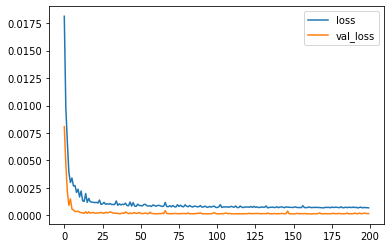

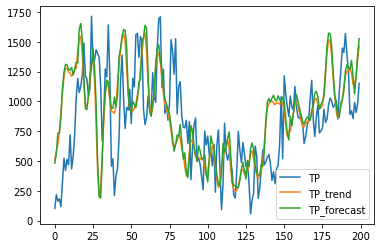

Model: "sequential_478"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1434 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1434 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1435 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1435 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1436 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1436 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_478 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 7.1259e-06 - accuracy: 2.9734e-05 - val_loss: 4.2683e-06 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 9.8833e-06 - accuracy: 2.9734e-05 - val_loss: 1.9443e-06 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 6.7817e-06 - accuracy: 2.9734e-05 - val_loss: 3.7208e-06 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 8.3162e-06 - accuracy: 2.9734e-05 - val_loss: 3.1602e-06 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 8.9299e-06 - accuracy: 2.9734e-05 - val_loss: 3.6546e-06 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2137e-06 - accuracy: 2.9734e-05 - val_loss: 5.3168e-06 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2589e-06 - accuracy: 2.9734e-05 - val_loss: 1.4630e-06 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 5.6867e-06 - accuracy: 2.9734e-05 - val_loss: 3.6066e-06 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 6.9674e-06 - accuracy: 2.9734e-05 - val_loss: 2.4174e-06 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0981e-06 - accuracy: 2.9734e-05 - val_loss: 3.7927e-06 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 7.7652e-06 - accuracy: 2.9734e-05 - val_loss: 1.2084e-06 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 5.8706e-06 - accuracy: 2.9734e-05 - val_loss: 2.0185e-06 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 5.8995e-06 - accuracy: 2.9734e-05 - val_loss: 3.2213e-06 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 5.3287e-06 - accuracy: 2.9734e-05 - val_loss: 3.7649e-06 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 5.7308e-06 - accuracy: 2.9734e-05 - val_loss: 1.8564e-06 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4114e-06 - accuracy: 2.9734e-05 - val_loss: 1.2882e-06 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 4.5675e-06 - accuracy: 2.9734e-05 - val_loss: 2.5427e-06 - val_accuracy: 0.0000e+00


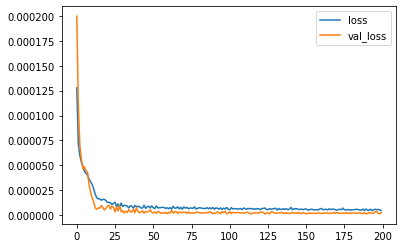

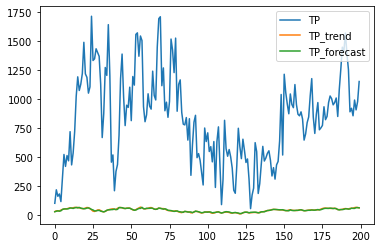

Model: "sequential_479"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1437 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1437 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1438 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1438 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1439 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1439 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_479 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 14ms/step - loss: 4.8167e-06 - accuracy: 2.9734e-05 - val_loss: 2.8510e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 14ms/step - loss: 4.8060e-06 - accuracy: 2.9734e-05 - val_loss: 1.8736e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 4.6023e-06 - accuracy: 2.9734e-05 - val_loss: 2.3630e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 14ms/step - loss: 3.7231e-06 - accuracy: 2.9734e-05 - val_loss: 1.2706e-08 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 14ms/step - loss: 4.0458e-06 - accuracy: 2.9734e-05 - val_loss: 2.9739e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 4.8585e-06 - accuracy: 2.9734e-05 - val_loss: 1.2087e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 14ms/step - loss: 3.7308e-06 - accuracy: 2.9734e-05 - val_loss: 2.7992e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 14ms/step - loss: 2.8692e-06 - accuracy: 2.9734e-05 - val_loss: 2.5904e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 14ms/step - loss: 2.3790e-06 - accuracy: 2.9734e-05 - val_loss: 1.9694e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 14ms/step - loss: 2.0550e-06 - accuracy: 2.9734e-05 - val_loss: 2.3667e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 14ms/step - loss: 3.2986e-06 - accuracy: 2.9734e-05 - val_loss: 1.6505e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 14ms/step - loss: 4.0848e-06 - accuracy: 2.9734e-05 - val_loss: 3.6967e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 14ms/step - loss: 2.2763e-06 - accuracy: 2.9734e-05 - val_loss: 1.9280e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 14ms/step - loss: 9.8218e-07 - accuracy: 2.9734e-05 - val_loss: 4.1086e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 14ms/step - loss: 2.5429e-06 - accuracy: 2.9734e-05 - val_loss: 3.3159e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 14ms/step - loss: 2.7062e-06 - accuracy: 2.9734e-05 - val_loss: 4.0053e-10 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 14ms/step - loss: 1.5576e-06 - accuracy: 2.9734e-05 - val_loss: 5.3745e-10 - val_accuracy: 0.0000e+00


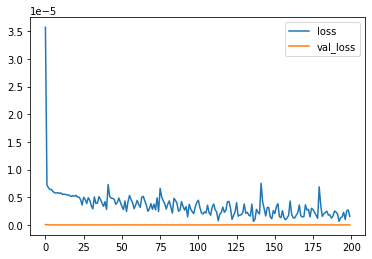

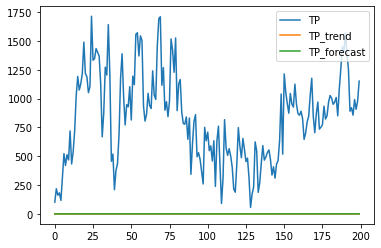

Model: "sequential_480"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1440 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1440 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1441 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1441 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1442 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1442 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_480 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.8499e-06 - accuracy: 0.0000e+00 - val_loss: 3.2838e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 4.4929e-06 - accuracy: 0.0000e+00 - val_loss: 1.3981e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 3.8203e-06 - accuracy: 0.0000e+00 - val_loss: 4.6864e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 6.3253e-06 - accuracy: 0.0000e+00 - val_loss: 7.5110e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 5.5744e-06 - accuracy: 0.0000e+00 - val_loss: 1.5226e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 5.0780e-06 - accuracy: 0.0000e+00 - val_loss: 1.0824e-09 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9869e-06 - accuracy: 0.0000e+00 - val_loss: 7.9427e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3963e-06 - accuracy: 0.0000e+00 - val_loss: 2.7596e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2746e-06 - accuracy: 0.0000e+00 - val_loss: 4.2500e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 4.8537e-06 - accuracy: 0.0000e+00 - val_loss: 3.9656e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3470e-06 - accuracy: 0.0000e+00 - val_loss: 2.1466e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8320e-06 - accuracy: 0.0000e+00 - val_loss: 9.0430e-10 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5454e-06 - accuracy: 0.0000e+00 - val_loss: 6.0094e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5816e-06 - accuracy: 0.0000e+00 - val_loss: 1.5303e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8964e-07 - accuracy: 0.0000e+00 - val_loss: 1.2002e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7625e-06 - accuracy: 0.0000e+00 - val_loss: 2.6355e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 5.1038e-07 - accuracy: 0.0000e+00 - val_loss: 7.1840e-10 - val_accuracy: 1.1893e-04


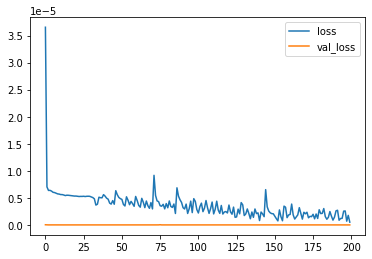

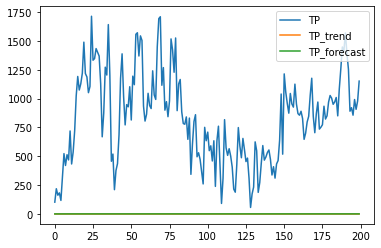

Model: "sequential_481"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1443 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1443 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1444 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1444 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1445 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1445 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_481 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7327e-06 - accuracy: 2.9734e-05 - val_loss: 9.5397e-10 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 5.2548e-06 - accuracy: 2.9734e-05 - val_loss: 7.7000e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.6792e-06 - accuracy: 2.9734e-05 - val_loss: 5.1548e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9179e-06 - accuracy: 2.9734e-05 - val_loss: 4.0851e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9609e-06 - accuracy: 2.9734e-05 - val_loss: 5.3984e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 3.2669e-06 - accuracy: 2.9734e-05 - val_loss: 1.3937e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9231e-06 - accuracy: 2.9734e-05 - val_loss: 2.8779e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9074e-06 - accuracy: 2.9734e-05 - val_loss: 8.9325e-10 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1994e-06 - accuracy: 2.9734e-05 - val_loss: 4.6497e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5174e-06 - accuracy: 2.9734e-05 - val_loss: 7.1833e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4805e-06 - accuracy: 2.9734e-05 - val_loss: 5.5638e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8167e-06 - accuracy: 2.9734e-05 - val_loss: 2.3139e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4017e-06 - accuracy: 2.9734e-05 - val_loss: 1.0661e-08 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.3311e-06 - accuracy: 2.9734e-05 - val_loss: 5.7070e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.7644e-07 - accuracy: 2.9734e-05 - val_loss: 1.9448e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.4401e-06 - accuracy: 2.9734e-05 - val_loss: 4.2220e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 1.2041e-06 - accuracy: 2.9734e-05 - val_loss: 4.1820e-10 - val_accuracy: 0.0000e+00


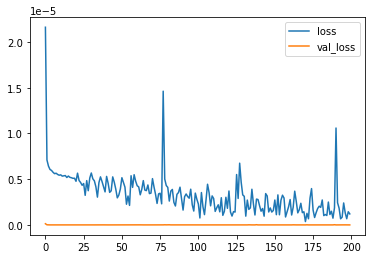

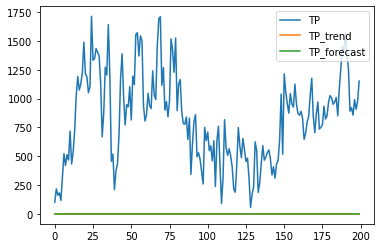

Model: "sequential_482"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1446 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1446 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1447 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1447 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1448 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1448 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_482 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 5.3646e-06 - accuracy: 2.9734e-05 - val_loss: 3.3336e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 4.9605e-06 - accuracy: 2.9734e-05 - val_loss: 7.4100e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3828e-06 - accuracy: 2.9734e-05 - val_loss: 3.4240e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7135e-06 - accuracy: 2.9734e-05 - val_loss: 4.3367e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0562e-06 - accuracy: 2.9734e-05 - val_loss: 4.7079e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3197e-06 - accuracy: 2.9734e-05 - val_loss: 2.0618e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5462e-06 - accuracy: 2.9734e-05 - val_loss: 2.2766e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1217e-06 - accuracy: 2.9734e-05 - val_loss: 1.9625e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4185e-06 - accuracy: 2.9734e-05 - val_loss: 8.1369e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4037e-06 - accuracy: 2.9734e-05 - val_loss: 4.5605e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2130e-06 - accuracy: 2.9734e-05 - val_loss: 1.9662e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1612e-06 - accuracy: 2.9734e-05 - val_loss: 1.0951e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 4.9773e-07 - accuracy: 2.9734e-05 - val_loss: 1.1988e-08 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0912e-06 - accuracy: 2.9734e-05 - val_loss: 2.0599e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9528e-06 - accuracy: 2.9734e-05 - val_loss: 7.6462e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7203e-06 - accuracy: 2.9734e-05 - val_loss: 2.2958e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 6.0185e-07 - accuracy: 2.9734e-05 - val_loss: 3.3127e-09 - val_accuracy: 0.0000e+00


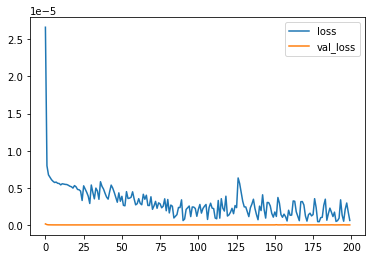

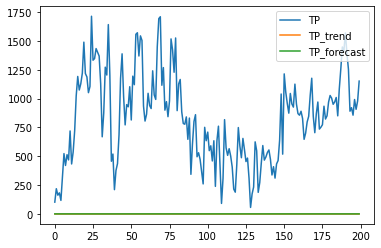

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_483"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1449 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1449 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1450 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1450 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1451 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1451 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_483 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 4.6513e-06 - accuracy: 2.9734e-05 - val_loss: 1.6076e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 3.9013e-06 - accuracy: 2.9734e-05 - val_loss: 6.5673e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 3.9434e-06 - accuracy: 2.9734e-05 - val_loss: 1.2144e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 5.2853e-06 - accuracy: 2.9734e-05 - val_loss: 9.8517e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 4.8462e-06 - accuracy: 2.9734e-05 - val_loss: 8.6193e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 4.1073e-06 - accuracy: 2.9734e-05 - val_loss: 5.6570e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 3.4185e-06 - accuracy: 2.9734e-05 - val_loss: 5.3924e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 2.5694e-06 - accuracy: 2.9734e-05 - val_loss: 3.4662e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 3.0431e-06 - accuracy: 2.9734e-05 - val_loss: 1.1791e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 2.7479e-06 - accuracy: 2.9734e-05 - val_loss: 2.9508e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4767e-06 - accuracy: 2.9734e-05 - val_loss: 2.5662e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 3.4517e-06 - accuracy: 2.9734e-05 - val_loss: 2.1502e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 1.1611e-06 - accuracy: 2.9734e-05 - val_loss: 3.7364e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 1.1280e-06 - accuracy: 2.9734e-05 - val_loss: 1.6374e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 1.9817e-06 - accuracy: 2.9734e-05 - val_loss: 5.0165e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 1.5067e-06 - accuracy: 2.9734e-05 - val_loss: 4.8349e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4602e-06 - accuracy: 2.9734e-05 - val_loss: 6.4235e-10 - val_accuracy: 0.0000e+00


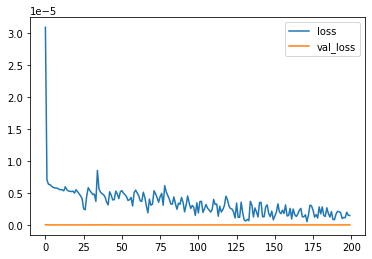

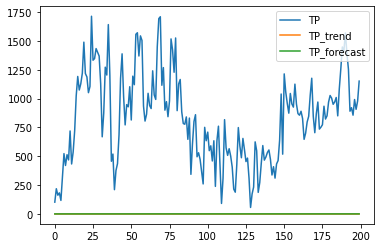

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_484"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1452 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1452 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1453 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1453 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1454 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1454 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_484 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4537e-06 - accuracy: 0.0000e+00 - val_loss: 8.0494e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0706e-06 - accuracy: 0.0000e+00 - val_loss: 4.1525e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 5.2140e-06 - accuracy: 0.0000e+00 - val_loss: 1.5232e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 4.8412e-06 - accuracy: 0.0000e+00 - val_loss: 4.1863e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 3.7155e-06 - accuracy: 0.0000e+00 - val_loss: 7.2842e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9116e-06 - accuracy: 0.0000e+00 - val_loss: 9.8349e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4703e-06 - accuracy: 0.0000e+00 - val_loss: 8.1654e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 8s 14ms/step - loss: 2.8899e-06 - accuracy: 0.0000e+00 - val_loss: 5.3003e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 9.5574e-07 - accuracy: 0.0000e+00 - val_loss: 6.5538e-10 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0607e-06 - accuracy: 0.0000e+00 - val_loss: 1.0567e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.7878e-06 - accuracy: 0.0000e+00 - val_loss: 6.0463e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 1.6192e-06 - accuracy: 0.0000e+00 - val_loss: 2.3131e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 3.6562e-06 - accuracy: 0.0000e+00 - val_loss: 2.7064e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.7534e-06 - accuracy: 0.0000e+00 - val_loss: 3.2553e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 7.2628e-07 - accuracy: 0.0000e+00 - val_loss: 9.3073e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0168e-06 - accuracy: 0.0000e+00 - val_loss: 7.9060e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 8s 14ms/step - loss: 2.6282e-06 - accuracy: 0.0000e+00 - val_loss: 9.8335e-09 - val_accuracy: 1.1893e-04


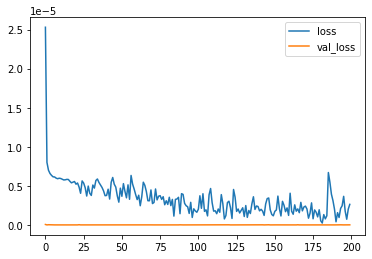

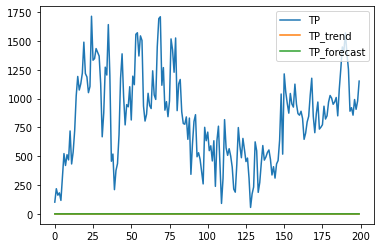

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_485"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1455 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1455 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1456 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1456 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1457 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1457 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_485 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 5.0202e-06 - accuracy: 0.0000e+00 - val_loss: 6.2796e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 8s 14ms/step - loss: 4.7811e-06 - accuracy: 0.0000e+00 - val_loss: 5.9087e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 8s 14ms/step - loss: 4.5357e-06 - accuracy: 0.0000e+00 - val_loss: 6.9089e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 3.9933e-06 - accuracy: 0.0000e+00 - val_loss: 7.2067e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 8s 14ms/step - loss: 4.0523e-06 - accuracy: 0.0000e+00 - val_loss: 1.7707e-08 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 8s 14ms/step - loss: 3.7587e-06 - accuracy: 0.0000e+00 - val_loss: 2.5847e-08 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 2.8731e-06 - accuracy: 0.0000e+00 - val_loss: 3.3180e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 3.0859e-06 - accuracy: 0.0000e+00 - val_loss: 8.3117e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 2.0293e-06 - accuracy: 0.0000e+00 - val_loss: 1.4911e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 3.1835e-06 - accuracy: 0.0000e+00 - val_loss: 4.3368e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4512e-06 - accuracy: 0.0000e+00 - val_loss: 1.3049e-08 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 4.9216e-06 - accuracy: 0.0000e+00 - val_loss: 7.3742e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1877e-06 - accuracy: 0.0000e+00 - val_loss: 1.5190e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6801e-06 - accuracy: 0.0000e+00 - val_loss: 7.0375e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 1.5131e-06 - accuracy: 0.0000e+00 - val_loss: 7.1194e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 2.8995e-06 - accuracy: 0.0000e+00 - val_loss: 9.8594e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 6.4899e-07 - accuracy: 0.0000e+00 - val_loss: 5.0604e-10 - val_accuracy: 1.1893e-04


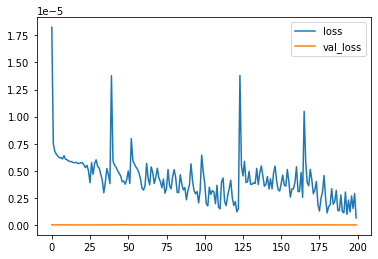

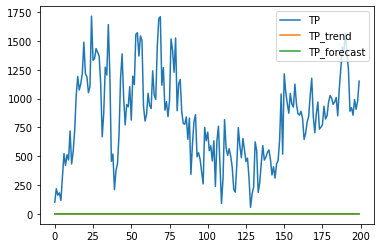

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_486"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1458 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1458 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1459 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1459 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1460 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1460 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_486 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4769e-06 - accuracy: 0.0000e+00 - val_loss: 1.8654e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 5.1949e-06 - accuracy: 0.0000e+00 - val_loss: 3.1021e-09 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 4.9093e-06 - accuracy: 0.0000e+00 - val_loss: 3.2515e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 3.9508e-06 - accuracy: 0.0000e+00 - val_loss: 8.1125e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 4.4762e-06 - accuracy: 0.0000e+00 - val_loss: 4.7880e-10 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4916e-06 - accuracy: 0.0000e+00 - val_loss: 7.6644e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9784e-06 - accuracy: 0.0000e+00 - val_loss: 3.1536e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 3.6877e-06 - accuracy: 0.0000e+00 - val_loss: 4.9939e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 2.6528e-06 - accuracy: 0.0000e+00 - val_loss: 3.1201e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 3.0115e-06 - accuracy: 0.0000e+00 - val_loss: 2.0484e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 4.0959e-06 - accuracy: 0.0000e+00 - val_loss: 4.0068e-09 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 3.0877e-06 - accuracy: 0.0000e+00 - val_loss: 7.8982e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 9.9776e-07 - accuracy: 0.0000e+00 - val_loss: 1.2911e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 1.6869e-06 - accuracy: 0.0000e+00 - val_loss: 3.2057e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 8.2594e-07 - accuracy: 0.0000e+00 - val_loss: 2.3458e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 3.2351e-07 - accuracy: 0.0000e+00 - val_loss: 9.2384e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 8s 16ms/step - loss: 1.8006e-06 - accuracy: 0.0000e+00 - val_loss: 1.6626e-09 - val_accuracy: 1.1893e-04


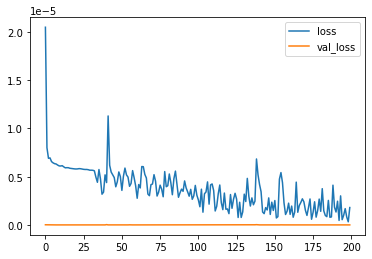

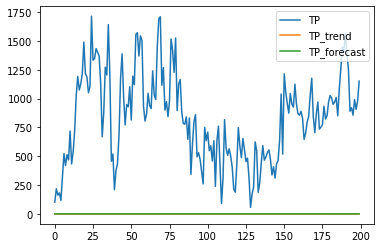

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_487"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1461 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1461 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1462 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1462 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1463 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1463 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_487 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 5.4635e-06 - accuracy: 0.0000e+00 - val_loss: 6.1581e-10 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 4.9392e-06 - accuracy: 0.0000e+00 - val_loss: 3.9975e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 4.3812e-06 - accuracy: 0.0000e+00 - val_loss: 1.1271e-09 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 3.5107e-06 - accuracy: 0.0000e+00 - val_loss: 2.1520e-10 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 5.0600e-06 - accuracy: 0.0000e+00 - val_loss: 2.9478e-09 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 3.7154e-06 - accuracy: 0.0000e+00 - val_loss: 3.8845e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 15ms/step - loss: 2.6002e-06 - accuracy: 0.0000e+00 - val_loss: 6.1489e-10 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8143e-06 - accuracy: 0.0000e+00 - val_loss: 8.8397e-10 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 4.2961e-06 - accuracy: 0.0000e+00 - val_loss: 3.3255e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 4.2420e-06 - accuracy: 0.0000e+00 - val_loss: 8.7449e-10 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3386e-06 - accuracy: 0.0000e+00 - val_loss: 9.2748e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8574e-06 - accuracy: 0.0000e+00 - val_loss: 3.1051e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 1.7011e-06 - accuracy: 0.0000e+00 - val_loss: 3.3150e-10 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 1.2546e-06 - accuracy: 0.0000e+00 - val_loss: 3.5053e-09 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 9.5714e-07 - accuracy: 0.0000e+00 - val_loss: 3.6921e-10 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 1.8448e-06 - accuracy: 0.0000e+00 - val_loss: 6.2047e-09 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 9.2322e-07 - accuracy: 0.0000e+00 - val_loss: 1.2604e-09 - val_accuracy: 1.1893e-04


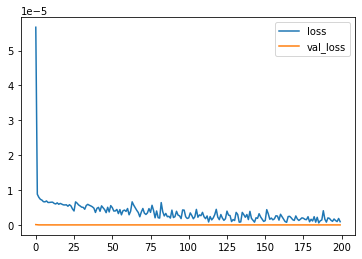

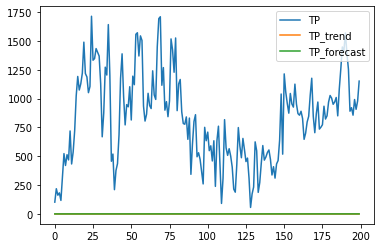

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_488"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1464 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1464 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1465 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1465 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1466 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1466 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_488 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 4.5681e-06 - accuracy: 0.0000e+00 - val_loss: 3.2731e-09 - val_accuracy: 1.1893e-04
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 3.0833e-06 - accuracy: 0.0000e+00 - val_loss: 5.8078e-10 - val_accuracy: 1.1893e-04
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3800e-06 - accuracy: 0.0000e+00 - val_loss: 4.9638e-10 - val_accuracy: 1.1893e-04
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 5.1388e-06 - accuracy: 0.0000e+00 - val_loss: 3.9276e-09 - val_accuracy: 1.1893e-04
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 4.4009e-06 - accuracy: 0.0000e+00 - val_loss: 9.6908e-11 - val_accuracy: 1.1893e-04
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 4.1937e-06 - accuracy: 0.0000e+00 - val_loss: 7.1635e-10 - val_accuracy: 1.1893e-04
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 4.9246e-06 - accuracy: 0.0000e+00 - val_loss: 1.5895e-09 - val_accuracy: 1.1893e-04
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4742e-06 - accuracy: 0.0000e+00 - val_loss: 3.2858e-09 - val_accuracy: 1.1893e-04
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5583e-06 - accuracy: 0.0000e+00 - val_loss: 1.1031e-09 - val_accuracy: 1.1893e-04
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7383e-06 - accuracy: 0.0000e+00 - val_loss: 8.2881e-09 - val_accuracy: 1.1893e-04
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.5309e-06 - accuracy: 0.0000e+00 - val_loss: 8.7522e-10 - val_accuracy: 1.1893e-04
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 4.4103e-06 - accuracy: 0.0000e+00 - val_loss: 1.4590e-09 - val_accuracy: 1.1893e-04
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 5.7649e-06 - accuracy: 0.0000e+00 - val_loss: 5.7999e-09 - val_accuracy: 1.1893e-04
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9333e-06 - accuracy: 0.0000e+00 - val_loss: 7.7926e-10 - val_accuracy: 1.1893e-04
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.1437e-06 - accuracy: 0.0000e+00 - val_loss: 1.0116e-09 - val_accuracy: 1.1893e-04
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5537e-06 - accuracy: 0.0000e+00 - val_loss: 2.0950e-10 - val_accuracy: 1.1893e-04
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2250e-06 - accuracy: 0.0000e+00 - val_loss: 1.0878e-09 - val_accuracy: 1.1893e-04


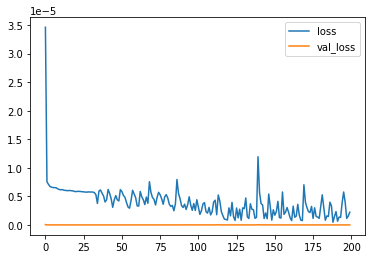

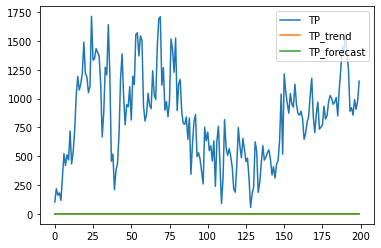

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_489"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1467 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1467 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1468 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1468 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1469 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1469 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_489 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2512e-06 - accuracy: 2.9734e-05 - val_loss: 2.4766e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 5.7974e-06 - accuracy: 2.9734e-05 - val_loss: 5.8338e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 5.4749e-06 - accuracy: 2.9734e-05 - val_loss: 1.2268e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 5.2612e-06 - accuracy: 2.9734e-05 - val_loss: 1.0440e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 4.2158e-06 - accuracy: 2.9734e-05 - val_loss: 4.5887e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9927e-06 - accuracy: 2.9734e-05 - val_loss: 5.0765e-11 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1428e-06 - accuracy: 2.9734e-05 - val_loss: 2.3341e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.3445e-06 - accuracy: 2.9734e-05 - val_loss: 1.6402e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2255e-06 - accuracy: 2.9734e-05 - val_loss: 8.4260e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 3.1425e-06 - accuracy: 2.9734e-05 - val_loss: 1.1051e-08 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7283e-06 - accuracy: 2.9734e-05 - val_loss: 3.3856e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9448e-06 - accuracy: 2.9734e-05 - val_loss: 1.5320e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 2.2885e-06 - accuracy: 2.9734e-05 - val_loss: 2.0206e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 1.4736e-06 - accuracy: 2.9734e-05 - val_loss: 2.3793e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.8680e-06 - accuracy: 2.9734e-05 - val_loss: 2.6419e-08 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 5.1160e-06 - accuracy: 2.9734e-05 - val_loss: 6.6638e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6231e-06 - accuracy: 2.9734e-05 - val_loss: 7.4406e-09 - val_accuracy: 0.0000e+00


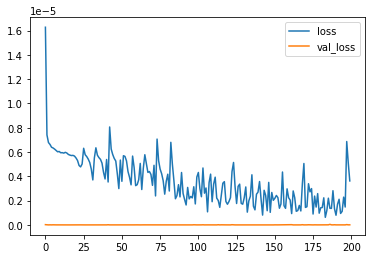

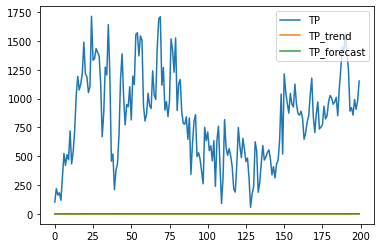

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_490"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1470 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1470 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1471 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1471 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1472 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1472 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_490 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7606e-06 - accuracy: 2.9734e-05 - val_loss: 2.1405e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9533e-06 - accuracy: 2.9734e-05 - val_loss: 2.5208e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 3.9103e-06 - accuracy: 2.9734e-05 - val_loss: 4.9395e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 8.8058e-06 - accuracy: 2.9734e-05 - val_loss: 4.4268e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1643e-06 - accuracy: 2.9734e-05 - val_loss: 1.3379e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 5.1631e-06 - accuracy: 2.9734e-05 - val_loss: 4.1613e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 4.3525e-06 - accuracy: 2.9734e-05 - val_loss: 4.9072e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 3.3223e-06 - accuracy: 2.9734e-05 - val_loss: 1.2890e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5869e-06 - accuracy: 2.9734e-05 - val_loss: 3.0656e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.4533e-06 - accuracy: 2.9734e-05 - val_loss: 4.6320e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.6985e-06 - accuracy: 2.9734e-05 - val_loss: 7.2698e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 1.6785e-06 - accuracy: 2.9734e-05 - val_loss: 7.9486e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.9315e-06 - accuracy: 2.9734e-05 - val_loss: 1.6673e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 9.5483e-07 - accuracy: 2.9734e-05 - val_loss: 3.5691e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 1.5228e-06 - accuracy: 2.9734e-05 - val_loss: 1.2967e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 2.9331e-06 - accuracy: 2.9734e-05 - val_loss: 1.6087e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 4.1785e-06 - accuracy: 2.9734e-05 - val_loss: 4.6915e-09 - val_accuracy: 0.0000e+00


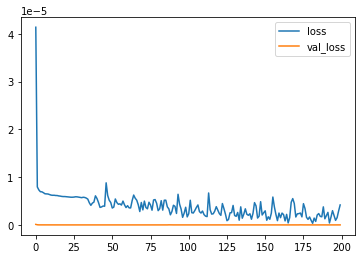

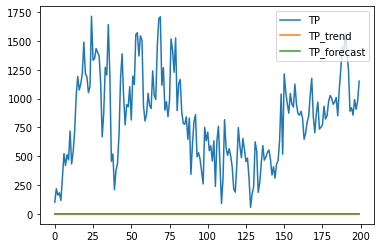

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_491"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1473 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1473 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1474 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1474 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1475 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1475 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_491 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 8s 15ms/step - loss: 4.2659e-06 - accuracy: 2.9734e-05 - val_loss: 1.3274e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 8s 15ms/step - loss: 4.2085e-06 - accuracy: 2.9734e-05 - val_loss: 1.4910e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 8s 15ms/step - loss: 5.5018e-06 - accuracy: 2.9734e-05 - val_loss: 4.9375e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 8s 15ms/step - loss: 4.6008e-06 - accuracy: 2.9734e-05 - val_loss: 2.2849e-09 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 8s 15ms/step - loss: 3.1847e-06 - accuracy: 2.9734e-05 - val_loss: 2.1683e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 8s 15ms/step - loss: 3.8058e-06 - accuracy: 2.9734e-05 - val_loss: 4.5056e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 8s 16ms/step - loss: 3.1758e-06 - accuracy: 2.9734e-05 - val_loss: 7.5178e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 8s 15ms/step - loss: 3.4484e-06 - accuracy: 2.9734e-05 - val_loss: 1.5575e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 8s 15ms/step - loss: 4.1419e-06 - accuracy: 2.9734e-05 - val_loss: 2.0738e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 8s 15ms/step - loss: 3.1419e-06 - accuracy: 2.9734e-05 - val_loss: 5.0269e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 8s 15ms/step - loss: 2.1960e-06 - accuracy: 2.9734e-05 - val_loss: 5.8596e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 8s 15ms/step - loss: 4.2487e-06 - accuracy: 2.9734e-05 - val_loss: 3.4413e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 8s 15ms/step - loss: 1.1827e-06 - accuracy: 2.9734e-05 - val_loss: 5.9959e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 8s 15ms/step - loss: 2.3197e-06 - accuracy: 2.9734e-05 - val_loss: 7.0181e-10 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 8s 15ms/step - loss: 1.4481e-06 - accuracy: 2.9734e-05 - val_loss: 4.5723e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 8s 15ms/step - loss: 2.7613e-06 - accuracy: 2.9734e-05 - val_loss: 1.6987e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 8s 15ms/step - loss: 2.7504e-06 - accuracy: 2.9734e-05 - val_loss: 2.6924e-09 - val_accuracy: 0.0000e+00


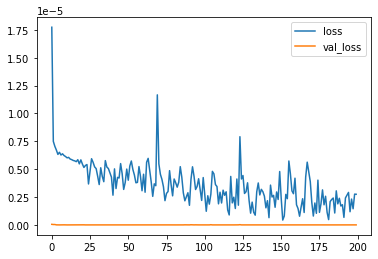

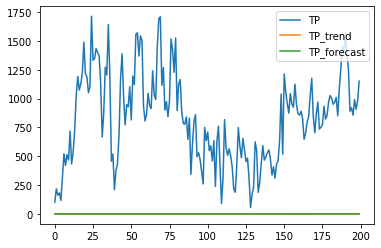

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_492"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1476 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1476 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1477 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1477 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1478 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1478 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_492 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 4.5896e-06 - accuracy: 2.9734e-05 - val_loss: 2.1924e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 3.1238e-06 - accuracy: 2.9734e-05 - val_loss: 2.4663e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.6553e-06 - accuracy: 2.9734e-05 - val_loss: 2.3293e-09 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 6.2876e-06 - accuracy: 2.9734e-05 - val_loss: 7.6784e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 5.4098e-06 - accuracy: 2.9734e-05 - val_loss: 1.9906e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 4.5660e-06 - accuracy: 2.9734e-05 - val_loss: 1.3873e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 2.7479e-06 - accuracy: 2.9734e-05 - val_loss: 1.2082e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 2.8489e-06 - accuracy: 2.9734e-05 - val_loss: 5.8835e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 5.3409e-06 - accuracy: 2.9734e-05 - val_loss: 1.2365e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.9537e-06 - accuracy: 2.9734e-05 - val_loss: 9.8294e-10 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0190e-06 - accuracy: 2.9734e-05 - val_loss: 2.1289e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 2.0097e-06 - accuracy: 2.9734e-05 - val_loss: 8.8039e-10 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 5.8042e-07 - accuracy: 2.9734e-05 - val_loss: 2.7667e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7262e-06 - accuracy: 2.9734e-05 - val_loss: 1.2180e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 6.1481e-07 - accuracy: 2.9734e-05 - val_loss: 4.3431e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 9.9015e-07 - accuracy: 2.9734e-05 - val_loss: 1.4667e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3827e-06 - accuracy: 2.9734e-05 - val_loss: 4.2693e-09 - val_accuracy: 0.0000e+00


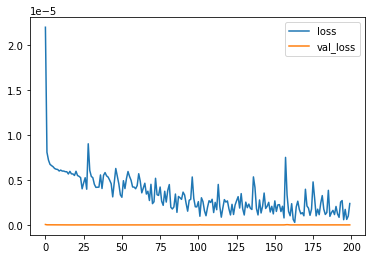

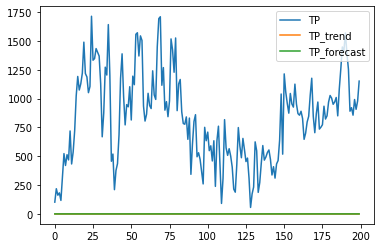

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_493"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1479 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1479 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1480 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1480 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1481 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1481 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_493 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 14ms/step - loss: 5.2746e-06 - accuracy: 8.9201e-05 - val_loss: 1.1750e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 14ms/step - loss: 5.7815e-06 - accuracy: 8.9201e-05 - val_loss: 6.5784e-10 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 14ms/step - loss: 5.4567e-06 - accuracy: 8.9201e-05 - val_loss: 4.0776e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 14ms/step - loss: 5.3238e-06 - accuracy: 8.9201e-05 - val_loss: 2.9765e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 14ms/step - loss: 4.4619e-06 - accuracy: 8.9201e-05 - val_loss: 8.3393e-10 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 14ms/step - loss: 3.0545e-06 - accuracy: 8.9201e-05 - val_loss: 8.7121e-10 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 14ms/step - loss: 6.0230e-06 - accuracy: 8.9201e-05 - val_loss: 3.0047e-09 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 14ms/step - loss: 4.1515e-06 - accuracy: 8.9201e-05 - val_loss: 2.0326e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 14ms/step - loss: 3.2277e-06 - accuracy: 8.9201e-05 - val_loss: 1.2595e-09 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 14ms/step - loss: 2.2493e-06 - accuracy: 8.9201e-05 - val_loss: 2.8762e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 14ms/step - loss: 1.8123e-06 - accuracy: 8.9201e-05 - val_loss: 6.2571e-10 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 14ms/step - loss: 3.3443e-06 - accuracy: 8.9201e-05 - val_loss: 2.0250e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 14ms/step - loss: 2.3924e-06 - accuracy: 8.9201e-05 - val_loss: 3.5810e-09 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 14ms/step - loss: 6.8672e-07 - accuracy: 8.9201e-05 - val_loss: 5.8894e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 14ms/step - loss: 1.7417e-06 - accuracy: 8.9201e-05 - val_loss: 1.7505e-09 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 14ms/step - loss: 2.2689e-06 - accuracy: 8.9201e-05 - val_loss: 6.9018e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 14ms/step - loss: 1.1482e-06 - accuracy: 8.9201e-05 - val_loss: 5.4686e-09 - val_accuracy: 0.0000e+00


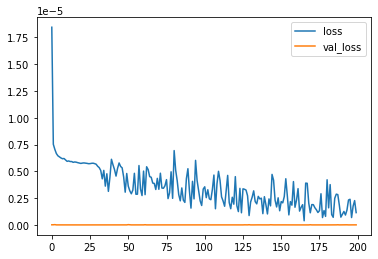

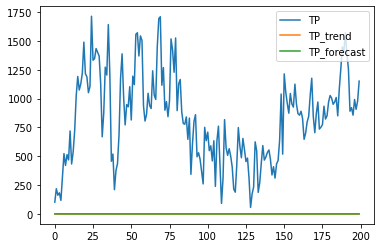

C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:219: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)
C:\Users\Administrator\Desktop\env37_1\lib\site-packages\scipy\signal\_savitzky_golay.py:222: RankWarning: Polyfit may be poorly conditioned
  polyorder, deriv, delta, y)


Model: "sequential_494"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1482 (LSTM)             (None, 10, 50)            10800     
_________________________________________________________________
dropout_1482 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1483 (LSTM)             (None, 10, 50)            20200     
_________________________________________________________________
dropout_1483 (Dropout)       (None, 10, 50)            0         
_________________________________________________________________
lstm_1484 (LSTM)             (None, 50)                20200     
_________________________________________________________________
dropout_1484 (Dropout)       (None, 50)                0         
_________________________________________________________________
dense_494 (Dense)            (None, 1)              

Epoch 44/200
526/526 [==============================] - 7s 13ms/step - loss: 5.2255e-06 - accuracy: 2.9734e-05 - val_loss: 2.0577e-09 - val_accuracy: 0.0000e+00
Epoch 45/200
526/526 [==============================] - 7s 13ms/step - loss: 5.0882e-06 - accuracy: 2.9734e-05 - val_loss: 2.1991e-09 - val_accuracy: 0.0000e+00
Epoch 46/200
526/526 [==============================] - 7s 13ms/step - loss: 4.6126e-06 - accuracy: 2.9734e-05 - val_loss: 9.7781e-10 - val_accuracy: 0.0000e+00
Epoch 47/200
526/526 [==============================] - 7s 13ms/step - loss: 4.4749e-06 - accuracy: 2.9734e-05 - val_loss: 4.7581e-10 - val_accuracy: 0.0000e+00
Epoch 48/200
526/526 [==============================] - 7s 13ms/step - loss: 3.4557e-06 - accuracy: 2.9734e-05 - val_loss: 4.5855e-09 - val_accuracy: 0.0000e+00
Epoch 49/200
526/526 [==============================] - 7s 13ms/step - loss: 3.5019e-06 - accuracy: 2.9734e-05 - val_loss: 1.9545e-09 - val_accuracy: 0.0000e+00
Epoch 50/200
526/526 [============

Epoch 95/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7813e-06 - accuracy: 2.9734e-05 - val_loss: 8.9307e-10 - val_accuracy: 0.0000e+00
Epoch 96/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7179e-06 - accuracy: 2.9734e-05 - val_loss: 4.1079e-09 - val_accuracy: 0.0000e+00
Epoch 97/200
526/526 [==============================] - 7s 13ms/step - loss: 1.7666e-06 - accuracy: 2.9734e-05 - val_loss: 8.4841e-10 - val_accuracy: 0.0000e+00
Epoch 98/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1441e-06 - accuracy: 2.9734e-05 - val_loss: 1.4620e-09 - val_accuracy: 0.0000e+00
Epoch 99/200
526/526 [==============================] - 7s 13ms/step - loss: 3.7543e-06 - accuracy: 2.9734e-05 - val_loss: 2.9298e-09 - val_accuracy: 0.0000e+00
Epoch 100/200
526/526 [==============================] - 7s 13ms/step - loss: 3.2743e-06 - accuracy: 2.9734e-05 - val_loss: 2.9761e-09 - val_accuracy: 0.0000e+00
Epoch 101/200
526/526 [==========

Epoch 196/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8911e-06 - accuracy: 2.9734e-05 - val_loss: 2.2540e-10 - val_accuracy: 0.0000e+00
Epoch 197/200
526/526 [==============================] - 7s 13ms/step - loss: 1.0918e-06 - accuracy: 2.9734e-05 - val_loss: 1.1233e-09 - val_accuracy: 0.0000e+00
Epoch 198/200
526/526 [==============================] - 7s 13ms/step - loss: 9.6007e-07 - accuracy: 2.9734e-05 - val_loss: 9.7419e-10 - val_accuracy: 0.0000e+00
Epoch 199/200
526/526 [==============================] - 7s 13ms/step - loss: 1.8516e-06 - accuracy: 2.9734e-05 - val_loss: 2.9092e-09 - val_accuracy: 0.0000e+00
Epoch 200/200
526/526 [==============================] - 7s 13ms/step - loss: 2.1349e-06 - accuracy: 2.9734e-05 - val_loss: 2.4277e-09 - val_accuracy: 0.0000e+00


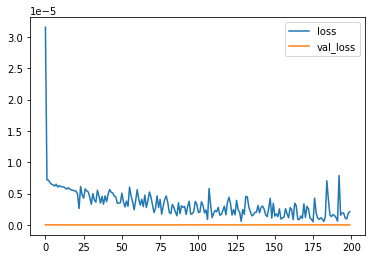

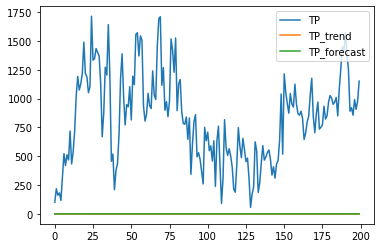

In [99]:
z = np.loadtxt(open('./predict-wind-turbine/compare_filter/z_rmse.csv', "rb"), delimiter = ",", skiprows = 0)
t = np.loadtxt(open('./predict-wind-turbine/compare_filter/t.csv', "rb"), delimiter = ",", skiprows = 0)
for i in range(x.shape[1]): # w
    for j in range(x.shape[0]): # k
        if y[j,0]<x[0,i]: # k<n
            if math.isnan(z[j,i]):
                date_pro = serScada.iloc[:,[1,2,3]].values
                WS_sg = savgol_filter(serScada.iloc[:,[3]].values.ravel(), x[0,i], y[j,0])
                date_pro[:,2] = WS_sg

                # 拟合计算放缩比例等参数，并存储在 scaler
                scaler, data_norm = scale(date_pro)  # 字典对象也可以

                # to supervised learning
                n_timesteps = 10  # 之前的时刻数量
                n_features = data_norm.shape[1]  # 数据集中输入特征数量
                data_supervised = series_to_supervised(data_norm, n_timesteps, 1)  # 包含 t 时刻之前的 timestep 个时间点，以及 t 时刻数据，以 t 时刻为预测对象

                # drop columns we don't want to predict
                relain = np.array([3])  # array([3]) 保留第几个变量(从1计数)，即预测对象
                data_supervised_droped = copy.deepcopy(data_supervised)  # 深拷贝则不会改变原始字典对象内容
                remov = np.array([x for x in range(data_norm.shape[1])]) + n_timesteps*n_features  # array([30, 31, 32]) t 时刻所有参数列序号
                remov = np.delete(remov,relain-1)  # array([30, 31]) 要删除的对象
                data_supervised_droped.drop(data_supervised_droped.columns[remov], axis=1, inplace=True)  # 去掉输出当中不需要预测的参数列 [-1,-2,-3,-4,-5,-6]

                # split into train and test sets
                n_train_num = int(len(data_supervised_droped)*0.8)  # 规定训练集数据数量，要小于数据量总数，在后面设置reshape设置样本个数、时间步长要注意数量对应
                train = data_supervised_droped.values[:n_train_num, :]  # 按行切片，从0到n-1行，也就是从头开始总共 n 行数据
                test = data_supervised_droped.values[n_train_num:, :]  # 按行切片
                # y = data_supervised_droped.values[:,n_timesteps*n_features][n_train_num:]  # 测试集的 y，用于后续结果比较

                # split into input and outputs
                X_train, y_train = train[:, :-1], train[:, -1]  # 按列切片，从起始位置到-2列：-1列
                X_test, y_test = test[:, :-1], test[:, -1]  # x 和 y 变量类型都是<class 'numpy.ndarray'>

                # reshape input to be 3D [samples, timesteps, features] [样本数量(就是原二维矩阵行数)，时间步长，特征数量(参数种类)]
                X_train = X_train.reshape((X_train.shape[0], n_timesteps, n_features))  # 相当于将每一行变换成一个二维矩阵
                X_test = X_test.reshape((X_test.shape[0], n_timesteps, n_features))

                # model training
                time_start = time.perf_counter  ()  # 记录开始时间
                model_lstm = fit_LSTM(units=50,epochs=200) ################################################
                time_end = time.perf_counter  ()  # 记录结束时间
                time_sum = time_end - time_start  # 计算的时间差为程序的执行时间，单位为秒/s
                prediction_lstm = model_lstm.predict(X_test)
                prediction_lstm = inverse_transform_col(scaler, prediction_lstm, 2)
                y_test_inverse = inverse_transform_col(scaler, y_test, 2)

                # 输出存储实际数据和预测结果
                df_lstm = pd.DataFrame({'actual':y_test_inverse, 'predicted':prediction_lstm[:,0]})
                df_lstm.to_csv('./predict-wind-turbine/compare_filter/SG_' + str(x[0,i]) + '_' + str(y[j,0]) + '.csv', index=False)

                # 理论、趋势、预测--show
                a = 100
                b = 300
                xx = serScada.iloc[:,[3]].values.ravel()[n_train_num+a:n_train_num+b]
                plt.plot(xx, label='TP')

                yy = y_test_inverse[a:b]
                plt.plot(yy, label='TP_trend')

                yy = prediction_lstm[a:b]
                plt.plot(yy, label='TP_forecast')

                plt.legend()
                plt.savefig('./predict-wind-turbine/compare_filter/SG_' + str(x[0,i]) + '_' + str(y[j,0]) + '.png')
                plt.show()

                # rmse
                z[j,i] = rmse(y_test_inverse,prediction_lstm[:,0])
                t[j,i] = time_sum
        else:
            z[j,i] = np.nan

        # 写入rmse
        np.savetxt('./predict-wind-turbine/compare_filter/z_rmse.csv', z, delimiter = ',')
        np.savetxt('./predict-wind-turbine/compare_filter/t.csv', t, delimiter = ',')

In [97]:
np.loadtxt(open('./predict-wind-turbine/compare_filter/z_rmse.csv', "rb"), delimiter = ",", skiprows = 0)

array([[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       

In [98]:
np.loadtxt(open('./predict-wind-turbine/compare_filter/t.csv', "rb"), delimiter = ",", skiprows = 0)

array([[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       

# 结果比较

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
# %matplotlib inline
# %matplotlib tk

In [2]:
x = (np.array(range(15))+1)*2+1 # 窗口宽度
y = np.array(range(x[-1]-1))+1 # k
x,y = np.meshgrid(x, y)

In [3]:
x

array([[ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31],
       [ 3,  5,  7,  9, 11, 13, 15

In [4]:
x.shape[1] # w

15

In [5]:
x.shape[0] # k

30

In [6]:
y

array([[ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1],
       [ 2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2],
       [ 3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3],
       [ 4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4],
       [ 5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5],
       [ 6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6],
       [ 7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7],
       [ 8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8],
       [ 9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9],
       [10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10],
       [11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11],
       [12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12],
       [13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13],
       [14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14],
       [15, 15, 15, 15, 15, 15, 15

In [7]:
z = np.loadtxt(open('./predict-wind-turbine/compare_filter/z_rmse.csv', "rb"), delimiter = ",", skiprows = 0)
t = np.loadtxt(open('./predict-wind-turbine/compare_filter/t.csv', "rb"), delimiter = ",", skiprows = 0)

In [8]:
z

array([[ 95.11507568,  73.21078137,  50.83461794,  54.11012731,
         34.58293822,  28.52256924,  27.57327783,  38.53964272,
         41.92756573,  30.27360733,  33.32501145,  22.37847457,
         28.23162149,  28.26000624,  26.63755394],
       [281.25450671, 116.11416435,  91.9492165 ,  59.58338648,
         53.98125843,  42.62507022,  39.9475471 ,  42.26682019,
         36.71907178,  34.58235933,  33.82309361,  28.88834921,
         33.9640021 ,  40.34373841,  27.81126568],
       [         nan, 118.07156178,  83.45002455,  62.15860973,
         53.19657822,  40.60653625,  37.93748506,  45.05329491,
         40.11305788,  39.05325691,  33.44828915,  36.83082646,
         48.11957506,  28.68872287,  27.23407203],
       [         nan, 277.05953897, 120.4255468 ,  91.57036211,
         77.62966903,  64.95458371,  54.13877851,  50.12568766,
         48.18464557,  46.12534129,  40.83592691,  55.93828987,
         36.88187155,  31.13127707,  31.500653  ],
       [         nan,       

In [9]:
t

array([[1262.8192068, 1234.4247207, 1289.2168627, 1351.3414009,
        1511.8490059, 1392.0329565, 1406.9066307, 1583.5006023,
        1553.702047 , 1416.1263918, 1442.3526272, 1596.2739007,
        1523.2671715, 1490.1176909, 1428.0262111],
       [1312.7242197, 1293.1517951, 1316.5416942, 1302.2047035,
        1339.3982553, 1404.9365046, 1404.8635176, 1343.9830862,
        1393.4823329, 1418.7875743, 1574.8703566, 1433.0660828,
        1332.7503539, 1461.9608945, 1412.1050722],
       [         nan, 1274.2058315, 1283.9773425, 1347.6171256,
        1413.4967984, 1468.2651856, 1494.5982157, 1410.3022537,
        1428.9220449, 1594.8866537, 1622.9452605, 1468.4280344,
        1343.7987325, 1569.7977381, 1586.7976082],
       [         nan, 1289.653966 , 1293.2528365, 1340.762269 ,
        1354.7607275, 1309.1197232, 1356.4941394, 1395.7190954,
        1362.1513405, 1395.9187808, 1431.7521202, 1485.6775122,
        1335.0830578, 1426.3686764, 1360.0396883],
       [         nan,       

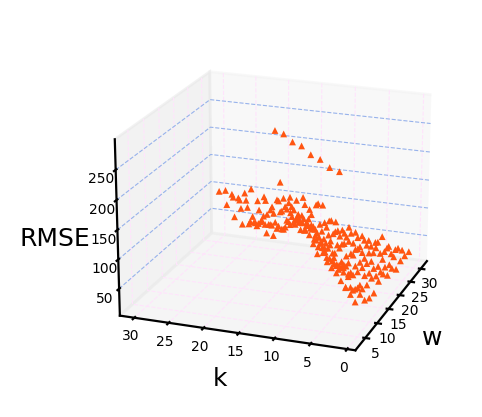

In [12]:
#单独窗口输出图像
# %matplotlib tk
# fig, ax1 = plt.subplots(figsize=(3.5, 2.5), dpi=200)
fig = plt.figure(figsize=(3.5, 2.5), dpi=200)
ax = fig.add_subplot(projection="3d")
ax.scatter(x, y, z, alpha=1, marker="^", linewidths=0, c="#ff5511", s=6)
# ax.plot_surface(x, y, z,alpha=0.9,cmap="winter") #生成曲面z，alpha调节透明度，cmap调节曲面色调

ax.set_xlabel("w", fontsize=9, labelpad=-9)
ax.tick_params(axis='x', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)
ax.set_ylabel("k", fontsize=9, labelpad=-9)
ax.tick_params(axis='y', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)
ax.set_zlabel("RMSE", fontsize=9, labelpad=-8)
ax.tick_params(axis='z', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)

ax.xaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#FFE4FC", "linestyle": "--"})
ax.yaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#FFE4FC", "linestyle": "--"})
ax.zaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#97B2EB", "linestyle": "--"})

# ax.set_title("3D surface plot")
# 视角转动
ax.view_init(20,200) #y,z
ax.elev = 20
ax.azim = 200

# plt.savefig('temp/filter_SG.png', dpi=600)
plt.show()
plt.close(fig)

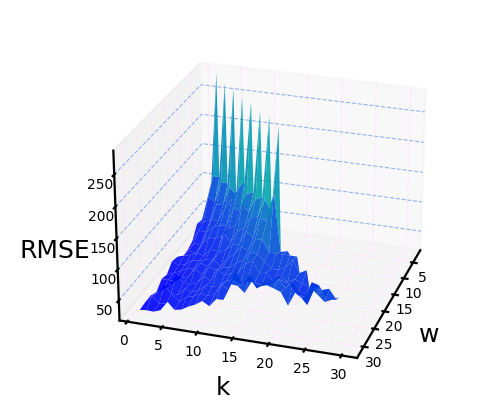

In [20]:
#单独窗口输出图像
# %matplotlib tk
# fig, ax1 = plt.subplots(figsize=(3.5, 2.5), dpi=200)
fig = plt.figure(figsize=(3.5, 2.5), dpi=200)
ax = fig.add_subplot(projection="3d")

ax.plot_surface(x, y, z,alpha=0.9,cmap="winter") #生成曲面z，alpha调节透明度，cmap调节曲面色调

ax.set_xlabel("w", fontsize=9, labelpad=-9)
ax.tick_params(axis='x', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)
ax.set_ylabel("k", fontsize=9, labelpad=-9)
ax.tick_params(axis='y', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)
ax.set_zlabel("RMSE", fontsize=9, labelpad=-8)
ax.tick_params(axis='z', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)

ax.xaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#FFE4FC", "linestyle": "--"})
ax.yaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#FFE4FC", "linestyle": "--"})
ax.zaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#97B2EB", "linestyle": "--"})

# ax.set_title("3D surface plot")
# 视角转动
ax.view_init(25,18) #y,z
# ax.elev = 25
# ax.azim = 200

# plt.savefig('temp/filter_SG.png', dpi=600)
plt.show()
plt.close(fig)

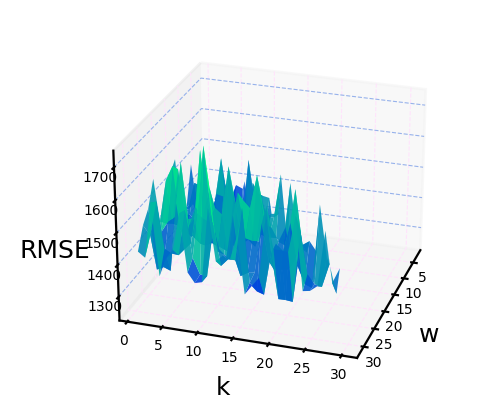

In [21]:
#单独窗口输出图像
# %matplotlib tk
# fig, ax1 = plt.subplots(figsize=(3.5, 2.5), dpi=200)
fig = plt.figure(figsize=(3.5, 2.5), dpi=200)
ax = fig.add_subplot(projection="3d")

ax.plot_surface(x, y, t,alpha=0.9,cmap="winter") #生成曲面z，alpha调节透明度，cmap调节曲面色调

ax.set_xlabel("w", fontsize=9, labelpad=-9)
ax.tick_params(axis='x', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)
ax.set_ylabel("k", fontsize=9, labelpad=-9)
ax.tick_params(axis='y', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)
ax.set_zlabel("RMSE", fontsize=9, labelpad=-8)
ax.tick_params(axis='z', direction='in', pad=-5, labelsize=5, length=2.4, width=0.4)

ax.xaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#FFE4FC", "linestyle": "--"})
ax.yaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#FFE4FC", "linestyle": "--"})
ax.zaxis._axinfo["grid"].update({"linewidth":0.4, "color" : "#97B2EB", "linestyle": "--"})

# ax.set_title("3D surface plot")
# 视角转动
ax.view_init(25,18) #y,z
# ax.elev = 25
# ax.azim = 200

# plt.savefig('temp/filter_SG.png', dpi=600)
plt.show()
plt.close(fig)

# 结果保存坐标形式绘制散点图

In [ ]:
import numpy as np

In [17]:
zScatter = np.loadtxt(open('E:/storage/MLab/hello/data/preprocess_sg_rmse_scatterMtlab.csv', "rb"), delimiter = ",", skiprows = 0) # w k
zScatter

array([[3.00000000e+00, 1.00000000e+00, 1.30343075e+02],
       [3.00000000e+00, 2.00000000e+00, 9.78614828e-13],
       [5.00000000e+00, 1.00000000e+00, 1.74783666e+02],
       [5.00000000e+00, 2.00000000e+00, 1.05540902e+02],
       [5.00000000e+00, 3.00000000e+00, 1.05515448e+02],
       [5.00000000e+00, 4.00000000e+00, 6.19903038e-13],
       [7.00000000e+00, 1.00000000e+00, 2.04684425e+02],
       [7.00000000e+00, 2.00000000e+00, 1.38566690e+02],
       [7.00000000e+00, 3.00000000e+00, 1.38582316e+02],
       [7.00000000e+00, 4.00000000e+00, 9.41029399e+01],
       [7.00000000e+00, 5.00000000e+00, 9.41185518e+01],
       [7.00000000e+00, 6.00000000e+00, 8.52822051e-12],
       [9.00000000e+00, 1.00000000e+00, 2.28194713e+02],
       [9.00000000e+00, 2.00000000e+00, 1.61032098e+02],
       [9.00000000e+00, 3.00000000e+00, 1.60957303e+02],
       [9.00000000e+00, 4.00000000e+00, 1.22100517e+02],
       [9.00000000e+00, 5.00000000e+00, 1.22035779e+02],
       [9.00000000e+00, 6.00000

In [9]:
len(zScatter)

172

In [5]:
int(zScatter[0,0])

3

In [18]:
z = np.loadtxt(open('./predict-wind-turbine/compare_filter/z_rmse.csv', "rb"), delimiter = ",", skiprows = 0) # k w
z

array([[ 95.11507568,  73.21078137,  50.83461794,  54.11012731,
         34.58293822,  28.52256924,  27.57327783,  38.53964272,
         41.92756573,  30.27360733,  33.32501145,  22.37847457,
         28.23162149,  28.26000624,  26.63755394],
       [281.25450671, 116.11416435,  91.9492165 ,  59.58338648,
         53.98125843,  42.62507022,  39.9475471 ,  42.26682019,
         36.71907178,  34.58235933,  33.82309361,  28.88834921,
         33.9640021 ,  40.34373841,  27.81126568],
       [         nan, 118.07156178,  83.45002455,  62.15860973,
         53.19657822,  40.60653625,  37.93748506,  45.05329491,
         40.11305788,  39.05325691,  33.44828915,  36.83082646,
         48.11957506,  28.68872287,  27.23407203],
       [         nan, 277.05953897, 120.4255468 ,  91.57036211,
         77.62966903,  64.95458371,  54.13877851,  50.12568766,
         48.18464557,  46.12534129,  40.83592691,  55.93828987,
         36.88187155,  31.13127707,  31.500653  ],
       [         nan,       

In [24]:
saveData = np.zeros((len(zScatter),3))

for i in range(len(zScatter)): # wide
    saveData[i,0] = zScatter[i,0]
    saveData[i,1] = zScatter[i,1]
    saveData[i,2] = z[int(zScatter[i,1])-1,int((zScatter[i,0]-1)//2)-1] # k w
saveData

array([[  3.        ,   1.        ,  95.11507568],
       [  3.        ,   2.        , 281.25450671],
       [  5.        ,   1.        ,  73.21078137],
       [  5.        ,   2.        , 116.11416435],
       [  5.        ,   3.        , 118.07156178],
       [  5.        ,   4.        , 277.05953897],
       [  7.        ,   1.        ,  50.83461794],
       [  7.        ,   2.        ,  91.9492165 ],
       [  7.        ,   3.        ,  83.45002455],
       [  7.        ,   4.        , 120.4255468 ],
       [  7.        ,   5.        , 119.26119779],
       [  7.        ,   6.        , 279.53929821],
       [  9.        ,   1.        ,  54.11012731],
       [  9.        ,   2.        ,  59.58338648],
       [  9.        ,   3.        ,  62.15860973],
       [  9.        ,   4.        ,  91.57036211],
       [  9.        ,   5.        ,  92.71392986],
       [  9.        ,   6.        , 124.30058102],
       [  9.        ,   7.        , 113.2010665 ],
       [  9.        ,   8.     

In [23]:
int(zScatter[i,1])-1,(zScatter[i,0]-1)//2-1

(0, 0.0)

In [25]:
np.savetxt('E:/storage/MLab/hello/data/forecast_sg_rmse_scatterMtlab.csv', saveData, delimiter = ',')

# 结果可视化

In [8]:
date_pro = serScada.iloc[:,[1,2,3]].values
WS_sg = savgol_filter(serScada.iloc[:,[3]].values.ravel(), 5, 3)
date_pro[:,2] = WS_sg

# 拟合计算放缩比例等参数，并存储在 scaler
scaler, data_norm = scale(date_pro)  # 字典对象也可以

# to supervised learning
n_timesteps = 10  # 之前的时刻数量
n_features = data_norm.shape[1]  # 数据集中输入特征数量
data_supervised = series_to_supervised(data_norm, n_timesteps, 1)  # 包含 t 时刻之前的 timestep 个时间点，以及 t 时刻数据，以 t 时刻为预测对象

# drop columns we don't want to predict
relain = np.array([3])  # array([3]) 保留第几个变量(从1计数)，即预测对象
data_supervised_droped = copy.deepcopy(data_supervised)  # 深拷贝则不会改变原始字典对象内容
remov = np.array([x for x in range(data_norm.shape[1])]) + n_timesteps*n_features  # array([30, 31, 32]) t 时刻所有参数列序号
remov = np.delete(remov,relain-1)  # array([30, 31]) 要删除的对象
data_supervised_droped.drop(data_supervised_droped.columns[remov], axis=1, inplace=True)  # 去掉输出当中不需要预测的参数列 [-1,-2,-3,-4,-5,-6]

# split into train and test sets
n_train_num = int(len(data_supervised_droped)*0.8)  # 规定训练集数据数量，要小于数据量总数，在后面设置reshape设置样本个数、时间步长要注意数量对应
train = data_supervised_droped.values[:n_train_num, :]  # 按行切片，从0到n-1行，也就是从头开始总共 n 行数据
test = data_supervised_droped.values[n_train_num:, :]  # 按行切片

In [9]:
n_train_num

42040

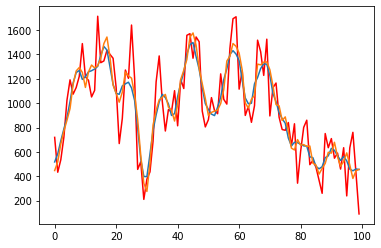

In [10]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt

serScada=pd.read_csv('./data/serScada.csv', index_col=0)
# 字符转标准时间索引
serScada.index = pd.to_datetime(serScada.index)
res = pd.read_csv('./predict-wind-turbine/compare_filter/SG_11_2.csv')

n_timesteps = 10  # 之前的时刻数量
n_train_num = int(len(data_supervised_droped)*0.8)
a = 100
b = 200

y1 = serScada.iloc[:,[3]].values.ravel()[n_train_num+n_timesteps+a:n_train_num+n_timesteps+b]
y2 = res.iloc[:,[0]].values.ravel()[a:b]
y3 = res.iloc[:,[1]].values.ravel()[a:b]
x =  np.array(range(len(y1)))+1

plt.plot(y1, label='y1', c='r')
plt.plot(y2, label='y1')
plt.plot(y3, label='y1')

plt.show()

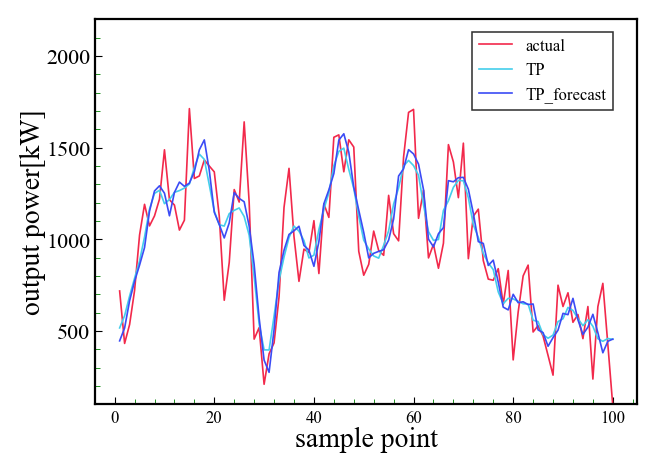

In [11]:
matplotlib.rcdefaults()  # 将配置重置为默认值
# matplotlib.use("Agg")
# matplotlib.rcParams['text.usetex'] = True  # 全局开启
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['axes.unicode_minus'] = False  # 解决保存图像是负号'-'显示为方块的问题/让负号正常显示

fig, ax = plt.subplots(figsize=(3.5, 2.5), dpi=200)

linew = 0.6
colors = ['#F2294B', '#44CEEB', '#3B4BF5']

ax.plot(x, y1,
        label='actual',
        ls='-',
        linewidth=linew,
        color=colors[0],
        alpha=1,
#         marker='^',
        markersize=3,
        markeredgecolor='#FD6174',
        markeredgewidth=0.5,
        markerfacecolor='none')
ax.plot(x, y2,
        label='TP',
        ls='-',
        linewidth=linew,
        color=colors[1],
        alpha=1,
#         marker='d',
        markersize=3,
        markeredgecolor='#00A2FF',
        markeredgewidth=0.5,
        markerfacecolor='none')
ax.plot(x, y3,
        label='TP_forecast',
        ls='-',
        linewidth=linew,
        color=colors[2],
        alpha=1,
#         marker='s',
        markersize=3,
        markeredgecolor='#5858ff',
        markeredgewidth=0.5,
        markerfacecolor='none')

# 横轴设置
plt.xticks(x)
ax.set_xlabel('sample point', fontsize=10, labelpad=0)  # 设置 x 轴标签、字体大小
ax.tick_params(axis='x', direction='in', pad=2, labelsize=6, length=2.7, width=0.4, rotation=0)  # x 轴刻度值大小
ax.tick_params(axis="x", which='minor', direction='in', length=1.7, width=0.3, color="green")
# 主刻度间隔数量
# ax = plt.gca()
ax.xaxis.set_major_locator(plt.MultipleLocator(20)) # MultipleLocator()函数设置了x轴相邻显示点的间隔
# 次刻度标签的位置
ax.xaxis.set_minor_locator(plt.MultipleLocator(4)) #将此y轴次刻度标签设置为 的倍数/
# plt.xlim((1, 32))

# 纵轴设置
ax.set_ylabel(r'output power[kW]', fontsize=10, labelpad=0)  # 设置第 1 个 y 轴特征标签字体颜色、大小r'\textit{'+plot1.columns.values[0]+'}'
ax.tick_params(axis='y', direction='in', pad=1.7, labelsize=8, length=2.4, width=0.4)  # 第 1 个 y 轴刻度值字体颜色大小, labelcolor=color
ax.tick_params(axis="y", which='minor', direction='in', length=1.7, width=0.3, color="green")
# 设置主刻度标签的位置
ax.yaxis.set_major_locator(plt.MultipleLocator(500)) #将y轴主刻度标签设置为 的倍数
# 设置次刻度标签的位置
ax.yaxis.set_minor_locator(plt.MultipleLocator(100)) #将此y轴次刻度标签设置为 的倍数/
plt.ylim((100, 2200))

# 设置刻度轴旋转角度：使用ax.tick_params
# ax.tick_params(axis='x', direction='in', labelsize=10, pad=5, labelrotation=0) #选择x轴
# ax.tick_params(axis='y', direction='in', labelsize=10, pad=5)

# 显示图例
plt.legend()
legend = plt.legend(loc='upper left', frameon=True, bbox_to_anchor=(0.68, 0.99), ncol=1,fancybox=False,
                    facecolor='white',edgecolor='black', fontsize=6) # (0.01, 0.99)
frame = legend.get_frame()
frame.set_linewidth(0.57) # 设置图例边框线宽

# plt.grid(ls='--', linewidth=0.4)  # 网格

# plt.savefig('temp/compare_result_filter_tp_actual_sg_forecast.png', dpi=600)
plt.show()
plt.close(fig)

CN

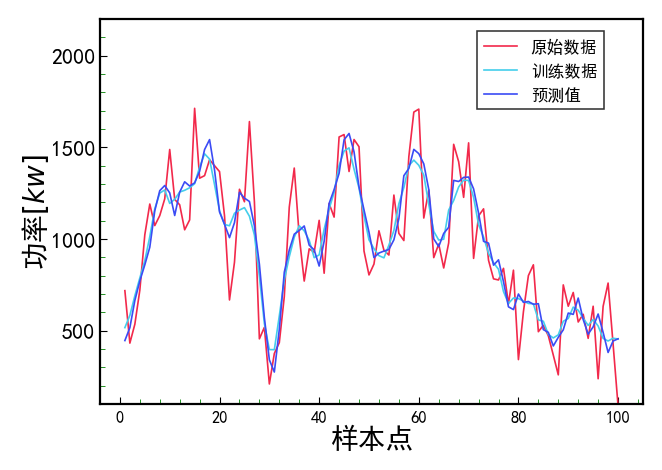

In [15]:
matplotlib.rcdefaults()  # 将配置重置为默认值
# matplotlib.use("Agg")
# matplotlib.rcParams['text.usetex'] = True  # 全局开启
# plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.sans-serif'] = ['SimHei']  # 用来正常显示中文标签
plt.rcParams['axes.unicode_minus'] = False  # 解决保存图像是负号'-'显示为方块的问题/让负号正常显示

fig, ax = plt.subplots(figsize=(3.5, 2.5), dpi=200)

linew = 0.6
colors = ['#F2294B', '#44CEEB', '#3B4BF5']

ax.plot(x, y1,
        label='原始数据',
        ls='-',
        linewidth=linew,
        color=colors[0],
        alpha=1,
#         marker='^',
        markersize=3,
        markeredgecolor='#FD6174',
        markeredgewidth=0.5,
        markerfacecolor='none')
ax.plot(x, y2,
        label='训练数据',
        ls='-',
        linewidth=linew,
        color=colors[1],
        alpha=1,
#         marker='d',
        markersize=3,
        markeredgecolor='#00A2FF',
        markeredgewidth=0.5,
        markerfacecolor='none')
ax.plot(x, y3,
        label='预测值',
        ls='-',
        linewidth=linew,
        color=colors[2],
        alpha=1,
#         marker='s',
        markersize=3,
        markeredgecolor='#5858ff',
        markeredgewidth=0.5,
        markerfacecolor='none')

# 横轴设置
plt.xticks(x)
ax.set_xlabel('样本点', fontsize=10, labelpad=0)  # 设置 x 轴标签、字体大小
ax.tick_params(axis='x', direction='in', pad=2, labelsize=6, length=2.7, width=0.4, rotation=0)  # x 轴刻度值大小
ax.tick_params(axis="x", which='minor', direction='in', length=1.7, width=0.3, color="green")
# 主刻度间隔数量
# ax = plt.gca()
ax.xaxis.set_major_locator(plt.MultipleLocator(20)) # MultipleLocator()函数设置了x轴相邻显示点的间隔
# 次刻度标签的位置
ax.xaxis.set_minor_locator(plt.MultipleLocator(4)) #将此y轴次刻度标签设置为 的倍数/
# plt.xlim((1, 32))

# 纵轴设置
ax.set_ylabel(r'功率$[kw]$', fontsize=10, labelpad=0)  # 设置第 1 个 y 轴特征标签字体颜色、大小r'\textit{'+plot1.columns.values[0]+'}'
ax.tick_params(axis='y', direction='in', pad=1.7, labelsize=8, length=2.4, width=0.4)  # 第 1 个 y 轴刻度值字体颜色大小, labelcolor=color
ax.tick_params(axis="y", which='minor', direction='in', length=1.7, width=0.3, color="green")
# 设置主刻度标签的位置
ax.yaxis.set_major_locator(plt.MultipleLocator(500)) #将y轴主刻度标签设置为 的倍数
# 设置次刻度标签的位置
ax.yaxis.set_minor_locator(plt.MultipleLocator(100)) #将此y轴次刻度标签设置为 的倍数/
plt.ylim((100, 2200))

# 设置刻度轴旋转角度：使用ax.tick_params
# ax.tick_params(axis='x', direction='in', labelsize=10, pad=5, labelrotation=0) #选择x轴
# ax.tick_params(axis='y', direction='in', labelsize=10, pad=5)

# 显示图例
plt.legend()
legend = plt.legend(loc='upper left', frameon=True, bbox_to_anchor=(0.68, 0.99), ncol=1,fancybox=False,
                    facecolor='white',edgecolor='black', fontsize=6) # (0.01, 0.99)
frame = legend.get_frame()
frame.set_linewidth(0.57) # 设置图例边框线宽

# plt.grid(ls='--', linewidth=0.4)  # 网格

plt.savefig('temp/compare_result_filter_tp_actual_sg_forecast_CN.png', dpi=600)
plt.show()
plt.close(fig)

In [42]:
res.iloc[:,[0]].values.ravel()#[a,b]

array([   0.        ,    0.        ,    0.        , ..., 1570.54215622,
       2563.54423606, 2742.89366311])

In [49]:
rmse(res.iloc[:,[0]].values.ravel(),res.iloc[:,[1]].values.ravel())

118.07156147701653

In [51]:
rmse(serScada.iloc[:,[3]].values.ravel()[n_train_num+n_timesteps:],res.iloc[:,[1]].values.ravel())

116.02262642566235

# 对比